In [40]:
import numpy as np
import json
import warnings
import operator

import h5py
from keras.models import model_from_json
from keras import backend as K

from matplotlib import pyplot as plt

warnings.filterwarnings("ignore")

size_title = 18
size_label = 14
n_pred = 2

base_path = "data/remote_ig/"

path_data_dict = base_path + "data_dict.txt"
path_inverted_wt = base_path + "inverted_weights.txt"
path_usage_wt = base_path + "usage_prediction.txt"
path_class_wt = base_path + "class_weights.txt"
path_test_data = base_path + "test_paths_dict.txt"
model_path = base_path + "trained_model.hdf5"

def read_file(file_path):
    with open(file_path, 'r') as data_file:
        data = json.loads(data_file.read())
    return data

class_weights = read_file(path_class_wt)
usage_weights = read_file(path_usage_wt)
inverted_weights = read_file(path_inverted_wt)
data_dict = read_file(path_data_dict)

def create_model(model_path):
    trained_model = h5py.File(model_path, 'r')
    model_config = json.loads(trained_model.get('model_config').value)
    loaded_model = model_from_json(model_config)
    dictionary = json.loads(trained_model.get('data_dictionary').value)
    compatibile_tools = json.loads(trained_model.get('compatible_tools').value)
    reverse_dictionary = dict((str(v), k) for k, v in dictionary.items())
    model_weights = list()
    weight_ctr = 0
    while True:
        try:
            d_key = "weight_" + str(weight_ctr)
            weights = trained_model.get(d_key).value
            model_weights.append(weights)
            weight_ctr += 1
        except Exception as exception:
            break
    # set the model weights
    loaded_model.set_weights(model_weights)
    return loaded_model, dictionary, reverse_dictionary, compatibile_tools

model, dictionary, reverse_dictionary, compatibile_tools = create_model(model_path)

In [41]:
reverse_dictionary

{'1': 'cshl_fastq_to_fasta',
 '2': 'rseqc_read_distribution',
 '3': 'NSPDK_candidateClust',
 '4': 'tabular_to_fastq',
 '5': 'seq_filter_by_mapping',
 '6': 'resistome_analyzer',
 '7': 'heinz_visualization',
 '8': 'lastz_wrapper_2',
 '9': 'bowtie_wrapper',
 '10': 'bed_to_bigwig',
 '11': 'cast',
 '12': 'deeptools_heatmapper',
 '13': 'vcfsort',
 '14': 'mothur_cluster',
 '15': 'blast_parser',
 '16': 'cardinal_combine',
 '17': 'rna_star',
 '18': 'NFS_transfer',
 '19': 'stringtie_merge',
 '20': 'minfi_dropsnp',
 '21': 'raceid_filtnormconf',
 '22': 'Paste1',
 '23': 'metilene',
 '24': 'antismash',
 '25': 'bam_to_sam',
 '26': 'gd_raxml',
 '27': 'bam_to_bigwig',
 '28': 'msconvert3_raw',
 '29': 'mothur_seq_error',
 '30': 'gatk2_variant_select',
 '31': 'fastq_paired_end_joiner',
 '32': 'wig_to_bigWig',
 '33': 'raceid_main',
 '34': 'ucsc-twobittofa',
 '35': 'flye',
 '36': 'Remove beginning1',
 '37': 'computeMatrix',
 '38': 'velvetg_jgi',
 '39': 'snpeff_to_peptides',
 '40': 'smooth_running_window',
 

In [50]:
def verify_model(model, tool_sequence, labels, dictionary, reverse_dictionary, compatible_tools, topk=10, max_seq_len=25):
    tl_seq = tool_sequence.split(",")
    last_tool_name = reverse_dictionary[str(tl_seq[-1])]
    try:
        labels_split = labels.split(",")
        label_names = [reverse_dictionary[str(tool_pos)] for tool_pos in labels_split]
    except:
        labels_split = list()
        label_names = []
        pass
    topk = len(labels_split)
    last_compatible_tools = compatible_tools[last_tool_name]
    sample = np.zeros(max_seq_len)
    for idx, tool_id in enumerate(tl_seq):
        sample[idx] = int(tool_id)
    sample_reshaped = np.reshape(sample, (1, max_seq_len))
    
    tool_sequence_names = [reverse_dictionary[str(tool_pos)] for tool_pos in tool_sequence.split(",")]
    print(",".join(tool_sequence_names))
    # predict next tools for a test path
    prediction = model.predict(sample_reshaped, verbose=0)
    prediction = np.reshape(prediction, (prediction.shape[1],))
    prediction_pos = np.argsort(prediction, axis=-1)

    # get topk prediction
    topk_prediction_pos = prediction_pos[-topk:]
    topk_prediction_val = [np.round(prediction[pos] * 100, 2) for pos in topk_prediction_pos]

    # read tool names using reverse dictionary
    pred_tool_ids = [reverse_dictionary[str(tool_pos)] for tool_pos in topk_prediction_pos]
    actual_next_tool_ids = list(set(pred_tool_ids).intersection(set(last_compatible_tools.split(","))))      
        
    #print("Predicted tools: %s" % ",".join(pred_tool_ids))
    print()
    pred_tool_ids_sorted = dict()
    for (tool_pos, tool_pred_val) in zip(topk_prediction_pos, topk_prediction_val):
        tool_name = reverse_dictionary[str(tool_pos)]
        if tool_name in actual_next_tool_ids:
            pred_tool_ids_sorted[tool_name] = tool_pred_val
    pred_tool_ids_sorted = dict(sorted(pred_tool_ids_sorted.items(), key=lambda kv: kv[1], reverse=True))
    
    cls_wt = dict()
    usg_wt = dict()
    inv_wt = dict()
    ids_tools = dict()
    keys = list(pred_tool_ids_sorted.keys())
    for k in keys:
        try:
            cls_wt[k] = np.round(class_weights[str(data_dict[k])], 2)
            usg_wt[k] = np.round(usage_weights[k], 2)
            inv_wt[k] = np.round(inverted_weights[str(data_dict[k])], 2)
        except:
            continue
    print("Predicted tools: \n")
    print(pred_tool_ids_sorted)
    print()
    print("Class weights: \n")
    cls_wt = dict(sorted(cls_wt.items(), key=lambda kv: kv[1], reverse=True))
    print(cls_wt)
    print()
    print("Usage weights: \n")
    usg_wt = dict(sorted(usg_wt.items(), key=lambda kv: kv[1], reverse=True))
    print(usg_wt)
    print()
    print("Inverted weights: \n")
    inv_wt = dict(sorted(inv_wt.items(), key=lambda kv: kv[1], reverse=True))
    print(inv_wt)
    for key in pred_tool_ids_sorted:
        ids_tools[key] = dictionary[key]
    print()
    print(ids_tools)
    print("======================================")
    ave_pred_wt = np.mean(list(pred_tool_ids_sorted.values()))
    ave_cls_wt = np.mean(list(cls_wt.values()))
    ave_usg_wt = np.mean(list(usg_wt.values()))
    ave_inv_wt = np.mean(list(inv_wt.values()))
    
    # find false positives
    false_positives = [ tool_name for tool_name in pred_tool_ids if tool_name not in label_names ]
    absolute_precision = 1 - ( len( false_positives ) / float( len( label_names ) ) )
    
    compatible_fp = [ tool_name for tool_name in pred_tool_ids if tool_name not in actual_next_tool_ids ]
    compatible_precision = 1 - ( len( compatible_fp ) / float( len( label_names ) ) )
    ave_comp_precision.append(compatible_precision)
    
    print()
    print("True labels: %s" % ",".join(label_names))
    print("Predicted labels: %s" % ",".join(pred_tool_ids))
    print("False labels: %s" % ",".join(false_positives))
    print("False incompatible labels: %s" % ",".join(compatible_fp))
    print()
    
    print("Absolute precision on test data using current model is: %0.6f" % absolute_precision)
    print("Compatible precision on test data using current model is: %0.6f" % compatible_precision)
    length = len(tool_sequence_names)
    if length not in precision_path_length:
        precision_path_length[length] = list()
    precision_path_length[length].append(absolute_precision)
    print("----------------------------")
    return ave_pred_wt, ave_cls_wt, ave_usg_wt, ave_inv_wt

ave_prediction_weights = list()
ave_class_weights = list()
ave_usage_weights = list()
ave_inverted_weights = list()

ave_abs_precision = list()
ave_comp_precision = list()
precision_path_length = dict()
def get_predictions(model, dictionary, reverse_dictionary, compatibile_tools):
    t_data = read_file(path_test_data)
    ctr = 1
    for ph, cl in t_data.items():
        ave_pred_wt, ave_cls_wt, ave_usg_wt, ave_inv_wt = verify_model(model, ph, cl, dictionary, reverse_dictionary, compatibile_tools)
        ave_prediction_weights.append(ave_pred_wt)
        ave_class_weights.append(ave_cls_wt)
        ave_usage_weights.append(ave_usg_wt)
        ave_inverted_weights.append(ave_inv_wt)
        ctr += 1

get_predictions(model, dictionary, reverse_dictionary, compatibile_tools)
print("Mean abs precision on test data using current model is: %0.6f" % np.mean(ave_abs_precision))
print("Mean abs precision on test data using current model is: %0.6f" % np.mean(ave_comp_precision))

trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,addValue,join1,Cut1,Convert characters1,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Cut1,collection_column_join,regex_replace,datamash_transpose,join1,Filter1,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels:


Predicted tools: 

{'Show tail1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15}

{'Show tail1': 788, 'cat1': 687}

True labels: Show tail1,cat1
Predicted labels: Show tail1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,addValue,cat1,melt,join1

Predicted tools: 

{'Filter1': 100.0, 'Cut1': 100.0, 'Add_a_column1': 99.64}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11, 'Add_a_column1': 4.08}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'Filter1': 22.67, 'Cut1': 6.01}

{'Filter1': 198, 'Cut1': 698, 'Add_a_


Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0, 'wc_gnu': 99.96}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'addValue': 10.26, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687, 'wc_gnu': 53}

True labels: cat1,wc_gnu,addValue
Predicted labels: wc_gnu,addValue,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,addValue,Cut1,collapse_dataset,join1,Add_a_column1,Filter1,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'g


Predicted tools: 

{'cast': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'datamash_transpose': 583, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: datamash_transpose,heatmap2,cast,ggplot_histogram
Predicted labels: cast,datamash_transpose,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,Filter1,comp1,addValue,Grouping1,cat1

Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatm


Predicted tools: 

{'ggplot_histogram': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'ggplot_histogram': 80, 'collection_column_join': 108, 'ggplot_point': 331}

True labels: collection_column_join,ggplot_histogram,ggplot_point
Predicted labels: ggplot_histogram,collection_column_join,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Cut1,addValue,Grouping1,cat1,melt

Predicted tools: 

{'Remove beginning1': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usag


Predicted tools: 

{'cat1': 100.0, 'Show beginning1': 100.0, 'Convert characters1': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0, 'collection_column_join': 99.99, 'collapse_dataset': 99.96, 'Remove beginning1': 99.72}

Class weights: 

{'Remove beginning1': 846.42, 'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'collapse_dataset': 73.48, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'cat1': 428.07, 'Remove beginning1': 295.14, 'Show beginning1': 87.82, 'Convert characters1': 48.83, 'collection_column_join': 14.1, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'collection_column_join': 17.86, 'Remove beginning1': 13.55, 'Convert characters1': 12.8, 'Show beginning1': 4.36, 'cat1': 3.15}

{'cat1': 687, 'Show beginning1': 959, 'Convert characters1': 314, 'ggplot_histogram': 80, 'ggplot_point': 331, 'collection_column_join': 108, 'collapse_dataset': 386, 'Remove beginning1


Predicted tools: 

{'heatmap2': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'datamash_transpose': 583, 'ggplot_histogram': 80, 'cast': 11}

True labels: ggplot_histogram,heatmap2,datamash_transpose,cast
Predicted labels: heatmap2,datamash_transpose,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Add_a_column1,comp1,wc_gnu,addValue,Grouping1,cat1,melt,Remove beginning1

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights:


Predicted tools: 

{'datamash_transpose': 100.0, 'Cut1': 100.0, 'Show tail1': 99.96}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'Cut1': 698, 'Show tail1': 788}

True labels: datamash_transpose,Show tail1,Cut1
Predicted labels: Show tail1,datamash_transpose,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,cast,comp1,addValue,Grouping1,join1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'm


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
FeatureFinderMultiplex,HighResPrecursorMassCorrector,MSGFPlusAdapter,IDMerger,ConsensusID,PeptideIndexer,FalseDiscoveryRate,IDFilter,TextExporter,Filter1,column_remove_by_header,Remove beginning1

Predicted tools: 

{'collection_column_join': 99.99, 'Add_a_column1': 99.71, 'Show beginning1': 91.64, 'wc_gnu': 72.1}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'Add_a_column1': 4.08, 'wc_gnu': 2.99}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1, 'Add_a_column1': 0.


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,Filter1,comp1,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

Tr


Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801}

True labels: cast,melt,datamash_transpose,heatmap2
Predicted labels: melt,datamash_transpose,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Filter1,addValue,Cut1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weig


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0, 'Cut1': 99.99}

Class weights: 

{'Cut1': 2600.11, 'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'Cut1': 1425.46, 'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'Cut1': 6.01, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687, 'Cut1': 698}

True labels: Cut1,Grouping1,cat1
Predicted labels: Cut1,Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_screen_seqs,mothur_filter_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_chimera_vsearch,mothur_remove_seqs,mothur_remove_lineage,mothur_remove_groups,mothur_classify_otu,mothur_taxonomy_to_krona

Predicted tools: 

{'taxonomy_krona_chart': 99.94}

Class weights: 

{'taxonomy_krona_chart': 3167.68}

Usage weights: 

{'taxonomy_krona_chart': 16.26}

Inverted 


Predicted tools: 

{'cat1': 100.0, 'addValue': 99.99}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'cat1': 687, 'addValue': 818}

True labels: addValue,cat1
Predicted labels: addValue,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,addValue,cat1,melt,Remove beginning1,Show beginning1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible label


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,cat1,melt,join1,Add_a_column1,addValue

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Ad


Predicted tools: 

{'cat1': 100.0, 'Grouping1': 99.98}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'cat1': 687, 'Grouping1': 860}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,datamash_transpose,join1,Filter1,addValue,Cut1,Convert characters1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: ggplot_histogram,heatmap2,ca


Predicted tools: 

{'Remove beginning1': 100.0, 'addValue': 100.0}

Class weights: 

{'addValue': 1141.13, 'Remove beginning1': 846.42}

Usage weights: 

{'addValue': 463.1, 'Remove beginning1': 295.14}

Inverted weights: 

{'Remove beginning1': 13.55, 'addValue': 10.26}

{'Remove beginning1': 36, 'addValue': 818}

True labels: Remove beginning1,addValue
Predicted labels: Remove beginning1,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_make_group,mothur_count_seqs,mothur_screen_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_remove_seqs,mothur_classify_seqs,mothur_remove_lineage,mothur_cluster,mothur_make_shared,mycrobiota-correct-replicates,mothur_rarefaction_single,extract_element_from_collection

Predicted tools: 

{'mycrobiota-otutable_add_blast': 100.0, 'mycrobiota-make-multi-otutable': 


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,cat1,melt,join1,Filter1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,h


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,ggplot_point,collection_column_join
Predicted labels: collection_column_join,ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,join1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Convert characters1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights:


Predicted tools: 

{'iReport': 100.0}

Class weights: 

{'iReport': 3.55}

Usage weights: 

{}

Inverted weights: 

{}

{'iReport': 643}

True labels: iReport
Predicted labels: iReport
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,Filter1,addValue,Grouping1,cat1

Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: melt


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Grouping1,join1,Cut1,Filter1,comp1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatib


Predicted tools: 

{'deeptools_heatmapper': 100.0}

Class weights: 

{'deeptools_heatmapper': 6.81}

Usage weights: 

{}

Inverted weights: 

{}

{'deeptools_heatmapper': 12}

True labels: deeptools_heatmapper
Predicted labels: deeptools_heatmapper
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.0000


Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.9}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67, 'Cut1': 6.01}

{'Cut1': 698, 'Filter1': 198}

True labels: Filter1,Cut1
Predicted labels: Filter1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,Filter1,addValue,Grouping1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,Cut1,addValue,join1,Add_a_column1,Filter1,comp1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: ggplot_histogram,cast,heatmap2
False labels


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,collection_column_join,ggplot_histogram
Predicted labels: collection_column_join,ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,addValue,join1,Add_a_column1,Filter1,Grouping1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, '


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,cat1,melt,Remove beginning1,addValue,join1,Add_a_column1,Filter1,Cut1,collection_column_join,regex_replace,Grep1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels:


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,cat1,melt,Remove beginning1,datamash_ops,join1,Filter1,wc_gnu,collapse_dataset,Cut1

Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginning1
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,join1,Filter1,wc_gnu,addValue,Cut1,Add_a_column1,comp1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data usi


Predicted tools: 

{'collection_column_join': 100.0, 'Show beginning1': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'collection_column_join': 108, 'Show beginning1': 959, 'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,collection_column_join,Show beginning1,ggplot_point
Predicted labels: collection_column_join,Show beginning1,ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Filter1,Cut1,collection_column_join,regex_replace,melt,Remove 


Predicted tools: 

{'wc_gnu': 100.0, 'comp1': 99.98}

Class weights: 

{'comp1': 728.05, 'wc_gnu': 2.99}

Usage weights: 

{'comp1': 193.0, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'wc_gnu': 19.9}

{'wc_gnu': 53, 'comp1': 807}

True labels: comp1,wc_gnu
Predicted labels: comp1,wc_gnu
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,addValue,join1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible lab


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,addValue,Grouping1

Predicted tools: 

{'join1': 100.0, 'cat1': 100.0}

Class weights: 

{'join1': 1380.83, 'cat1': 509.74}

Usage weights: 

{'cat1': 428.07, 'join1': 371.21}

Inverted weights: 

{'join1': 26.88, 'cat1': 3.15}

{'join1': 361, 'cat1': 687}

True labels: cat1,join1
Predicted labels: join1,cat1



Predicted tools: 

{'collection_column_join': 100.0, 'Show beginning1': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'collection_column_join': 108, 'Show beginning1': 959, 'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: collection_column_join,Show beginning1,ggplot_point,ggplot_histogram
Predicted labels: collection_column_join,Show beginning1,ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Grouping1,join1,Filter1,comp1,wc_gnu,Remove beginning1,cat1,me


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,melt,join1,Filter1,wc_gnu,addValue,Grouping1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801, 'datamash_tra


Predicted tools: 

{'Remove beginning1': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Remove beginning1': 36, 'Show beginning1': 959}

True labels: Remove beginning1,Show beginning1
Predicted labels: Remove beginning1,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Filter1,wc_gnu,Remove beginning1,Cut1,Add_a_column1,addValue,Grouping1,cat1,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True


Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'Remove beginning1': 99.93}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'collection_column_join': 108, 'ggplot_point': 331, 'Remove beginning1': 36}

True labels: ggplot_point,collection_column_join,Remove beginning1,Show beginning1
Predicted labels: Remove beginning1,Show beginning1,collection_column_join,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,col


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,addValue,join1,Add_a_column1,comp1,cat1,melt,Show beginning1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_histogram': 80, 'ggplot_point':


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Add_a_column1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision 


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,Filter1,wc_gnu

Predicted tools: 

{'addValue': 100.0}

Class weights: 

{'addValue': 1141.13}

Usage weights: 

{'addValue': 463.1}

Inverted weights: 

{'addValue': 10.26}

{'addValue': 818}

True labels: addValue
Predicted labels: addValue
False labels: 
False inco


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,melt,Show beginning1,datamash_transpose,join1,Add_a_column1,Filter1,wc_gnu

Predicted tools: 

{'Remove beginning1': 100.0, 'addValue': 100.0}

Class weights: 

{'addValue': 1141.13, 'Remove beginning1': 846.42}

Usage weights: 

{'addValue': 463.1, 'Remove beginning1': 295.14}

Inverted weights: 

{'Remove beginning1': 13.55, 'addValue': 10.26}

{'Remove beginning1': 36, 'addValue': 818}

True labels: addValue,Remove beginning1
Predicted labels: Remove beginning1,addValue
False labels: 
False incompati


Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,addValue,Cut1,Filter1,Grouping1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'melt': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt'


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,addValue,cat1,melt,Remove beginning1,datamash_ops,join1

Predicted tools: 

{'Filter1': 100.0, 'Cut1': 100.0, 'Add_a_column1': 99.95}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11, 'Add_a_column1': 4.08}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'Filter1': 22.67, 'Cut1': 6.01}

{'Filter1': 198, 'Cut1': 698, 'Add_a_column1': 435}

True labels: Cut1,Add_a_c


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,join1,Filter1,Cut1,collection_column_join,regex_replace,Grep1,Add_a_column1,comp1,addValue

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data usin


Predicted tools: 

{'ggplot_point': 100.0, 'Show beginning1': 100.0, 'ggplot_histogram': 100.0, 'collection_column_join': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'ggplot_point': 331, 'Show beginning1': 959, 'ggplot_histogram': 80, 'collection_column_join': 108}

True labels: ggplot_histogram,ggplot_point,collection_column_join,Show beginning1
Predicted labels: ggplot_point,Show beginning1,ggplot_histogram,collection_column_join
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Cut1,Filter1,comp1,addValue


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,Cut1,addValue,Grouping1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
------


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,join1

Predicted tools: 

{'Filter1': 100.0, 'Add_a_column1': 99.99, 'Cut1': 99.98}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11, 'Add_a_column1': 4.08}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'Filter1': 22.67, 'Cut1': 6.01}

{'Filter1': 198, 'Add_a_column1': 435, 'Cut1': 698}

True labels: Filter1,Cut1,Add_a_column1
Predicted labels: Cut1,Add_a_column1,Filter1
False labels: 
False incompatible labels: 

Absolute p


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,Add_a_column1,wc_gnu,collapse_dataset,join1,Filter1,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: cast,ggplot_histogram,heatmap2
Predi


Predicted tools: 

{'datamash_transpose': 100.0, 'Grep1': 100.0}

Class weights: 

{'Grep1': 209.65, 'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88, 'Grep1': 12.43}

Inverted weights: 

{'Grep1': 62.78, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'Grep1': 871}

True labels: Grep1,datamash_transpose
Predicted labels: datamash_transpose,Grep1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,addValue,cat1,datamash_transpose

Predicted tools: 

{'join1': 100.0, 'Remove beginning1': 100.0, 'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'join1': 1380.83, 'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'join1': 371.21, 'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'join1': 26.88, 'Remove beg


Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Cut1,addValue,join1,Filter1,comp1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absol


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,Grouping1,cat1,cast,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,addValue

Predicted tools: 

{'Cut1': 100.0, 'join1': 99.94}

Class weights: 

{'Cut1': 2600.11, 'join1': 1380.83}

Usage weights: 

{'Cut1': 1425.46, 'join1': 371.21}

Inverted weights: 

{'join1': 26.88, 'Cut1': 6.01}

{'Cut1': 698, 'join1': 361}

True labels: Cut1,join1
Predicted labels: join1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test


Predicted tools: 

{'Convert characters1': 99.99, 'join1': 99.94}

Class weights: 

{'join1': 1380.83, 'Convert characters1': 174.3}

Usage weights: 

{'join1': 371.21, 'Convert characters1': 48.83}

Inverted weights: 

{'join1': 26.88, 'Convert characters1': 12.8}

{'Convert characters1': 314, 'join1': 361}

True labels: Convert characters1,join1
Predicted labels: join1,Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Filter1,comp1,cat1,melt,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1

Predicted tools: 

{'Cut1': 100.0, 'Grouping1': 99.9}

Class weights: 

{'Cut1': 2600.11, 'Grouping1': 474.37}

Usage weights: 

{'Cut1': 1425.46, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'Cut1': 6.01}

{'Cut1': 698, 'Grouping1': 860}

True 


Predicted tools: 

{'cast': 100.0, 'datamash_transpose': 100.0, 'Cut1': 100.0, 'heatmap2': 100.0, 'melt': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'datamash_transpose': 583, 'Cut1': 698, 'heatmap2': 801, 'melt': 363}

True labels: melt,Cut1,cast,datamash_transpose,heatmap2
Predicted labels: cast,datamash_transpose,Cut1,heatmap2,melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,cat1,melt,Show beginning1,Show tail1,Convert characters1,Cut1,collecti


Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: ggplot_histogram,datamash_transpose,cast,heatmap2
Predicted labels: datamash_transpose,heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,Grep1,datamash_transpose,join1,Filter1,comp1,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Cl


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,addValue,Cut1,Show beginning1,Show tail1,Convert characters1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible prec


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,datamash_ops,join1,Add_a_column1,comp1,wc_gnu,addValue,Grouping1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginning1
Predicted labels: Show begi


Predicted tools: 

{'heatmap2': 100.0, 'melt': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'melt': 363, 'datamash_transpose': 583, 'cast': 11}

True labels: datamash_transpose,heatmap2,cast,melt
Predicted labels: heatmap2,melt,datamash_transpose,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Grouping1,cat1,cast,comp1,wc_gnu,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'hea


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,Filter1,comp1,cat1

Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: cast,gg


Predicted tools: 

{'Show tail1': 100.0, 'datamash_transpose': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01, 'datamash_transpose': 2.45}

{'Show tail1': 788, 'datamash_transpose': 583, 'Cut1': 698}

True labels: datamash_transpose,Show tail1,Cut1
Predicted labels: Show tail1,datamash_transpose,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,Cut1,Filter1,comp1,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping


Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'collection_column_join': 108, 'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_histogram,ggplot_point,collection_column_join,Show beginning1
Predicted labels: Show beginning1,collection_column_join,ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,Grouping1,join1,Filter1,comp1,wc_gnu,collaps


Predicted tools: 

{'Show beginning1': 100.0, 'Cut1': 100.0, 'datamash_ops': 99.81, 'wc_gnu': 99.64}

Class weights: 

{'Cut1': 2600.11, 'datamash_ops': 1252.83, 'Show beginning1': 148.76, 'wc_gnu': 2.99}

Usage weights: 

{'Cut1': 1425.46, 'datamash_ops': 100.83, 'Show beginning1': 87.82, 'wc_gnu': 0.0}

Inverted weights: 

{'datamash_ops': 160.56, 'wc_gnu': 19.9, 'Cut1': 6.01, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'Cut1': 698, 'datamash_ops': 725, 'wc_gnu': 53}

True labels: Show beginning1,Cut1,datamash_ops,wc_gnu
Predicted labels: wc_gnu,datamash_ops,Show beginning1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,Cut1,cat1,melt,Remove beginning1,Show beginning1

Predicted tools: 

{'datamash_transpose


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331}

True labels: ggplot_point,collection_column_join
Predicted labels: collection_column_join,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,datamash_ops,join1,Filter1,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,addValue,join1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1


Predicted tools: 

{'wc_gnu': 99.99}

Class weights: 

{'wc_gnu': 2.99}

Usage weights: 

{'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9}

{'wc_gnu': 53}

True labels: wc_gnu
Predicted labels: wc_gnu
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,Filter1,wc_gnu,Remove beginning1,datamash_ops,join1,Add_a_column1,addValue,Grouping1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'melt': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'melt': 363, 'datamash_tra


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,join1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'ca


Predicted tools: 

{'datamash_transpose': 100.0, 'melt': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'melt': 363}

True labels: melt,datamash_transpose
Predicted labels: datamash_transpose,melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,datamash_ops,join1,Filter1,Grouping1,cat1

Predicted tools: 

{'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpos


Predicted tools: 

{'ggplot_histogram': 100.0, 'Cut1': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Cut1': 2600.11, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'cast': 0.05}

Inverted weights: 

{'Cut1': 6.01, 'cast': 3.87}

{'ggplot_histogram': 80, 'Cut1': 698, 'cast': 11, 'heatmap2': 801}

True labels: heatmap2,cast,ggplot_histogram,Cut1
Predicted labels: ggplot_histogram,Cut1,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,Grep1,Add_a_column1,addValue,Grouping1,join1,Filter1,wc_gnu,Remove beginning1

Predicted tools: 

{'Show beginning1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show beginning1': 148.76}

Usage weights: 

{'cat1': 428.07, 'Show beginning1': 87.82}


Predicted tools: 

{'heatmap2': 100.0, 'comp1': 99.96}

Class weights: 

{'comp1': 728.05, 'heatmap2': 0.0}

Usage weights: 

{'comp1': 193.0}

Inverted weights: 

{'comp1': 23.14}

{'heatmap2': 801, 'comp1': 807}

True labels: comp1,heatmap2
Predicted labels: comp1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,Grouping1,addValue,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,Show beginning1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precisi


Predicted tools: 

{'Cut1': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'melt': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87, 'datamash_transpose': 2.45}

{'Cut1': 698, 'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80, 'melt': 363}

True labels: cast,datamash_transpose,ggplot_histogram,melt,heatmap2,Cut1
Predicted labels: Cut1,datamash_transpose,heatmap2,cast,ggplot_histogram,melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Filter1,Grouping1,addValue,join1,Add_a_


Predicted tools: 

{'wig_to_bigWig': 100.0}

Class weights: 

{'wig_to_bigWig': 2890.24}

Usage weights: 

{'wig_to_bigWig': 274.6}

Inverted weights: 

{'wig_to_bigWig': 245.57}

{'wig_to_bigWig': 32}

True labels: wig_to_bigWig
Predicted labels: wig_to_bigWig
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Cut1,Add_a_column1,Filter1,addValue,cat1,cast,comp1,wc_gnu,Remove beginning1

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on


Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'heatmap2': 801, 'datamash_transpose': 583, 'cast': 11}

True labels: cast,melt,datamash_transpose,heatmap2
Predicted labels: melt,heatmap2,datamash_transpose,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,addValue,Grouping1,cat1,melt,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9,


Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801}

True labels: melt,heatmap2,cast,datamash_transpose
Predicted labels: melt,datamash_transpose,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,Cut1,Add_a_column1,comp1,addValue,join1,Filter1

Predicted tools: 

{'Grouping1': 99.99, 'wc_gnu': 99.94}

Class weights: 

{'Grouping1': 474.37, 'wc_gnu': 2.99}

Usage weights: 




Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,join1,Filter1,wc_gnu,Remove beginning1,addValue,Grouping1,cat1

Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583, '


Predicted tools: 

{'Show beginning1': 100.0, 'ggplot_point': 100.0, 'collection_column_join': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'ggplot_point': 331, 'collection_column_join': 108, 'ggplot_histogram': 80}

True labels: collection_column_join,Show beginning1,ggplot_histogram,ggplot_point
Predicted labels: Show beginning1,ggplot_point,collection_column_join,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,Cut1,collection_column_join,regex_replace,me


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_screen_seqs,mothur_filter_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_chimera_vsearch,mothur_remove_seqs,mothur_remove_lineage,mothur_make_shared,mothur_sub_sample,collapse_dataset

Predicted tools: 

{'XY_Plot_1': 100.0, 'mothur_venn': 100.0}

Class weights: 

{'XY_Plot_1': 325.66, 'mothur_venn': 192.74}

Usage weights: 

{'XY_Plot_1': 10.1, 'mothur_venn': 1.38}

Inverted weights: 

{'mothur_venn': 566.06, 'XY_Plot_1': 119.92}

{'XY_Plot_1': 295, 'mothur_venn': 161}

True labels: m


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1

Predicted tools: 

{'addValue': 100.0, 'wc_gnu': 100.0, 'Show beginning1': 100.0, 'cat1': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'Show beginning1': 148.76, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'Show beginning1': 87.82, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'addValue': 10.26, 'Show beginning1': 4.36, 'cat1': 3.15}

{'addValue': 818


Predicted tools: 

{'ggplot_histogram': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'Show beginning1': 99.99, 'addValue': 99.99, 'cat1': 99.98}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'addValue': 10.26, 'Show beginning1': 4.36, 'cat1': 3.15}

{'ggplot_histogram': 80, 'collection_column_join': 108, 'ggplot_point': 331, 'Show beginning1': 959, 'addValue': 818, 'cat1': 687}

True labels: addValue,ggplot_point,Show beginning1,collection_column_join,cat1,ggplot_histogram
Predicted labels: cat1,Show beginning1,addValue,ggplot_histogram,collection_column_join,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatibl


Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: Show beginning1,heatmap2
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,addValue,Grouping1,cat1,cast,Show beginning1,datamash_transpose,Remove beginning1,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_histogram,ggplot_point
Pr


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: ggplot_his


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.00000


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'Cut1': 100.0, 'heatmap2': 100.0, 'melt': 99.99}

Class weights: 

{'Cut1': 2600.11, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'Cut1': 698, 'heatmap2': 801, 'melt': 363}

True labels: Cut1,cast,heatmap2,melt,ggplot_histogram
Predicted labels: melt,ggplot_histogram,cast,Cut1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,cat1,cast,comp1,wc_gnu,collapse_dataset,join1

Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.97, 'Add_a_column1': 97.77}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11, 'Add_a_column1': 4.0


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,Grouping1,cat1,melt,join1,Filter1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labe


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,Convert characters1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'melt': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'melt': 363, 'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: cast,ggplot_histogram,heatma


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,Remove beginning1,Show beginning1,datamash_transpose,join1,Filter1,comp1,wc_gnu

Predicted tools: 

{'addValue': 100.0}

Class weights: 

{'addValue': 1141.13}

Usage weights: 

{'addValue': 463.1}

Inverted weights: 

{'addValue': 10.26}

{'addValue': 818}

True labels: addValue
Predicted labels: addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
---


Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,addValue,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incom


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,collection_column_join,regex_replace,melt,join1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,addValue,join1,Cut1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2
Predicted labels: cast,heatmap2


Predicted tools: 

{'Show tail1': 100.0, 'datamash_transpose': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15, 'datamash_transpose': 2.45}

{'Show tail1': 788, 'datamash_transpose': 583, 'cat1': 687}

True labels: Show tail1,cat1,datamash_transpose
Predicted labels: Show tail1,datamash_transpose,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,cat1,cast,comp1,addValue,Cut1

Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,Add_a_column1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,Grouping1,addValue,cat1,melt,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,addValue,Grouping1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'Cut1': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'melt': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'Cut1': 698, 'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80, 'melt': 363}

True labels: cast,ggplot_histogram,datamash_transpose,melt,Cut1,heatmap2
Predicted labels: datamash_transpose,Cut1,cast,heatmap2,ggplot_histogram,melt
False label


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,Remove beginning1,addValue,join1,Add_a_column1,comp1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,his


Predicted tools: 

{'mothur_parsimony': 100.0}

Class weights: 

{'mothur_parsimony': 6.98}

Usage weights: 

{'mothur_parsimony': 0.1}

Inverted weights: 

{'mothur_parsimony': 1077.34}

{'mothur_parsimony': 712}

True labels: mothur_parsimony
Predicted labels: mothur_parsimony
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,melt,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,addValue,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_histogram,ggplot_point
False lab


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Add_a_column1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Show beginning1

Predicted tools: 

{'Show tail1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15}

{'Show tail1': 788, 'cat1': 687}

True labels: cat1,Show tail1
Predicted labels: 


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,join1,Cut1,collapse_dataset,Convert characters1,Grouping1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,addValue,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: 


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,Grouping1,cat1,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible pr


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Cut1,Add_a_column1,comp1,wc_gnu,addValue,cat1

Predicted tools: 

{'melt': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11, 'datamash_transpose': 583}

True la


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,Cut1,Filter1,comp1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'cast': 11, 'datamash_transpose': 583, 'ggplot_histogram': 80}

True labels: datamash_transpose,cast,ggplot_histogram,heatmap2
Predicted labels: heatmap2,cast,datamash_transpose,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,Cut1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Cut1,collection_column_join,regex_replace,melt,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0, 'cat1': 100.0, 'Show tail1': 99.65}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cat1': 687, 'Show tail1': 788}

True 


Predicted tools: 

{'heatmap2': 100.0, 'melt': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'melt': 363, 'datamash_transpose': 583, 'ggplot_histogram': 80, 'cast': 11}

True labels: datamash_transpose,cast,melt,heatmap2,ggplot_histogram
Predicted labels: heatmap2,melt,datamash_transpose,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,Show beginning1,datamash_transpose,Remove beginning1,datamash_


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,cat1,cast

Predicted tools: 

{'comp1': 100.0, 'heatmap2': 100.0, 'Show beginning1': 99.99}

Class weights: 

{'comp1': 728.05, 'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'comp1': 193.0, 'Show beginning1': 87.82}

Inverted weights: 

{'comp1': 23.14, 'Show beginning1': 4.36}

{'comp1': 807, 'heatmap2': 801, 'Show beginning1': 959}

True labels: Show begi


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Filter1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'hea


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,join1,Filter1,comp1,cat1,cast,Show beginning1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current mo


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,wc_gnu,Remove beginning1,Cut1,addValue,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current 


Predicted tools: 

{'collapse_dataset': 100.0, 'addValue': 99.98}

Class weights: 

{'addValue': 1141.13, 'collapse_dataset': 73.48}

Usage weights: 

{'addValue': 463.1, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'addValue': 10.26}

{'collapse_dataset': 386, 'addValue': 818}

True labels: collapse_dataset,addValue
Predicted labels: addValue,collapse_dataset
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_merge_files,mothur_unique_seqs,mothur_pre_cluster,mothur_chimera_uchime,mothur_remove_seqs,mothur_remove_lineage,mothur_classify_otu,extract_element_from_collection,mycrobiota-make-multi-otutable

Predicted tools: 

{'mycrobiota-otutable_add_blast': 100.0, 'mycrobiota-split-multi-otutable': 100.0, 'iReport': 100.0}

Class weights: 

{'mycrobiota-split-multi-otutable': 5.8


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,addValue,join1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is:


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Cut1,Filter1,wc_gnu,Remove beginning1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
t


Predicted tools: 

{'datamash_transpose': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88}

Inverted weights: 

{'Cut1': 6.01, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'Cut1': 698}

True labels: Cut1,datamash_transpose
Predicted labels: datamash_transpose,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_make_group,mothur_count_seqs,mothur_screen_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_remove_seqs,mothur_remove_lineage,mothur_dist_seqs,mothur_get_oturep,extract_element_from_collection,mycrobiota-correct-replicates,mothur_summary_single,Filter1,transpose

Predicted tools: 

{'regex1': 100.0, 'Remove beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'regex1':


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,join1,Filter1,addValue,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.00000


Predicted tools: 

{'cat1': 100.0, 'Grouping1': 99.99}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'cat1': 687, 'Grouping1': 860}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,addValue,join1,Filter1,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: hea


Predicted tools: 

{'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'melt': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11, 'melt': 363}

True labels: cast,datamash_transpose,ggplot_histogram,heatmap2,melt
Predicted labels: ggplot_histogram,datamash_transpose,heatmap2,cast,melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Add_a_column1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,comp1,addValue,Grouping1,cat1,datamash_transpose

Predicted


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Add_a_column1,wc_gnu,collapse_dataset,join1,Filter1,comp1

Predicted tools: 

{'cat1': 100.0, 'addValue': 99.99}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'cat1': 687, 'addValue': 818}

True labels: addValue,cat1
Predicted labels: addValue,cat1
False labels: 



Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0, 'Remove beginning1': 99.99}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'Remove beginning1': 13.55, 'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801, 'Remove beginning1': 36}

True labels: tsne,heatmap2,Remove beginning1
Predicted labels: Remove beginning1,tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,Show beginning1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False i


Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583, 'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: datamash_transpose,ggplot_histogram,heatmap2,cast,melt
Predicted labels: melt,datamash_transpose,cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,addValue,Cut1,cat1,melt,Show beginning1

Predicted tools: 

{'datamash_transpos


Predicted tools: 

{'cat1': 100.0, 'join1': 99.87}

Class weights: 

{'join1': 1380.83, 'cat1': 509.74}

Usage weights: 

{'cat1': 428.07, 'join1': 371.21}

Inverted weights: 

{'join1': 26.88, 'cat1': 3.15}

{'cat1': 687, 'join1': 361}

True labels: cat1,join1
Predicted labels: join1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Show beginning1,datamash_transpose,Remove beginning1,addValue,Grouping1,join1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible 


Predicted tools: 

{'Cut1': 100.0, 'addValue': 99.99}

Class weights: 

{'Cut1': 2600.11, 'addValue': 1141.13}

Usage weights: 

{'Cut1': 1425.46, 'addValue': 463.1}

Inverted weights: 

{'addValue': 10.26, 'Cut1': 6.01}

{'Cut1': 698, 'addValue': 818}

True labels: addValue,Cut1
Predicted labels: addValue,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,datamash_ops,join1,Filter1,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,cat1,melt,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,Cut1,collection_column_join,regex_replace,Grep1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,comp1,addValue,Grouping1,cat1,melt,Show beginning1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompati


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,addValue,Grouping1,join1,Filter1,wc_gnu,Remove beginning1,Show beginning1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: ggplot_histogram,datamash_transpose,cast,


Predicted tools: 

{'mothur_classify_rf': 100.0, 'mothur_get_communitytype': 100.0, 'XY_Plot_1': 100.0, 'mothur_corr_axes': 100.0, 'mothur_metastats': 100.0, 'mothur_lefse': 100.0, 'mothur_venn': 100.0}

Class weights: 

{'XY_Plot_1': 325.66, 'mothur_venn': 192.74, 'mothur_classify_rf': 7.0, 'mothur_get_communitytype': 7.0, 'mothur_metastats': 7.0, 'mothur_lefse': 7.0, 'mothur_corr_axes': 6.22}

Usage weights: 

{'XY_Plot_1': 10.1, 'mothur_venn': 1.38, 'mothur_corr_axes': 0.1, 'mothur_classify_rf': 0.0, 'mothur_get_communitytype': 0.0, 'mothur_metastats': 0.0, 'mothur_lefse': 0.0}

Inverted weights: 

{'mothur_classify_rf': 1095.0, 'mothur_get_communitytype': 1095.0, 'mothur_metastats': 1095.0, 'mothur_lefse': 1095.0, 'mothur_venn': 566.06, 'mothur_corr_axes': 502.22, 'XY_Plot_1': 119.92}

{'mothur_classify_rf': 194, 'mothur_get_communitytype': 831, 'XY_Plot_1': 295, 'mothur_corr_axes': 48, 'mothur_metastats': 147, 'mothur_lefse': 417, 'mothur_venn': 161}

True labels: mothur_corr_axe


Predicted tools: 

{'mycrobiota-otutable_add_blast': 100.0, 'mycrobiota-split-multi-otutable': 100.0, 'iReport': 100.0}

Class weights: 

{'mycrobiota-split-multi-otutable': 5.83, 'mycrobiota-otutable_add_blast': 5.51, 'iReport': 3.55}

Usage weights: 

{}

Inverted weights: 

{}

{'mycrobiota-otutable_add_blast': 404, 'mycrobiota-split-multi-otutable': 458, 'iReport': 643}

True labels: mycrobiota-otutable_add_blast,mycrobiota-split-multi-otutable,iReport
Predicted labels: mycrobiota-otutable_add_blast,mycrobiota-split-multi-otutable,iReport
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,addValue,Grouping1

Predicted tools: 

{'cat1': 100.0, 'join1': 99.84}

Class weights: 

{'join1': 1380.83


Predicted tools: 

{'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'Cut1': 100.0, 'melt': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801, 'Cut1': 698, 'melt': 363}

True labels: ggplot_histogram,heatmap2,datamash_transpose,cast,Cut1,melt
Predicted labels: ggplot_histogram,datamash_transpose,cast,heatmap2,Cut1,melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,Cut1,Remove beginning1,add


Predicted tools: 

{'join1': 100.0, 'Cut1': 99.99}

Class weights: 

{'Cut1': 2600.11, 'join1': 1380.83}

Usage weights: 

{'Cut1': 1425.46, 'join1': 371.21}

Inverted weights: 

{'join1': 26.88, 'Cut1': 6.01}

{'join1': 361, 'Cut1': 698}

True labels: join1,Cut1
Predicted labels: Cut1,join1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,addValue,Cut1,Show beginning1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'ggpl


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,wc_gnu,addValue,cat1,cast,Show beginning1,datamash_transpose,Remove beginning1

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precisio


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Add_a_column1,Filter1,Grouping1,cat1,cast,comp1,wc_gnu,Remove beginning1

Predicted tools: 

{'addValue': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'addValue': 1141.13}

Usage weights: 

{'Cut1': 1425.46, 'addValue': 463.1}

Inverted weights: 

{'addValue': 10.26, 'Cut1': 6.01}

{'addValue': 818, 'Cut1': 698}

True labels: Cut1,addValue
Predicted labels: addValue,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test da


Predicted tools: 

{'wc_gnu': 100.0, 'comp1': 100.0, 'Filter1': 99.95, 'addValue': 99.8}

Class weights: 

{'Filter1': 3343.72, 'addValue': 1141.13, 'comp1': 728.05, 'wc_gnu': 2.99}

Usage weights: 

{'Filter1': 1021.1, 'addValue': 463.1, 'comp1': 193.0, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'Filter1': 22.67, 'wc_gnu': 19.9, 'addValue': 10.26}

{'wc_gnu': 53, 'comp1': 807, 'Filter1': 198, 'addValue': 818}

True labels: addValue,wc_gnu,Filter1,comp1
Predicted labels: addValue,Filter1,wc_gnu,comp1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,join1,Filter1,wc_gnu

Predicted tools: 

{'Remove beginning1': 100.0, 'collapse_dataset': 100.0}

Class weights: 

{'Remove beginn


Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: datamash_transpose,heatmap2,cast,ggplot_histogram
Predicted labels: datamash_transpose,heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,comp1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'Remove beginning1': 100.0, 'heatmap2': 100.0, 'tsne': 100.0}

Clas


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 99.96, 'join1': 93.93, 'Remove beginning1': 59.84}

Class weights: 

{'join1': 1380.83, 'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'join1': 371.21, 'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'join1': 26.88, 'Remove beginning1': 13.55, 'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801, 'join1': 361, 'Remove beginning1': 36}

True labels: heatmap2,tsne,join1,Remove beginning1
Predicted labels: Remove beginning1,join1,heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Filter1,comp1,wc_gnu,collapse_dataset,Cut1,Remove beginning1,addValue,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histo


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,wc_gnu,addValue,Cut1,Convert characters1,Grouping1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on t


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,addValue,Grouping1,cat1,melt,Remove beginning1,Show beginning1,datamash_transpose,join1

Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.99}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67, 'Cut1': 6.01}

{'Cut1': 698, 'Filter1': 198}

True labels: Filter1,Cut1
Predicted labels: Filter1,Cut1
False labels: 
False incompatible labels: 

Absolute preci


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,cat1

Predicted tools: 

{'cast': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'datamash_transpose': 583, 'ggplot_histogram'


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Filter1,comp1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Show beginning1

Predicted tools: 

{'Show tail1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15}

{'Show tail1': 788, 'cat1': 687}

True labels: Show tail1,cat1
Predicted labels: Show tail1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible pr


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,addValue,Cut1,Convert characters1,Grouping1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
-------------


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Cut1,Add_a_column1

Predicted tools: 

{'comp1': 100.0, 'addValue': 100.0, 'wc_gnu': 99.99, 'Filter1': 92.27}

Class weights: 

{'Filter1': 3343.72, 'addValue': 1141.13, 'comp1': 728.05, 'wc_gnu': 2.99}

Usage weights: 

{'Filter1': 1021.1, 'addValue': 463.1, 'comp1': 193.0, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'Filter1': 22.67, 'wc_gnu': 19.9, 'addValue': 10.26}

{'comp1': 807, 'addValue': 818, 'wc_gnu'


Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'collection_column_join': 108, 'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: Show beginning1,collection_column_join,ggplot_histogram,ggplot_point
Predicted labels: Show beginning1,collection_column_join,ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
umi_tools_whitelist,tp_awk_tool,je_demultiplex,__FILTER_FAILED_DATASETS__,fastqc

Predicted tools: 

{'multiqc


Predicted tools: 

{'Remove beginning1': 100.0, 'addValue': 99.98}

Class weights: 

{'addValue': 1141.13, 'Remove beginning1': 846.42}

Usage weights: 

{'addValue': 463.1, 'Remove beginning1': 295.14}

Inverted weights: 

{'Remove beginning1': 13.55, 'addValue': 10.26}

{'Remove beginning1': 36, 'addValue': 818}

True labels: addValue,Remove beginning1
Predicted labels: addValue,Remove beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,cat1,melt,Show beginning1,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1

Predicted tools: 

{'Cut1': 100.0, 'cat1': 100.0, 'Grouping1': 99.98}

Class weights: 

{'Cut1': 2600.11, 'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'Cut1': 1425.46, 'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'Cu


Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687}

True labels: addValue,cat1
Predicted labels: addValue,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,Filter1,comp1,addValue,Grouping1,cat1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_point,gg


Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,Grouping1,cat1

Predicted tools: 

{'melt': 100.0, 'Cut1': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Cut1': 2600.11, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'melt': 0.05, 'cast': 0.05}


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Cut1,Filter1,wc_gnu,addValue,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,addValue,Grouping1,join1,Filter1,wc_gnu,collapse_dataset,Cut1,Add_a_column1,comp1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collapse_dataset,Convert characters1,Grouping1,addValue,join1,Add_a_column1,comp1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Filter1,wc_gnu,addValue,Grouping1,cat1,Cut1,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.00


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,Cut1,Remove beginning1,cat1

Predicted tools: 

{'melt': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inve


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Filter1,Grouping1,cat1,melt,Remove beginning1

Predicted tools: 

{'addValue': 100.0, 'Cut1': 100.0, 'Show beginning1': 99.99}

Class weights: 

{'Cut1': 2600.11, 'addValue': 1141.13, 'Show beginning1': 148.76}

Usage weights: 

{'Cut1': 1425.46, 'addValue': 463.1, 'Show beginning1': 87.82}

Inverted weights: 

{'addValue': 10.26, 'Cut1': 6.01, 'Show beginning1': 4.36}

{'addValue': 818, 'Cut1': 698, 'Show beginning1': 959}

True labels: Cut1,addValue,Show beginning1
Predicted labels: Show beginning1,add


Predicted tools: 

{'datamash_transpose': 100.0, 'Show tail1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'Show tail1': 788, 'cat1': 687}

True labels: Show tail1,cat1,datamash_transpose
Predicted labels: datamash_transpose,Show tail1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Cut1,Remove beginning1,addValue,Grouping1,cat1

Predicted tools: 

{'melt': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,Cut1

Predicted tools: 

{'cat1': 100.0, 'collection_column_join': 100.0, 'Show beginning1': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cat1': 509.74, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'cat1': 428.07, 'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights:


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,collapse_dataset,join1,Filter1,comp1,cat1

Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute pr


Predicted tools: 

{'mothur_make_biom': 100.0, 'mothur_summary_single': 100.0, 'mycrobiota-krona-mothur': 100.0, 'mycrobiota-make-multi-otutable': 100.0}

Class weights: 

{'mothur_summary_single': 1292.88, 'mothur_make_biom': 365.94, 'mycrobiota-krona-mothur': 6.85, 'mycrobiota-make-multi-otutable': 5.96}

Usage weights: 

{'mothur_summary_single': 12.54, 'mothur_make_biom': 2.92}

Inverted weights: 

{'mothur_summary_single': 480.54, 'mothur_make_biom': 325.83}

{'mothur_make_biom': 383, 'mothur_summary_single': 863, 'mycrobiota-krona-mothur': 253, 'mycrobiota-make-multi-otutable': 623}

True labels: mycrobiota-make-multi-otutable,mothur_summary_single,mycrobiota-krona-mothur,mothur_make_biom
Predicted labels: mothur_make_biom,mothur_summary_single,mycrobiota-krona-mothur,mycrobiota-make-multi-otutable
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
-------


Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,Remove beginning1,wc_gnu,addValue,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: Show beginning1,heatmap2
Predicted labels: heatmap2,Show beginning1
False lab


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Grouping1,join1,Filter1,wc_gnu,Remove beginning1,Cut1,Convert characters1,cat1,melt,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using curren


Predicted tools: 

{'Remove beginning1': 100.0, 'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,Remove beginning1,tsne
Predicted labels: Remove beginning1,tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,addValue,Cut1,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1

Predicted tools: 

{'comp1': 100.0, 'Filter1': 99.87}

Class weights: 

{'Filter1': 3343.72, 'comp1': 728.05}

Usage weights: 

{'Filter1': 1021.1, 'comp1': 193.0}

Inverted weights: 

{'


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0, 'cat1': 100.0, 'Show tail1': 100.0, 'Cut1': 99.99}

Class weights: 

{'Cut1': 2600.11, 'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01, 'cat1': 3.15, 'datamash_transpose': 2.45}

{'datamash


Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0, 'collection_column_join': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'ggplot_point': 331, 'ggplot_histogram': 80, 'collection_column_join': 108}

True labels: ggplot_point,ggplot_histogram,collection_column_join
Predicted labels: ggplot_point,ggplot_histogram,collection_column_join
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,addValue,Cut1,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'melt': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'cast': 11, 'melt': 363, 'heatmap2': 801, 'datamash_transpose': 583}

True labels: datamash_transpose,ggplot_histogram,heatmap2,melt,cast
Predicted labels: ggplot_histogram,cast,melt,heatmap2,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,cat1,melt,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Cut1

Predicte


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
F


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,addValue,Grouping1,cat1,melt,join1,Filter1,wc_gnu,collapse_dataset,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'Show beginning1': 100.0, 'ggplot_point': 100.0, 'Remove beginning1': 99.91}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collec


Predicted tools: 

{'samtools_flagstat': 48.54, 'htseq_count': 14.54}

Class weights: 

{'htseq_count': 13969.11, 'samtools_flagstat': 7073.15}

Usage weights: 

{'htseq_count': 538.31, 'samtools_flagstat': 295.48}

Inverted weights: 

{'htseq_count': 1590.36, 'samtools_flagstat': 890.6}

{'samtools_flagstat': 696, 'htseq_count': 126}

True labels: htseq_count,bedtools_intersectbed
Predicted labels: htseq_count,samtools_flagstat
False labels: samtools_flagstat
False incompatible labels: 

Absolute precision on test data using current model is: 0.500000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,Grouping1,join1,Filter1,comp1,wc_gnu,Remove beginning1,Show beginning1,cat1

Predicted tools: 

{'Cut1': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'cast': 1.3


Predicted tools: 

{'Filter1': 100.0, 'Show beginning1': 100.0, 'cat1': 100.0, 'ggplot_point': 100.0, 'Convert characters1': 99.98, 'ggplot_histogram': 99.98, 'collection_column_join': 99.97, 'Add_a_column1': 99.68, 'addValue': 99.19}

Class weights: 

{'Filter1': 3343.72, 'addValue': 1141.13, 'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'Add_a_column1': 4.08, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Filter1': 1021.1, 'addValue': 463.1, 'cat1': 428.07, 'Show beginning1': 87.82, 'Convert characters1': 48.83, 'collection_column_join': 14.1, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'Filter1': 22.67, 'collection_column_join': 17.86, 'Convert characters1': 12.8, 'addValue': 10.26, 'Show beginning1': 4.36, 'cat1': 3.15}

{'Filter1': 198, 'Show beginning1': 959, 'cat1': 687, 'ggplot_point': 331, 'Convert characters1': 314, 'ggplot_histogram': 80, 'collection_column_join': 108, 'A


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,join1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Convert characters1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using 


Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.99}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67, 'Cut1': 6.01}

{'Cut1': 698, 'Filter1': 198}

True labels: Filter1,Cut1
Predicted labels: Filter1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,addValue,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'Remove beginning1': 100.0, 'heatmap2': 100.0, 'tsne': 100.0, 'join1': 99.99}

Class weights: 

{'join1': 1380.83, 'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'join1': 371.21, 'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'join1': 26.88, 'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'heatmap2'


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,Grouping1,addValue,Cut1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'melt': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginning1
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,cat1,datamash_transpose,Remove beginning1,wc_gnu,addValue,join1,Filter1,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_histogram,ggplot_point
Predi


Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1

Predicted tools: 

{'cat1': 100.0, 'datamash_ops': 98.81}

Class weights: 

{'datamash_ops': 1252.83, 'cat1': 509.74}

Usage weights: 

{'cat1': 428.07, 'datamash_ops': 100.83}

Inverted weights: 

{'datamash_ops': 160.56, 'cat1': 3.15}

{'cat1': 687, 'data


Predicted tools: 

{'tp_easyjoin_tool': 100.0}

Class weights: 

{'tp_easyjoin_tool': 3986.1}

Usage weights: 

{'tp_easyjoin_tool': 525.68}

Inverted weights: 

{'tp_easyjoin_tool': 194.17}

{'tp_easyjoin_tool': 380}

True labels: tp_easyjoin_tool
Predicted labels: tp_easyjoin_tool
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,cat1,melt,Show beginning1,Show tail1,Convert characters1

Predicted tools: 

{'Grouping1': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Grouping1': 474.37}

Usage weights: 

{'Cut1': 1425.46, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'Cut1': 6.01}

{'Grouping1': 860, 'Cut1': 698}

True labels: Grouping1,Cut1
Predicted labels: Grouping1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using curre


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,join1,Filter1,Cut1,addValue,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'melt': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast':


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,comp1,wc_gnu,addValue,Cut1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000


Predicted tools: 

{'samtools_flagstat': 87.43, 'deeptools_bam_coverage': 69.17, 'samtools_sort': 37.08, 'samtools_rmdup': 35.27}

Class weights: 

{'deeptools_bam_coverage': 23025.36, 'samtools_rmdup': 12477.26, 'samtools_sort': 10270.15, 'samtools_flagstat': 7073.15}

Usage weights: 

{'deeptools_bam_coverage': 993.67, 'samtools_flagstat': 295.48, 'samtools_rmdup': 253.4, 'samtools_sort': 106.9}

Inverted weights: 

{'deeptools_bam_coverage': 2226.5, 'samtools_sort': 2024.09, 'samtools_rmdup': 1908.43, 'samtools_flagstat': 890.6}

{'samtools_flagstat': 696, 'deeptools_bam_coverage': 357, 'samtools_sort': 929, 'samtools_rmdup': 969}

True labels: macs2_callpeak,deeptools_bamCompare,deeptools_multi_bam_summary,hicexplorer_hicplottads,samtools_rmdup,deeptools_bam_compare,deeptools_bam_coverage,samtools_flagstat,bam_to_sam
Predicted labels: ngsutils_bam_filter,picard_MarkDuplicates,multiqc,picard_CASM,sam_merge2,samtools_rmdup,samtools_sort,deeptools_bam_coverage,samtools_flagstat
False


Predicted tools: 

{'Cut1': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'melt': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87, 'datamash_transpose': 2.45}

{'Cut1': 698, 'heatmap2': 801, 'cast': 11, 'datamash_transpose': 583, 'melt': 363, 'ggplot_histogram': 80}

True labels: ggplot_histogram,Cut1,cast,melt,heatmap2,datamash_transpose
Predicted labels: Cut1,heatmap2,cast,datamash_transpose,melt,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Show begi


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,wc_gnu,addValue,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision o


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model 


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,addValue,join1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
Fals


Predicted tools: 

{'melt': 100.0, 'Cut1': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'Cut1': 698, 'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11}

True labels: datamash_transpose,cast,Cut1,heatmap2,melt
Predicted labels: melt,Cut1,datamash_transpose,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,cat


Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: Show beginning1,heatmap2
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,join1,Filter1,comp1,addValue,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model i


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,join1,Add_a_column1,Filter1,wc_gnu,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801, 'datamash_transpose': 583}

True labels: cast,datamash_transpose,ggplot_histogram,heatmap2
P


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,Filter1,Grouping1,addValue,join1,Add_a_column1,wc_gnu,Remove beginning1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using cur


Predicted tools: 

{'comp1': 100.0, 'Filter1': 99.95}

Class weights: 

{'Filter1': 3343.72, 'comp1': 728.05}

Usage weights: 

{'Filter1': 1021.1, 'comp1': 193.0}

Inverted weights: 

{'comp1': 23.14, 'Filter1': 22.67}

{'comp1': 807, 'Filter1': 198}

True labels: Filter1,comp1
Predicted labels: Filter1,comp1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Show beginning1,datamash_transpose,join1,Filter1,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incom


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'heatmap2': 801, 'datamash_transpose': 583, 'cast': 11}

True labels: ggplot_histogram,datamash_transpose,heatmap2,cast
Predicted labels: ggplot_histogram,heatmap2,datamash_transpose,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,cat1,Cut1,addValue,Grouping1,join1,Filter1,wc_gnu,Remove beginning1

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginnin


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,cat1,melt,Remove beginning1,wc_gnu,collapse_dataset,join1

Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.83}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67, 'Cut1': 6.01}

{'Cut1': 698, 'Filter1': 198}

True labels: Cut1,Filter1
Predicted labels: Filter1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
------------------


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Cut1,Filter1,comp1,wc_gnu,addValue,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precisi


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,join1,Filter1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'cast': 11, 'g


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,wc_gnu,addValue,Cut1,Convert characters1,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
C


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,Filter1,wc_gnu

Predicted tools: 

{'addValue': 100.0}

Class weights: 

{'addValue': 1141.13}

Usage weights: 

{'addValue': 463.1}

Inverted weights: 

{'addValue': 10.26}

{'addValue': 818}

True labels: addValue
Predicted labels: addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using cu


Predicted tools: 

{'ConsensusMapNormalizer': 96.67}

Class weights: 

{'ConsensusMapNormalizer': 9.16}

Usage weights: 

{'ConsensusMapNormalizer': 0.1}

Inverted weights: 

{'ConsensusMapNormalizer': 9542.14}

{'ConsensusMapNormalizer': 392}

True labels: ConsensusMapNormalizer
Predicted labels: ConsensusMapNormalizer
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,Grouping1,join1,Cut1,collapse_dataset,Convert characters1,cat1

Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 


Predicted tools: 

{'wc_gnu': 99.99, 'addValue': 99.98}

Class weights: 

{'addValue': 1141.13, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'addValue': 10.26}

{'wc_gnu': 53, 'addValue': 818}

True labels: wc_gnu,addValue
Predicted labels: addValue,wc_gnu
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,comp1,addValue,Cut1,Show beginning1,Show tail1,Convert characters1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Convert characters1,cat1,cast,Show beginning1,datamash_transpose,join1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Abs


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,coll


Predicted tools: 

{'Cut1': 100.0, 'wc_gnu': 99.77}

Class weights: 

{'Cut1': 2600.11, 'wc_gnu': 2.99}

Usage weights: 

{'Cut1': 1425.46, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'Cut1': 6.01}

{'Cut1': 698, 'wc_gnu': 53}

True labels: wc_gnu,Cut1
Predicted labels: wc_gnu,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Cut1,collection_column_join,regex_replace,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,addValue

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision o


Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'heatmap2': 801, 'cast': 11, 'datamash_transpose': 583}

True labels: datamash_transpose,melt,heatmap2,cast
Predicted labels: melt,heatmap2,cast,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,addValue,Grouping1,join1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 




Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginning1
Predicted labels: Show beginning1,heatmap2
False labels: 
False in


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,join1,Cut1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxs


Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11}

True labels: datamash_transpose,cast,heatmap2
Predicted labels: datamash_transpose,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverted weights: 

{


Predicted tools: 

{'cat1': 100.0, 'Cut1': 99.72, 'Grouping1': 99.42}

Class weights: 

{'Cut1': 2600.11, 'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'Cut1': 1425.46, 'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'Cut1': 6.01, 'cat1': 3.15}

{'cat1': 687, 'Cut1': 698, 'Grouping1': 860}

True labels: Grouping1,Cut1,cat1
Predicted labels: Grouping1,Cut1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,addValue,Grouping1,join1,Cut1,Convert characters1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datam


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,datamash_ops,join1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on tes


Predicted tools: 

{}

Class weights: 

{}

Usage weights: 

{}

Inverted weights: 

{}

{}

True labels: racon
Predicted labels: Summary_Statistics1
False labels: Summary_Statistics1
False incompatible labels: Summary_Statistics1

Absolute precision on test data using current model is: 0.000000
Compatible precision on test data using current model is: 0.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,Grouping1,cat1,cast,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,


Predicted tools: 

{'Show tail1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15}

{'Show tail1': 788, 'cat1': 687}

True labels: cat1,Show tail1
Predicted labels: Show tail1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1,melt,join1,Add_a_column1,Filter1,addValue,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_point,


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,Grouping1,addValue,cat1,cast,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute preci


Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Cut1,Filter1,comp1,cat1

Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpo


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1,melt,Remove beginning1,datamash_ops,join1,Filter1,addValue,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'Show beginning1': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collect


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_screen_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_chimera_uchime,mothur_remove_seqs,mothur_remove_lineage,mothur_remove_groups,mothur_make_shared,mothur_dist_shared

Predicted tools: 

{'mothur_tree_shared': 100.0, 'mothur_nmds': 100.0, 'mothur_homova': 100.0, 'mothur_heatmap_sim': 100.0, 'mothur_pcoa': 100.0, 'mothur_amova': 95.94}

Class weights: 

{'mothur_tree_shared': 1937.6, 'mothur_heatmap_sim': 1472.15, 'mothur_amova': 8.28, 'mothur_nmds': 7.42, 'mothur_homova': 7.42, 'mothur_pcoa': 7


Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,datamash_transpose,join1,Filter1,wc_gnu,Remove beginning1,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Groupi


Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,Filter1,Grouping1,addValue

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute preci


Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,cat1,melt,Remove beginning1,datamash_ops,join1,Cut1

Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inver


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Cut1,Add_a_column1,Filter1,comp1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'melt': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'm


Predicted tools: 

{'mothur_summary_single': 100.0, 'mothur_sub_sample': 100.0, 'mothur_dist_shared': 100.0, 'mothur_rarefaction_single': 100.0, 'mothur_count_groups': 99.91}

Class weights: 

{'mothur_dist_shared': 2867.37, 'mothur_sub_sample': 2775.85, 'mothur_rarefaction_single': 2435.66, 'mothur_count_groups': 1358.66, 'mothur_summary_single': 1292.88}

Usage weights: 

{'mothur_rarefaction_single': 18.9, 'mothur_dist_shared': 16.5, 'mothur_sub_sample': 15.17, 'mothur_count_groups': 14.1, 'mothur_summary_single': 12.54}

Inverted weights: 

{'mothur_sub_sample': 982.28, 'mothur_dist_shared': 982.28, 'mothur_rarefaction_single': 785.82, 'mothur_summary_single': 480.54, 'mothur_count_groups': 480.54}

{'mothur_summary_single': 863, 'mothur_sub_sample': 792, 'mothur_dist_shared': 733, 'mothur_rarefaction_single': 551, 'mothur_count_groups': 720}

True labels: mothur_summary_single,mothur_count_groups,mothur_dist_shared,mothur_sub_sample,mothur_rarefaction_single
Predicted labels: mot


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,addValue,Cut1,Convert characters1,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'heatmap2': 801, 'datamash_transpose': 583, 'ggplot_histogram': 80}

True labels: heatmap2,cast,ggplot_histogram,datamash_transpose
Predicted labels: cast,heatmap2,datamash_transpose,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,cat1,cast,Show beginning1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_trans


Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: heatmap2,datamash_transpose,ggplot_histogram,cast
Predicted labels: datamash_transpose,ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,join1,Filter1,comp1,wc_gnu,Remove beginning1,Show beginning1,Cut1,Convert characters1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,melt,join1,Filter1,Grouping1,addValue,Cut1,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,wc_gnu,addValue,Cut1,cat1

Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'heatmap2': 801, 'cast': 11, 'datamash_transpose': 583}

True labels: heatma


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Filter1,Cut1,Add_a_column1,comp1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
t


Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87}

{'melt': 363, 'cast': 11, 'heatmap2': 801, 'Cut1': 698}

True labels: melt,cast,Cut1,heatmap2
Predicted labels: melt,cast,heatmap2,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,melt,Remove beginning1,wc_gnu,addValue,join1,Filter1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'dat


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11, 'datamash_transpose': 583}

True labels: heatmap2,ggplot_histogram,cast,datamash_transpose
Predicted labels: ggplot_histogram,heatmap2,cast,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Filter1,comp1,wc_gnu,addValue,Grouping1,cat1,cast,Show beginning1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class we


Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: datamash_transpose,ggplot_histogram,cast,heatmap2
Predicted labels: datamash_transpose,ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,addValue,join1,Add_a_column1,Filter1,comp1,cat1,cast,Show beginning1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class 


Predicted tools: 

{'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'datamash_transpose': 583, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: datamash_transpose,heatmap2,cast,ggplot_histogram
Predicted labels: cast,datamash_transpose,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,Grep1,Add_a_column1,addValue,join1,Filter1,comp1,cat1,melt,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23


Predicted tools: 

{'Show tail1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15}

{'Show tail1': 788, 'cat1': 687}

True labels: cat1,Show tail1
Predicted labels: Show tail1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Cut1,join1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,addValue,join1,Cut1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filt


Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on tes


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,join1,Cut1,Convert characters1,Grouping1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible lab


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'heatmap2': 801, 'datamash_transpose': 583}

True labels: cast,heatmap2,datamash_transpose
Predicted labels: cast,heatmap2,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Add_a_column1,wc_gnu,Remove beginning1,Cut1,Filter1,Grouping1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cas


Predicted tools: 

{'Paste1': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'Paste1': 864.29, 'datamash_transpose': 23.05}

Usage weights: 

{'Paste1': 54.1, 'datamash_transpose': 17.88}

Inverted weights: 

{'Paste1': 148.76, 'datamash_transpose': 2.45}

{'Paste1': 22, 'datamash_transpose': 583}

True labels: Paste1,datamash_transpose
Predicted labels: Paste1,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,addValue,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,addValue,Grouping1,cat1,datamash_transpose,Remove beginning1,Show beginning1,Show tail1,Convert characters1

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.0


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Filter1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using c


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Show beginning1,Cut1,Filter1,addValue,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatib


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,addValue,join1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatmap2,Show beg


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,cat1,melt,Remove beginning1,datamash_ops,join1,Add_a_column1,Filter1,addValue,Cut1

Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,addValue,Cut1,Add_a_column1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,comp1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 


Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: Show beginning1,heatmap2
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: heatmap2


Predicted tools: 

{'Remove beginning1': 100.0, 'collapse_dataset': 99.99}

Class weights: 

{'Remove beginning1': 846.42, 'collapse_dataset': 73.48}

Usage weights: 

{'Remove beginning1': 295.14, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'Remove beginning1': 13.55}

{'Remove beginning1': 36, 'collapse_dataset': 386}

True labels: Remove beginning1,collapse_dataset
Predicted labels: collapse_dataset,Remove beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,comp1,addValue,Grouping1,cat1,melt,Remove beginning1,Cut1,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash


Predicted tools: 

{'addValue': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'addValue': 1141.13}

Usage weights: 

{'Cut1': 1425.46, 'addValue': 463.1}

Inverted weights: 

{'addValue': 10.26, 'Cut1': 6.01}

{'addValue': 818, 'Cut1': 698}

True labels: addValue,Cut1
Predicted labels: addValue,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,Add_a_column1,comp1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginning1
Predicted labels: Show beginning1,heatmap2
False labels: 
False incom


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,Cut1,collapse_dataset,Convert characters1,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
-------


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Cut1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Show beginning1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000


Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
htseq_count

Predicted tools: 

{'deseq2': 87.37, 'sort1': 16.24, 'tp_awk_tool': 6.0, 'Filter1': 4.65, 'Add_a_column1': 4.0, 'Cut1': 3.4, 'tp_sort_header_tool': 3.35}

Class weights: 

{'deseq2': 11141.48, 'tp_sort_header_tool': 7228.03, 'Filter1': 3343.72, 'sort1': 2826.84, 'tp_awk_tool': 2697.02, 'Cut1': 2600.11, 'Add_a_column1': 4.08}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1, 'deseq2': 489.0, 'tp_sort_header_tool': 471.9, 'tp_awk


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,addValue,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.00


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'cast': 11, 'datamash_transpose': 583, 'heatmap2': 801}

True labels: heatmap2,ggplot_histogram,datamash_transpose,cast
Predicted labels: ggplot_histogram,cast,datamash_transpose,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,Grouping1,join1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
FeatureFinderMultiplex,IDMapper,FileFilter,IDConflictResolver,MultiplexResolver,FileInfo,Remove beginning1,Show beginning1,Convert characters1,collection_column_join,datamash_transpose,Add_a_column1,sort1,datamash_ops,tp_replace_in_column,Grep1

Predicted tools: 

{'wc_gnu': 100.0, 'Filter1': 98.3}

Class weights: 

{'Filter1': 3343.72, 'wc_gnu': 2.99}

Usage weights: 

{'Filter1': 1021.1, 'wc_gnu': 0.0}

Inverted weights: 

{'Filter1': 22.67, 'wc_gnu': 19.9}

{'wc_gnu': 53, 'Filter1': 198}

True labels: Filter1,wc_gnu
Predicted labels: Filter1,wc_gnu
False labels: 
False incompatible labe


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Filter1,addValue,Cut1,Convert characters1,cat1,melt,Remove beginning1

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,Grouping1,join1,Cut1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current


Predicted tools: 

{'comp1': 100.0, 'Grouping1': 99.99, 'addValue': 99.99}

Class weights: 

{'addValue': 1141.13, 'comp1': 728.05, 'Grouping1': 474.37}

Usage weights: 

{'addValue': 463.1, 'comp1': 193.0, 'Grouping1': 177.59}

Inverted weights: 

{'comp1': 23.14, 'Grouping1': 10.61, 'addValue': 10.26}

{'comp1': 807, 'Grouping1': 860, 'addValue': 818}

True labels: Grouping1,addValue,comp1
Predicted labels: Grouping1,addValue,comp1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1,Cut1,Show beginning1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cas


Predicted tools: 

{'Show tail1': 100.0, 'datamash_transpose': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01, 'datamash_transpose': 2.45}

{'Show tail1': 788, 'datamash_transpose': 583, 'Cut1': 698}

True labels: datamash_transpose,Show tail1,Cut1
Predicted labels: Show tail1,datamash_transpose,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,join1,Add_a_column1,Filter1,wc_gnu,addValue,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17


Predicted tools: 

{'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'datamash_transpose': 583, 'cast': 11}

True labels: heatmap2,cast,datamash_transpose
Predicted labels: heatmap2,datamash_transpose,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,cat1,melt,Show beginning1,Show tail1,Convert characters1,Grouping1,join1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'dat


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,addValue,Grouping1,join1,Add_a_column1,Filter1,comp1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'c


Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,comp1,wc_gnu,addValue,Grouping1,cat1,cast,Show beginning1,datamash_transpose,Remove beginning1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

Tru


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Add_a_column1,wc_gnu,collapse_dataset,Cut1,Filter1,addValue,Grouping1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data 


Predicted tools: 

{'cat1': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'cat1': 509.74, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'datamash_transpose': 17.88}

Inverted weights: 

{'cat1': 3.15, 'datamash_transpose': 2.45}

{'cat1': 687, 'datamash_transpose': 583}

True labels: cat1,datamash_transpose
Predicted labels: cat1,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,join1,Filter1,Cut1,Show beginning1,Show tail1,Convert characters1,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predi


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,comp1,addValue,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'Remove beginning1': 100.0, 'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'tsne': 412


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331}

True labels: ggplot_point,collection_column_join
Predicted labels: collection_column_join,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,Add_a_column1,Filter1,Grouping1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap


Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'heatmap2': 801, 'datamash_transpose': 583, 'cast': 11, 'ggplot_histogram': 80}

True labels: cast,datamash_transpose,ggplot_histogram,heatmap2,melt
Predicted labels: melt,heatmap2,datamash_transpose,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert character


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'melt': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'cast': 11, 'melt': 363, 'heatmap2': 801, 'datamash_transpose': 583}

True labels: melt,datamash_transpose,heatmap2,ggplot_histogram,cast
Predicted labels: ggplot_histogram,cast,melt,heatmap2,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,Show beginning1,datamash_transpose,join1,Filter1,comp1,wc_gnu,Remove beginning1

Predicted tools:


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,join1,Filter1,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,Show beginning1,Show tail1,Convert characters1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatibl


Predicted tools: 

{'join1': 100.0, 'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'join1': 1380.83, 'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'join1': 371.21}

Inverted weights: 

{'join1': 26.88, 'addValue': 10.26, 'cat1': 3.15}

{'join1': 361, 'addValue': 818, 'cat1': 687}

True labels: join1,cat1,addValue
Predicted labels: join1,addValue,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
preproc

Predicted tools: 

{'graphclust_glob_report_no_align': 37.49, 'preMloc': 28.55}

Class weights: 

{'preMloc': 15843.3, 'graphclust_glob_report_no_align': 8.71}

Usage weights: 

{'preMloc': 6.62, 'graphclust_glob_report_no_align': 0.1}

Inverted weights: 

{'preMloc': 8349.38, 'graphclust_glob_report_no_align': 6072.27}

{'graphclust_glob_report_no_align': 949, 'preMloc': 689}




Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,join1,Filter1,comp1,addValue,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 


Predicted tools: 

{}

Class weights: 

{}

Usage weights: 

{}

Inverted weights: 

{}

{}

True labels: Remove beginning1,Grep1,uniprot
Predicted labels: Filter1,Grouping1,Cut1
False labels: Filter1,Grouping1,Cut1
False incompatible labels: Filter1,Grouping1,Cut1

Absolute precision on test data using current model is: 0.000000
Compatible precision on test data using current model is: 0.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,addValue,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginning1
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Co


Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 99.95}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583}

True labels: datamash_transpose,melt
Predicted labels: datamash_transpose,melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,comp1

Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0, 'wc_gnu': 99.96}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'addValue': 10.26, 'cat1': 3.15}

{'addV


Predicted tools: 

{'extract_aln_ends.py': 99.0, 'samtools_sort': 98.1, 'picard_FilterSamReads': 92.91}

Class weights: 

{'samtools_sort': 10270.15, 'extract_aln_ends.py': 373.58, 'picard_FilterSamReads': 7.3}

Usage weights: 

{'samtools_sort': 106.9, 'extract_aln_ends.py': 1.38, 'picard_FilterSamReads': 0.1}

Inverted weights: 

{'samtools_sort': 2024.09, 'picard_FilterSamReads': 1484.33, 'extract_aln_ends.py': 1132.12}

{'extract_aln_ends.py': 225, 'samtools_sort': 929, 'picard_FilterSamReads': 298}

True labels: samtools_sort,picard_FilterSamReads,extract_aln_ends.py
Predicted labels: picard_FilterSamReads,samtools_sort,extract_aln_ends.py
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
tp_cut_tool,melt,tp_easyjoin_tool,Add_a_column1,Cut1,tp_cat,cast

Predicted tools: 

{'ggplot2_heatmap2': 82.61}

Class weights: 

{'ggplot2_


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,addValue,Cut1,Convert characters1,cat1,cast

Predicted tools: 

{'comp1': 100.0, 'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'comp1': 728.05, 'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'comp1': 193.0, 'Show beginning1': 87.82}

Inverted weights: 

{'comp1': 23.14, 'Show beginning1': 4.36}

{'comp1': 807, 'Show beginning1': 959, 'heatmap2': 801}

True labels: comp1,Show beginning1,heatmap2
Predicted labels: 


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,Filter1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1

Predicted tools: 

{'cat1': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'cat1': 509.74, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'datamash_transpose': 17.88}

Inverted weights: 

{'cat1': 3.15, 'datamash_transpose': 2.45}

{'cat1': 687, 'datamash_transpose


Predicted tools: 

{'datamash_transpose': 99.69, 'Add_a_column1': 70.28}

Class weights: 

{'datamash_transpose': 23.05, 'Add_a_column1': 4.08}

Usage weights: 

{'datamash_transpose': 17.88, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'Add_a_column1': 435}

True labels: datamash_transpose,Add_a_column1
Predicted labels: Add_a_column1,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,Cut1,collapse_dataset,join1,Filter1,comp1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast':


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Cut1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'melt': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cas


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,Show beginning1,Show tail1

Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000


Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: heatmap2,ggplot_histogram,cast,datamash_transpose
Predicted labels: datamash_transpose,ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,addValue,join1,Filter1,Cut1,collection_column_join,regex_replace,melt,Show beginning1

Predicted tools: 

{'Show tail1': 100.0, 'cat1': 100.0}

Class we


Predicted tools: 

{'cat1': 100.0, 'addValue': 100.0, 'wc_gnu': 99.56}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'addValue': 10.26, 'cat1': 3.15}

{'cat1': 687, 'addValue': 818, 'wc_gnu': 53}

True labels: addValue,cat1,wc_gnu
Predicted labels: wc_gnu,cat1,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,join1,Filter1,addValue,cat1,datamash_transpose

Predicted tools: 

{'Remove beginning1': 100.0, 'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'Remove beginning1': 13.55, 'ts


Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583}

True labels: melt,datamash_transpose
Predicted labels: melt,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Filter1,Cut1,Add_a_column1,addValue,cat1

Predicted tools: 

{'heatmap2': 100.0, 'melt': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted 


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'heatmap2': 801, 'datamash_transpose': 583, 'ggplot_histogram': 80}

True labels: datamash_transpose,ggplot_histogram,heatmap2,cast
Predicted labels: cast,heatmap2,datamash_transpose,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,addValue,cat1,cast,Show beginning1,datamash_transpose,Remove beginning1

Predicted tools: 

{'datamash_ops': 100.0, 'Cut1': 100.0, 'wc_gnu': 99.92}

Class weights: 

{'Cut1': 2


Predicted tools: 

{'Filter1': 100.0}

Class weights: 

{'Filter1': 3343.72}

Usage weights: 

{'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67}

{'Filter1': 198}

True labels: Filter1
Predicted labels: Filter1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,addValue,Cut1,Remove beginning1,Show beginning1,datamash_transpose,join1,Filter1

Predicted tools: 

{'Grouping1': 99.99, 'comp1': 98.91}

Class weights: 

{'comp1': 728.05, 'Grouping1': 474.37}

Usage weights: 

{'comp1': 193.0, 'Grouping1': 177.59}

Inverted weights: 

{'comp1': 23.14, 'Grouping1': 10.61}

{'Grouping1': 860, 'comp1': 807}

True labels: Grouping1,comp1
Predicted labels: comp1,Grouping1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,Cut1

Predicted tools: 

{'cat1': 100.0, 'Show beginning1': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0, 'collection_column_join': 99.92, 'join1': 99.82, 'Add_a_column1': 99.53, 'Filter1': 98.24}

Class weights: 

{'Filter1': 3343.72, 'join1': 1380.83, 'cat1': 509.74, 'Show beginning1': 148.76


Predicted tools: 

{'wc_gnu': 100.0}

Class weights: 

{'wc_gnu': 2.99}

Usage weights: 

{'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9}

{'wc_gnu': 53}

True labels: wc_gnu
Predicted labels: wc_gnu
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,addValue,join1,Filter1,wc_gnu,Remove beginning1,Show beginning1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: datamash_transpo


Predicted tools: 

{'Remove beginning1': 100.0, 'Show beginning1': 100.0, 'join1': 99.67}

Class weights: 

{'join1': 1380.83, 'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'join1': 371.21, 'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'join1': 26.88, 'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Remove beginning1': 36, 'Show beginning1': 959, 'join1': 361}

True labels: Remove beginning1,Show beginning1,join1
Predicted labels: join1,Remove beginning1,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,cat1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,Filter1,wc_gnu,addValue

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.1


Predicted tools: 

{'Convert characters1': 100.0, 'join1': 91.93}

Class weights: 

{'join1': 1380.83, 'Convert characters1': 174.3}

Usage weights: 

{'join1': 371.21, 'Convert characters1': 48.83}

Inverted weights: 

{'join1': 26.88, 'Convert characters1': 12.8}

{'Convert characters1': 314, 'join1': 361}

True labels: join1,Convert characters1
Predicted labels: join1,Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,Cut1,collection_column_join,regex_replace,melt,join1,Filter1,Grouping1,addValue,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Cut1,Filter1,Grouping1,addValue,join1,Add_a_column1,comp1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test d


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,Filter1,Cut1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model i


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331}

True labels: collection_column_join,ggplot_point
Predicted labels: collection_column_join,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,join1,Filter1,Cut1,collection_column_join,regex_replace,Grep1,Add_a_column1,comp1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False


Predicted tools: 

{'ProteinQuantifier': 63.01, 'FileFilter': 55.83, 'FileMerger': 29.27}

Class weights: 

{'FileFilter': 4185.09, 'ProteinQuantifier': 3247.89, 'FileMerger': 914.35}

Usage weights: 

{'ProteinQuantifier': 4.66, 'FileFilter': 4.44, 'FileMerger': 1.42}

Inverted weights: 

{'FileFilter': 2783.12, 'FileMerger': 2569.04, 'ProteinQuantifier': 2087.34}

{'ProteinQuantifier': 132, 'FileFilter': 880, 'FileMerger': 144}

True labels: ProteinQuantifier,FileFilter,FileMerger
Predicted labels: FileMerger,FileFilter,ProteinQuantifier
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Cut1,addValue,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}



Predicted tools: 

{'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331}

True labels: ggplot_point
Predicted labels: ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,Cut1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,Grouping1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test d


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Grouping1,join1,Filter1,comp1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Show beginning1

Predicted tools: 

{'Show tail1': 100.0, 'datamash_transpose': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15,


Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11}

True labels: cast,datamash_transpose,melt,heatmap2
Predicted labels: melt,datamash_transpose,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,addValue,join1,Cut1,Convert characters1

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}


Predicted tools: 

{'comp1': 100.0, 'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'comp1': 728.05, 'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'comp1': 193.0, 'Show beginning1': 87.82}

Inverted weights: 

{'comp1': 23.14, 'Show beginning1': 4.36}

{'comp1': 807, 'Show beginning1': 959, 'heatmap2': 801}

True labels: comp1,Show beginning1,heatmap2
Predicted labels: comp1,Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,wc_gnu,Remove beginning1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 




Predicted tools: 

{'Remove beginning1': 100.0, 'collection_column_join': 100.0, 'Show beginning1': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Remove beginning1': 36, 'collection_column_join': 108, 'Show beginning1': 959, 'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_histogram,collection_column_join,Remove beginning1,Show beginning1,ggplot_point
Predicted labels: Remove beginning1,collection_column_join,Show beginning1,ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test da


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Filter1,comp1,addValue,Grouping1,cat1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible 


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Filter1,comp1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,addValue,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test dat


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Filter1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,addValue

Predicted tools: 

{'cat1': 100.0, 'Grouping1': 99.99}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'cat1': 687, 'Grouping1': 860}

True labels: cat1,Grouping1
Predicted labels: Gro


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,join1,Cut1,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on


Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: datamash_transpose,cast,ggplot_histogram,heatmap2
Predicted labels: datamash_transpose,heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,comp1,addValue,Grouping1,cat1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class we


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,cat1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,join1,Filter1,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatibl


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Grouping1,join1,Cut1,Filter1,wc_gnu,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Abso


Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,cat1,datamash_transpose,join1,Filter1,comp1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1

Predicted tools: 

{'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331}

True labels: ggplot_point
Predicted labels: ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data u


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331}

True labels: collection_column_join,ggplot_point
Predicted labels: collection_column_join,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_screen_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_remove_seqs,mothur_classify_seqs,mothur_remove_lineage,mothur_get_groups,mothur_cluster,mothur_make_shared,mothur_sub_sample,collapse_dataset

Predicted tools: 

{'mothur_venn': 100.0, 'mothur_classify_rf': 100.0, 'mothur_get_communitytype': 100.0, 'XY_Plot_1': 100.0, 'mothur_lefse': 100.0, 'mothur_metastats': 100.0


Predicted tools: 

{'addValue': 100.0}

Class weights: 

{'addValue': 1141.13}

Usage weights: 

{'addValue': 463.1}

Inverted weights: 

{'addValue': 10.26}

{'addValue': 818}

True labels: addValue
Predicted labels: addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,cat1,melt,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,Filter1,comp1,addValue,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Filter1,comp1,wc_gnu,addValue,Cut1,Convert characters1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible pr


Predicted tools: 

{'gatk2_haplotype_caller': 95.23}

Class weights: 

{'gatk2_haplotype_caller': 1992.21}

Usage weights: 

{'gatk2_haplotype_caller': 1.98}

Inverted weights: 

{'gatk2_haplotype_caller': 2904.13}

{'gatk2_haplotype_caller': 547}

True labels: gatk2_haplotype_caller
Predicted labels: gatk2_haplotype_caller
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1,datamash_transpose,Remove beginning1,addValue

Predicted tools: 

{'Cut1': 100.0, 'join1': 99.99}

Class weights: 

{'Cut1': 2600.11, 'join1': 1380.83}

Usage weights: 

{'Cut1': 1425.46, 'join1': 371.21}

Inverted weights: 

{'join1': 26.88, 'Cut1': 6.01}

{'Cut1': 698, 'join1': 361}

True labels: Cut1,join1
Predicted labels: join1,Cut1
False labels: 
F


Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'collection_column_join': 108, 'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,collection_column_join,Show beginning1,ggplot_point
Predicted labels: Show beginning1,collection_column_join,ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,addValue,cat1,melt,join1,Cut


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,join1,Filter1,comp1,wc_gnu,collapse_dataset

Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using


Predicted tools: 

{'cat1': 100.0, 'wc_gnu': 100.0, 'addValue': 99.89}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'addValue': 10.26, 'cat1': 3.15}

{'cat1': 687, 'wc_gnu': 53, 'addValue': 818}

True labels: cat1,addValue,wc_gnu
Predicted labels: addValue,cat1,wc_gnu
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Show beginning1,cat1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'collection_column_join': 99.89}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'ggplot_point': 331, 'collection_column_join': 108}

True labels: collection_co


Predicted tools: 

{'wc_gnu': 100.0, 'Cut1': 100.0, 'comp1': 99.33}

Class weights: 

{'Cut1': 2600.11, 'comp1': 728.05, 'wc_gnu': 2.99}

Usage weights: 

{'Cut1': 1425.46, 'comp1': 193.0, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'wc_gnu': 19.9, 'Cut1': 6.01}

{'wc_gnu': 53, 'Cut1': 698, 'comp1': 807}

True labels: comp1,Cut1,wc_gnu
Predicted labels: comp1,wc_gnu,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_t


Predicted tools: 

{'Convert characters1': 100.0, 'join1': 96.86}

Class weights: 

{'join1': 1380.83, 'Convert characters1': 174.3}

Usage weights: 

{'join1': 371.21, 'Convert characters1': 48.83}

Inverted weights: 

{'join1': 26.88, 'Convert characters1': 12.8}

{'Convert characters1': 314, 'join1': 361}

True labels: join1,Convert characters1
Predicted labels: join1,Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,join1,Filter1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'Cut1': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weight


Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.9, 'Add_a_column1': 96.93}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11, 'Add_a_column1': 4.08}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'Filter1': 22.67, 'Cut1': 6.01}

{'Cut1': 698, 'Filter1': 198, 'Add_a_column1': 435}

True labels: Cut1,Add_a_column1,Filter1
Predicted labels: Add_a_column1,Filter1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,Grouping1,join1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,wc_gnu,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}


Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583}

True labels: datamash_transpose,melt
Predicted labels: melt,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_make_group,mothur_count_seqs,mothur_screen_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_chimera_uchime,mothur_remove_seqs,mothur_remove_lineage,mothur_dist_seqs,mothur_cluster,mothur_get_oturep

Predicted tools: 

{'extract_element_from_collection': 100.0}

Class weights: 

{'extract_element_from_collection': 6.44}

Usage weights: 

{}

Inverted weights: 

{}

{'extract_element_from_co


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
fastq_quality_trimmer,bismark_bowtie

Predicted tools: 

{'samtools_sort': 88.42}

Class weights: 

{'samtools_sort': 10270.15}

Usage weights: 

{'samtools_sort': 106.9}

Inverted weights: 

{'samtools_sort': 2024.09}

{'samtools_sort': 929}

True labels: samtools_rmdup
Predicted labels: samtools_sort
False labels: samtools_sort
False incompatible labels: 

Absolute precision on test data using current model is: 0.


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,addValue,Grouping1,cat1,cast,Show beginning1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,melt,Remove beginning1,datamash_ops,join1,Add_a_column1,Filter1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'d


Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: datamash_transpose,ggplot_histogram,heatmap2,cast
Predicted labels: datamash_transpose,ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,cat1,melt,Show beginning1,datamash_transpose,join1,Filter1,wc_gnu

Predicted tools: 

{'collapse_dataset': 100.0, 'Remove beginning1': 99.99, 'addValue': 99.99}

Class weights: 

{'addValue': 11


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,Add_a_column1,Filter1,wc_gnu,addValue,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.0


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'collection_column_join': 108, 'ggplot_point': 331, 'ggplot_histogram': 80, 'Show beginning1': 959}

True labels: collection_column_join,ggplot_histogram,Show beginning1,ggplot_point
Predicted labels: collection_column_join,ggplot_point,ggplot_histogram,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Cut1,collapse_dataset,Conver


Predicted tools: 

{'addValue': 100.0, 'collapse_dataset': 100.0, 'Remove beginning1': 100.0}

Class weights: 

{'addValue': 1141.13, 'Remove beginning1': 846.42, 'collapse_dataset': 73.48}

Usage weights: 

{'addValue': 463.1, 'Remove beginning1': 295.14, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'Remove beginning1': 13.55, 'addValue': 10.26}

{'addValue': 818, 'collapse_dataset': 386, 'Remove beginning1': 36}

True labels: Remove beginning1,collapse_dataset,addValue
Predicted labels: addValue,collapse_dataset,Remove beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,Filter1,comp1,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 


Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_screen_seqs,mothur_unique_seqs

Predicted tools: 

{'mothur_summary_seqs': 94.69, 'mothur_pre_cluster': 67.04, 'mothur_count_seqs': 20.69}

Class weights: 

{'mothur_count_seqs': 12898.09, 'mothur_pre_cluster': 6660.19, 'mothur_summary_seqs': 6160.56}

Usage weights: 

{'mothur_summary_seqs': 53.28, 'mothur_pre_cluster': 18.67, 'mothur_count_seqs': 17.52}

Inverted weights: 

{'mothur_coun


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,Add_a_column1,comp1,addValue,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,co


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1

Predicted tools: 

{'Cut1': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'melt': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87, 'datamash_transpo


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'Show beginning1': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'collection_column_join': 108, 'ggplot_histogram': 80, 'Show beginning1': 959, 'ggplot_point': 331}

True labels: Show beginning1,ggplot_point,ggplot_histogram,collection_column_join
Predicted labels: collection_column_join,ggplot_histogram,Show beginning1,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,collection_co


Predicted tools: 

{'Cut1': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'melt': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87, 'datamash_transpose': 2.45}

{'Cut1': 698, 'cast': 11, 'datamash_transpose': 583, 'heatmap2': 801, 'melt': 363}

True labels: datamash_transpose,melt,Cut1,cast,heatmap2
Predicted labels: Cut1,cast,datamash_transpose,heatmap2,melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,comp1,addValue,Cut1,Convert characters1,Grouping1,cat1,cast

Predicted tools: 

{'Show beginning1'


Predicted tools: 

{'melt': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'ggplot_histogram': 80, 'heatmap2': 801, 'datamash_transpose': 583, 'cast': 11}

True labels: ggplot_histogram,heatmap2,datamash_transpose,melt,cast
Predicted labels: melt,ggplot_histogram,heatmap2,datamash_transpose,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Filter1,wc_gnu,addValue,Cut1,Add_a_column1,comp1,cat1,cast

Predicted tools: 

{'Show beginni


Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_screen_seqs,mothur_filter_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_chimera_uchime,mothur_remove_seqs,mothur_remove_lineage,mothur_remove_groups,mothur_cluster_split,mothur_make_shared,mothur_rarefaction_single,collapse_dataset

Predicted tools: 

{'mothur_classify_rf': 100.0, 'mothur_lefse': 100.0, 'mothur_venn': 100.0, 'mothur_metastats': 100.0, 'XY_Plot_1': 100.0, 'mothur_corr_axes': 100.0, 'mothur_get_communitytype': 100.0}

Class weights: 

{'XY_Plot


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,addValue,Grouping1,join1,Filter1,Cut1,Show beginning1

Predicted tools: 

{'Show tail1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15}

{'Show tail1': 788, 'cat1': 687}

True labels: Show tail1,cat1
Predicted labels: Show tail1,cat1
False labels


Predicted tools: 

{'ggplot_point': 100.0, 'collection_column_join': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'ggplot_point': 331, 'collection_column_join': 108}

True labels: collection_column_join,ggplot_point
Predicted labels: ggplot_point,collection_column_join
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,Cut1,collection_column_join,regex_replace,melt,join1

Predicted tools: 

{'Filter1': 100.0, 'Add_a_column1': 99.75}

Class weights: 

{'Filter1': 3343.72, 'Add_a_column1': 4.08}

Usage weights: 

{'Filter1': 1021.1, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'Filter


Predicted tools: 

{'Show beginning1': 100.0, 'Convert characters1': 100.0, 'cat1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'Remove beginning1': 99.99, 'addValue': 99.88, 'Filter1': 99.49, 'join1': 80.91}

Class weights: 

{'Filter1': 3343.72, 'join1': 1380.83, 'addValue': 1141.13, 'Remove beginning1': 846.42, 'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'Filter1': 1021.1, 'addValue': 463.1, 'cat1': 428.07, 'join1': 371.21, 'Remove beginning1': 295.14, 'Show beginning1': 87.82, 'Convert characters1': 48.83, 'collection_column_join': 14.1}

Inverted weights: 

{'join1': 26.88, 'Filter1': 22.67, 'collection_column_join': 17.86, 'Remove beginning1': 13.55, 'Convert characters1': 12.8, 'addValue': 10.26, 'Show beginning1': 4.36, 'cat1': 3.15}

{'Show beginning1': 959, 'Convert characters1': 314, 'cat1': 687, 'collection_column_join': 108, 'ggplot_point': 331, 'Remove


Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.99}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67, 'Cut1': 6.01}

{'Cut1': 698, 'Filter1': 198}

True labels: Cut1,Filter1
Predicted labels: Filter1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Remove beginning1,wc_gnu,addValue,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
C


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,Remove beginning1

Predicted tools: 

{'addValue': 99.97, 'datamash_ops': 99.88, 'Show beginning1': 99.86, 'cat1': 94.18, 'wc_gnu': 93.57}

Class weights: 

{'datamash_ops': 1252.83, 'addValue': 1141.13, 'cat1': 509.74, 'Show beginning1': 148.76, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'datamash_ops': 100.83, 'Show beginning1': 87.82, 'wc_gnu': 0.0}

Inverted weights: 

{'datamash_ops': 160.56, 'wc_gnu': 19.9, 'addValue': 10.26, 'Show beginning1': 4.36, 'cat1': 3.15}

{'addValue': 818, 'datamash_ops': 725


Predicted tools: 

{'iReport': 100.0}

Class weights: 

{'iReport': 3.55}

Usage weights: 

{}

Inverted weights: 

{}

{'iReport': 643}

True labels: iReport
Predicted labels: iReport
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
abims_xcms_xcmsSet,abims_xcms_group,abims_xcms_fillPeaks,abims_CAMERA_annotateDiffreport

Predicted tools: 

{}

Class weights: 

{}

Usage weights: 

{}

Inverted weights: 

{}

{}

True labels: abims_xcms_summary,w4mclassfilter,wsdl_hmdb
Predicted labels: bowtie2,datamash_ops,htseq_count
False labels: bowtie2,datamash_ops,htseq_count
False incompatible labels: bowtie2,datamash_ops,htseq_count

Absolute precision on test data using current model is: 0.000000
Compatible precision on test data using current model is: 0.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datama


Predicted tools: 

{'heatmap2': 100.0, 'melt': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'melt': 363, 'cast': 11, 'datamash_transpose': 583}

True labels: datamash_transpose,melt,cast,heatmap2
Predicted labels: heatmap2,melt,cast,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,cat1,melt,Remove beginning1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'


Predicted tools: 

{'Remove beginning1': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Remove beginning1': 36, 'Show beginning1': 959}

True labels: Show beginning1,Remove beginning1
Predicted labels: Remove beginning1,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,comp1,addValue,cat1,cast,Show beginning1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histo


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,Cut1,join1,Add_a_column1,comp1,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incomp


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,join1,Cut1,Filter1,comp1,wc_gnu

Predicted tools: 

{'Remove beginning1': 100.0, 'collapse_dataset': 99.98}

Class weights: 

{'Remove beginning1': 846.42, 'collapse_dataset': 73.48}

Usage weights: 

{'Remove beginning1': 295.14, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'Remove beginning1': 13.55}

{'Remove beginning


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,addValue,join1,Filter1,Cut1,Show beginning1,Show tail1,Convert characters1,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current mode


{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,Grouping1,cat1,melt,Show beginning1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Com


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
------------------------


Predicted tools: 

{'Cut1': 100.0, 'addValue': 99.98, 'Filter1': 99.8, 'comp1': 93.72}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11, 'addValue': 1141.13, 'comp1': 728.05}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1, 'addValue': 463.1, 'comp1': 193.0}

Inverted weights: 

{'comp1': 23.14, 'Filter1': 22.67, 'addValue': 10.26, 'Cut1': 6.01}

{'Cut1': 698, 'addValue': 818, 'Filter1': 198, 'comp1': 807}

True labels: comp1,Filter1,Cut1,addValue
Predicted labels: comp1,Filter1,addValue,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,melt,Remove beginning1,datamash_ops,join1,Filter1,wc_gnu,addValue,Cut1

Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histo


Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,addValue,cat1,melt,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Filter1,Grouping1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'Remove beginning1': 100.0, 'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'heatmap2': 801, 'tsne': 412}

True labels: Remove beginning1,tsne,heatmap2
Predicted labels: Remove beginni


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,Cut1,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 58


Predicted tools: 

{'XY_Plot_1': 100.0}

Class weights: 

{'XY_Plot_1': 325.66}

Usage weights: 

{'XY_Plot_1': 10.1}

Inverted weights: 

{'XY_Plot_1': 119.92}

{'XY_Plot_1': 295}

True labels: XY_Plot_1
Predicted labels: XY_Plot_1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,addValue,Grouping1,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'melt': 100.0}

Class weights: 

{'melt': 2.75}

Usage weights: 

{'melt': 0.05}

Inverted weights: 

{'melt': 15.7}

{'melt': 363}

True labels: melt
Predicted labels: melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
---------


Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Filter1,wc_gnu,addValue,cat1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'Remove beginning1': 100.0, 'Show beginning1': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join


Predicted tools: 

{'Remove beginning1': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Remove beginning1': 36, 'Show beginning1': 959}

True labels: Remove beginning1,Show beginning1
Predicted labels: Remove beginning1,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,Filter1,Grouping1,join1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 


Predicted tools: 

{'Filter1': 100.0, 'Add_a_column1': 99.85}

Class weights: 

{'Filter1': 3343.72, 'Add_a_column1': 4.08}

Usage weights: 

{'Filter1': 1021.1, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'Filter1': 22.67}

{'Filter1': 198, 'Add_a_column1': 435}

True labels: Filter1,Add_a_column1
Predicted labels: Add_a_column1,Filter1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,addValue,Grouping1,join1,Filter1,comp1,cat1,melt

Predicted tools: 

{'Remove beginning1': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Remove beginni


Predicted tools: 

{'cast': 100.0, 'melt': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'melt': 363, 'datamash_transpose': 583, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: datamash_transpose,cast,melt,heatmap2,ggplot_histogram
Predicted labels: cast,melt,datamash_transpose,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,Filter1,comp1,addValue,cat1,Cut1,collection_column_join


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Add_a_column1,comp1,wc_gnu

Predicted tools: 

{'collapse_dataset': 100.0, 'addValue': 100.0, 'Remove beginning1': 100.0}

Class weights: 

{'addValue': 1141.13, 'Remove beginning1': 846.42, 'collapse_dataset': 73.48}

Usage weights: 

{'addValue': 463.1, 'Remove beginning1': 295.14, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'Remove beginning1': 13.55, 'addValue': 10.26}

{'collapse_dataset': 386, 'addValue': 818, 'R


Predicted tools: 

{'Cut1': 100.0, 'comp1': 99.98}

Class weights: 

{'Cut1': 2600.11, 'comp1': 728.05}

Usage weights: 

{'Cut1': 1425.46, 'comp1': 193.0}

Inverted weights: 

{'comp1': 23.14, 'Cut1': 6.01}

{'Cut1': 698, 'comp1': 807}

True labels: Cut1,comp1
Predicted labels: comp1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,addValue,Cut1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precisio


Predicted tools: 

{'heatmap2': 100.0, 'melt': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'melt': 363, 'cast': 11, 'ggplot_histogram': 80, 'datamash_transpose': 583}

True labels: datamash_transpose,heatmap2,ggplot_histogram,melt,cast
Predicted labels: heatmap2,melt,cast,ggplot_histogram,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,addValue,Grouping1,join1,Cut1,collapse_dataset,Convert characters1,cat1

Predicted tools: 

{'melt': 100.0, 'datam


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,Filter1,addValue,Grouping1,cat1,cast,Show beginning1,Show tail1

Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels:


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,addValue,Cut1,join1,Filter1,comp1,cat1

Predicted tools: 

{'melt': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,Grouping1,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1,cat1,cast,Show beginning1,datamash_transpose,Remove beginning1,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test da


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,comp1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False 


Predicted tools: 

{'join1': 69.03, 'tp_cat': 5.45}

Class weights: 

{'tp_cat': 3595.59, 'join1': 1380.83}

Usage weights: 

{'join1': 371.21, 'tp_cat': 154.36}

Inverted weights: 

{'tp_cat': 521.84, 'join1': 26.88}

{'join1': 361, 'tp_cat': 425}

True labels: mergeCols1,join1
Predicted labels: tp_cat,join1
False labels: tp_cat
False incompatible labels: 

Absolute precision on test data using current model is: 0.500000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,addValue,cat1,melt,Show beginning1,datamash_transpose,join1

Predicted tools: 

{'Filter1': 100.0, 'Cut1': 100.0, 'Add_a_column1': 99.99}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11, 'Add_a_column1': 4.08}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'Filter1': 22.67, 'Cut1': 6.01}

{'Filter1': 198, 'Cu


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Show beginning1,Show tail1,Convert characters1,Grouping1,join1,Add_a_column1,comp1

Predicted tools: 

{'cat1': 100.0, 'addValue': 100.0, 'wc_gnu': 99.99}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'addValue': 10.26, 'cat1': 3.15}

{'cat1': 687, 'addValue': 818, 'wc_gnu': 53}

True labels: wc_gnu,addValue,cat1
Predicted labels: wc_gnu,cat1,addValue
False labe


Predicted tools: 

{'join1': 100.0}

Class weights: 

{'join1': 1380.83}

Usage weights: 

{'join1': 371.21}

Inverted weights: 

{'join1': 26.88}

{'join1': 361}

True labels: join1
Predicted labels: join1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,Cut1,collapse_dataset,Convert characters1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precisi


Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.97}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67, 'Cut1': 6.01}

{'Cut1': 698, 'Filter1': 198}

True labels: Filter1,Cut1
Predicted labels: Filter1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,addValue,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labe


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,cat1,melt,Show beginning1,datamash_transpose,Remove beginning1,addValue,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True label


Predicted tools: 

{'Cut1': 100.0, 'cat1': 100.0, 'Grouping1': 99.93}

Class weights: 

{'Cut1': 2600.11, 'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'Cut1': 1425.46, 'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'Cut1': 6.01, 'cat1': 3.15}

{'Cut1': 698, 'cat1': 687, 'Grouping1': 860}

True labels: Grouping1,Cut1,cat1
Predicted labels: Grouping1,Cut1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Cut1,Filter1,addValue,Grouping1,cat1,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labe


Predicted tools: 

{'addValue': 99.99}

Class weights: 

{'addValue': 1141.13}

Usage weights: 

{'addValue': 463.1}

Inverted weights: 

{'addValue': 10.26}

{'addValue': 818}

True labels: addValue
Predicted labels: addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Show beginning1

Predicted tools: 

{'Show tail1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15}

{'Show tail1': 788, 'cat1': 687}

True labels: cat1,Show tail1
Predicted labels: Show tail1,cat1
False labels: 
False incompatible labels: 

Absolute precision on tes


Predicted tools: 

{'ggplot_point': 100.0, 'collection_column_join': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'ggplot_point': 331, 'collection_column_join': 108}

True labels: ggplot_point,collection_column_join
Predicted labels: ggplot_point,collection_column_join
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,melt,join1,Add_a_column1,Filter1,wc_gnu,Remove beginning1

Predicted tools: 

{'Cut1': 100.0, 'addValue': 99.99}

Class weights: 

{'Cut1': 2600.11, 'addValue': 1141.13}

Usage weights: 

{'Cut1': 1425.46, 'addValue': 463.1}

Inverted weights: 

{'addValue': 10.26, 'Cut1': 6.01}

{'C


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,wc_gnu,Remove beginning1,addValue,cat1,cast,Show beginning1,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precisio


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331}

True labels: ggplot_point,collection_column_join
Predicted labels: collection_column_join,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,Grouping1,join1,Cut1,Show beginning1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Cut1,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,addValue,cat1,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test d


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,Add_a_column1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,comp1,addValue,Grouping1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using 


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Filter1,Cut1,Remove beginning1,Show beginning1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Show beginning1,Cut1,addValue,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 


Predicted tools: 

{'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'datamash_transpose': 583, 'cast': 11, 'ggplot_histogram': 80}

True labels: ggplot_histogram,cast,heatmap2,datamash_transpose
Predicted labels: heatmap2,datamash_transpose,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_make_group,mothur_count_seqs,mothur_screen_seqs,mothur_filter_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_chimera_uchime,mothur_remove_seqs,mothur_remove_lineage,mothur_cluster,mothur_classify_otu,extract_e


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,addValue,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show be


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,join1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Filter1,Grouping1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels:


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,addValue,Cut1,collapse_dataset,join1

Predicted tools: 

{'Filter1': 99.99, 'Add_a_column1': 96.55}

Class weights: 

{'Filter1': 3343.72, 'Add_a_column1': 4.08}

Usage weights: 

{'Filter1': 1021.1, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'Filter1': 22.67}

{'Filter1': 198, 'Add_a_column1': 435}

True labels: Filter1,Ad


Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583}

True labels: datamash_transpose,melt
Predicted labels: melt,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Add_a_column1,comp1,addValue,Grouping1,cat1,melt,Remove beginning1,wc_gnu,collapse_dataset,Cut1

Predicted tools: 

{'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331}

True labels: ggplot_point
Predicted labels: ggplot_point
False labels: 
False incompatible labels: 

Ab


Predicted tools: 

{'addValue': 99.95, 'collapse_dataset': 99.68}

Class weights: 

{'addValue': 1141.13, 'collapse_dataset': 73.48}

Usage weights: 

{'addValue': 463.1, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'addValue': 10.26}

{'addValue': 818, 'collapse_dataset': 386}

True labels: collapse_dataset,addValue
Predicted labels: collapse_dataset,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,Grep1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,cat1,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beg


Predicted tools: 

{}

Class weights: 

{}

Usage weights: 

{}

Inverted weights: 

{}

{}

True labels: mass_spectrometry_imaging_qc
Predicted labels: Grouping1
False labels: Grouping1
False incompatible labels: Grouping1

Absolute precision on test data using current model is: 0.000000
Compatible precision on test data using current model is: 0.000000
----------------------------
trimmomatic,bwa_mem,samtools_filter,samtools_rmdup,samtools_sort,bamleftalign,rgPicFixMate,samtools_calmd,varscan_somatic,bcftools_norm,snpSift_annotate,snpEff,gemini_load

Predicted tools: 

{'gemini_query': 19.48}

Class weights: 

{'gemini_query': 28473.74}

Usage weights: 

{'gemini_query': 250.47}

Inverted weights: 

{'gemini_query': 4771.07}

{'gemini_query': 75}

True labels: gemini_actionable_mutations,gemini_query
Predicted labels: tp_sort_header_tool,gemini_query
False labels: tp_sort_header_tool
False incompatible labels: tp_sort_header_tool

Absolute precision on test data using current model 


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,Filter1,addValue,cat1,cast,comp1,wc_gnu,Remove beginning1,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precis


Predicted tools: 

{'ggplot_histogram': 100.0, 'melt': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'melt': 363, 'cast': 11, 'heatmap2': 801, 'datamash_transpose': 583}

True labels: melt,cast,datamash_transpose,heatmap2,ggplot_histogram
Predicted labels: ggplot_histogram,melt,cast,heatmap2,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,Grouping1,join1,Filter1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datama


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Cut1,Add_a_column1,Filter1,addValue,Grouping1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
C


Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,Grep1,collapse_dataset,join1,Add_a_column1,wc_gnu,Remove beginning1,addValue,Grouping1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.0


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: heatmap2,cast
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace,melt,join1,Filter1,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Abso


Predicted tools: 

{'Remove beginning1': 100.0, 'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'heatmap2': 801, 'tsne': 412}

True labels: Remove beginning1,heatmap2,tsne
Predicted labels: Remove beginning1,heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Cut1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.8


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,addValue,Grouping1

Predicted tools: 

{'cat1': 100.0, 'join1': 99.36}

Class weights: 

{'join1': 1380.83, 'cat1': 509.74}

Usage weights: 

{'cat1': 428.07, 'join1': 371.21}

Inverted weights: 

{'join1': 26.88, 'cat1': 3.15}

{'cat1': 687, 'join1': 361}

True labels: cat1,join1
Predicted labels: join1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible


Predicted tools: 

{'merge_pcr_duplicates.py': 79.18, 'bedtools_genomecoveragebed_bedgraph': 74.18, 'coords2clnt.py': 16.26}

Class weights: 

{'bedtools_genomecoveragebed_bedgraph': 2805.11, 'merge_pcr_duplicates.py': 6.95, 'coords2clnt.py': 6.95}

Usage weights: 

{'bedtools_genomecoveragebed_bedgraph': 187.0, 'merge_pcr_duplicates.py': 0.0, 'coords2clnt.py': 0.0}

Inverted weights: 

{'merge_pcr_duplicates.py': 1043.67, 'coords2clnt.py': 1043.67, 'bedtools_genomecoveragebed_bedgraph': 329.04}

{'merge_pcr_duplicates.py': 928, 'bedtools_genomecoveragebed_bedgraph': 955, 'coords2clnt.py': 954}

True labels: bedtools_genomecoveragebed_bedgraph,coords2clnt.py,merge_pcr_duplicates.py
Predicted labels: coords2clnt.py,bedtools_genomecoveragebed_bedgraph,merge_pcr_duplicates.py
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomati


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,addValue,cat1

Predicted tools: 

{'melt': 100.0, 'ggplot_histogram': 100.0, 'Cut1': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Cut1': 2600.11, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87}

{'melt': 363, 'ggplot_histogram': 80, 'Cut1': 698, 'cast': 11, 'heatmap2':


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,Add_a_column1,Filter1,comp1,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolu


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Cut1,Convert characters1,Grouping1

Predicted tools: 

{'cat1': 100.0, 'join1': 99.57}

Class weights: 

{'join1': 1380.83, 'cat1': 509.74}

Usage weights: 

{'cat1': 428.07, 'join1': 371.21}

Inverted weights: 

{'join1': 26.88, 'cat1': 3.15}

{'cat1': 687, 'join1': 361}

True labels: join1,cat1
Predicted labels: join1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current


Predicted tools: 

{'tp_easyjoin_tool': 99.91, 'Add_a_column1': 99.81}

Class weights: 

{'tp_easyjoin_tool': 3986.1, 'Add_a_column1': 4.08}

Usage weights: 

{'tp_easyjoin_tool': 525.68, 'Add_a_column1': 0.0}

Inverted weights: 

{'tp_easyjoin_tool': 194.17, 'Add_a_column1': 59.32}

{'tp_easyjoin_tool': 380, 'Add_a_column1': 435}

True labels: Add_a_column1,tp_easyjoin_tool
Predicted labels: Add_a_column1,tp_easyjoin_tool
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,comp1,addValue,cat1,melt,Remove beginning1,Cut1

Predicted tools: 

{'Show beginning1': 100.0, 'ggplot_histogram': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'gg


Predicted tools: 

{'Remove beginning1': 100.0, 'join1': 100.0, 'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'join1': 1380.83, 'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'join1': 371.21, 'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'join1': 26.88, 'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'join1': 361, 'tsne': 412, 'heatmap2': 801}

True labels: join1,heatmap2,tsne,Remove beginning1
Predicted labels: Remove beginning1,join1,tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_make_group,mothur_count_seqs,mothur_screen_seqs,mothur_filter_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_remove_seqs,mothur_classify_seqs,mothur_remove_lineage,mothur_dist_seqs,mothur_get_oturep,extract_element_from_collection,my


Predicted tools: 

{'metaphlan2': 9.44}

Class weights: 

{'metaphlan2': 20632.44}

Usage weights: 

{'metaphlan2': 50.95}

Inverted weights: 

{'metaphlan2': 5138.08}

{'metaphlan2': 665}

True labels: metaphlan2
Predicted labels: metaphlan2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,Cut1,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolu


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,cat1,cast,comp1,addValue,join1,Filter1,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precisi


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,addValue,Grouping1,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Show beginning1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'data


Predicted tools: 

{'heatmap2': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'datamash_transpose': 583, 'ggplot_histogram': 80, 'cast': 11}

True labels: heatmap2,datamash_transpose,cast,ggplot_histogram
Predicted labels: heatmap2,datamash_transpose,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,datamash_transpose,join1,Add_a_column1,wc_gnu,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'ggplot_histogram


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Cut1,Filter1,Grouping1,addValue,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Cut1,collapse_dataset,Convert characters1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compati


Predicted tools: 

{'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801}

True labels: ggplot_histogram,datamash_transpose,cast,heatmap2
Predicted labels: ggplot_histogram,datamash_transpose,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,datamash_ops,join1,Add_a_column1,comp1,addValue,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0, 'Show 


Predicted tools: 

{'wc_gnu': 100.0}

Class weights: 

{'wc_gnu': 2.99}

Usage weights: 

{'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9}

{'wc_gnu': 53}

True labels: wc_gnu
Predicted labels: wc_gnu
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,Grouping1,cat1,melt,Show beginning1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,collection_


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_make_group,mothur_count_seqs,mothur_screen_seqs,mothur_filter_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_chimera_uchime,mothur_remove_seqs,mothur_remove_lineage,mothur_cluster,mothur_make_shared,mycrobiota-correct-replicates

Predicted tools: 

{'mycrobiota-make-multi-otutable': 100.0, 'mothur_summary_single': 99.99, 'mycrobiota-krona-mothur': 99.98, 'mothur_rarefaction_single': 99.92, 'mothur_make_biom': 99.32}

Class weights: 

{'mothur_rarefaction_single': 2435.66, 'mothur_summary_single':


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'Cut1': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'melt': 100.0, 'datamash_transpose': 99.97}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87, 'datamash_transpos


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,wc_gnu,Remove beginning1,addValue,Cut1,Filter1,comp1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted


Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 99.98}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583}

True labels: datamash_transpose,melt
Predicted labels: datamash_transpose,melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,addValue,Grouping1,join1,Filter1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,Show beginning1,Show tail1,Convert characters1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels:


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: heatmap2,cast
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: ggplot_histogram,heatmap2,cast
Predicted labe


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,join1,Filter1,comp1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2
Predicted labels: cast,heatmap2
False labels: 
False incompatible label


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: collection_column_join,ggplot_point,ggplot_histogram
Predicted labels: collection_column_join,ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,Remove beginning1,datamash_ops,join1,Add_a_column1,Filter1,Grouping1,addValue,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Cut1,Add_a_column1,addValue,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using cur


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80, 'datamash_transpose': 583}

True labels: ggplot_histogram,datamash_transpose,cast,heatmap2
Predicted labels: heatmap2,cast,ggplot_histogram,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1,Cut1,collection_column_join,regex_replace,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}




Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,addValue,Cut1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on t

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,join1,Filter1,Grouping1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Cut1,S


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,Grouping1,addValue,cat1,cast,comp1,wc_gnu,Remove beginning1,Cut1,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpos


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,Cut1,Filter1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current mode


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Cut1,Filter1,wc_gnu,collapse_dataset,join1,Add_a_column1,comp1,addValue,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data usin


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,addValue,Grouping1,cat1,melt,join1,Add_a_column1

Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.97, 'wc_gnu': 99.91, 'comp1': 99.65}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11, 'comp1': 728.05, 'wc_gnu': 2.99}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1, 'comp1': 193.0, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'Filter1': 22.67, 'wc_gnu': 19.9, 'Cut1': 6.01}

{'Cut1': 698, 'Filter1': 198, 'wc_gnu': 53, 'comp1': 807}

True labels:


Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Remove beginning1,datamash_ops,join1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,Grouping1,cat1,melt,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted 


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,Grouping1,cat1,melt,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute preci


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,comp1,addValue,Grouping1,cat1,melt,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'collection_column_join': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'ggplot_point': 331, 'collection_column_join': 108}

True labels: ggplot_point,c


Predicted tools: 

{'addValue': 99.99, 'wc_gnu': 97.57}

Class weights: 

{'addValue': 1141.13, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'addValue': 10.26}

{'addValue': 818, 'wc_gnu': 53}

True labels: addValue,wc_gnu
Predicted labels: wc_gnu,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_make_group,mothur_count_seqs,mothur_screen_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_chimera_uchime,mothur_remove_seqs,mothur_classify_seqs,mothur_remove_lineage,mothur_make_shared,mycrobiota-correct-replicates

Predicted tools: 

{'mycrobiota-make-multi-otutable': 100.0, 'mycrobiota-krona-mothur': 99.99, 'mothur_summary_single': 99.97, 'mothur_rarefaction_single': 99.85, 'mothur_make_biom': 99.79}

Class weights: 

{'mothur_rarefaction


Predicted tools: 

{'datamash_transpose': 100.0, 'melt': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'melt': 363}

True labels: datamash_transpose,melt
Predicted labels: datamash_transpose,melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,Filter1,Grouping1,join1,Add_a_column1,wc_gnu,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible 


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,cat1,datamash_transpose,join1,Filter1

Predicted tools: 

{'addValue': 100.0, 'Cut1': 100.0, 'Grouping1': 99.95, 'comp1': 99.78}

Class weights: 

{'Cut1': 2600.11, 'addValue': 1141.13, 'comp1': 728.05, 'Grouping1': 474.37}

Usage weights: 

{'Cut1': 1425.46, 'addValue': 463.1, 'comp1': 193.0, 'Grouping1': 177.59}

Inverted weights: 

{'comp1': 23.14, 'Grouping1': 10.61, 'addValue': 10.26, 'Cut1': 6.01}

{'addValue': 818, 'Cut1': 698


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0, 'cat1': 100.0, 'Filter1': 10.05}

Class weights: 

{'Filter1': 3343.72, 'cat1': 509.74, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Filter1': 1021.1, 'cat1': 428.07}

Inverted weights: 

{'Filter1': 22.67, 'cat1': 3.15}

{'ggplot_histogram': 80, 'ggplot_point': 331, 'cat1': 687, 'Filter1': 198}

True labels: Filter1,cat1,ggplot_point,ggplot_histogram
Predicted labels: Filter1,ggplot_histogram,ggplot_point,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,comp1,wc_gnu

Predicted tools: 

{'addValue': 100.0, 'collapse_dataset': 99.98}

Class weights: 

{'addValue': 1141.13, 'coll


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'cast': 11, 'datamash_transpose': 583, 'heatmap2': 801}

True labels: ggplot_histogram,datamash_transpose,cast,heatmap2
Predicted labels: ggplot_histogram,cast,datamash_transpose,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0, 'Show tail1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54,


Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687}

True labels: cat1,addValue
Predicted labels: addValue,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Filter1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1

Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatib


Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11}

True labels: datamash_transpose,cast,heatmap2
Predicted labels: datamash_transpose,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,addValue,Cut1,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.3


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using cur


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labe


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1

Predicted tools: 

{'cat1': 99.99, 'Show beginning1': 99.99, 'addValue': 99.99, 'wc_gnu': 99.93, 'datamash_ops': 99.85}

Class weights: 

{'datamash_ops': 1252.83, 'addValue': 1141.13, 'cat1': 509.74, 'Show beginning1': 148.76, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'datamash_ops': 100.83, 'Show beginning1': 87.82, 'wc_gnu': 0.0}

Inverted weights: 

{'datamash_


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,Add_a_column1,Filter1,Grouping1,addValue,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on tes


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Filter1,Cut1,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incom


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,comp1,addValue,Grouping1,cat1,cast,Show beginning1

Predicted tools: 

{'Show tail1': 100.0, 'datamash_transpose': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01, 'datamash_transpose': 2.45}

{'Show tai


Predicted tools: 

{'Show tail1': 100.0, 'datamash_transpose': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15, 'datamash_transpose': 2.45}

{'Show tail1': 788, 'datamash_transpose': 583, 'cat1': 687}

True labels: cat1,Show tail1,datamash_transpose
Predicted labels: Show tail1,datamash_transpose,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Cut1,Filter1,comp1,addValue,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsn


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,Grouping1,cat1,cast

Predicted tools: 

{'comp1': 100.0, 'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'comp1': 728.05, 'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'comp1': 193.0, 'Show beginning1': 87.82}

Inverted weights: 

{'comp1': 23.14, 'Show beginning1': 4.36}

{'comp1': 807, 'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginning1,comp1
Predicted labels: comp1,Show beginn


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,Remove beginning1,wc_gnu,addValue,join1,Filter1,Grouping1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'heatmap2': 801, 'datamash_transpose': 583


Predicted tools: 

{'Remove beginning1': 100.0, 'tsne': 100.0, 'heatmap2': 100.0, 'join1': 99.44}

Class weights: 

{'join1': 1380.83, 'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'join1': 371.21, 'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'join1': 26.88, 'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'tsne': 412, 'heatmap2': 801, 'join1': 361}

True labels: tsne,Remove beginning1,join1,heatmap2
Predicted labels: join1,Remove beginning1,tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Grouping1,cat1,cast,Show beginning1,datamash_transpose,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 142


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,wc_gnu,addValue,Cut1,Show beginning1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible 


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,datamash_ops,join1,Add_a_column1,comp1,wc_gnu,addValue,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
Fal


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Filter1,wc_gnu,addValue,cat1,melt,Remove beginning1,Show beginning1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331}

True labels: ggplot_point,collection_colum


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,Filter1,comp1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute preci


Predicted tools: 

{'Show tail1': 100.0, 'cat1': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15, 'datamash_transpose': 2.45}

{'Show tail1': 788, 'cat1': 687, 'datamash_transpose': 583}

True labels: Show tail1,cat1,datamash_transpose
Predicted labels: Show tail1,cat1,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,comp1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap


Predicted tools: 

{'Show beginning1': 100.0, 'cat1': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0, 'collection_column_join': 100.0, 'Add_a_column1': 93.17}

Class weights: 

{'cat1': 509.74, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'Add_a_column1': 4.08, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'cat1': 428.07, 'Show beginning1': 87.82, 'collection_column_join': 14.1, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'collection_column_join': 17.86, 'Show beginning1': 4.36, 'cat1': 3.15}

{'Show beginning1': 959, 'cat1': 687, 'ggplot_histogram': 80, 'ggplot_point': 331, 'collection_column_join': 108, 'Add_a_column1': 435}

True labels: Show beginning1,collection_column_join,ggplot_histogram,Add_a_column1,cat1,ggplot_point
Predicted labels: Add_a_column1,Show beginning1,cat1,ggplot_histogram,ggplot_point,collection_column_join
False labels: 
False incompatible labels: 

Absolute precision on test data using curren


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,cat1,melt,Remove beginning1,datamash_ops,join1,Add_a_column1,Filter1,comp1,addValue,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Cut1,Remove beginning1,Show beginning1,cat1

Predicted tools: 

{'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'datamash_transpose': 583, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: datamash_transpose,ggplot_h


Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.93, 'Add_a_column1': 99.08}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11, 'Add_a_column1': 4.08}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'Filter1': 22.67, 'Cut1': 6.01}

{'Cut1': 698, 'Filter1': 198, 'Add_a_column1': 435}

True labels: Cut1,Add_a_column1,Filter1
Predicted labels: Add_a_column1,Filter1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,wc_gnu,addValue,Grouping1,cat1

Predicted tools: 

{'melt': 100.0, 'ggplot_histogram': 100.0, 'Cut1': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Cut1': 2600.11, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,cat1,melt,Remove beginning1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using curr


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,Cut1,collection_column_join,regex_replace,Grep1,collapse_dataset,join1,Filter1,comp1,addValue,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: ggplot_histogram,cast,heatmap2
Predi


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Cut1,join1,Add_a_column1,Filter1,addValue,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
------------------


Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: ggplot_histogram,heatmap2,datamash_transpose,cast
Predicted labels: datamash_transpose,ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,addValue,cat1,melt,Remove beginning1,datamash_ops,join1,Add_a_column1

Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.97}

Class weights: 

{'F


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,Show beginning1,datamash_transpose,join1,Add_a_column1,addValue,Grouping1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True label


Predicted tools: 

{'cat1': 100.0, 'Show beginning1': 100.0, 'ggplot_histogram': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'Convert characters1': 99.99, 'collapse_dataset': 99.98}

Class weights: 

{'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'collapse_dataset': 73.48, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'cat1': 428.07, 'Show beginning1': 87.82, 'Convert characters1': 48.83, 'collection_column_join': 14.1, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'collection_column_join': 17.86, 'Convert characters1': 12.8, 'Show beginning1': 4.36, 'cat1': 3.15}

{'cat1': 687, 'Show beginning1': 959, 'ggplot_histogram': 80, 'collection_column_join': 108, 'ggplot_point': 331, 'Convert characters1': 314, 'collapse_dataset': 386}

True labels: ggplot_histogram,collapse_dataset,Convert characters1,cat1,collection_column_join,ggplot_point,Show beginning1
Predict


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,comp1,wc_gnu,addValue,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87,


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,addValue

Predicted tools: 

{'Cut1': 100.0, 'cat1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'cat1': 509.74}

Usage weights: 

{'Cut1': 1425.46, 'cat1': 428.07}

Inverted weights: 

{'Cut1': 6.01, 'cat1': 3.15}

{'Cut1': 698, 'cat1': 687}

True labels: Cut1,cat1
Predicted labels: Cut1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data us


Predicted tools: 

{'cat1': 100.0, 'Grouping1': 99.99}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'cat1': 687, 'Grouping1': 860}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,Cut1,collection_column_join,regex_replace,melt

Predicted tools: 

{'Show beginning1': 99.99, 'join1': 99.84}

Class weights: 

{'join1': 1380.83, 'Show beginning1': 148.76}

Usage weights: 

{'join1': 371.21, 'Show beginning1': 87.82}

Inverted weights: 

{'join1': 26.88, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'join1': 361}

True labels


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'heatmap2': 801, 'datamash_transpose': 583, 'cast': 11}

True labels: cast,ggplot_histogram,heatmap2,datamash_transpose
Predicted labels: ggplot_histogram,heatmap2,datamash_transpose,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,join1,Cut1,Show beginning1,datamash_transpose,Remove beginning1,addValue,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

C


Predicted tools: 

{'Convert characters1': 100.0, 'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'cat1': 100.0, 'Add_a_column1': 99.97}

Class weights: 

{'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'Add_a_column1': 4.08, 'ggplot_point': 1.9}

Usage weights: 

{'cat1': 428.07, 'Show beginning1': 87.82, 'Convert characters1': 48.83, 'collection_column_join': 14.1, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'collection_column_join': 17.86, 'Convert characters1': 12.8, 'Show beginning1': 4.36, 'cat1': 3.15}

{'Convert characters1': 314, 'Show beginning1': 959, 'collection_column_join': 108, 'ggplot_point': 331, 'cat1': 687, 'Add_a_column1': 435}

True labels: Convert characters1,ggplot_point,collection_column_join,cat1,Show beginning1,Add_a_column1
Predicted labels: Add_a_column1,Convert characters1,Show beginning1,collection_column_join,ggplot_point,cat1
False labels


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,join1,Filter1,Cut1,Remove beginning1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model i


Predicted tools: 

{'join1': 100.0, 'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'join1': 1380.83, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'join1': 371.21, 'tsne': 0.1}

Inverted weights: 

{'join1': 26.88, 'tsne': 2.46}

{'join1': 361, 'tsne': 412, 'heatmap2': 801}

True labels: join1,heatmap2,tsne
Predicted labels: join1,tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,cat1,melt,Remove beginning1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1

Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687}

True labels: cat1,addValue
Predict


Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
EMBOSS: newseq59,EMBOSS: water107

Predicted tools: 

{}

Class weights: 

{}

Usage weights: 

{}

Inverted weights: 

{}

{}

True labels: cshl_grep_tool
Predicted labels: FileInfo
False labels: FileInfo
False incompatible labels: FileInfo

Absolute precision on test data using current model is: 0.000000
Compatible precision on test data using current model is: 0.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,cat1,datamash_transpose,join1

Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.94}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67, 'Cut1': 6.01}

{'Cut1': 698, 'Filter1': 198}

True labels: Filter1,Cut1
Predicted labels: Filter1,Cut


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,Grouping1,cat1

Predicted tools: 

{'cast': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_t


Predicted tools: 

{'datamash_transpose': 100.0, 'Show tail1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'Show tail1': 788, 'cat1': 687}

True labels: Show tail1,datamash_transpose,cat1
Predicted labels: datamash_transpose,Show tail1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,Grouping1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne':


Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: Show beginning1,heatmap2
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,comp1,addValue,Grouping1,cat1,cast,Show beginning1

Predicted tools: 

{'Show tail1': 100.0, 'datamash_transpose': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tai


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,Add_a_column1,addValue,Grouping1,join1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,


Predicted tools: 

{'Grouping1': 99.93, 'comp1': 99.92}

Class weights: 

{'comp1': 728.05, 'Grouping1': 474.37}

Usage weights: 

{'comp1': 193.0, 'Grouping1': 177.59}

Inverted weights: 

{'comp1': 23.14, 'Grouping1': 10.61}

{'Grouping1': 860, 'comp1': 807}

True labels: comp1,Grouping1
Predicted labels: comp1,Grouping1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_screen_seqs,mothur_filter_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_remove_seqs,mothur_classify_seqs,mothur_remove_lineage,mothur_get_groups,mothur_dist_seqs,mothur_cluster,mothur_make_shared,mothur_sub_sample,collapse_dataset

Predicted tools: 

{'mothur_venn': 100.0, 'mothur_corr_axes': 100.0, 'mothur_lefse': 100.0, 'mothur_get_communitytype': 100.0, 'XY_Plot_1': 100.0, 'mothur_metastats': 100.0, 'mothur_classify_rf': 100.0}

Cl


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Cut1,Add_a_column1,Filter1,addValue,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: heatmap2,ggplot_histogram,


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,wc_gnu,addValue,cat1,cast,Show beginning1,Show tail1,Convert characters1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inve


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Filter1,wc_gnu,Remove beginning1,Show beginning1,Cut1,Convert characters1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Remove beginning1,datamash_ops,j


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,join1,Cut1,Filter1,addValue,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast
Predicted


Predicted tools: 

{'mothur_taxonomy_to_krona': 100.0, 'mothur_make_biom': 100.0, 'krona-text': 99.98}

Class weights: 

{'krona-text': 1505.24, 'mothur_taxonomy_to_krona': 912.69, 'mothur_make_biom': 365.94}

Usage weights: 

{'krona-text': 6.84, 'mothur_make_biom': 2.92, 'mothur_taxonomy_to_krona': 2.77}

Inverted weights: 

{'mothur_taxonomy_to_krona': 878.88, 'krona-text': 759.03, 'mothur_make_biom': 325.83}

{'mothur_taxonomy_to_krona': 572, 'mothur_make_biom': 383, 'krona-text': 723}

True labels: mothur_make_biom,krona-text,mothur_taxonomy_to_krona
Predicted labels: krona-text,mothur_taxonomy_to_krona,mothur_make_biom
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,addValue,cat1,melt,join1

Predicted tools: 

{'Filter1': 100.0, 'Cut1': 100.0, 'Add_a_column1': 99.


{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'melt': 363, 'cast': 11, 'datamash_transpose': 583, 'heatmap2': 801}

True labels: melt,ggplot_histogram,heatmap2,cast,datamash_transpose
Predicted labels: ggplot_histogram,melt,cast,datamash_transpose,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1

Predicted tools: 

{'cat1': 100.0, 'join1': 99.96}

Class weights: 

{'join1': 1380.83, 'cat1': 509.74}

Usage weights: 

{'cat1': 428.07, 'join1': 371.21}

Inverted weights: 

{'join1': 26.88, 'cat1': 3.15}

{'cat1': 687, 'join1': 361}

T


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,addValue,join1,Filter1,wc_gnu,collapse_dataset,Cut1,Remove beginning1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model i


Predicted tools: 

{'comp1': 99.98}

Class weights: 

{'comp1': 728.05}

Usage weights: 

{'comp1': 193.0}

Inverted weights: 

{'comp1': 23.14}

{'comp1': 807}

True labels: comp1
Predicted labels: comp1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Cut1,Filter1,addValue,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.00


Predicted tools: 

{'Remove beginning1': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Remove beginning1': 36, 'Show beginning1': 959}

True labels: Show beginning1,Remove beginning1
Predicted labels: Remove beginning1,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,wc_gnu,addValue,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted wei


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,cat1,cast,comp1,wc_gnu,addValue,join1,Add_a_column1

Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.99}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67, 'Cut1': 6.01}

{'Cut1': 698, 'Filter1': 198}

True labels: Filter1,Cut1
Predicted labels: Filter1,Cut1
False labels: 
False incompatible la


Predicted tools: 

{'cast': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'datamash_transpose': 583, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: heatmap2,cast,datamash_transpose,ggplot_histogram
Predicted labels: cast,datamash_transpose,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,Grouping1,addValue,Cut1,cat1,cast,comp1

Predicted tools: 

{'wc_gnu': 100.0}

Class weights: 

{'wc_gnu': 2.99}

Usage weights: 

{'wc_gnu': 0.0}

Inverted weights: 

{'wc_g


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mergeCols1,addValue,Cut1

Predicted tools: 

{'tab2fasta': 49.3}

Class weights: 

{'tab2fasta': 4059.62}

Usage weights: 

{'tab2fasta': 43.43}

Inverted weights: 

{'tab2fasta': 996.94}

{'tab2fasta': 255}

True labels: bedtools_intersectbed
Predicted labels: tab2fasta
False labels: tab2fasta
False incompatible labels: 

Absolute precision on test data using current model is: 0.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,Cut1,Filter1,comp1,wc_gnu,collapse_dataset,Convert ch


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,join1,Filter1,comp1,wc_gnu,Remove beginning1,Cut1,Add_a_column1,addValue,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11}

True labels


Predicted tools: 

{'comp1': 100.0, 'addValue': 100.0, 'Filter1': 99.99, 'wc_gnu': 99.88}

Class weights: 

{'Filter1': 3343.72, 'addValue': 1141.13, 'comp1': 728.05, 'wc_gnu': 2.99}

Usage weights: 

{'Filter1': 1021.1, 'addValue': 463.1, 'comp1': 193.0, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'Filter1': 22.67, 'wc_gnu': 19.9, 'addValue': 10.26}

{'comp1': 807, 'addValue': 818, 'Filter1': 198, 'wc_gnu': 53}

True labels: Filter1,comp1,wc_gnu,addValue
Predicted labels: wc_gnu,Filter1,comp1,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,comp1,wc_gnu,Remove beginning1,Cut1,Convert characters1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usa


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,Grouping1,join1,Filter1,Cut1,Show beginning1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using curren


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,Grep1,collapse_dataset,join1,Filter1,wc_gnu,Remove beginning1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: ggplo


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,comp1,cat1,melt,Remove beginning1,Show beginning1,Show tail1

Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model 


Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,join1,Add_a_column1,Filter1,addValue,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'dat


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,Cut1,Filter1,Grouping1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 


Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,datamash_ops,join1,Cut1,Filter1,addValue,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted lab


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,cat1,melt,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,comp1,addValue,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.0


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,addValue,Grouping1,join1,Cut1,Filter1,comp1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,Cu


Predicted tools: 

{'addValue': 100.0, 'collection_column_join': 100.0, 'Convert characters1': 100.0, 'Show beginning1': 100.0, 'ggplot_histogram': 100.0, 'cat1': 100.0, 'ggplot_point': 100.0, 'collapse_dataset': 99.99}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'collapse_dataset': 73.48, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'Show beginning1': 87.82, 'Convert characters1': 48.83, 'collection_column_join': 14.1, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'collection_column_join': 17.86, 'Convert characters1': 12.8, 'addValue': 10.26, 'Show beginning1': 4.36, 'cat1': 3.15}

{'addValue': 818, 'collection_column_join': 108, 'Convert characters1': 314, 'Show beginning1': 959, 'ggplot_histogram': 80, 'cat1': 687, 'ggplot_point': 331, 'collapse_dataset': 386}

True labels: ggplot_point,ggplot_his


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,melt,Show beginning1,datamash_transpose,Remove beginning1,addValue,join1,Add_a_column1

Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.96}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67, 'Cut1': 6.01}

{'Cut1': 698, 'Filter1': 198}

True labels: Filter1,Cut1
Predicted labels: Filter1,Cut1
False labels: 
False incom


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,Grouping1,cat1,melt,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data 


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Add_a_column1,wc_gnu,addValue,cat1,cast,Show beginning1,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model


Predicted tools: 

{'cat1': 100.0, 'Grouping1': 99.97}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'cat1': 687, 'Grouping1': 860}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
bowtie2,rgPicardMarkDups,picard_ReorderSam,gatk2_realigner_target_creator,gatk2_indel_realigner,gatk2_base_recalibrator,gatk2_print_reads,gatk2_reduce_reads,gatk2_haplotype_caller

Predicted tools: 

{'gatk2_variant_apply_recalibration': 99.86, 'gatk2_variant_recalibrator': 95.4, 'gatk2_variant_select': 92.24}

Class weights: 

{'gatk2_variant_recalibrator': 8.91, 'gatk2_variant_select': 8.71, 'gatk2_variant_apply_recalibration': 8.11}

Usage weights: 

{'gatk2_variant_se


Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583, 'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: melt,heatmap2,ggplot_histogram,datamash_transpose,cast
Predicted labels: melt,datamash_transpose,heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,Grouping1,cat1,melt,Remove beginning1,Show beginning1,datamash_transpose


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,addValue,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast
Predicted labels: heatmap2,cast
False labels: 
False incompa


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,cat1,cast,Show beginning1,datamash_transpose,Remove beginning1,addValue,Grouping1,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compa


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,join1,Filter1,comp1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisa


Predicted tools: 

{'Filter1': 99.99}

Class weights: 

{'Filter1': 3343.72}

Usage weights: 

{'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67}

{'Filter1': 198}

True labels: Filter1
Predicted labels: Filter1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,addValue,Grouping1,cat1,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000


Predicted tools: 

{'Grouping1': 99.99, 'comp1': 99.96}

Class weights: 

{'comp1': 728.05, 'Grouping1': 474.37}

Usage weights: 

{'comp1': 193.0, 'Grouping1': 177.59}

Inverted weights: 

{'comp1': 23.14, 'Grouping1': 10.61}

{'Grouping1': 860, 'comp1': 807}

True labels: comp1,Grouping1
Predicted labels: comp1,Grouping1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,datamash_ops,join1,Add_a_column1,Filter1,comp1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,Filter1,wc_gnu,Remove beginning1,addValue,Grouping1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted l


Predicted tools: 

{'collection_column_join': 100.0, 'Show beginning1': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'collection_column_join': 108, 'Show beginning1': 959, 'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,collection_column_join,Show beginning1,ggplot_histogram
Predicted labels: collection_column_join,Show beginning1,ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,Show beginning1,cat1


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,collection_column_join,regex_replace,melt,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'heatmap2': 801, 'datamash_transpose': 583}

True labels: cast,datamash_transpo


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,cat1,cast,comp1,addValue,join1,Add_a_column1,Filter1

Predicted tools: 

{'Cut1': 100.0, 'wc_gnu': 96.91}

Class weights: 

{'Cut1': 2600.11, 'wc_gnu': 2.99}

Usage weights: 

{'Cut1': 1425.46, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'Cut1': 6.01}

{'Cut1': 698, 'wc_gnu': 53}

True labels: wc_gnu,Cut1
Predicted labels: wc_gnu,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data usi


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,cat1,melt,Remove beginning1,addValue,join1,Filter1

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
-


Predicted tools: 

{'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'datamash_transpose': 583, 'cast': 11, 'ggplot_histogram': 80}

True labels: datamash_transpose,ggplot_histogram,heatmap2,cast
Predicted labels: heatmap2,datamash_transpose,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,comp1,wc_gnu,addValue,Cut1

Predicted tools: 

{'ggplot_point': 100.0, '


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Cut1,addValue,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000



Predicted tools: 

{'addValue': 100.0, 'Cut1': 100.0, 'Filter1': 99.95, 'comp1': 97.24}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11, 'addValue': 1141.13, 'comp1': 728.05}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1, 'addValue': 463.1, 'comp1': 193.0}

Inverted weights: 

{'comp1': 23.14, 'Filter1': 22.67, 'addValue': 10.26, 'Cut1': 6.01}

{'addValue': 818, 'Cut1': 698, 'Filter1': 198, 'comp1': 807}

True labels: Filter1,Cut1,comp1,addValue
Predicted labels: comp1,Filter1,addValue,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,Cut1,Show beginning1,Show tail1,Convert characters1,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Invert


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginning1
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,Grouping1,join1,Filter1,wc_gnu,collapse_dataset,Cut1,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.


Predicted tools: 

{'addValue': 100.0, 'Grouping1': 100.0, 'wc_gnu': 100.0, 'comp1': 99.99}

Class weights: 

{'addValue': 1141.13, 'comp1': 728.05, 'Grouping1': 474.37, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'comp1': 193.0, 'Grouping1': 177.59, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'wc_gnu': 19.9, 'Grouping1': 10.61, 'addValue': 10.26}

{'addValue': 818, 'Grouping1': 860, 'wc_gnu': 53, 'comp1': 807}

True labels: comp1,Grouping1,addValue,wc_gnu
Predicted labels: comp1,addValue,Grouping1,wc_gnu
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,addValue,join1,Add_a_column1,Filter1,Cut1,collapse_dataset,Convert characters1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Filter1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,Grouping1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'heatmap2': 801, 'datamash_transpose': 583}

True labels: heatmap2,cast,datamash_transpose
Predicted labels


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11, 'datamash_transpose': 583}

True labels: heatmap2,datamash_transpose,cast,ggplot_histogram
Predicted labels: ggplot_histogram,heatmap2,cast,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,comp1

Predicted tools: 

{'wc_gnu': 100.0, 'addValue': 100.0, 'cat1': 100.0


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_m


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'melt': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'heatmap2': 801, 'melt': 363, 'cast': 11, 'datamash_transpose': 583}

True labels: melt,ggplot_histogram,datamash_transpose,cast,heatmap2
Predicted labels: ggplot_histogram,heatmap2,melt,cast,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,addValue,Grouping1,join1

Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.97}

Class weights: 

{'Filter1': 3343


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Grouping1,join1,Filter1,comp1,wc_gnu,Remove beginning1,Cut1,Show beginning1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
tr


Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'collection_column_join': 108, 'ggplot_point': 331}

True labels: Show beginning1,ggplot_point,collection_column_join
Predicted labels: Show beginning1,collection_column_join,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Clas


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,addValue,join1,Filter1,Grouping1,cat1,melt,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data us


Predicted tools: 

{'Remove beginning1': 100.0, 'addValue': 99.95}

Class weights: 

{'addValue': 1141.13, 'Remove beginning1': 846.42}

Usage weights: 

{'addValue': 463.1, 'Remove beginning1': 295.14}

Inverted weights: 

{'Remove beginning1': 13.55, 'addValue': 10.26}

{'Remove beginning1': 36, 'addValue': 818}

True labels: addValue,Remove beginning1
Predicted labels: addValue,Remove beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Filter1,addValue,Grouping1,join1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 




Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,addValue,join1,Filter1,Grouping1,cat1

Predicted tools: 

{'Cut1': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Cut1': 2600.11, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'cast': 0.05}

Inverted weights: 

{'Cut1': 6.01, 'cast': 3.87}

{'Cut1': 698, 'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True l


Predicted tools: 

{'Cut1': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 99.99}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'Cut1': 6.01, 'cast': 3.87, 'datamash_transpose': 2.45}

{'Cut1': 698, 'heatmap2': 801, 'cast': 11, 'datamash_transpose': 583}

True labels: datamash_transpose,heatmap2,cast,Cut1
Predicted labels: datamash_transpose,Cut1,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,join1,Cut1,collection_column_join,regex_replace,melt

Predicted tools: 

{'Show beginning1': 100.0, 'Remove beginning1': 99.99}

Class weig


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,wc_gnu,addValue,Grouping1,cat1,melt,Show beginning1,Show tail1,Convert characters1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incomp


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,cat1,cast,comp1,addValue,Grouping1,join1,Filter1

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------



Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,join1,Filter1,addValue,Cut1,Show beginning1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
Fal


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,addValue,join1,Filter1,wc_gnu,collapse_dataset,Cut1,Show beginning1,datamash_transpose,Remove beginning1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: ggplot_histogram,cast,heatmap2



Predicted tools: 

{'cat1': 100.0, 'datamash_transpose': 100.0, 'Show tail1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15, 'datamash_transpose': 2.45}

{'cat1': 687, 'datamash_transpose': 583, 'Show tail1': 788}

True labels: Show tail1,cat1,datamash_transpose
Predicted labels: cat1,datamash_transpose,Show tail1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Cut1,join1,Add_a_column1,comp1

Predicted tools: 

{'wc_gnu': 100.0, 'cat1': 100.0, 'addValue': 99.95}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, '


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Cut1,Filter1,addValue,Grouping1,cat1

Predicted tools: 

{'melt': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
-------------------------


Predicted tools: 

{'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11}

True labels: heatmap2,datamash_transpose,cast,ggplot_histogram
Predicted labels: ggplot_histogram,datamash_transpose,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Cut1,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0, 'join1': 99.82}

Class weights: 

{'join1': 1380.83, 'tsn


Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801}

True labels: cast,datamash_transpose,heatmap2
Predicted labels: datamash_transpose,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,addValue,Grouping1,cat1,cast,comp1,wc_gnu,Remove beginning1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_poi


Predicted tools: 

{'Filter1': 100.0, 'comp1': 99.99, 'Cut1': 99.99, 'wc_gnu': 99.71}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11, 'comp1': 728.05, 'wc_gnu': 2.99}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1, 'comp1': 193.0, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'Filter1': 22.67, 'wc_gnu': 19.9, 'Cut1': 6.01}

{'Filter1': 198, 'comp1': 807, 'Cut1': 698, 'wc_gnu': 53}

True labels: comp1,Filter1,wc_gnu,Cut1
Predicted labels: wc_gnu,comp1,Cut1,Filter1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,addValue,Cut1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'melt': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram'


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,join1,Filter1,comp1,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2
P


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Cut1,Filter1,wc_gnu,addValue,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision o


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,Add_a_column1,comp1,wc_gnu,addValue,cat1,melt,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
-------------------------


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0, 'comp1': 99.91}

Class weights: 

{'comp1': 728.05, 'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'comp1': 193.0, 'Show beginning1': 87.82}

Inverted weights: 

{'comp1': 23.14, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801, 'comp1': 807}

True labels: heatmap2,comp1,Show beginning1
Predicted labels: comp1,Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
Show beginning1,tophat2

Predicted tools: 

{'rseqc_infer_experiment': 81.85, 'samtools_sort': 25.76, 'featurecounts': 24.93, 'rseqc_inner_distance': 14.53}

Class weights: 

{'rseqc_infer_experiment': 27154.08, 'featurecounts': 20045.7, 'samtools_sort': 10270.15, 'rseqc_inner_distance': 9.72}

Usage weights: 

{'featurecounts': 1191.25, 'rseqc_infer_exper


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,Grouping1,join1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,Show beginning1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'ggplot_histogr


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_make_group,mothur_count_seqs,mothur_screen_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_remove_seqs,mothur_remove_lineage,mothur_classify_otu,extract_element_from_collection

Predicted tools: 

{'mycrobiota-correct-replicates': 100.0, 'mycrobiota-otutable_add_blast': 100.0, 'transpose': 100.0, 'mycrobiota-make-multi-otutable': 100.0}

Class weights: 

{'mycrobiota-correct-replicates': 6.73, 'mycrobiota-make-multi-


Predicted tools: 

{'addValue': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'addValue': 1141.13}

Usage weights: 

{'Cut1': 1425.46, 'addValue': 463.1}

Inverted weights: 

{'addValue': 10.26, 'Cut1': 6.01}

{'addValue': 818, 'Cut1': 698}

True labels: Cut1,addValue
Predicted labels: addValue,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,Cut1,Add_a_column1,wc_gnu,collapse_dataset,join1,Filter1,addValue,Grouping1,cat1

Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: heatmap2,ggplo


Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: Show beginning1,heatmap2
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on te


Predicted tools: 

{'join1': 44.01}

Class weights: 

{'join1': 1380.83}

Usage weights: 

{'join1': 371.21}

Inverted weights: 

{'join1': 26.88}

{'join1': 361}

True labels: join1
Predicted labels: join1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,Convert characters1,cat1,cast,comp1,addValue,Grouping1,join1,Filter1,wc_gnu,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data usin


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue

Predicted tools: 

{'cat1': 100.0, 'join1': 99.99}

Class weights: 

{'join1': 1380.83, 'cat1': 509.74}

Usage weights: 

{'cat1': 428.07, 'join1': 371.21}

Inverted weights: 

{'join1': 26.88, 'cat1': 3.15}

{'cat1': 687, 'join1': 361}

True labels: cat1,join1
Predicted labels: join1,cat1
False labels: 
False incompatible labels: 

Absolute precisio


Predicted tools: 

{'ggplot_histogram': 100.0, 'Cut1': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'Cut1': 2600.11, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'cast': 0.05}

Inverted weights: 

{'Cut1': 6.01, 'cast': 3.87}

{'ggplot_histogram': 80, 'Cut1': 698, 'heatmap2': 801, 'cast': 11}

True labels: Cut1,heatmap2,ggplot_histogram,cast
Predicted labels: ggplot_histogram,Cut1,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,join1,Filter1,Grouping1,cat1,cast,comp1,wc_gnu,Remove beginning1

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labe


Predicted tools: 

{'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331}

True labels: ggplot_point
Predicted labels: ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,addValue,join1,Filter1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'ggplot_histogram': 8


Predicted tools: 

{'checkFormat': 38.89, 'w4mclassfilter': 34.71}

Class weights: 

{'checkFormat': 7.97, 'w4mclassfilter': 7.93}

Usage weights: 

{'checkFormat': 0.98, 'w4mclassfilter': 0.0}

Inverted weights: 

{'checkFormat': 2904.13, 'w4mclassfilter': 2783.12}

{'checkFormat': 240, 'w4mclassfilter': 810}

True labels: w4mclassfilter,tp_replace_in_column,checkFormat
Predicted labels: biosigner,w4mclassfilter,checkFormat
False labels: biosigner
False incompatible labels: biosigner

Absolute precision on test data using current model is: 0.666667
Compatible precision on test data using current model is: 0.666667
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,comp1,cat1,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Add_a_column1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible p


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,addValue,join1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'ggplot_histogr


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Filter1,Grouping1,addValue,cat1,cast,comp1,wc_gnu,Remove beginning1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'Show beginning1': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'collection_column_join': 108, 'Show beginning1': 959, 'ggplot_point': 331}

True labels: ggplot_point,c


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Cut1,Filter1,Grouping1,addValue

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
-------------


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Cut1,Filter1

Predicted tools: 

{'Grouping1': 99.98, 'addValue': 99.66}

Class weights: 

{'addValue': 1141.13, 'Grouping1': 474.37}

Usage weights: 

{'addValue': 463.1, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'addValue': 10.26}

{'Grouping1': 860, 'addValue': 818}

True labels: Grouping1,addValue
Predicted labels: addValue,Grouping1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
C


Predicted tools: 

{'join1': 99.98}

Class weights: 

{'join1': 1380.83}

Usage weights: 

{'join1': 371.21}

Inverted weights: 

{'join1': 26.88}

{'join1': 361}

True labels: join1
Predicted labels: join1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Add_a_column1,addValue,Grouping1,cat1,melt,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using curren


Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.99}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67, 'Cut1': 6.01}

{'Cut1': 698, 'Filter1': 198}

True labels: Filter1,Cut1
Predicted labels: Filter1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,addValue,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using cur


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,comp1,addValue,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'Remove beginning1': 100.0, 'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,t


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,comp1,addValue,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,addValue,Cut1,collection_column_join,regex_replace,melt,join1,Filter1,Grouping1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model i


Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,join1,Cut1,Add_a_column1,Filter1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current 


Predicted tools: 

{'melt': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801, 'datamash_transpose': 583}

True labels: melt,datamash_transpose,ggplot_histogram,heatmap2,cast
Predicted labels: melt,ggplot_histogram,cast,heatmap2,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,S


Predicted tools: 

{'cat1': 100.0, 'Remove beginning1': 99.99, 'Show beginning1': 99.99, 'Convert characters1': 99.97, 'ggplot_point': 99.97, 'collection_column_join': 99.91, 'Filter1': 99.47}

Class weights: 

{'Filter1': 3343.72, 'Remove beginning1': 846.42, 'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'Filter1': 1021.1, 'cat1': 428.07, 'Remove beginning1': 295.14, 'Show beginning1': 87.82, 'Convert characters1': 48.83, 'collection_column_join': 14.1}

Inverted weights: 

{'Filter1': 22.67, 'collection_column_join': 17.86, 'Remove beginning1': 13.55, 'Convert characters1': 12.8, 'Show beginning1': 4.36, 'cat1': 3.15}

{'cat1': 687, 'Remove beginning1': 36, 'Show beginning1': 959, 'Convert characters1': 314, 'ggplot_point': 331, 'collection_column_join': 108, 'Filter1': 198}

True labels: Show beginning1,collection_column_join,ggplot_point,cat1,Convert characters1,Filter1,Remove begin


Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'cast': 11, 'ggplot_histogram': 80, 'datamash_transpose': 583, 'heatmap2': 801}

True labels: heatmap2,datamash_transpose,cast,melt,ggplot_histogram
Predicted labels: melt,cast,ggplot_histogram,datamash_transpose,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_make_group,mothur_count_seqs,mothur_screen_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_chimera_uchime,mothur_remove_seqs,mothu


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,addValue,join1,Add_a_column1,wc_gnu,collapse_dataset,Cut1,Filter1,Grouping1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: ggplot_histogra


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Cut1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,Grouping1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incom


Predicted tools: 

{'join1': 100.0}

Class weights: 

{'join1': 1380.83}

Usage weights: 

{'join1': 371.21}

Inverted weights: 

{'join1': 26.88}

{'join1': 361}

True labels: join1
Predicted labels: join1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,cat1,datamash_transpose,join1,Add_a_column1,Filter1,comp1

Predicted tools: 

{'addValue': 100.0, 'wc_gnu': 99.97}

Class weights: 

{'addValue': 1141.13, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'addValue': 10.26}

{'addValue': 818, 'wc_gnu': 53}

True labels: addValue,wc_gnu
Predicted labels: wc_gnu,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible preci


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,Cut1,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2,datamash_transpose
Predicted labels: datamash_transpose,h


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,Remove beginning1,datamash_ops,join1,Filter1,wc_gnu,addValue,cat1

Predicted tools: 

{'melt': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'ggplot


Predicted tools: 

{'datamash_transpose': 100.0, 'Show tail1': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'Show tail1': 788, 'Cut1': 698}

True labels: Show tail1,datamash_transpose,Cut1
Predicted labels: datamash_transpose,Show tail1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,join1,Filter1,Grouping1,cat1,melt,Show beginning1,Show tail1,Convert characters1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weight


Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801}

True labels: melt,heatmap2,datamash_transpose,cast
Predicted labels: melt,datamash_transpose,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,cat1,melt,Remove beginning1,wc_gnu,addValue,join1,Add_a_column1,Filter1,Cut1,collection_column_join,regex_replace,Grep1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne':


Predicted tools: 

{'mothur_lefse': 100.0, 'mothur_corr_axes': 100.0, 'mothur_get_communitytype': 100.0, 'mothur_metastats': 100.0, 'mothur_classify_rf': 100.0, 'XY_Plot_1': 100.0, 'mothur_venn': 100.0}

Class weights: 

{'XY_Plot_1': 325.66, 'mothur_venn': 192.74, 'mothur_lefse': 7.0, 'mothur_get_communitytype': 7.0, 'mothur_metastats': 7.0, 'mothur_classify_rf': 7.0, 'mothur_corr_axes': 6.22}

Usage weights: 

{'XY_Plot_1': 10.1, 'mothur_venn': 1.38, 'mothur_corr_axes': 0.1, 'mothur_lefse': 0.0, 'mothur_get_communitytype': 0.0, 'mothur_metastats': 0.0, 'mothur_classify_rf': 0.0}

Inverted weights: 

{'mothur_lefse': 1095.0, 'mothur_get_communitytype': 1095.0, 'mothur_metastats': 1095.0, 'mothur_classify_rf': 1095.0, 'mothur_venn': 566.06, 'mothur_corr_axes': 502.22, 'XY_Plot_1': 119.92}

{'mothur_lefse': 417, 'mothur_corr_axes': 48, 'mothur_get_communitytype': 831, 'mothur_metastats': 147, 'mothur_classify_rf': 194, 'XY_Plot_1': 295, 'mothur_venn': 161}

True labels: mothur_classify


Predicted tools: 

{'Cut1': 100.0, 'Convert characters1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Convert characters1': 174.3}

Usage weights: 

{'Cut1': 1425.46, 'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8, 'Cut1': 6.01}

{'Cut1': 698, 'Convert characters1': 314}

True labels: Cut1,Convert characters1
Predicted labels: Cut1,Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,addValue,Grouping1,join1,Filter1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Show beginning1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'d


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,Cut1,Show beginning1,Show tail1,Convert characters1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using


Predicted tools: 

{'samtools_flagstat': 97.31, 'deeptools_bam_coverage': 89.54, 'deeptools_bamCoverage': 63.47, 'sam_merge2': 37.28, 'fastqc': 35.65, 'samtools_sort': 35.0, 'ngsutils_bam_filter': 34.36, 'macs2_callpeak': 32.46}

Class weights: 

{'fastqc': 46164.76, 'macs2_callpeak': 40364.96, 'deeptools_bam_coverage': 23025.36, 'sam_merge2': 13768.95, 'ngsutils_bam_filter': 11469.34, 'samtools_sort': 10270.15, 'samtools_flagstat': 7073.15, 'deeptools_bamCoverage': 8.81}

Usage weights: 

{'fastqc': 5879.0, 'deeptools_bam_coverage': 993.67, 'macs2_callpeak': 576.96, 'samtools_flagstat': 295.48, 'samtools_sort': 106.9, 'ngsutils_bam_filter': 80.09, 'sam_merge2': 54.12, 'deeptools_bamCoverage': 0.16}

Inverted weights: 

{'deeptools_bamCoverage': 6679.5, 'macs2_callpeak': 5566.25, 'sam_merge2': 3339.75, 'ngsutils_bam_filter': 2473.89, 'deeptools_bam_coverage': 2226.5, 'samtools_sort': 2024.09, 'samtools_flagstat': 890.6, 'fastqc': 795.18}

{'samtools_flagstat': 696, 'deeptools_bam_cove


Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Cut1,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using 


Predicted tools: 

{'Show beginning1': 100.0, 'Remove beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'Remove beginning1': 36}

True labels: Remove beginning1,Show beginning1
Predicted labels: Show beginning1,Remove beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,Filter1,comp1,wc_gnu,addValue,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: ca


Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'cast': 11, 'datamash_transpose': 583, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: cast,heatmap2,melt,ggplot_histogram,datamash_transpose
Predicted labels: melt,cast,datamash_transpose,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,cat1,melt,join1,Filter1,comp1,wc_gnu,Remove beginning1,Cu


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,Cut1,Show beginning1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1


Predicted tools: 

{'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'datamash_transpose': 583, 'heatmap2': 801}

True labels: heatmap2,cast,datamash_transpose
Predicted labels: cast,datamash_transpose,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,Filter1,Grouping1,addValue,cat1,melt,Show beginning1,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'g


Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,join1,Filter1,wc_gnu,addValue,Grouping1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: heatmap2,ca


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Filter1,comp1,addValue,Cut1,Add_a_column1,wc_gnu,Remove beginning1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
C


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
XTandemAdapter,IDFileConverter

Predicted tools: 

{'PeptideIndexer': 67.68, 'FileInfo': 52.06, 'FalseDiscoveryRate': 46.31}

Class weights: 

{'FalseDiscoveryRate': 8270.97, 'PeptideIndexer': 3969.19, 'FileInfo': 1963.3}

Usage weights: 

{'FalseDiscoveryRate': 101.22, 'FileInfo': 21.39, 'PeptideIndexer': 6.17}

Inverted weights: 

{'PeptideIndexer': 2154.68, 'FalseDiscoveryRate': 1629.15, 'FileInfo': 596.38}

{'PeptideIndexer': 330, 'FileInfo': 335, 'FalseDiscoveryRate': 809}

True labels: FalseDiscoveryRate,File


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,wc_gnu,Remove beginning1,addValue,Cut1,Convert characters1,cat1,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
-----


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,addValue,Grouping1,cat1,melt,Show beginning1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible la


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Cut1,Filter1,Grouping1,addValue,cat1

Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'heatmap2': 801, 'cast': 11,


Predicted tools: 

{'comp1': 100.0, 'Grouping1': 100.0}

Class weights: 

{'comp1': 728.05, 'Grouping1': 474.37}

Usage weights: 

{'comp1': 193.0, 'Grouping1': 177.59}

Inverted weights: 

{'comp1': 23.14, 'Grouping1': 10.61}

{'comp1': 807, 'Grouping1': 860}

True labels: Grouping1,comp1
Predicted labels: comp1,Grouping1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Filter1,Grouping1,cat1,melt,Remove beginning1,Show beginning1,Cut1

Predicted tools: 

{'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331}

True labels: ggplot_point
Predicted labels: ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible prec


Predicted tools: 

{'addValue': 100.0}

Class weights: 

{'addValue': 1141.13}

Usage weights: 

{'addValue': 463.1}

Inverted weights: 

{'addValue': 10.26}

{'addValue': 818}

True labels: addValue
Predicted labels: addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,Grep1,collapse_dataset,join1,Filter1,Grouping1,addValue,cat1

Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose':


Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687}

True labels: cat1,addValue
Predicted labels: addValue,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,cat1,cast,comp1,wc_gnu,Remove beginning1,Cut1,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute p


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,addValue,Cut1,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precisi


Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2,datamash_transpose
Predicted labels: datamash_transpose,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Cut1,Filter1,Grouping1,cat1,cast,comp1,wc_gnu,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2':


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,Grouping1,addValue,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'Remove beginning1': 100.0, 'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne,Remove beginning1
Predicte


Predicted tools: 

{'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11}

True labels: datamash_transpose,ggplot_histogram,cast,heatmap2
Predicted labels: ggplot_histogram,datamash_transpose,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,addValue,Grouping1,join1,Cut1,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, '


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,datamash_ops,join1,Cut1,addValue,cat1

Predicted tools: 

{'melt': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'ggplot_histogram': 80, 'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11}

Tr


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,Grep1,Add_a_column1,comp1,addValue,join1,Filter1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Filter1,addValue,Cut1,collection_column_join,regex_replace,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatibl


Predicted tools: 

{}

Class weights: 

{}

Usage weights: 

{}

Inverted weights: 

{}

{}

True labels: samtools_sort
Predicted labels: rseqc_infer_experiment
False labels: rseqc_infer_experiment
False incompatible labels: rseqc_infer_experiment

Absolute precision on test data using current model is: 0.000000
Compatible precision on test data using current model is: 0.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,Remove beginning1,Show beginning1,datamash_transpose,join1,Filter1,Grouping1,addValue,cat1

Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute prec


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1,melt,Remove beginning1,datamash_ops,join1,Cut1

Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'Show beginning1':


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginning1
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,addValue,Grouping1,cat1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current 


Predicted tools: 

{'datamash_transpose': 100.0, 'melt': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'melt': 363, 'cast': 11, 'heatmap2': 801}

True labels: datamash_transpose,heatmap2,melt,cast
Predicted labels: datamash_transpose,melt,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Cut1,Add_a_column1,Filter1,Grouping1,addValue

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}




Predicted tools: 

{'cat1': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show beginning1': 148.76}

Usage weights: 

{'cat1': 428.07, 'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36, 'cat1': 3.15}

{'cat1': 687, 'Show beginning1': 959}

True labels: Show beginning1,cat1
Predicted labels: cat1,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu

Predicted tools: 

{'addValue': 100.0}

Class weights: 

{'addValue': 1141.13}

Usage weights: 

{'addValue': 463.1}

Inverted weights: 

{'addValue': 10.26}

{'addValue': 818}

True labels: addValue
Predicted labels: addValue
False labels: 
False incompatible labels: 

Absolute 


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80, 'datamash_transpose': 583}

True labels: datamash_transpose,heatmap2,ggplot_histogram,cast
Predicted labels: cast,heatmap2,ggplot_histogram,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,addValue,Cut1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}




Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,join1,Filter1,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.00


Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'heatmap2': 801, 'datamash_transpose': 583, 'cast': 11}

True labels: melt,heatmap2,cast,datamash_transpose
Predicted labels: melt,heatmap2,datamash_transpose,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,addValue,Cut1

Predicted tools: 

{'cat1': 100.0, 'collection_column_join': 100.0, 'Show beginning1': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,join1,Filter1,Grouping1,cat1,cast,comp1,wc_gnu,collapse_dataset,Cut1

Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'Remove beginning1': 98.81}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'Remove beginning1': 29


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmo


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,cat1,cast,Show beginning1,datamash_transpose,join1,Filter1,comp1,wc_gnu,addValue

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible l


Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'heatmap2': 801, 'cast': 11, 'datamash_transpose': 583}

True labels: heatmap2,cast,datamash_transpose,melt
Predicted labels: melt,heatmap2,cast,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,Filter1,wc_gnu,Remove beginning1,addValue,cat1,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show begin


Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'heatmap2': 801, 'datamash_transpose': 583, 'ggplot_histogram': 80, 'cast': 11}

True labels: melt,datamash_transpose,heatmap2,ggplot_histogram,cast
Predicted labels: melt,heatmap2,datamash_transpose,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,Grep1,datamash_transpose,Remove b


Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast,melt,datamash_transpose
Predicted labels: melt,datamash_transpose,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,join1,Add_a_column1,comp1,cat1

Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'Cut1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Cut1': 26


Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'collection_column_join': 108, 'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,collection_column_join,Show beginning1,ggplot_histogram
Predicted labels: Show beginning1,collection_column_join,ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,Filter1,comp1,a


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: collection_column_join,ggplot_histogram,ggplot_point
Predicted labels: collection_column_join,ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,cat1,melt,join1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point':


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,Remove beginning1,wc_gnu,collapse_dataset,join1,Filter1

Predicted tools: 

{'Grouping1': 100.0, 'addValue': 99.99, 'comp1': 99.38}

Class weights: 

{'addValue': 1141.13, 'comp1': 728.05, 'Grouping1': 474.37}

Usage weights: 

{'addValue': 463.1, 'comp1': 193.0, 'Grouping1': 177.59}

Inverted weights: 

{'comp1': 23.14, 'Grouping1': 10.61, 'addValue': 10.26}

{'Grouping1': 860, 'addValue': 818, 'comp1': 807}

True labels: addValue,comp1,Grouping1
Predicted labels:


Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,addValue,cat1,melt,join1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,g


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_merge_files,mothur_unique_seqs,mothur_count_seqs,mothur_screen_seqs

Predicted tools: 

{'mycrobiota-qc-report': 67.51, 'mothur_summary_seqs': 50.59}

Class weights: 

{'mothur_summary_seqs': 6160.56, 'mycrobiota-qc-report': 8.11}

Usage weights: 

{'mothur_summary_seqs': 53.28}

Inverted weights: 

{'mothur_summary_seqs': 1452.07}

{'mycrobiota-qc-report': 865, 'mothur_summary_seqs': 464}

True labels: iReport,mycrobiota-qc-report
Predicted labels: mothur_summary_seqs,mycrobiota-qc-report
False lab


Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,join1,Cut1,Show beginning1,datamash_transpose,Remove beginning1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}


Predicted tools: 

{'cat1': 100.0, 'Grouping1': 99.99, 'Cut1': 99.99}

Class weights: 

{'Cut1': 2600.11, 'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'Cut1': 1425.46, 'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'Cut1': 6.01, 'cat1': 3.15}

{'cat1': 687, 'Grouping1': 860, 'Cut1': 698}

True labels: Cut1,cat1,Grouping1
Predicted labels: Grouping1,Cut1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,addValue,Grouping1,cat1,melt,Show beginning1,Show tail1,Convert characters1

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 



Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'melt': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'cast': 11, 'melt': 363, 'datamash_transpose': 583, 'heatmap2': 801}

True labels: ggplot_histogram,datamash_transpose,cast,melt,heatmap2
Predicted labels: ggplot_histogram,cast,melt,datamash_transpose,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,addValue,Cut1

Predicted tools: 

{'Convert characters1': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point


Predicted tools: 

{'Cut1': 100.0, 'Show tail1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01}

{'Cut1': 698, 'Show tail1': 788}

True labels: Cut1,Show tail1
Predicted labels: Cut1,Show tail1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,wc_gnu,Remove beginning1,Cut1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatm


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,addValue,Grouping1,join1,Filter1,comp1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test da


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,addValue,join1,Add_a_column1,Filter1,wc_gnu,collapse_dataset

Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.00


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Show beginning1

Predicted tools: 

{'cat1': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'cat1': 509.74, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'datamash_transpose': 17.88}

Inverted weights: 

{'cat1': 3.15, 'datamash_transpose': 2.45}

{'cat1': 687, 'datamash_transpose': 583}

True labels: cat1,datamash_tran


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Grouping1,cat1,cast,comp1,wc_gnu,collapse_dataset,Cut1

Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'Remove beginning1': 96.45}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82, 'collection_column_join': 14.1}

Invert


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Filter1,comp1,wc_gnu,collapse_dataset,Cut1,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on 


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,Show beginning1,datamash_transpose,Remove beginning1

Predicted tools: 

{'addValue': 100.0, 'wc_gnu': 100.0, 'cat1': 99.98, 'datamash_ops': 99.92}

Class weights: 

{'datamash_ops': 1252.83, 'addValue': 1141.13, 'cat1': 509.74, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'datamash_ops': 100.83, 'wc_gnu': 0.0}

Inverted weights: 

{'datamash_ops': 160.56, 'wc_gnu': 19.9, 'addValue': 10.26, 'cat1': 3.15}

{'addValue': 818, 'wc_gnu': 53, 'cat1':


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,join1,Cut1,Show beginning1,Show tail1,Convert characters1,Grouping1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 


Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801}

True labels: heatmap2,datamash_transpose,cast
Predicted labels: datamash_transpose,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,Grouping1,join1,Cut1,Convert characters1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: ts


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,addValue,Grouping1,join1,Filter1,comp1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
tr


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Filter1,comp1,wc_gnu,addValue,cat1,melt,Show beginning1,Show tail1

Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compa


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,Show beginning1,datamash_transpose,join1,Filter1,comp1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,join1,Filter1,comp1,wc_gnu,Remove beginning1,cat1,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.00


Predicted tools: 

{'comp1': 100.0}

Class weights: 

{'comp1': 728.05}

Usage weights: 

{'comp1': 193.0}

Inverted weights: 

{'comp1': 23.14}

{'comp1': 807}

True labels: comp1
Predicted labels: comp1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,addValue,Cut1,collapse_dataset,Convert characters1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
--


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,Filter1,addValue,Grouping1,cat1,melt,join1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test d


Predicted tools: 

{'comp1': 100.0, 'Grouping1': 100.0, 'addValue': 100.0, 'wc_gnu': 99.89}

Class weights: 

{'addValue': 1141.13, 'comp1': 728.05, 'Grouping1': 474.37, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'comp1': 193.0, 'Grouping1': 177.59, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'wc_gnu': 19.9, 'Grouping1': 10.61, 'addValue': 10.26}

{'comp1': 807, 'Grouping1': 860, 'addValue': 818, 'wc_gnu': 53}

True labels: Grouping1,comp1,wc_gnu,addValue
Predicted labels: wc_gnu,comp1,Grouping1,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Cut1,Show beginning1,datamash_transpose,join1,Filter1,Grouping1,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.3


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,datamash_ops,join1,Filter1,addValue,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False 


Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'heatmap2': 801, 'cast': 11, 'datamash_transpose': 583}

True labels: cast,heatmap2,datamash_transpose,melt
Predicted labels: melt,heatmap2,cast,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,cat1,cast,Show beginning1,Show tail1,Convert characters1,Grouping1,addValue,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne'


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Filter1,addValue,Grouping1,join1,Add_a_column1,comp1,cat1,melt,Remove beginning1

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test dat


Predicted tools: 

{'cast': 100.0, 'datamash_transpose': 100.0, 'melt': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'datamash_transpose': 583, 'melt': 363, 'heatmap2': 801}

True labels: datamash_transpose,melt,cast,heatmap2
Predicted labels: cast,datamash_transpose,melt,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,addValue,Grouping1,join1,Cut1,Show beginning1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast':


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,cat1,melt,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Cut1,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predi


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0, 'collection_column_join': 99.99}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'ggplot_histogram': 80, 'ggplot_point': 331, 'collection_column_join': 108}

True labels: ggplot_point,ggplot_histogram,collection_column_join
Predicted labels: collection_column_join,ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,addValue,Cut1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 1


Predicted tools: 

{'checkFormat': 48.0, 'w4mclassfilter': 42.55}

Class weights: 

{'checkFormat': 7.97, 'w4mclassfilter': 7.93}

Usage weights: 

{'checkFormat': 0.98, 'w4mclassfilter': 0.0}

Inverted weights: 

{'checkFormat': 2904.13, 'w4mclassfilter': 2783.12}

{'checkFormat': 240, 'w4mclassfilter': 810}

True labels: tp_replace_in_column,w4mclassfilter,checkFormat,cat1
Predicted labels: biosigner,Multivariate,w4mclassfilter,checkFormat
False labels: biosigner,Multivariate
False incompatible labels: biosigner,Multivariate

Absolute precision on test data using current model is: 0.500000
Compatible precision on test data using current model is: 0.500000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,wc_gnu,collapse_dataset,join1,Filter1,comp1,addValue

Predicted tools: 

{'cat1': 100.0, 'Grouping1': 99.99}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 



Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Add_a_column1,Filter1,addValue,Grouping1,cat1,melt,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on te


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,addValue,join1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Filter1,addValue,Cut1

Predicted tools: 

{'collapse_dataset': 100.0, 'cat1': 100.0, 'collection_column_join': 100.0, 'Show beginning1': 100.0, 'Convert characters1': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0, 'Remove beginning1': 99.94, 'Add_a_column1': 99.86}

Class weights: 

{'Remove beginning1': 846.42, 'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'collapse_dataset': 73.48, 'Add_a_column1': 4.08, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage wei


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801, 'datamash_transpose': 583}

True labels: cast,datamash_transpose,ggplot_histogram,heatmap2
Predicted labels: cast,ggplot_histogram,heatmap2,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,join1,Cut1,Filter1,comp1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 




Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,Filter1,comp1,cat1,melt,Show beginning1,datamash_transpose,Remove beginning1,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False 


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute pr


Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,comp1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 4


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
FeatureFinderMultiplex,HighResPrecursorMassCorrector,XTandemAdapter,IDMerger,ConsensusID,PeptideIndexer,FalseDiscoveryRate,IDFilter,TextExporter,Filter1,Cut1,wc_gnu,datamash_transpose

Predicted tools: 

{'tp_easyjoin_tool': 100.0, 'Add_a_column1': 99.85}

Class weights: 

{'tp_easyjoin_tool': 3986.1, 'Add_a_column1': 4.08}

Usage weights: 

{'tp_easyjoin_tool': 525.68, 'Add_a_column1': 0.0}

Inverted weights: 

{'tp_easyjoin_tool': 194.17, 'Add_a_column1': 59.32}

{'tp_e


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,Filter1,addValue,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Add_a_column1,wc_gnu,addValue,join1,Filter1,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_c


Predicted tools: 

{'ggplot_histogram': 100.0, 'cat1': 100.0, 'ggplot_point': 100.0, 'addValue': 99.99}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'ggplot_histogram': 80, 'cat1': 687, 'ggplot_point': 331, 'addValue': 818}

True labels: ggplot_histogram,addValue,cat1,ggplot_point
Predicted labels: addValue,ggplot_histogram,cat1,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,addValue,Grouping1,cat1

Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_make_group,mothur_count_seqs,mothur_screen_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_chimera_uchime,mothur_remove_seqs,mothur_classify_seqs,mothur_remove_lineage,mothur_dist_seqs,mothur_get_oturep,extract_element_from_collection,mycrobiota-correct-replicates,mycrobiota-make-multi-otutable

Predicted tools: 

{'mycrobiota-otutable_add_blast': 100.0, 'iReport': 100.0, 'mycrobiota-split-multi-otutable': 100.0}

Class weights: 

{'mycrobiota-split-multi-otutable': 


Predicted tools: 

{'ggplot_histogram': 100.0, 'Show beginning1': 100.0, 'Convert characters1': 100.0, 'cat1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'addValue': 99.96, 'collapse_dataset': 99.9, 'Filter1': 99.73}

Class weights: 

{'Filter1': 3343.72, 'addValue': 1141.13, 'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'collapse_dataset': 73.48, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Filter1': 1021.1, 'addValue': 463.1, 'cat1': 428.07, 'Show beginning1': 87.82, 'Convert characters1': 48.83, 'collection_column_join': 14.1, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'Filter1': 22.67, 'collection_column_join': 17.86, 'Convert characters1': 12.8, 'addValue': 10.26, 'Show beginning1': 4.36, 'cat1': 3.15}

{'ggplot_histogram': 80, 'Show beginning1': 959, 'Convert characters1': 314, 'cat1': 687, 'collection_column_join': 108, 'ggplot_point': 331, 'addV


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: heatmap2,cast
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Filter1,Grouping1,addValue,Cut1,collection_column_join,regex_replace,melt

Predicted tools: 

{'Remove beginning1': 100.0, 'Show beginning1': 99.99}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Remove beginning1': 36, 'Show beginning1': 959}

True labels: Remove beginning1,Show beg


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,join1,Filter1,addValue,Cut1,Convert characters1,Grouping1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.


Predicted tools: 

{'iReport': 100.0, 'Grep1': 100.0}

Class weights: 

{'Grep1': 209.65, 'iReport': 3.55}

Usage weights: 

{'Grep1': 12.43}

Inverted weights: 

{'Grep1': 62.78}

{'iReport': 643, 'Grep1': 871}

True labels: Grep1,iReport
Predicted labels: iReport,Grep1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_make_group,mothur_count_seqs,mothur_screen_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_remove_seqs,mothur_classify_seqs,mothur_remove_lineage

Predicted tools: 

{'mothur_get_oturep': 100.0, 'mothur_classify_otu': 99.95, 'mothur_make_shared': 99.94, 'mothur_cluster': 94.03, 'mycrobiota-qc-report': 92.1, 'mothur_dist_seqs': 92.05}

Class weights: 

{'mothur_dist_seqs': 10925.3, 'mothur_make_shared': 1248.69, 'mothur_classify_otu': 1227.52, 'mothur_cluster': 225.89, 'mycrobiota-qc-repor


Predicted tools: 

{'deseq2': 98.71}

Class weights: 

{'deseq2': 11141.48}

Usage weights: 

{'deseq2': 489.0}

Inverted weights: 

{'deseq2': 1236.94}

{'deseq2': 341}

True labels: deseq2
Predicted labels: deseq2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,cast,comp1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,Cut1

Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'Show beginning1


Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801}

True labels: heatmap2,datamash_transpose,cast
Predicted labels: datamash_transpose,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,Grep1,Add_a_column1,Filter1,comp1,addValue,Grouping1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'melt': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram':


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,comp1,addValue,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision o


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Add_a_column1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,addValue,Grouping1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: ggplo


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,join1,Filter1,wc_gnu,collapse_dataset,Cut1,Convert characters1,cat1,melt,Remove beginning1

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.0000


Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: cast,datamash_transpose,ggplot_histogram,heatmap2
Predicted labels: datamash_transpose,ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,join1,Filter1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'cast': 100.0, 'gg


Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: heatmap2,datamash_transpose,ggplot_histogram,cast
Predicted labels: datamash_transpose,cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,addValue,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage wei


Predicted tools: 

{'heatmap2': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'datamash_transpose': 583, 'ggplot_histogram': 80, 'cast': 11}

True labels: heatmap2,ggplot_histogram,cast,datamash_transpose
Predicted labels: heatmap2,datamash_transpose,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Cut1,join1,Filter1,comp1,addValue,Grouping1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histo


Predicted tools: 

{'Grep1': 100.0, 'iReport': 100.0}

Class weights: 

{'Grep1': 209.65, 'iReport': 3.55}

Usage weights: 

{'Grep1': 12.43}

Inverted weights: 

{'Grep1': 62.78}

{'Grep1': 871, 'iReport': 643}

True labels: iReport,Grep1
Predicted labels: Grep1,iReport
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,Grouping1,cat1,datamash_transpose,Remove beginning1,addValue,join1

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
tr


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 1


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,addValue,join1,Filter1,Grouping1,cat1,cast

Predicted tools: 

{'comp1': 100.0, 'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'comp1': 728.05, 'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'comp1': 193.0, 'Show beginning1': 87.82}

Inverted weights: 

{'comp1': 23.14, 'Show beginning1': 4.36}

{'comp1': 807, 'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,comp1,Show beginning1
Predicted labels: comp1,h


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0, 'comp1': 99.74}

Class weights: 

{'comp1': 728.05, 'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'comp1': 193.0, 'Show beginning1': 87.82}

Inverted weights: 

{'comp1': 23.14, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801, 'comp1': 807}

True labels: comp1,heatmap2,Show beginning1
Predicted labels: comp1,Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Cut1,collapse_dataset,join1,Add_a_column1,comp1,addValue,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.8


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Cut1,Remove beginning1,Show beginning1

Predicted tools: 

{'cat1': 100.0, 'datamash_transpose': 99.99, 'Show tail1': 99.98}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15, 'datamash_transpose': 2.45}

{'cat1': 687, 'datamash_transpose': 583, 'Show tail1': 788}

True labels: datamash_transpose,cat1,Show tail1
Predicted labels: Show tail1,datamash_


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,addValue,Grouping1,join1,Cut1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Convert characters1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
tri


Predicted tools: 

{'prokka': 80.88, 'quast': 79.41}

Class weights: 

{'prokka': 37354.75, 'quast': 30908.44}

Usage weights: 

{'prokka': 131.08, 'quast': 38.86}

Inverted weights: 

{'quast': 8349.38, 'prokka': 7421.67}

{'prokka': 448, 'quast': 934}

True labels: quast,minimap2,abricate
Predicted labels: datamash_transpose,quast,prokka
False labels: datamash_transpose,prokka
False incompatible labels: datamash_transpose

Absolute precision on test data using current model is: 0.333333
Compatible precision on test data using current model is: 0.666667
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Cut1,Filter1,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on 


Predicted tools: 

{'Cut1': 100.0, 'datamash_ops': 99.99, 'wc_gnu': 99.84}

Class weights: 

{'Cut1': 2600.11, 'datamash_ops': 1252.83, 'wc_gnu': 2.99}

Usage weights: 

{'Cut1': 1425.46, 'datamash_ops': 100.83, 'wc_gnu': 0.0}

Inverted weights: 

{'datamash_ops': 160.56, 'wc_gnu': 19.9, 'Cut1': 6.01}

{'Cut1': 698, 'datamash_ops': 725, 'wc_gnu': 53}

True labels: Cut1,wc_gnu,datamash_ops
Predicted labels: wc_gnu,datamash_ops,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: 


Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,comp1,cat1,cast,Show beginning1,Show tail1,Convert characters1,Grouping1,addValue,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: 


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,addValue,join1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Filter1,wc_gnu,Remove beginning1,Cut1,Add_a_column1,comp1,addValue,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible lab


Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0, 'Show beginning1': 99.93}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'Show beginning1': 148.76}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'Show beginning1': 87.82}

Inverted weights: 

{'addValue': 10.26, 'Show beginning1': 4.36, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687, 'Show beginning1': 959}

True labels: cat1,addValue,Show beginning1
Predicted labels: Show beginning1,addValue,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,cat1,melt,Remove beginning1,addValue,Grouping1,join1,Filter1,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'re


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginning1
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,Grouping1,join1,Cut1,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2
Predicted labels: cast,heatmap2
False labels: 


Predicted tools: 

{'addValue': 100.0, 'Remove beginning1': 100.0, 'collapse_dataset': 99.96}

Class weights: 

{'addValue': 1141.13, 'Remove beginning1': 846.42, 'collapse_dataset': 73.48}

Usage weights: 

{'addValue': 463.1, 'Remove beginning1': 295.14, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'Remove beginning1': 13.55, 'addValue': 10.26}

{'addValue': 818, 'Remove beginning1': 36, 'collapse_dataset': 386}

True labels: Remove beginning1,collapse_dataset,addValue
Predicted labels: collapse_dataset,addValue,Remove beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,addValue,cat1,cast,comp1,wc_gnu,Remove beginning1,datamash_ops,join1,Cut1,collection_column_join,regex_replace,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 


Predicted tools: 

{'deeptools_heatmapper': 99.91}

Class weights: 

{'deeptools_heatmapper': 6.81}

Usage weights: 

{}

Inverted weights: 

{}

{'deeptools_heatmapper': 12}

True labels: deeptools_heatmapper
Predicted labels: deeptools_heatmapper
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,Grep1,Add_a_column1,comp1,addValue,Grouping1,join1,Filter1,wc_gnu

Predicted tools: 

{'Remove beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42}

Usage weights: 

{'Remove beginning1': 295.14}

Inverted weights: 

{'Remove beginning1': 13.55}

{'Remove beginning1': 36}

True labels: Remove beginning1
Predicted labels: Remove beginning1
False labels: 
False incompatible labels: 

Absolute precision 


Predicted tools: 

{'Remove beginning1': 100.0, 'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2,Remove beginning1
Predicted labels: Remove beginning1,tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Filter1,addValue,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,Grouping1,cat1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Filter1

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.00000


Predicted tools: 

{'mothur_make_biom': 100.0, 'mothur_venn': 99.99}

Class weights: 

{'mothur_make_biom': 365.94, 'mothur_venn': 192.74}

Usage weights: 

{'mothur_make_biom': 2.92, 'mothur_venn': 1.38}

Inverted weights: 

{'mothur_venn': 566.06, 'mothur_make_biom': 325.83}

{'mothur_make_biom': 383, 'mothur_venn': 161}

True labels: mothur_make_biom,mothur_venn
Predicted labels: mothur_venn,mothur_make_biom
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34,


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,join1,Add_a_column1,Filter1,comp1,addValue,Grouping1,cat1,melt

Predicted tools: 

{'Remove beginning1': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Remove beginning1': 36, 'Show beginning1': 959}

True labels: Show beginning1,Remove beginning1
Predicted labels: Remo


Predicted tools: 

{'comp1': 99.97, 'wc_gnu': 99.62}

Class weights: 

{'comp1': 728.05, 'wc_gnu': 2.99}

Usage weights: 

{'comp1': 193.0, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'wc_gnu': 19.9}

{'comp1': 807, 'wc_gnu': 53}

True labels: wc_gnu,comp1
Predicted labels: wc_gnu,comp1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,cat1,cast,comp1,addValue,Grouping1,join1,Add_a_column1

Predicted tools: 

{'Cut1': 100.0, 'wc_gnu': 99.99, 'Filter1': 99.97}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11, 'wc_gnu': 2.99}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1, 'wc_gnu': 0.0}

Inverted weights: 

{'Filter1': 22.67, 'wc_gnu': 19.9, 'Cut1': 6.01}

{'Cut1': 698, 'wc_gnu': 53, 'Filter1': 198}

True labels: Filter1,Cut1,wc_gnu
Predicted labels: Filter1,w


Predicted tools: 

{'datamash_transpose': 100.0, 'cat1': 100.0, 'Show tail1': 99.99}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cat1': 687, 'Show tail1': 788}

True labels: datamash_transpose,cat1,Show tail1
Predicted labels: Show tail1,datamash_transpose,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Convert characters1,cat1,melt,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplo


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Filter1,comp1,wc_gnu,collapse_dataset,Cut1,Add_a_column1,addValue,Grouping1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False inc


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,addValue,join1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,he


Predicted tools: 

{'Cut1': 16.05}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,addValue,join1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'heatmap2': 801, 'datamash_transpose': 5


Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'cast': 11, 'ggplot_histogram': 80, 'datamash_transpose': 583, 'heatmap2': 801}

True labels: ggplot_histogram,datamash_transpose,cast,melt,heatmap2
Predicted labels: melt,cast,ggplot_histogram,datamash_transpose,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,addValue,cat1,cast,comp1,wc_gnu,Remove beginning1,Cut1,collection_column_join,regex_replace,datamash_transpose




Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,addValue,Grouping1,join1,Cut1,Show beginning1,datamash_transpose,Remove beginning1

Predicted tools: 

{'cat1': 100.0, 'wc_gnu': 99.98}

Class weights: 

{'cat1': 509.74, 'wc_gnu': 2.99}

Usage weights: 

{'cat1': 428.07, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'cat1': 3.15}

{'cat1': 687, 'wc_gnu': 53}

True labels: cat1,wc_gnu
Predicted labels: wc_gnu,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current mode


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,comp1,cat1,Cut1,collection_column_join,regex_replace,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted lab


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Filter1,comp1,wc_gnu,Remove beginning1,Show beginning1,Cut1

Predicted tools: 

{'Convert characters1': 100.0, 'cat1': 100.0, 'ggplot_point': 100.0, 'addValue': 99.97, 'collection_column_join': 99.85, 'Add_a_column1': 96.67}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'Convert characters1': 174.3, 'collection_column_join': 87.92, 'Add_a_column1': 4.08, 'ggplot_point': 1.9}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'Convert characters1': 48.83, 'collection


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,Filter1,Grouping1,addValue

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1



Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,datamash_transpose,join1,Add_a_column1,wc_gnu,addValue,Grouping1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2
Predicted labels: cast,heatmap


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,addValue,Grouping1,join1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
Fal


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,cat1,melt,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,comp1,addValue,Cut1,collection_column_join,regex_replace,Grep1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True la


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,join1,Filter1,Grouping1,cat1,Cut1,collection_column_join,regex_replace,melt

Predicted tools: 

{'Remove beginning1': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Remove beginning1': 36, 'Show beginning1': 959}

True labels: Show beginning1,Remove beginning1
Predicted labels: Remove beginning1,Show beginning1
False labe


Predicted tools: 

{'cat1': 100.0, 'datamash_transpose': 100.0, 'Show tail1': 99.96}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15, 'datamash_transpose': 2.45}

{'cat1': 687, 'datamash_transpose': 583, 'Show tail1': 788}

True labels: Show tail1,datamash_transpose,cat1
Predicted labels: Show tail1,cat1,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,Show beginning1,Show tail1

Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usa


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Grouping1,cat1,melt,join1,Filter1,comp1,wc_gnu,collapse_dataset,Cut1,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels:


Predicted tools: 

{'cat1': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'cat1': 509.74, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'datamash_transpose': 17.88}

Inverted weights: 

{'cat1': 3.15, 'datamash_transpose': 2.45}

{'cat1': 687, 'datamash_transpose': 583}

True labels: datamash_transpose,cat1
Predicted labels: cat1,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Convert characters1,Cut1,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,Grouping1,addValue

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False inc


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_make_group,mothur_count_seqs,mothur_screen_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_remove_seqs,mothur_classify_seqs,mothur_remove_lineage,mothur_dist_seqs,mothur_cluster,mothur_make_shared,mycrobiota-make-multi-otutable,mycrobiota-split-multi-otutable

Predicted tools: 

{'iReport': 100.0}

Class weights: 

{'iReport': 3.55}

Usage weights: 

{}

Inverted weights: 

{}

{'iReport


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,Add_a_column1,wc_gnu,addValue

Predicted tools: 

{'cat1': 100.0, 'Grouping1': 99.99, 'join1': 99.81}

Class weights: 

{'join1': 1380.83, 'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'join1': 371.21, 'Grouping1': 177.59}

Inverted weights: 

{'join1': 26.88, 'Grouping1': 10.61, 'cat1': 3.15}

{'cat1': 687, 'Grouping1': 860, 'join1': 361}

True labels: Grouping1,cat1,join1
Predicted labels: join1,Grouping1,cat1
False labe


Predicted tools: 

{'comp1': 100.0, 'Filter1': 99.94}

Class weights: 

{'Filter1': 3343.72, 'comp1': 728.05}

Usage weights: 

{'Filter1': 1021.1, 'comp1': 193.0}

Inverted weights: 

{'comp1': 23.14, 'Filter1': 22.67}

{'comp1': 807, 'Filter1': 198}

True labels: comp1,Filter1
Predicted labels: Filter1,comp1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,wc_gnu,addValue,Grouping1

Predicted tools: 

{'cat1': 100.0, 'join1': 99.73}

Class weights: 

{'join1': 1380.83, 'cat1': 509.74}

Usage weights: 

{'cat1': 428.07, 'join1': 371.21}

Inverted weights: 

{'join1': 26.88, 'cat1': 3.15}

{'cat1': 687, 'join1': 361}

True labels: cat1,join1
Predicted labels: join1,cat1
False labels: 
False inco


Predicted tools: 

{'addValue': 100.0, 'wc_gnu': 99.66}

Class weights: 

{'addValue': 1141.13, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'addValue': 10.26}

{'addValue': 818, 'wc_gnu': 53}

True labels: wc_gnu,addValue
Predicted labels: wc_gnu,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Cut1,Filter1,Grouping1,addValue,join1,Add_a_column1,comp1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test d


Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80, 'datamash_transpose': 583}

True labels: heatmap2,cast,ggplot_histogram,datamash_transpose,melt
Predicted labels: melt,heatmap2,cast,ggplot_histogram,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Convert characters1,Cut1,addValue,Grouping1,cat1

Predicted tools: 

{'melt': 100.0, 'cast


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,datamash_transpose,join1,Filter1,Cut1,Convert characters1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision o


Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687}

True labels: addValue,cat1
Predicted labels: addValue,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Cut1

Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'Convert characters1': 99.99, 'ggplot_histogram': 99.99, 'cat1': 99.96, 'Remove beginning1': 99.67, 'addValue': 99.4, 'Filter1': 96.32}

Class weights: 

{'Filter1': 3343.72, 'addValue': 1141.13, 'Remove beginning1': 846.42, 'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1'


Predicted tools: 

{'multiqc': 96.68}

Class weights: 

{'multiqc': 8208.42}

Usage weights: 

{'multiqc': 434.46}

Inverted weights: 

{'multiqc': 867.47}

{'multiqc': 443}

True labels: multiqc
Predicted labels: multiqc
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,Grouping1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0, 'cat1': 100.0, 'Show tail1': 99.88}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cat1': 687, 'Show tail1': 788}

Tr


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,wc_gnu,addValue,Cut1,Add_a_column1,comp1,cat1,melt,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Filter1,Cut1,collection_column_join,regex_replace,Grep1,Add_a_column1,comp1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1


Predicted tools: 

{'Grep1': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'Grep1': 209.65, 'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88, 'Grep1': 12.43}

Inverted weights: 

{'Grep1': 62.78, 'datamash_transpose': 2.45}

{'Grep1': 871, 'datamash_transpose': 583}

True labels: Grep1,datamash_transpose
Predicted labels: Grep1,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,Show beginning1,datamash_transpose,join1,Add_a_column1,comp1,wc_gnu,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,addValue,join1,Filter1,Grouping1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
--------


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,cat1,cast,comp1,wc_gnu,Remove beginning1,addValue,join1,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.0


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,addValue,Cut1,Filter1,wc_gnu,collapse_dataset,join1,Add_a_column1

Predicted tools: 

{'comp1': 100.0}

Class weights: 

{'comp1': 728.05}

Usage weights: 

{'comp1': 193.0}

Inverted weights: 

{'comp1': 23.14}

{'comp1': 807}

True labels: comp1
Predicted labels: comp1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test 


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue

Predicted tools: 

{'cat1': 100.0, 'Cut1': 99.98}

Class weights: 

{'Cut1': 2600.11, 'cat1': 509.74}

Usage weights: 

{'Cut1': 1425.46, 'cat1': 428.07}

Inverted weights: 

{'Cut1': 6.01, 'cat1': 3.15}

{'cat1': 687, 'Cut1': 698}

True labels: cat1,Cut1
Predicted labels: Cut1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current mode


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,join1,Cut1,Filter1,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 



Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,Cut1,Add_a_column1,comp1,addValue,cat1,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data u


Predicted tools: 

{'Show beginning1': 100.0, 'cat1': 100.0, 'datamash_ops': 99.69}

Class weights: 

{'datamash_ops': 1252.83, 'cat1': 509.74, 'Show beginning1': 148.76}

Usage weights: 

{'cat1': 428.07, 'datamash_ops': 100.83, 'Show beginning1': 87.82}

Inverted weights: 

{'datamash_ops': 160.56, 'Show beginning1': 4.36, 'cat1': 3.15}

{'Show beginning1': 959, 'cat1': 687, 'datamash_ops': 725}

True labels: datamash_ops,cat1,Show beginning1
Predicted labels: datamash_ops,Show beginning1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Filter1,comp1,addValue,Grouping1,cat1,cast,Show beginning1,Show tail1

Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Con


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,addValue,Grouping1,cat1

Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: cast,ggplot_histo


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,addValue,Grouping1,cat1,melt,Remove beginning1

Predicted tools: 

{'Show beginning1': 100.0, 'Cut1': 100.0, 'datamash_ops': 99.86, 'wc_gnu': 99.6}

Class weights: 

{'Cut1': 2600.11, 'datamash_ops': 1252.83, 'Show beginning1': 148.76, 'wc_gnu': 2.99}

Usage weights: 

{'Cut1': 1425.46, 'datamash_ops': 100.83, 'Show beginning1': 87.82, 'wc_gnu': 0.0}

Inverted weights: 

{'datamash_ops': 160.56, 'wc_gnu': 19.9, 'Cut1': 6.01, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'Cut1': 698, 'datamash_ops': 725, 'wc_gnu': 53}

True labels: wc_gnu,dat


Predicted tools: 

{'Remove beginning1': 100.0, 'heatmap2': 100.0, 'tsne': 100.0, 'join1': 99.99}

Class weights: 

{'join1': 1380.83, 'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'join1': 371.21, 'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'join1': 26.88, 'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'heatmap2': 801, 'tsne': 412, 'join1': 361}

True labels: Remove beginning1,join1,heatmap2,tsne
Predicted labels: join1,Remove beginning1,heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,wc_gnu,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 




Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: cast,heatmap2,ggplot_histogram,datamash_transpose
Predicted labels: datamash_transpose,heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,addValue,Cut1,join1,Filter1,Grouping1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}



Predicted tools: 

{'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'datamash_transpose': 583, 'heatmap2': 801}

True labels: cast,datamash_transpose,heatmap2
Predicted labels: cast,datamash_transpose,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,join1,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1

Predicted tools: 

{'cat1': 100.0, 'Show beginning1': 100.0, 'wc_gnu': 99.96}

Class weights: 

{'cat1': 509.74, 'Show beginning1': 148.76, 'wc_gnu': 2.99}

Usage weights: 

{'cat1': 428.07, 'Show b


Predicted tools: 

{'mothur_classify_otu': 100.0, 'mothur_make_shared': 100.0, 'mothur_get_oturep': 99.86, 'mothur_cluster_split': 99.75, 'mothur_remove_groups': 98.75, 'mothur_dist_seqs': 98.63, 'mothur_get_groups': 98.35, 'mycrobiota-qc-report': 58.69}

Class weights: 

{'mothur_dist_seqs': 10925.3, 'mothur_cluster_split': 3278.97, 'mothur_get_groups': 1906.11, 'mothur_make_shared': 1248.69, 'mothur_classify_otu': 1227.52, 'mothur_remove_groups': 9.03, 'mycrobiota-qc-report': 8.11, 'mothur_get_oturep': 7.26}

Usage weights: 

{'mothur_dist_seqs': 21.29, 'mothur_cluster_split': 14.99, 'mothur_make_shared': 14.52, 'mothur_classify_otu': 12.21, 'mothur_get_groups': 1.25, 'mothur_remove_groups': 0.32, 'mothur_get_oturep': 0.1}

Inverted weights: 

{'mothur_remove_groups': 8349.38, 'mothur_get_groups': 8349.38, 'mothur_dist_seqs': 3515.53, 'mothur_get_oturep': 1421.17, 'mothur_cluster_split': 1171.84, 'mothur_classify_otu': 460.66, 'mothur_make_shared': 433.73}

{'mothur_classify_otu': 5


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,join1,Filter1,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,join1,Add_a_column1,Filter1,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compa


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,cast,comp1,wc_gnu,Remove beginning1,addValue,Grouping1,join1,Add_a_column1

Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.9}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67, 'Cut1': 6.01}

{'Cut1': 698, 'Filter1': 198}

True labels: Cu


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Filter1,wc_gnu,Remove beginning1,Cut1,Add_a_column1,comp1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000


Predicted tools: 

{'datamash_transpose': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88}

Inverted weights: 

{'Cut1': 6.01, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'Cut1': 698}

True labels: Cut1,datamash_transpose
Predicted labels: datamash_transpose,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,addValue,Grouping1,cat1,cast,comp1

Predicted tools: 

{'wc_gnu': 99.99}

Class weights: 

{'wc_gnu': 2.99}

Usage weights: 

{'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9}

{'wc_gnu': 53}

True labels: wc_gnu
Predicted labels: wc_gnu
False labels: 
False incompatible labels: 

Absolu


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,comp1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: heatmap2,ggplot_histogram,cast


Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,comp1,wc_gnu,addValue,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False 


Predicted tools: 

{'Remove beginning1': 100.0, 'tsne': 100.0, 'heatmap2': 100.0, 'join1': 99.33}

Class weights: 

{'join1': 1380.83, 'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'join1': 371.21, 'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'join1': 26.88, 'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'tsne': 412, 'heatmap2': 801, 'join1': 361}

True labels: tsne,Remove beginning1,join1,heatmap2
Predicted labels: join1,Remove beginning1,tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,Filter1,comp1,wc_gnu,Remove beginning1,Show beginning1,datamash_transpose,join1,Add_a_column1,addValue

Predicted tools: 

{'cat1': 100.0, 'Grouping1': 99.98}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}




Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,addValue,Cut1,Filter1,Grouping1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginning1
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on te


Predicted tools: 

{'cat1': 100.0, 'Grouping1': 99.98}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'cat1': 687, 'Grouping1': 860}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,addValue,Grouping1,cat1,melt,Remove beginning1,Cut1,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute pr


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,Add_a_column1,Filter1,wc_gnu,addValue,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current mod


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Cut1,Convert characters1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,addValue,join1,Filter1,comp1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transp


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,Show beginning1,Show tail1,Convert characters1,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmom


Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'melt': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'ggplot_histogram': 80, 'melt': 363, 'heatmap2': 801, 'cast': 11}

True labels: heatmap2,melt,cast,datamash_transpose,ggplot_histogram
Predicted labels: datamash_transpose,ggplot_histogram,melt,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,Filter1,addValue,Cut1

Predicted tool


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,Grouping1

Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687}

True labels: cat1,addValue
Predicted labels: ad


Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11}

True labels: datamash_transpose,heatmap2,cast
Predicted labels: datamash_transpose,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,addValue,Grouping1,cat1,cast,comp1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 6


Predicted tools: 

{'cat1': 100.0, 'Cut1': 99.97}

Class weights: 

{'Cut1': 2600.11, 'cat1': 509.74}

Usage weights: 

{'Cut1': 1425.46, 'cat1': 428.07}

Inverted weights: 

{'Cut1': 6.01, 'cat1': 3.15}

{'cat1': 687, 'Cut1': 698}

True labels: cat1,Cut1
Predicted labels: Cut1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Cut1,Add_a_column1,Filter1,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.00000


Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: cast,datamash_transpose,heatmap2,ggplot_histogram
Predicted labels: datamash_transpose,ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,addValue,Grouping1,join1,Filter1,comp1,cat1,melt,Remove beginning1,Show beginning1

Predicted tools: 

{'Show tail1': 100.0, 'datamash_transpose': 100.0, 'Cut1': 100.0}

Class


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'heatmap2': 801, 'datamash_transpose': 583, 'ggplot_histogram': 80}

True labels: cast,datamash_transpose,heatmap2,ggplot_histogram
Predicted labels: cast,heatmap2,datamash_transpose,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,Add_a_column1,addValue,join1,Filter1,comp1,wc_gnu,Remove beginning1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_t


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,addValue,join1,Filter1,Cut1,Show beginning1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'ggp


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,join1,Filter1,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on tes


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,cat1,datamash_transpose,Remove beginning1,addValue,Grouping1,join1,Add_a_column1,comp1,wc_gnu,collapse_dataset

Predicted tools: 

{'Cut1': 100.0, 'Convert characters1': 99.99}

Class weights: 

{'Cut1': 2600.11, 'Convert characters1': 174.3}

Usage weights: 

{'Cut1': 1425.46, 'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8, 'Cut1': 6.01}

{'Cut1': 698, 'Convert characters1': 314}

True labels: Convert characters1,Cut1
Predicted l


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,addValue,Grouping1,cat1,Cut1,collection_column_join,regex_replace,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data usin


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,cat1,cast,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,addValue,join1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible la


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331}

True labels: collection_column_join,ggplot_point
Predicted labels: collection_column_join,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,Cut1,Filter1,Grouping1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'hea


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,join1,Filter1,Grouping1,cat1,melt,Remove beginning1,Cut1

Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,melt,Remove beginning1,datamash_ops,join1,Add_a_column1,addValue,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 




Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'Cut1': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'melt': 99.99}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'ggplot_histogram': 80, 'Cut1': 698, 'heatmap2': 801, 'cast': 11, 'melt': 363}

True labels: Cut1,cast,melt,ggplot_histogram,heatmap2,datamash_transpose
Predicted labels: melt,datamash_transpose,ggplot_histogram,Cut1,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,me


Predicted tools: 

{'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'datamash_transpose': 583, 'heatmap2': 801}

True labels: datamash_transpose,cast,heatmap2
Predicted labels: cast,datamash_transpose,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,cat1,cast,Show beginning1,datamash_transpose,join1,Filter1,wc_gnu,Remove beginning1,addValue,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weight


Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: cast,heatmap2,ggplot_histogram,datamash_transpose
Predicted labels: datamash_transpose,heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,comp1,wc_gnu,addValue,cat1,cast,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0}



Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
FeatureFinderMultiplex,HighResPrecursorMassCorrector,MSGFPlusAdapter,IDMerger,ConsensusID,PeptideIndexer,FalseDiscoveryRate,IDFilter,TextExporter,Filter1,column_remove_by_header,Remove beginning1,Add_a_column1,sort1,datamash_ops,tp_replace_in_column,wc_gnu

Predicted tools: 

{'datamash_transpose': 100.0, 'Paste1': 100.0}

Class weights: 

{'Paste1': 864.29, 'datamash_transpose': 23.05}

Usage weights: 

{'Paste1': 54.1, 'datamash_transpose': 17.88}

Inverted weights: 

{


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,Cut1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precisi


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Cut1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1

Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687}

True labels: addValue,cat1
Predicted labels: addValue,cat1
False labels: 
False incompatible labels: 

Absolute p


Predicted tools: 

{'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331}

True labels: ggplot_point
Predicted labels: ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Cut1,Add_a_column1,Filter1,comp1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep


Predicted tools: 

{'Grouping1': 100.0, 'addValue': 99.97}

Class weights: 

{'addValue': 1141.13, 'Grouping1': 474.37}

Usage weights: 

{'addValue': 463.1, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'addValue': 10.26}

{'Grouping1': 860, 'addValue': 818}

True labels: Grouping1,addValue
Predicted labels: addValue,Grouping1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,collapse_dataset,join1,Filter1,comp1,wc_gnu,addValue,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: Show beginning1,heatmap2
Predicted


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
FeatureFinderMultiplex,HighResPrecursorMassCorrector,MSGFPlusAdapter,IDMerger,ConsensusID,PeptideIndexer,FalseDiscoveryRate,IDFilter,IDMapper,FileFilter,FileInfo,Remove beginning1,Show beginning1,Convert characters1,collection_column_join,datamash_transpose,Add_a_column1,Cut1

Predicted tools: 

{'wc_gnu': 99.98, 'Filter1': 99.35}

Class weights: 

{'Filter1': 3343.72, 'wc_gnu': 2.99}

Usage weights: 

{'Filter1': 1021.1, 'wc_gnu': 0.0}

Inverted weights: 

{'Filter1': 22.67, 'wc_gnu': 19.9}

{'wc_gnu': 53, 'Filter


Predicted tools: 

{'Show tail1': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01}

{'Show tail1': 788, 'Cut1': 698}

True labels: Cut1,Show tail1
Predicted labels: Show tail1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,addValue,cat1,cast,Show beginning1,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'ggplot_hist


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,addValue,cat1,melt,Show beginning1,Show tail1,Convert characters1,Grouping1,join1

Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.99, 'Add_a_column1': 93.27}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11, 'Add_a_column1': 4.08}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'Filter1': 22.67, 'Cut1': 6.01}

{'Cut1': 698, 'Filter1': 198, 'Add_a_column1': 435}




Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,Grouping1,cat1,melt,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0, 'Cut1': 100.0, 'Show tail1': 99.95}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'Cut1': 698, 'Show tail1': 788}

True labels: Show tail1,Cut1,datamash_transpose
Predicted labels: Show tail1,da


Predicted tools: 

{'mothur_rarefaction_single': 100.0, 'mothur_sub_sample': 99.99, 'mothur_dist_shared': 99.99, 'mothur_count_groups': 99.99, 'mothur_summary_single': 99.99}

Class weights: 

{'mothur_dist_shared': 2867.37, 'mothur_sub_sample': 2775.85, 'mothur_rarefaction_single': 2435.66, 'mothur_count_groups': 1358.66, 'mothur_summary_single': 1292.88}

Usage weights: 

{'mothur_rarefaction_single': 18.9, 'mothur_dist_shared': 16.5, 'mothur_sub_sample': 15.17, 'mothur_count_groups': 14.1, 'mothur_summary_single': 12.54}

Inverted weights: 

{'mothur_sub_sample': 982.28, 'mothur_dist_shared': 982.28, 'mothur_rarefaction_single': 785.82, 'mothur_count_groups': 480.54, 'mothur_summary_single': 480.54}

{'mothur_rarefaction_single': 551, 'mothur_sub_sample': 792, 'mothur_dist_shared': 733, 'mothur_count_groups': 720, 'mothur_summary_single': 863}

True labels: mothur_summary_single,mothur_count_groups,mothur_sub_sample,mothur_dist_shared,mothur_rarefaction_single
Predicted labels: mot


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80, 'datamash_transpose': 583}

True labels: ggplot_histogram,heatmap2,datamash_transpose,cast
Predicted labels: cast,heatmap2,ggplot_histogram,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_merge_files,mothur_unique_seqs,mothur_pre_cluster,mothur_chimera_uchime,mothur_remove_seqs,mothur_classify_seqs,mothur_remove_lineage,mothur_dist_seqs,mothur_cluster,mothur_classify_otu,extract_element_from_colle


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Cut1,Convert characters1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,t


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,addValue,join1,Cut1,Filter1,comp1,cat1

Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,cat1,cast,comp1,wc_gnu,collapse_dataset,join1,Filter1,addValue

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test 


Predicted tools: 

{'ggplot_point': 100.0, 'Show beginning1': 100.0, 'cat1': 100.0, 'collection_column_join': 99.99, 'Convert characters1': 99.97, 'addValue': 99.92, 'Filter1': 97.49}

Class weights: 

{'Filter1': 3343.72, 'addValue': 1141.13, 'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'Filter1': 1021.1, 'addValue': 463.1, 'cat1': 428.07, 'Show beginning1': 87.82, 'Convert characters1': 48.83, 'collection_column_join': 14.1}

Inverted weights: 

{'Filter1': 22.67, 'collection_column_join': 17.86, 'Convert characters1': 12.8, 'addValue': 10.26, 'Show beginning1': 4.36, 'cat1': 3.15}

{'ggplot_point': 331, 'Show beginning1': 959, 'cat1': 687, 'collection_column_join': 108, 'Convert characters1': 314, 'addValue': 818, 'Filter1': 198}

True labels: cat1,collection_column_join,Filter1,ggplot_point,addValue,Show beginning1,Convert characters1
Predicted labels: Filter1,addValue,Convert char


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,comp1,wc_gnu,addValue,Grouping1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11, 'datamash_transpose': 583}

True 


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,addValue,join1,Filter1,Grouping1,cat1,melt,Show beginning1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,comp1,addValue,Cut1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'melt': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'melt': 363, 'cast': 11, 'datamash_tra


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,cat1,datamash_transpose,join1,Add_a_column1,Filter1,comp1

Predicted tools: 

{'addValue': 100.0, 'wc_gnu': 99.99}

Class weights: 

{'addValue': 1141.13, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'addValue': 10.26}

{'addValue': 818, 'wc_gnu': 53}

True labels: wc_gnu,addValue
Predicted labels: wc_gnu,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 


Predicted tools: 

{'Grouping1': 99.98, 'comp1': 99.95, 'wc_gnu': 97.7}

Class weights: 

{'comp1': 728.05, 'Grouping1': 474.37, 'wc_gnu': 2.99}

Usage weights: 

{'comp1': 193.0, 'Grouping1': 177.59, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'wc_gnu': 19.9, 'Grouping1': 10.61}

{'Grouping1': 860, 'comp1': 807, 'wc_gnu': 53}

True labels: Grouping1,wc_gnu,comp1
Predicted labels: wc_gnu,comp1,Grouping1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,comp1,cat1

Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Filter1,Cut1,Add_a_column1,comp1,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
F


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,Grep1,Add_a_column1,comp1,addValue,join1

Predicted tools: 

{'Filter1': 99.51}

Class weights: 

{'Filter1': 3343.72}

Usage weights: 

{'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67}

{'Filter1': 198}

True labels: Filter1
Predicted labels: Filter1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
---------------------


Predicted tools: 

{'mothur_dist_shared': 100.0, 'mothur_sub_sample': 100.0, 'mothur_count_groups': 100.0, 'mothur_summary_single': 100.0, 'mothur_rarefaction_single': 100.0}

Class weights: 

{'mothur_dist_shared': 2867.37, 'mothur_sub_sample': 2775.85, 'mothur_rarefaction_single': 2435.66, 'mothur_count_groups': 1358.66, 'mothur_summary_single': 1292.88}

Usage weights: 

{'mothur_rarefaction_single': 18.9, 'mothur_dist_shared': 16.5, 'mothur_sub_sample': 15.17, 'mothur_count_groups': 14.1, 'mothur_summary_single': 12.54}

Inverted weights: 

{'mothur_dist_shared': 982.28, 'mothur_sub_sample': 982.28, 'mothur_rarefaction_single': 785.82, 'mothur_count_groups': 480.54, 'mothur_summary_single': 480.54}

{'mothur_dist_shared': 733, 'mothur_sub_sample': 792, 'mothur_count_groups': 720, 'mothur_summary_single': 863, 'mothur_rarefaction_single': 551}

True labels: mothur_sub_sample,mothur_count_groups,mothur_rarefaction_single,mothur_summary_single,mothur_dist_shared
Predicted labels: mot


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Add_a_column1,comp1,addValue,Cut1,Show beginning1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtool


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,comp1,addValue,cat1,cast,Show beginning1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatib


Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,addValue,join1,Cut1,collapse_dataset,Convert characters1,Grouping1,cat1

Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt


Predicted tools: 

{'collection_column_join': 100.0, 'Show beginning1': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'collection_column_join': 108, 'Show beginning1': 959, 'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: collection_column_join,Show beginning1,ggplot_histogram,ggplot_point
Predicted labels: collection_column_join,Show beginning1,ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,Grouping1,join1,Cut1,collection_column_jo


Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583}

True labels: melt,datamash_transpose
Predicted labels: melt,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,Add_a_column1,Filter1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision o


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Cut1,collapse_dataset,join1,Add_a_column1,Filter1,comp1,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331}

True labels: collection_column_join,ggplot_point
Predicted labels: collection_column_join,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Cut1

Predicted tools: 

{'Show beginning1': 100.0, 'cat1': 100.0, 'ggplot_point': 100.0, 'collection_column_join': 100.0, 'Convert characters1': 99.99, 'Filter1': 99.87, 'addValue': 99.78, 'Remove beginning1': 98.33, 'join1': 92.59}

Class weights: 

{'Filter1': 3343.72, 'join1': 1380.83, 'addValue': 1141.13, 'Remov


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,comp1,addValue,cat1,melt,Remove beginning1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precis


Predicted tools: 

{'Show beginning1': 100.0, 'cat1': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0, 'addValue': 99.99, 'collection_column_join': 99.99, 'Add_a_column1': 99.95}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'Add_a_column1': 4.08, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'Show beginning1': 87.82, 'collection_column_join': 14.1, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'collection_column_join': 17.86, 'addValue': 10.26, 'Show beginning1': 4.36, 'cat1': 3.15}

{'Show beginning1': 959, 'cat1': 687, 'ggplot_histogram': 80, 'ggplot_point': 331, 'addValue': 818, 'collection_column_join': 108, 'Add_a_column1': 435}

True labels: addValue,Add_a_column1,Show beginning1,collection_column_join,ggplot_point,cat1,ggplot_histogram
Predicted labels: Add_a_column1,addValue,collection_column_join,Show beginning1,cat1,ggplo


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,join1,Filter1,comp1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute p


Predicted tools: 

{'datamash_transpose': 100.0, 'melt': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'melt': 363}

True labels: datamash_transpose,melt
Predicted labels: datamash_transpose,melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Filter1,comp1,addValue,cat1,cast,Show beginning1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_jo


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: heatmap2,cast
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collapse_dataset,Convert characters1,Grouping1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11}

True labels: datamash_transpose,cast,heatmap2
Predicted labels: datamash


Predicted tools: 

{'XY_Plot_1': 100.0}

Class weights: 

{'XY_Plot_1': 325.66}

Usage weights: 

{'XY_Plot_1': 10.1}

Inverted weights: 

{'XY_Plot_1': 119.92}

{'XY_Plot_1': 295}

True labels: XY_Plot_1
Predicted labels: XY_Plot_1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,Grouping1,join1,Filter1,Cut1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data u


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,Filter1,Cut1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labe


Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Cut1,Remove beginning1,datamash_ops,join1,Filter1,Grouping1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible lab


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Cut1,join1,Add_a_column1,comp1,addValue,Grouping1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: heatmap2,cast
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using curre


Predicted tools: 

{'melt': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'ggplot_histogram': 80, 'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11}

True labels: heatmap2,melt,cast,datamash_transpose,ggplot_histogram
Predicted labels: melt,ggplot_histogram,datamash_transpose,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Show beginning1,datamash_transpose,join1,Filter1,comp1

Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0, 'wc_gnu': 99.99


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Cut1,Filter1,comp1,wc_gnu,Remove beginning1,Show beginning1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.00


Predicted tools: 

{'cat1': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show beginning1': 148.76}

Usage weights: 

{'cat1': 428.07, 'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36, 'cat1': 3.15}

{'cat1': 687, 'Show beginning1': 959}

True labels: cat1,Show beginning1
Predicted labels: cat1,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Cut1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted la


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,addValue,Grouping1,join1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model i


Predicted tools: 

{'Add_a_column1': 99.95, 'Filter1': 99.94}

Class weights: 

{'Filter1': 3343.72, 'Add_a_column1': 4.08}

Usage weights: 

{'Filter1': 1021.1, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'Filter1': 22.67}

{'Add_a_column1': 435, 'Filter1': 198}

True labels: Add_a_column1,Filter1
Predicted labels: Filter1,Add_a_column1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
fastq_dump,trim_galore,hisat2

Predicted tools: 

{'htseq_count': 55.28}

Class weights: 

{'htseq_count': 13969.11}

Usage weights: 

{'htseq_count': 538.31}

Inverted weights: 

{'htseq_count': 1590.36}

{'htseq_count': 126}

True labels: featurecounts
Predicted labels: htseq_count
False labels: htseq_count
False incompatible labels: 

Absolute precision on test data using current model is: 0.000000
Compatible precision on t


Predicted tools: 

{'join1': 25.0}

Class weights: 

{'join1': 1380.83}

Usage weights: 

{'join1': 371.21}

Inverted weights: 

{'join1': 26.88}

{'join1': 361}

True labels: tp_cut_tool
Predicted labels: join1
False labels: join1
False incompatible labels: 

Absolute precision on test data using current model is: 0.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,Show beginning1,datamash_transpose,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

A


Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'heatmap2': 801, 'cast': 11, 'datamash_transpose': 583}

True labels: cast,melt,heatmap2,datamash_transpose
Predicted labels: melt,heatmap2,cast,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,wc_gnu,addValue,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'Cut1': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'melt': 100.0, 'datamash_transpose': 99.99}

Class weights: 

{'Cut1': 2600.11, 'datamash_


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,join1,Cut1,cat1,melt,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Add_a_column1,Filter1,addValue,cat1,cast,Show beginning1

Predicted tools: 

{'Show tail1': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01}

{'Show tail1': 788, 'Cut1': 698}

True labels: Show tail1,Cut1
Predicted labels: Show tail1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using curren


Predicted tools: 

{'cat1': 100.0, 'Convert characters1': 100.0, 'ggplot_point': 100.0, 'Show beginning1': 100.0, 'ggplot_histogram': 100.0, 'collection_column_join': 100.0, 'collapse_dataset': 99.99}

Class weights: 

{'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'collapse_dataset': 73.48, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'cat1': 428.07, 'Show beginning1': 87.82, 'Convert characters1': 48.83, 'collection_column_join': 14.1, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'collection_column_join': 17.86, 'Convert characters1': 12.8, 'Show beginning1': 4.36, 'cat1': 3.15}

{'cat1': 687, 'Convert characters1': 314, 'ggplot_point': 331, 'Show beginning1': 959, 'ggplot_histogram': 80, 'collection_column_join': 108, 'collapse_dataset': 386}

True labels: cat1,Convert characters1,collapse_dataset,Show beginning1,ggplot_point,ggplot_histogram,collection_column_join
Predict


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,join1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,Show beginning1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogra


Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: heatmap2,ggplot_histogram,cast,datamash_transpose
Predicted labels: datamash_transpose,ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,Remove beginning1,Show beginning1,datamash_transpose,join1,Filter1,comp1,addValue,Grouping1,cat1

Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 10


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Filter1,comp1,addValue,Grouping1,cat1,cast,Show beginning1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weig


Predicted tools: 

{'wc_gnu': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'wc_gnu': 2.99}

Usage weights: 

{'cat1': 428.07, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'cat1': 3.15}

{'wc_gnu': 53, 'cat1': 687}

True labels: cat1,wc_gnu
Predicted labels: wc_gnu,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0, 'join1': 99.88}

Class weights: 

{'join1': 1380.83, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'join1': 371.21, 'tsne': 0.1}

Inverted weights: 

{'join1': 26.88, 'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412, 'join1': 361}

True labels: join1,tsne,heatmap2
Predicted labels: join1,heatmap2,tsne
False labels: 
False i


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,Add_a_column1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,Grouping1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: collection_column_join,ggplot_point,ggplot_histogram
Predicted labels: collection_column_join,ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,addValue,Grouping1,join1,Filter1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'ggplot_histogr


Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11, 'datamash_transpose': 583}

True labels: cast,melt,datamash_transpose,heatmap2,ggplot_histogram
Predicted labels: melt,heatmap2,ggplot_histogram,cast,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,comp1,addValue,Grouping1,cat1,melt,Show beginning1,Show tail1,Convert 


Predicted tools: 

{'ggplot_histogram': 100.0, 'collection_column_join': 100.0, 'Show beginning1': 100.0, 'ggplot_point': 100.0, 'Remove beginning1': 99.94}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'ggplot_histogram': 80, 'collection_column_join': 108, 'Show beginning1': 959, 'ggplot_point': 331, 'Remove beginning1': 36}

True labels: collection_column_join,ggplot_histogram,Show beginning1,ggplot_point,Remove beginning1
Predicted labels: Remove beginning1,ggplot_histogram,collection_column_join,Show beginning1,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test da


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,Grouping1,cat1,melt,Remove beginning1,Show beginning1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision o


Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,wc_gnu,Remove beginning1,Cut1,Filter1,Grouping1,addValue,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible 


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginning1
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
bamFilter,bam_to_sam,htseq_count,deseq2,tp_sort_header_tool,Filter1

Predicted tools: 

{'comp1': 91.96, 'join1': 5.76}

Class weights: 

{'join1': 1380.83, 'comp1': 728.05}

Usage weights: 

{'join1': 371.21, 'comp1': 193.0}

Inverted weights: 

{'join1': 26.88, 'comp1': 23.14}

{'comp1': 807, 'join1': 361}

True labels: DatamashOps,comp1
Predicted labels: join1,comp1
False labels: join1
False incompatible labels: 

Absolute precision on test d


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801, 'datamash_transpose': 583}

True labels: ggplot_histogram,datamash_transpose,heatmap2,cast
Predicted labels: ggplot_histogram,cast,heatmap2,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
__UNZIP_COLLECTION__,cutadapt,umi_tools_extract,rna_star,bam_to_sam,tp_awk_tool,sam_to_bam,umi_tools_dedup,bctools_extract_alignment_ends,wc_gnu,Paste1,tp_awk_tool,bedtools_slopbed,random_lines1

Predicted tools: 

{'Extract genomic DNA 1'


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,addValue,Grouping1,cat1,datamash_transpose,Remove beginning1

Predicted tools: 

{'datamash_ops': 100.0, 'Show beginning1': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_ops': 1252.83, 'Show beginning1': 148.76}

Usage weights: 

{'Cut1': 1425.46, 'datamash_ops': 100.83, 'Show beginning1': 87.82}

Inverted weights: 

{'datamash_ops': 160.56, 'Cut1': 6.01, 'Show beginning1': 4.36}

{'datamash_ops': 725, 'Show beginning1': 959, 'Cut1': 6


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Cut1,Convert characters1,cat1

Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801}

True labels: cast,melt,


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,Grouping1,join1,Cut1,Remove beginning1,wc_gnu,addValue,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Sh


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using curren


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,addValue,join1,Cut1,Convert characters1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test 


Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2,ggplot_histogram,datamash_transpose
Predicted labels: datamash_transpose,ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
length_and_gc_content,ChangeCase,join1

Predicted tools: 

{'Cut1': 52.92}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1


Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,Cut1,collection_column_join,regex_replace,melt,join1,Filter1,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,addValue,join1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is:


Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'heatmap2': 801, 'datamash_transpose': 583, 'ggplot_histogram': 80, 'cast': 11}

True labels: ggplot_histogram,melt,datamash_transpose,heatmap2,cast
Predicted labels: melt,heatmap2,datamash_transpose,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,cat1,cast,comp1,wc_gnu,Remove beginning1,datamash_ops,join1,Add_a_column1,addValue,Cut1

Predicted tools: 


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,Filter1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: heatmap2,cast,ggplot_histo


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,Grouping1

Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687}

True labels: cat1,addValue
Predicted labels: addValue,cat1
F


Predicted tools: 

{'cast': 100.0, 'melt': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'melt': 363, 'heatmap2': 801, 'datamash_transpose': 583}

True labels: melt,datamash_transpose,cast,heatmap2
Predicted labels: cast,melt,heatmap2,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,addValue,cat1,cast,comp1,wc_gnu,Remove beginning1,datamash_ops,join1,Cut1,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash


Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,Grouping1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'Cut1': 100.0, 'melt': 100.0, 'cast': 99.99}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 




Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,Grouping1,cat1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583}

True labels: datamash_transpose,melt
Predicted labels: melt,datamash_transpose
False labels


Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801}

True labels: datamash_transpose,cast,heatmap2
Predicted labels: datamash_transpose,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,addValue,Grouping1,cat1,Cut1,Filter1

Predicted tools: 

{'wc_gnu': 100.0}

Class weights: 

{'wc_gnu': 2.99}

Usage weights: 

{'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9}

{'wc_gnu': 53}

True labels: wc_gnu
Predicted labels: wc_gnu
False labels: 
False incompatible labels: 

Absolute precisio


Predicted tools: 

{'collapse_dataset': 100.0, 'Show beginning1': 100.0, 'ggplot_histogram': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'Remove beginning1': 99.99, 'cat1': 99.99, 'Convert characters1': 99.98}

Class weights: 

{'Remove beginning1': 846.42, 'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'collapse_dataset': 73.48, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'cat1': 428.07, 'Remove beginning1': 295.14, 'Show beginning1': 87.82, 'Convert characters1': 48.83, 'collection_column_join': 14.1, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'collection_column_join': 17.86, 'Remove beginning1': 13.55, 'Convert characters1': 12.8, 'Show beginning1': 4.36, 'cat1': 3.15}

{'collapse_dataset': 386, 'Show beginning1': 959, 'ggplot_histogram': 80, 'collection_column_join': 108, 'ggplot_point': 331, 'Remove beginning1': 36, 'cat1': 687, 'Convert characters1'


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0, 'join1': 99.99}

Class weights: 

{'join1': 1380.83, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'join1': 371.21, 'tsne': 0.1}

Inverted weights: 

{'join1': 26.88, 'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801, 'join1': 361}

True labels: join1,heatmap2,tsne
Predicted labels: join1,tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,Grep1,Add_a_column1,addValue,Grouping1,cat1,melt,join1,Filter1,wc_gnu,Remove beginning1,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predi


Predicted tools: 

{'mothur_nmds': 100.0, 'mothur_homova': 100.0, 'mothur_pcoa': 100.0, 'mothur_heatmap_sim': 100.0, 'mothur_tree_shared': 100.0, 'mothur_amova': 99.95}

Class weights: 

{'mothur_tree_shared': 1937.6, 'mothur_heatmap_sim': 1472.15, 'mothur_amova': 8.28, 'mothur_nmds': 7.42, 'mothur_homova': 7.42, 'mothur_pcoa': 7.0}

Usage weights: 

{'mothur_heatmap_sim': 5.35, 'mothur_tree_shared': 5.07, 'mothur_homova': 0.1, 'mothur_amova': 0.1, 'mothur_nmds': 0.0, 'mothur_pcoa': 0.0}

Inverted weights: 

{'mothur_amova': 3929.12, 'mothur_nmds': 1669.88, 'mothur_homova': 1669.88, 'mothur_tree_shared': 1171.84, 'mothur_pcoa': 1095.0, 'mothur_heatmap_sim': 856.35}

{'mothur_nmds': 609, 'mothur_homova': 472, 'mothur_pcoa': 352, 'mothur_heatmap_sim': 306, 'mothur_tree_shared': 884, 'mothur_amova': 168}

True labels: mothur_tree_shared,mothur_pcoa,mothur_homova,mothur_heatmap_sim,mothur_nmds,mothur_amova
Predicted labels: mothur_amova,mothur_nmds,mothur_homova,mothur_pcoa,mothur_heatmap


Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,join1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0, 'cat1': 99.99, 'collection_column_join': 99.99}

Class weights: 

{'cat1': 509.74, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'cat1': 428.07, 'collection_column_join': 14.1}

Inverted weights: 

{'c


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,addValue,Grouping1,cat1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compati


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,addValue,cat1,cast,comp1,wc_gnu,Remove beginning1,Show beginning1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331}

True labels: collection_column_join,ggplot_point
Predicted labels: collection_column_join,ggplot_point


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11, 'datamash_transpose': 583}

True labels: heatmap2,cast,ggplot_histogram,datamash_transpose
Predicted labels: ggplot_histogram,heatmap2,cast,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,melt,Remove beginning1,datamash_ops,join1,Filter1,addValue,Cut1,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'ts


Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0, 'collection_column_join': 99.99}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'ggplot_point': 331, 'ggplot_histogram': 80, 'collection_column_join': 108}

True labels: collection_column_join,ggplot_point,ggplot_histogram
Predicted labels: collection_column_join,ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_screen_seqs,mothur_filter_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_remove_seqs,mothur_classify_seqs,mothur_remove_lineage,mothur_remove_groups,mothur_make_shared,mothur_rarefaction_single,collapse_dataset

Predicted tools: 

{'XY_Plot_1': 100.0, 'mothur_


Predicted tools: 

{'cat1': 100.0, 'join1': 98.97}

Class weights: 

{'join1': 1380.83, 'cat1': 509.74}

Usage weights: 

{'cat1': 428.07, 'join1': 371.21}

Inverted weights: 

{'join1': 26.88, 'cat1': 3.15}

{'cat1': 687, 'join1': 361}

True labels: cat1,join1
Predicted labels: join1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,addValue,Cut1,Show beginning1,Show tail1,Convert characters1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using cur


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,comp1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,datamash_transpose,join1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,addValue,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absol


Predicted tools: 

{'Grouping1': 100.0, 'addValue': 100.0, 'comp1': 99.88, 'wc_gnu': 99.44}

Class weights: 

{'addValue': 1141.13, 'comp1': 728.05, 'Grouping1': 474.37, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'comp1': 193.0, 'Grouping1': 177.59, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'wc_gnu': 19.9, 'Grouping1': 10.61, 'addValue': 10.26}

{'Grouping1': 860, 'addValue': 818, 'comp1': 807, 'wc_gnu': 53}

True labels: Grouping1,addValue,wc_gnu,comp1
Predicted labels: wc_gnu,comp1,Grouping1,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,datamash_ops,join1,Cut1,Convert characters1,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}




Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Filter1,wc_gnu,Remove beginning1,addValue,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current 


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,join1,Filter1,wc_gnu,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'datamash_transpose': 583, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: ggplot_histogram,heatmap2,cast,datamash_tra


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,join1,Add_a_column1,comp1,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: cast,ggplot_hi


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,Filter1,comp1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted 


Predicted tools: 

{'Show tail1': 100.0, 'cat1': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15, 'datamash_transpose': 2.45}

{'Show tail1': 788, 'cat1': 687, 'datamash_transpose': 583}

True labels: datamash_transpose,cat1,Show tail1
Predicted labels: Show tail1,cat1,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'Cut1': 100.0, 'melt': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash


Predicted tools: 

{'melt': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'ggplot_histogram': 80, 'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11}

True labels: datamash_transpose,ggplot_histogram,cast,melt,heatmap2
Predicted labels: melt,ggplot_histogram,datamash_transpose,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1,Cut1

Predicted tool


Predicted tools: 

{'Filter1': 100.0, 'addValue': 100.0, 'comp1': 99.98, 'wc_gnu': 99.28}

Class weights: 

{'Filter1': 3343.72, 'addValue': 1141.13, 'comp1': 728.05, 'wc_gnu': 2.99}

Usage weights: 

{'Filter1': 1021.1, 'addValue': 463.1, 'comp1': 193.0, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'Filter1': 22.67, 'wc_gnu': 19.9, 'addValue': 10.26}

{'Filter1': 198, 'addValue': 818, 'comp1': 807, 'wc_gnu': 53}

True labels: addValue,Filter1,comp1,wc_gnu
Predicted labels: wc_gnu,comp1,Filter1,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,join1,Filter1,addValue,cat1,melt

Predicted tools: 

{'Remove beginning1': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'Remove begin


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram,collection_column_join
Predicted labels: collection_column_join,ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Add_a_column1,Cut1,Filter1,comp1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast


Predicted tools: 

{'cat1': 100.0, 'wc_gnu': 99.99}

Class weights: 

{'cat1': 509.74, 'wc_gnu': 2.99}

Usage weights: 

{'cat1': 428.07, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'cat1': 3.15}

{'cat1': 687, 'wc_gnu': 53}

True labels: cat1,wc_gnu
Predicted labels: wc_gnu,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Cut1,join1,Filter1,comp1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.0000


Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11, 'datamash_transpose': 583}

True labels: heatmap2,datamash_transpose,ggplot_histogram,cast
Predicted labels: heatmap2,ggplot_histogram,cast,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Cut1,collection_column_join,regex_replace,melt,Show beginning1

Predicted tools: 

{'Show tail1': 100.0, 'datamash_transpose': 100.0, 'cat1': 100.


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,cat1,cast,comp1,wc_gnu,collapse_dataset,join1

Predicted tools: 

{'Filter1': 100.0, 'Cut1': 100.0, 'Add_a_column1': 99.4}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11, 'Add_a_column1': 4.08}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'Filter1': 22.67, 'Cut1': 6.01}

{'Filter1': 198, 'Cut1': 698, 'Add_a_column1': 435}

True labels: Filter1,Cut1,Add_


Predicted tools: 

{'Grouping1': 99.99, 'addValue': 99.99, 'comp1': 99.87, 'wc_gnu': 98.82}

Class weights: 

{'addValue': 1141.13, 'comp1': 728.05, 'Grouping1': 474.37, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'comp1': 193.0, 'Grouping1': 177.59, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'wc_gnu': 19.9, 'Grouping1': 10.61, 'addValue': 10.26}

{'Grouping1': 860, 'addValue': 818, 'comp1': 807, 'wc_gnu': 53}

True labels: Grouping1,addValue,wc_gnu,comp1
Predicted labels: wc_gnu,comp1,Grouping1,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,Cut1,collection_column_join,regex_replace,melt,Show beginning1

Predicted tools: 

{'Show tail1': 100.0, 'datamash_transpose': 100.0, 'cat1': 100.0}

C


Predicted tools: 

{'join1': 100.0, 'Cut1': 100.0, 'Convert characters1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'join1': 1380.83, 'Convert characters1': 174.3}

Usage weights: 

{'Cut1': 1425.46, 'join1': 371.21, 'Convert characters1': 48.83}

Inverted weights: 

{'join1': 26.88, 'Convert characters1': 12.8, 'Cut1': 6.01}

{'join1': 361, 'Cut1': 698, 'Convert characters1': 314}

True labels: Convert characters1,Cut1,join1
Predicted labels: join1,Cut1,Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,cat1,melt,Remove beginning1,datamash_ops,join1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,Grep1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 



Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,wc_gnu,addValue,Grouping1,cat1,melt,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0, 'Cut1': 100.0, 'Show tail1': 99.86}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01, 'datamash_trans


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0, 'melt': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'melt': 363}

True labels: melt,datamash_transpose
Predicted labels: datamash_transpose,melt
Fals


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,Filter1,comp1,addValue,Grouping1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on tes


Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,addValue,cat1,melt,join1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Cut1

Predicted tools: 

{'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331}

True labels: ggplot_point
Predicted labels: ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using cur


Predicted tools: 

{'Remove beginning1': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Remove beginning1': 36, 'Show beginning1': 959}

True labels: Show beginning1,Remove beginning1
Predicted labels: Remove beginning1,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,Filter1,comp1,addValue

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True lab


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,wc_gnu,Remove beginning1,addValue,Cut1,Filter1,comp1,cat1

Predicted tools: 

{'melt': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt'


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,addValue,Grouping1,cat1,melt,Remove beginning1,Show beginning1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_


Predicted tools: 

{'Show beginning1': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0, 'cat1': 99.99, 'collection_column_join': 95.26}

Class weights: 

{'cat1': 509.74, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'cat1': 428.07, 'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36, 'cat1': 3.15}

{'Show beginning1': 959, 'ggplot_point': 331, 'ggplot_histogram': 80, 'cat1': 687, 'collection_column_join': 108}

True labels: Show beginning1,cat1,ggplot_point,collection_column_join,ggplot_histogram
Predicted labels: collection_column_join,cat1,Show beginning1,ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtool


Predicted tools: 

{'addValue': 99.99, 'cat1': 99.85, 'Show beginning1': 99.81, 'wc_gnu': 81.36}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'Show beginning1': 148.76, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'Show beginning1': 87.82, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'addValue': 10.26, 'Show beginning1': 4.36, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687, 'Show beginning1': 959, 'wc_gnu': 53}

True labels: Show beginning1,cat1,addValue,wc_gnu
Predicted labels: wc_gnu,Show beginning1,cat1,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Convert characters1,cat1,melt,Remove beginning1,addValue,Grouping1,join1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'Show beginning1': 100.0, 'g


Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2,datamash_transpose
Predicted labels: datamash_transpose,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_t


Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: cast,ggplot_histogram,heatmap2,datamash_transpose
Predicted labels: datamash_transpose,cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
__UNZIP_COLLECTION__,cutadapt,umi_tools_extract,rna_star,bam_to_sam,tp_awk_tool,sam_to_bam,umi_tools_dedup,bctools_extract_alignment_ends,bedtools_sortbed,bedtools_intersectbed,wc_gnu,tp_awk_tool,bedtools_slopbed,Extract genomic DNA 1,meme


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,Cut1,join1,Filter1,Grouping1,addValue,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data 


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,comp1,wc_gnu,addValue,Grouping1,cat1

Predicted tools: 

{'melt': 100.0, 'ggplot_histogram': 100.0, 'Cut1': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'Cut1': 2600.11, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87}

{'melt': 363, 'ggplot_histogram': 80, 'Cut1': 698, 'heatmap2': 801, 'cast': 11}

True labels: heatmap2,ggplot_histogram,Cut1,melt,c


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'melt': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11, 'melt': 363, 'datamash_transpose': 583}

True labels: cast,datamash_transpose,heatmap2,ggplot_histogram,melt
Predicted labels: ggplot_histogram,heatmap2,cast,melt,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Filter1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,addValue,cat1,cast




Predicted tools: 

{'ggplot_histogram': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'ggplot_histogram': 80, 'collection_column_join': 108, 'ggplot_point': 331}

True labels: ggplot_histogram,collection_column_join,ggplot_point
Predicted labels: ggplot_histogram,collection_column_join,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,melt,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,comp1,wc_gnu

Predicted tools: 

{'addValue': 100.0}

Class weights: 

{'addValue': 1141.13}

Usage 


Predicted tools: 

{'wc_gnu': 99.99, 'comp1': 99.98}

Class weights: 

{'comp1': 728.05, 'wc_gnu': 2.99}

Usage weights: 

{'comp1': 193.0, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'wc_gnu': 19.9}

{'wc_gnu': 53, 'comp1': 807}

True labels: comp1,wc_gnu
Predicted labels: comp1,wc_gnu
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,wc_gnu,addValue,Cut1,Show beginning1,Show tail1,Convert characters1,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

A


Predicted tools: 

{'addValue': 100.0, 'Show beginning1': 100.0, 'cat1': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0, 'collection_column_join': 99.97}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'addValue': 10.26, 'Show beginning1': 4.36, 'cat1': 3.15}

{'addValue': 818, 'Show beginning1': 959, 'cat1': 687, 'ggplot_histogram': 80, 'ggplot_point': 331, 'collection_column_join': 108}

True labels: cat1,addValue,Show beginning1,collection_column_join,ggplot_histogram,ggplot_point
Predicted labels: collection_column_join,addValue,Show beginning1,cat1,ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatibl


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,addValue,Grouping1,join1,Add_a_column1,comp1,cat1

Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583, 'cast'


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: collection_column_join,ggplot_histogram,ggplot_point
Predicted labels: collection_column_join,ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Add_a_column1,Filter1,comp1,addValue,Grouping1,cat1,melt,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class 


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,cast,comp1,wc_gnu,Remove beginning1,datamash_ops,join1,Add_a_column1,Filter1,addValue,Cut1,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision


Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11}

True labels: melt,cast,heatmap2,datamash_transpose
Predicted labels: melt,datamash_transpose,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Cut1,Show beginning1,Show tail1,Convert characters1,Grouping1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,cat1,cast,comp1,wc_gnu,Remove beginning1,addValue,join1,Filter1,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0, 'collection_column_join': 99.99}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'ggplot_histogram': 80, 'g


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Remove beginning1,addValue,Grouping1,cat1

Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'cast': 11, 'ggplot_histogram': 80, 'heatmap2


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,addValue,join1,Filter1,Cut1,Add_a_column1

Predicted tools: 

{'comp1': 99.97}

Class weights: 

{'comp1': 728.05}

Usage weights: 

{'comp1': 193.0}

Inverted weights: 

{'comp1': 23.14}

{'comp1': 807}

True labels: comp1
Predicted labels: comp1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------


Predicted tools: 

{'addValue': 100.0, 'Remove beginning1': 100.0, 'collapse_dataset': 98.64}

Class weights: 

{'addValue': 1141.13, 'Remove beginning1': 846.42, 'collapse_dataset': 73.48}

Usage weights: 

{'addValue': 463.1, 'Remove beginning1': 295.14, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'Remove beginning1': 13.55, 'addValue': 10.26}

{'addValue': 818, 'Remove beginning1': 36, 'collapse_dataset': 386}

True labels: collapse_dataset,addValue,Remove beginning1
Predicted labels: collapse_dataset,addValue,Remove beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,join1,Cut1,Filter1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}




Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Cut1,Show beginning1,Show tail1

Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on te


Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Cut1,cat1,melt,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using cur


Predicted tools: 

{'Show tail1': 100.0, 'datamash_transpose': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15, 'datamash_transpose': 2.45}

{'Show tail1': 788, 'datamash_transpose': 583, 'cat1': 687}

True labels: datamash_transpose,cat1,Show tail1
Predicted labels: Show tail1,datamash_transpose,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,addValue,Grouping1,join1,Add_a_column1,wc_gnu,Remove beginning1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'dat


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,addValue,Grouping1,join1,Filter1,comp1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'Cut1': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'Cut1': 2600.11, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'cast': 0.05}

Inverted weights: 

{'Cut1': 6.01, 'cast': 3.87}

{'ggplot_histogram': 80, 'Cut1': 698, 'heatmap2': 801, 'cast': 11}

True labels: Cut1,ggplot_histo


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,f


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,join1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,he


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
FeatureFinderMultiplex,IDMapper,FileFilter,FileInfo,Remove beginning1,Show beginning1,Convert characters1,collection_column_join,datamash_transpose,Add_a_column1,sort1,datamash_ops,tp_replace_in_column,Filter1

Predicted tools: 

{'wc_gnu': 100.0, 'Cut1': 99.97, 'Grep1': 99.85}

Class weights: 

{'Cut1': 2600.11, 'Grep1': 209.65, 'wc_gnu': 2.99}

Usage weights: 

{'Cut1': 1425.46, 'Grep1': 12.43, 'wc_gnu': 0.0}

Inverted weights: 

{'Grep1': 62.78, 'wc_gnu': 19.9, 'Cut1': 6.01}

{'wc_gnu': 53, 'Cut1': 698, 'Grep1': 871}

True


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,join1,Filter1,comp1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'datamash_t


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,cat1,melt,join1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108,


Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,Cut1,Filter1,comp1,addValue,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2'


Predicted tools: 

{'mothur_make_biom': 100.0, 'mothur_count_groups': 100.0, 'collapse_dataset': 85.28}

Class weights: 

{'mothur_count_groups': 1358.66, 'mothur_make_biom': 365.94, 'collapse_dataset': 73.48}

Usage weights: 

{'mothur_count_groups': 14.1, 'collapse_dataset': 5.08, 'mothur_make_biom': 2.92}

Inverted weights: 

{'mothur_count_groups': 480.54, 'mothur_make_biom': 325.83, 'collapse_dataset': 34.17}

{'mothur_make_biom': 383, 'mothur_count_groups': 720, 'collapse_dataset': 386}

True labels: mothur_count_groups,collapse_dataset,mothur_make_biom
Predicted labels: collapse_dataset,mothur_make_biom,mothur_count_groups
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,addValue,Grouping1,join1,Add_a_column1,Filter1,comp1,wc_gnu,collap


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0, 'Remove beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'Remove beginning1': 13.55, 'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412, 'Remove beginning1': 36}

True labels: Remove beginning1,tsne,heatmap2
Predicted labels: heatmap2,tsne,Remove beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,Show beginning1,datamash_transpose,join1,Filter1,wc_gnu,addValue,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible prec


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: heatmap2,cast
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,addValue,join1,Filter1,Grouping1,cat1,melt

Predicted tools: 

{'Remove beginning1': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Remove beginning1': 36, 'Show beginning1': 959}

True labels: Show beginning1,Remove beginning1
Predicted labels: Remove beginning1,S


Predicted tools: 

{'Remove beginning1': 100.0, 'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2,Remove beginning1
Predicted labels: Remove beginning1,heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Filter1,Cut1,collection_column_join,regex_replace,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1

Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1,


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: heatmap2,cast
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,join1,Add_a_column1,wc_gnu,Remove beginning1,addValue,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
--------------------------


Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: cast,ggplot_histogram,heatmap2,datamash_transpose
Predicted labels: datamash_transpose,cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,Cut1,Remove beginning1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usag


Predicted tools: 

{'comp1': 99.99, 'Grouping1': 99.98}

Class weights: 

{'comp1': 728.05, 'Grouping1': 474.37}

Usage weights: 

{'comp1': 193.0, 'Grouping1': 177.59}

Inverted weights: 

{'comp1': 23.14, 'Grouping1': 10.61}

{'comp1': 807, 'Grouping1': 860}

True labels: comp1,Grouping1
Predicted labels: Grouping1,comp1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Filter1,comp1,addValue,cat1,cast,Show beginning1,Show tail1

Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False


Predicted tools: 

{'datamash_transpose': 100.0, 'melt': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'melt': 363}

True labels: datamash_transpose,melt
Predicted labels: datamash_transpose,melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,join1,Cut1,Show beginning1,Show tail1,Convert characters1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute prec


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Cut1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on t


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,cat1,cast,comp1,wc_gnu,Remove beginning1,datamash_ops,join1,Add_a_column1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompati


Predicted tools: 

{'tp_cut_tool': 74.6, 'tab2fasta': 46.95}

Class weights: 

{'tp_cut_tool': 5876.3, 'tab2fasta': 4059.62}

Usage weights: 

{'tp_cut_tool': 268.43, 'tab2fasta': 43.43}

Inverted weights: 

{'tab2fasta': 996.94, 'tp_cut_tool': 734.01}

{'tp_cut_tool': 907, 'tab2fasta': 255}

True labels: Cut1,tp_cut_tool
Predicted labels: tab2fasta,tp_cut_tool
False labels: tab2fasta
False incompatible labels: 

Absolute precision on test data using current model is: 0.500000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,Cut1,Add_a_column1,comp1,addValue,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Filter1,Cut1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute p


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,addValue,Cut1,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,comp1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heat


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,Cut1,Filter1,wc_gnu,collapse_dataset,Convert characters1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,colla


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,Cut1,Remove beginning1,wc_gnu,addValue,Grouping1,cat1

Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'cast': 11, 'datamash_transpose': 583, 'ggplot


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,addValue,Grouping1,join1,Add_a_column1,comp1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: ggplot_histogram,heatmap2,cas


Predicted tools: 

{'addValue': 100.0}

Class weights: 

{'addValue': 1141.13}

Usage weights: 

{'addValue': 463.1}

Inverted weights: 

{'addValue': 10.26}

{'addValue': 818}

True labels: addValue
Predicted labels: addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,Remove beginning1,datamash_ops,join1,Filter1,Grouping1,addValue,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data usin


Predicted tools: 

{'Remove beginning1': 100.0, 'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne,Remove beginning1
Predicted labels: Remove beginning1,heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_make_group,mothur_count_seqs,mothur_screen_seqs,mothur_filter_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_chimera_uchime,mothur_remove_seqs,mothur_remove_lineage,mothur_dist_seqs,mothur_cluster,mothur_get_oturep,extract_element_from_collection,mycrobiota-correct-replicates,mothur_summary_single,Filter1,transpose,Remove be


Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Cut1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compati


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,addValue,Grouping1,join1,Cut1,Filter1,wc_gnu,collapse_dataset,Convert characters1,cat1

Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'cast': 11, 'heatmap2': 801, 'datamash


Predicted tools: 

{'FileInfo': 95.65, 'TextExporter': 74.97, 'ProteinQuantifier': 63.12}

Class weights: 

{'ProteinQuantifier': 3247.89, 'FileInfo': 1963.3, 'TextExporter': 7.58}

Usage weights: 

{'FileInfo': 21.39, 'ProteinQuantifier': 4.66, 'TextExporter': 0.0}

Inverted weights: 

{'ProteinQuantifier': 2087.34, 'TextExporter': 1964.56, 'FileInfo': 596.38}

{'FileInfo': 335, 'TextExporter': 507, 'ProteinQuantifier': 132}

True labels: ProteinQuantifier,FileInfo,TextExporter
Predicted labels: ProteinQuantifier,TextExporter,FileInfo
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,addValue,cat1,datamash_transpose

Predicted tools: 

{'Remove beginning1': 100.0, 'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatma


Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'collection_column_join': 108, 'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: Show beginning1,collection_column_join,ggplot_point,ggplot_histogram
Predicted labels: Show beginning1,collection_column_join,ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Filter1,Cut1,collection_column_join,regex_replace,melt,Show be


Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incomp


Predicted tools: 

{'cat1': 100.0, 'Grouping1': 99.99}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'cat1': 687, 'Grouping1': 860}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,addValue,cat1

Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_


Predicted tools: 

{'ggplot_point': 100.0, 'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'ggplot_point': 331, 'collection_column_join': 108, 'ggplot_histogram': 80, 'Show beginning1': 959}

True labels: collection_column_join,ggplot_histogram,ggplot_point,Show beginning1
Predicted labels: ggplot_point,collection_column_join,ggplot_histogram,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Grouping1,join1,Cut1,Filter1,comp1,wc_gnu,collapse_dataset,Con


Predicted tools: 

{'mycrobiota-otutable_add_blast': 100.0, 'mycrobiota-split-multi-otutable': 100.0, 'iReport': 100.0}

Class weights: 

{'mycrobiota-split-multi-otutable': 5.83, 'mycrobiota-otutable_add_blast': 5.51, 'iReport': 3.55}

Usage weights: 

{}

Inverted weights: 

{}

{'mycrobiota-otutable_add_blast': 404, 'mycrobiota-split-multi-otutable': 458, 'iReport': 643}

True labels: iReport,mycrobiota-split-multi-otutable,mycrobiota-otutable_add_blast
Predicted labels: mycrobiota-otutable_add_blast,mycrobiota-split-multi-otutable,iReport
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,datamash_ops,join1,Cut1,Convert characters1,Grouping1

Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage w


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1,melt,join1,Filter1,comp1,addValue,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labe


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Filter1,comp1,wc_gnu,collapse_dataset,Cut1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current mo


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,cast,comp1,addValue,Grouping1,join1,Add_a_column1,Filter1

Predicted tools: 

{'Cut1': 100.0, 'wc_gnu': 96.34}

Class weights: 

{'Cut1': 2600.11, 'wc_gnu': 2.99}

Usage weights: 

{'Cut1': 1425.46, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'Cut1': 6.01}

{'Cut1': 698, 'wc_gnu': 53}

True labels: Cut1,wc_gnu
Predicted labels: wc_gnu,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current 


Predicted tools: 

{'addValue': 100.0, 'wc_gnu': 99.71}

Class weights: 

{'addValue': 1141.13, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'addValue': 10.26}

{'addValue': 818, 'wc_gnu': 53}

True labels: wc_gnu,addValue
Predicted labels: wc_gnu,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Show beginning1,Cut1,collection_column_join,regex_replace,melt,join1,Filter1,Grouping1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current m


{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,cat1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,wc_gnu

Predicted tools: 

{'collapse_dataset': 100.0, 'addValue': 99.99}

Class weights: 

{'addValue': 1141.13, 'collapse_dataset': 73.48}

Usage weights: 

{'addValue': 463.1, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'addValue': 10.26}

{'collapse_dataset': 386, 'addValue': 818}

True labels: addValue,collapse_dataset
Predicted labels: addValue,collapse_dataset
False labels: 
False incompatible labels: 

Absolute precision on test data using 


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Cut1,Add_a_column1,comp1,addValue,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precisio


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Filter1

Predicted tools: 

{'Grouping1': 100.0, 'addValue': 99.95, 'Cut1': 99.84, 'comp1': 99.41, 'wc_gnu': 98.61}

Class weights: 

{'Cut1': 2600.11, 'addValue': 1141.13, 'comp1': 728.05, 'Grouping1': 474.37, 'wc_gnu': 2.99}

Usage weights: 

{'Cut1': 1425.46, 'addValue': 463.1, 'comp1': 193.0, 'Grouping1': 177.59, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'wc_gnu': 19.9, 'Grouping1': 10.61, 'addValue': 10.26, 'Cut1': 6.01}

{'Grouping1': 860, 'addValue': 818, 'Cut1': 698, 'comp1': 807, 'wc_gnu': 53}

True labels: Cut1,addValue,c


Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801}

True labels: cast,datamash_transpose,heatmap2
Predicted labels: datamash_transpose,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,Cut1,addValue,join1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1

Predicted tools: 

{'cat1': 100.0, 'Grouping1': 99.99}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'G


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,Filter1,wc_gnu,addValue,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatibl


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
fastq_trimmer,bwa,samtool_filter2,tp_cut_tool

Predicted tools: 

{'tp_sort_header_tool': 6.73, 'tp_cat': 1.66}

Class weights: 

{'tp_sort_header_tool': 7228.03, 'tp_cat': 3595.59}

Usage weights: 

{'tp_sort_header_tool': 471.9, 'tp_cat': 154.36}

Inverted weights: 

{'tp_sort_header_tool': 674.7, 'tp_cat': 521.84}

{'tp_sort_header_tool': 774, 'tp_cat': 425}

True labels: tp_cat,tp_sort_header_tool
Predicted labels: tp_cat,tp_sort_header_tool
False labels: 
False inc


Predicted tools: 

{'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'datamash_transpose': 583, 'heatmap2': 801}

True labels: datamash_transpose,cast,heatmap2
Predicted labels: cast,datamash_transpose,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,wc_gnu,addValue,Grouping1,cat1,melt,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'rege


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,addValue,join1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute


Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: ggplot_histogram,datamash_transpose,cast,heatmap2
Predicted labels: datamash_transpose,heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,addValue,Cut1,Convert characters1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights:


Predicted tools: 

{'Filter1': 91.9}

Class weights: 

{'Filter1': 3343.72}

Usage weights: 

{'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67}

{'Filter1': 198}

True labels: Filter1
Predicted labels: Filter1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,Filter1,addValue,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: ggplot_histogram,heatmap2,cast



Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,addValue,join1,Add_a_column1,Filter1,Grouping1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: heatmap2,ggplot_h


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,Filter1,comp1,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: cast,heatmap2,ggplot_histogram
Predict


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Cut1,Filter1,comp1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
---------------


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80, 'datamash_transpose': 583}

True labels: ggplot_histogram,datamash_transpose,heatmap2,cast
Predicted labels: cast,heatmap2,ggplot_histogram,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,addValue,cat1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'Show beginning1': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0, 'Remove beginning1': 99.91}

Class wei


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'melt': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'cast': 11, 'datamash_transpose': 583, 'melt': 363}

True labels: melt,datamash_transpose,cast,heatmap2
Predicted labels: heatmap2,cast,datamash_transpose,melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,Add_a_column1,addValue,join1,Filter1,Grouping1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 


Predicted tools: 

{'Cut1': 99.99, 'Convert characters1': 99.78}

Class weights: 

{'Cut1': 2600.11, 'Convert characters1': 174.3}

Usage weights: 

{'Cut1': 1425.46, 'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8, 'Cut1': 6.01}

{'Cut1': 698, 'Convert characters1': 314}

True labels: Convert characters1,Cut1
Predicted labels: Convert characters1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,Show beginning1,datamash_transpose,Remove beginning1

Predicted tools: 

{'addValue': 100.0, 'cat1': 99.98, 'wc_gnu': 99.93, 'datamash_ops': 99.78}

Class weights: 

{'datamash_ops': 1252.83, 'addValue': 1141.13, 'cat1': 509.74, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'datamash_ops': 100.83, 'wc_gnu': 0.0}

Inverted weights: 

{


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,Grep1,datamash_transpose,Remove beginning1,addValue,join1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1

Predicted tools: 

{'cat1': 100.0, 'Grouping1': 99.97}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'cat1': 687, 'Grouping1': 860}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
F


Predicted tools: 

{'Grouping1': 100.0, 'addValue': 99.99, 'comp1': 99.96}

Class weights: 

{'addValue': 1141.13, 'comp1': 728.05, 'Grouping1': 474.37}

Usage weights: 

{'addValue': 463.1, 'comp1': 193.0, 'Grouping1': 177.59}

Inverted weights: 

{'comp1': 23.14, 'Grouping1': 10.61, 'addValue': 10.26}

{'Grouping1': 860, 'addValue': 818, 'comp1': 807}

True labels: addValue,comp1,Grouping1
Predicted labels: comp1,addValue,Grouping1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,join1,Cut1

Predicted tools: 

{'cat1': 100.0, 'collection_column_join': 100.0, 'Show beginning1': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0, 'Add_a_column1': 99.99, 'Filter1': 99.98}

Class weights: 

{'Filter1': 334


Predicted tools: 

{'wc_gnu': 99.99}

Class weights: 

{'wc_gnu': 2.99}

Usage weights: 

{'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9}

{'wc_gnu': 53}

True labels: wc_gnu
Predicted labels: wc_gnu
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collapse_dataset,Convert characters1,Grouping1,addValue,join1,Filter1,comp1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'melt': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'melt': 363, 'cast': 11, 'heatmap2': 801}

True labels: datamash_transpose,melt,cast,heatmap2
Pred


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,comp1,wc_gnu,addValue,Cut1,Show beginning1,cat1

Predicted tools: 

{'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'datamash_transpose': 583, 'heatmap2': 801}

True labels: heatmap2,datamash_transpose,cast
Predicted labels: cast,datamash_tran


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,Show beginning1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: ggplot_histogram,


Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: Show beginning1,heatmap2
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,addValue,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precis


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,Show beginning1,cat1,cast,comp1,wc_gnu,addValue,join1,Filter1

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Filter1,comp1,addValue,Cut1,Show beginning1,Show tail1,Convert characters1,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on tes


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram,collection_column_join
Predicted labels: collection_column_join,ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,addValue,Grouping1,cat1,cast,comp1,wc_gnu,collapse_dataset,join1,Cut1,collection_column_join,regex_replace,melt,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamas


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,cat1,melt,join1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: collectio


Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,cat1,cast,comp1,wc_gnu,Remove beginning1,datamash_ops,join1,Add_a_column1,Filter1,Grouping1,addValue,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicte


Predicted tools: 

{'deseq2': 13.8}

Class weights: 

{'deseq2': 11141.48}

Usage weights: 

{'deseq2': 489.0}

Inverted weights: 

{'deseq2': 1236.94}

{'deseq2': 341}

True labels: deseq2
Predicted labels: deseq2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,addValue,Grouping1,join1,Cut1

Predicted tools: 

{'cat1': 100.0, 'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0, 'Convert characters1': 99.99, 'collapse_dataset': 99.98, 'Filter1': 99.98, 'Add_a_column1': 99.04}

Class weights: 

{'Filter1': 3343.72, 'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'collapse_dataset': 73.48, 'Add_a_column1': 4.08, 'ggplot_point': 1.9, 'g


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,cat1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Com


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,Cut1,Remove beginning1,Show beginning1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current mo


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'heatmap2': 801, 'datamash_transpose': 583}

True labels: heatmap2,cast,datamash_transpose
Predicted labels: cast,heatmap2,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Cut1,Show beginning1,datamash_transpose,join1,Filter1,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: heatmap2,ggplot_histogram,cast


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'melt': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'heatmap2': 801, 'datamash_transpose': 583, 'melt': 363}

True labels: cast,melt,heatmap2,datamash_transpose
Predicted labels: cast,heatmap2,datamash_transpose,melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,cat1,cast,comp1,addValue,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

C


Predicted tools: 

{'mothur_make_biom': 100.0, 'mycrobiota-krona-mothur': 100.0, 'mothur_summary_single': 100.0, 'mycrobiota-make-multi-otutable': 100.0}

Class weights: 

{'mothur_summary_single': 1292.88, 'mothur_make_biom': 365.94, 'mycrobiota-krona-mothur': 6.85, 'mycrobiota-make-multi-otutable': 5.96}

Usage weights: 

{'mothur_summary_single': 12.54, 'mothur_make_biom': 2.92}

Inverted weights: 

{'mothur_summary_single': 480.54, 'mothur_make_biom': 325.83}

{'mothur_make_biom': 383, 'mycrobiota-krona-mothur': 253, 'mothur_summary_single': 863, 'mycrobiota-make-multi-otutable': 623}

True labels: mothur_summary_single,mycrobiota-krona-mothur,mycrobiota-make-multi-otutable,mothur_make_biom
Predicted labels: mothur_make_biom,mycrobiota-krona-mothur,mothur_summary_single,mycrobiota-make-multi-otutable
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
-------


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,addValue

Predicted tools: 

{'cat1': 100.0, 'Grouping1': 100.0, 'Cut1': 100.0, 'join1': 99.95}

Class weights: 

{'Cut1': 2600.11, 'join1': 1380.83, 'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'Cut1': 1425.46, 'cat1': 428.07, 'join1': 371.21, 'Grouping1': 177.59}

Inverted weights: 

{'join1': 26.88, 'Grouping1': 10.61, 'Cut1': 6.01, 'cat1': 3.15}

{'cat1': 687, 'Grouping1': 860, 'Cut1': 698, 'join1': 361}

True labels: cat1,Grouping1,Cut1,join1
Predicted labels


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Filter1,comp1,wc_gnu,Remove beginning1,cat1,Cut1,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000



Predicted tools: 

{'collection_column_join': 100.0, 'Show beginning1': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'collection_column_join': 108, 'Show beginning1': 959, 'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: collection_column_join,ggplot_histogram,ggplot_point,Show beginning1
Predicted labels: collection_column_join,Show beginning1,ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,addValue,cat1




Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1

Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687}

True labels: cat1,addValue
Predicted labe


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,Grouping1,cat1,melt,join1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data usin


Predicted tools: 

{'melt': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'ggplot_histogram': 80, 'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801}

True labels: melt,cast,ggplot_histogram,datamash_transpose,heatmap2
Predicted labels: melt,ggplot_histogram,datamash_transpose,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Cut1,Filter1,wc_gnu,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,addValue,Cut1,join1,Filter1,comp1,wc_gnu,collapse_dataset

Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1


Predicted tools: 

{'addValue': 100.0, 'datamash_ops': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_ops': 1252.83, 'addValue': 1141.13}

Usage weights: 

{'Cut1': 1425.46, 'addValue': 463.1, 'datamash_ops': 100.83}

Inverted weights: 

{'datamash_ops': 160.56, 'addValue': 10.26, 'Cut1': 6.01}

{'addValue': 818, 'datamash_ops': 725, 'Cut1': 698}

True labels: datamash_ops,addValue,Cut1
Predicted labels: addValue,datamash_ops,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Filter1,addValue,Cut1,Add_a_column1,comp1,cat1,melt

Predicted tools: 

{'Remove beginning1': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weig


Predicted tools: 

{'mycrobiota-correct-replicates': 100.0, 'mycrobiota-otutable_add_blast': 100.0, 'transpose': 100.0, 'mycrobiota-make-multi-otutable': 100.0}

Class weights: 

{'mycrobiota-correct-replicates': 6.73, 'mycrobiota-make-multi-otutable': 5.96, 'transpose': 5.89, 'mycrobiota-otutable_add_blast': 5.51}

Usage weights: 

{}

Inverted weights: 

{}

{'mycrobiota-correct-replicates': 656, 'mycrobiota-otutable_add_blast': 404, 'transpose': 442, 'mycrobiota-make-multi-otutable': 623}

True labels: mycrobiota-make-multi-otutable,transpose,mycrobiota-otutable_add_blast,mycrobiota-correct-replicates
Predicted labels: mycrobiota-correct-replicates,mycrobiota-otutable_add_blast,transpose,mycrobiota-make-multi-otutable
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Filter1,addValu


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,Convert characters1,cat1,melt,join1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current m


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,Grouping1,addValue,Cut1,Remove beginning1,Show beginning1,Show tail1

Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current 


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,cat1,melt,Remove beginning1,addValue,Cut1,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,addValue,join1,Add_a_column1,Filter1,Grouping1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0, 'join1': 99.99}

Class weights: 

{'join1': 1380.83, 'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'join1': 371.21, 'Grouping1': 177.59}

Inverted weights: 

{'join1': 26.88, 'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687, 'join1': 361}

True labels: Grouping1,cat1,join1
Predicted labels: join1,Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,addValue,join1,Add_a_column1,comp1,cat1,datamash_transpose,Remove beginning1

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False label


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,Grep1,Add_a_column1,addValue,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583,


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331}

True labels: collection_column_join,ggplot_point
Predicted labels: collection_column_join,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted la


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_make_group,mothur_count_seqs,mothur_screen_seqs,mothur_filter_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_chimera_uchime,mothur_remove_seqs,mothur_remove_lineage,mothur_cluster,mothur_classify_otu,extract_element_from_collection,mycrobiota-correct-replicates,mothur_summary_single,Filter1,transpose

Predicted tools: 

{'Remove beginning1': 100.0, 'regex1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'regex1': 5.87}

Usage weights


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,addValue,Grouping1,cat1,cast,Show beginning1,Show tail1,Convert characters1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: col


Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Show beginning1,datamash_transpose,join1,Add_a_column1,Filter1,wc_gnu,addValue,cat1

Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: ggplo


Predicted tools: 

{'melt': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'ggplot_histogram': 80, 'cast': 11, 'datamash_transpose': 583, 'heatmap2': 801}

True labels: melt,cast,ggplot_histogram,heatmap2,datamash_transpose
Predicted labels: melt,ggplot_histogram,cast,datamash_transpose,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,Show beginning1,datamash_transpose,Remove beginning1,addValue,Grouping1,join1,Filter1,wc_gnu,coll


Predicted tools: 

{'wc_gnu': 100.0}

Class weights: 

{'wc_gnu': 2.99}

Usage weights: 

{'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9}

{'wc_gnu': 53}

True labels: wc_gnu
Predicted labels: wc_gnu
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,addValue,Grouping1,join1,Filter1,comp1,cat1,cast,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test da


Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.97}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67, 'Cut1': 6.01}

{'Cut1': 698, 'Filter1': 198}

True labels: Cut1,Filter1
Predicted labels: Filter1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,Show beginning1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 


Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801, 'datamash_transpose': 583}

True labels: melt,ggplot_histogram,cast,heatmap2,datamash_transpose
Predicted labels: melt,cast,ggplot_histogram,heatmap2,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Cut1,collection_column_join,regex_replace,Grep1,Add_a_column1,comp1,wc_gnu,collap


Predicted tools: 

{'Show tail1': 100.0, 'datamash_transpose': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01, 'datamash_transpose': 2.45}

{'Show tail1': 788, 'datamash_transpose': 583, 'Cut1': 698}

True labels: Show tail1,Cut1,datamash_transpose
Predicted labels: Show tail1,datamash_transpose,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,addValue,Grouping1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Add_a_column1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1

Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687}

True labels: addValue,cat1
Predicted labels: addValue,cat1
False labels: 
False incompatible labels


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,addValue,Grouping1,join1,Add_a_column1,Filter1,wc_gnu,Remove beginning1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
--------------------------


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,addValue,join1,Filter1,Cut1,Show beginning1,Show tail1,Convert characters1

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
Fals


Predicted tools: 

{'Remove beginning1': 100.0, 'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'tsne': 412, 'heatmap2': 801}

True labels: Remove beginning1,heatmap2,tsne
Predicted labels: Remove beginning1,tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,wc_gnu,Remove beginning1,Cut1,Show beginning1,Show tail1,Convert characters1

Predicted tools: 

{'cat1': 100.0, 'Grouping1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 


Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,addValue,Grouping1,cat1,melt,join1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000


Predicted tools: 

{'Show beginning1': 100.0, 'cat1': 100.0, 'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'cat1': 509.74, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'cat1': 428.07, 'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36, 'cat1': 3.15}

{'Show beginning1': 959, 'cat1': 687, 'collection_column_join': 108, 'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: cat1,ggplot_histogram,ggplot_point,collection_column_join,Show beginning1
Predicted labels: Show beginning1,cat1,collection_column_join,ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,_


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Cut1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_cont


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Filter1,Cut1,Show beginning1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True la


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompat


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1

Predicted tools: 

{'datamash_ops': 100.0, 'wc_gnu': 99.99, 'addValue': 99.98, 'cat1': 99.67}

Class weights: 

{'datamash_ops': 1252.83, 'addValue': 1141.13, 'cat1': 509.74, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'datamash_ops': 100.83, 'wc_gnu': 0.0}

Inverted weights: 

{'datamash_ops': 160.56, 'wc_gnu': 19.9, 'addValue': 10.26, '


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,addValue,Cut1

Predicted tools: 

{'Convert characters1': 100.0, 'collapse_dataset': 100.0, 'ggplot_histogram': 100.0, 'Show beginning1': 100.0, 'cat1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'Filter1': 99.69, 'join1': 99.63, 'Add_a_column1': 99.11}

Class weights: 

{'Filter1': 3343.72, 'join1': 1380.83, 'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'collapse_dataset': 73.48


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Filter1,addValue,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0, 'Show tail1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15, 'datamash_transpose': 2.45}

{'da


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,Cut1,addValue,join1,Filter1,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
-------------------


Predicted tools: 

{'iReport': 100.0, 'Grep1': 100.0}

Class weights: 

{'Grep1': 209.65, 'iReport': 3.55}

Usage weights: 

{'Grep1': 12.43}

Inverted weights: 

{'Grep1': 62.78}

{'iReport': 643, 'Grep1': 871}

True labels: Grep1,iReport
Predicted labels: iReport,Grep1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible


Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,Grouping1,join1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,addValue,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using curre


Predicted tools: 

{'Remove beginning1': 100.0, 'collapse_dataset': 99.99, 'addValue': 99.94}

Class weights: 

{'addValue': 1141.13, 'Remove beginning1': 846.42, 'collapse_dataset': 73.48}

Usage weights: 

{'addValue': 463.1, 'Remove beginning1': 295.14, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'Remove beginning1': 13.55, 'addValue': 10.26}

{'Remove beginning1': 36, 'collapse_dataset': 386, 'addValue': 818}

True labels: addValue,collapse_dataset,Remove beginning1
Predicted labels: addValue,collapse_dataset,Remove beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Convert characters1,cat1,cast,Show beginning1,datamash_transpose,Remove beginning1,addValue,Grouping1,join1,Cut1

Predicted tools: 

{'ggpl


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,Show beginning1,datamash_transpose,Remove beginning1

Predicted tools: 

{'datamash_ops': 100.0, 'addValue': 100.0, 'wc_gnu': 99.73}

Class weights: 

{'datamash_ops': 1252.83, 'addValue': 1141.13, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'datamash_ops': 100.83, 'wc_gnu': 0.0}

Inverted weights: 

{'datamash_ops': 160.56, 'wc_gnu': 19.9, 'addValue': 10.26}

{'datamash_ops': 725, 'addValue': 818, 'wc_gnu': 53}

True la


Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,join1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
Fal


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,wc_gnu,Remove beginning1,addValue,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 99.9}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583}

True labels: melt,datamash_transpose
Predicted labels: datamash_transpose,melt
False labels: 
Fals


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current mode


Predicted tools: 

{'datamash_transpose': 100.0, 'Grep1': 99.8}

Class weights: 

{'Grep1': 209.65, 'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88, 'Grep1': 12.43}

Inverted weights: 

{'Grep1': 62.78, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'Grep1': 871}

True labels: Grep1,datamash_transpose
Predicted labels: Grep1,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,Cut1,Add_a_column1,wc_gnu,addValue,cat1

Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 


Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,Grouping1,addValue,cat1,melt,Show beginning1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
F


Predicted tools: 

{'Show beginning1': 100.0, 'Remove beginning1': 99.99}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'Remove beginning1': 36}

True labels: Remove beginning1,Show beginning1
Predicted labels: Remove beginning1,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,join1,Add_a_column1,wc_gnu,Remove beginning1,addValue,Grouping1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted we


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,join1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1

Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687}

True labels: cat1,addValue
Predicted labels: addValue,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using curre


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,Cut1,collection_column_join,regex_replace,Grep1,__FLATTEN__,collapse_dataset,Convert characters1

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels:


Predicted tools: 

{'cat1': 100.0, 'join1': 99.99}

Class weights: 

{'join1': 1380.83, 'cat1': 509.74}

Usage weights: 

{'cat1': 428.07, 'join1': 371.21}

Inverted weights: 

{'join1': 26.88, 'cat1': 3.15}

{'cat1': 687, 'join1': 361}

True labels: cat1,join1
Predicted labels: join1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,join1,Filter1,Cut1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'melt': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_h


Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801}

True labels: melt,datamash_transpose,heatmap2,cast
Predicted labels: melt,datamash_transpose,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,wc_gnu,addValue,Grouping1,cat1,melt,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}




Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,comp1,addValue

Predicted tools: 

{'cat1': 100.0, 'Cut1': 99.93, 'Grouping1': 99.91}

Class weights: 

{'Cut1': 2600.11, 'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'Cut1': 1425.46, 'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'Cut1': 6.01, 'cat1': 3.15}

{'cat1': 687, 'Cut1': 698, 'Grouping1': 860}

True labels: Grouping1,Cut1,cat1
Predicted labels: Grouping1,Cut1,cat


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Cut1,Add_a_column1,comp1,cat1,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 


Predicted tools: 

{'krona-text': 100.0, 'taxonomy_krona_chart': 100.0}

Class weights: 

{'taxonomy_krona_chart': 3167.68, 'krona-text': 1505.24}

Usage weights: 

{'taxonomy_krona_chart': 16.26, 'krona-text': 6.84}

Inverted weights: 

{'taxonomy_krona_chart': 1095.0, 'krona-text': 759.03}

{'krona-text': 723, 'taxonomy_krona_chart': 673}

True labels: taxonomy_krona_chart,krona-text
Predicted labels: krona-text,taxonomy_krona_chart
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,comp1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1


Predicted tools: 

{'Filter1': 99.95, 'Add_a_column1': 99.88}

Class weights: 

{'Filter1': 3343.72, 'Add_a_column1': 4.08}

Usage weights: 

{'Filter1': 1021.1, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'Filter1': 22.67}

{'Filter1': 198, 'Add_a_column1': 435}

True labels: Filter1,Add_a_column1
Predicted labels: Add_a_column1,Filter1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,Cut1,Add_a_column1,wc_gnu,addValue,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible label


Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: cast,ggplot_histogram,heatmap2,datamash_transpose
Predicted labels: datamash_transpose,heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,addValue,Grouping1,join1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'melt': 99.99}

Class weights: 

{'melt': 2.75}

Usage weights: 

{'melt': 0.05}

Inverte


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_merge_files,mothur_unique_seqs,mothur_pre_cluster,mothur_remove_seqs,mothur_classify_seqs,mothur_remove_lineage,mothur_dist_seqs,mothur_cluster

Predicted tools: 

{'mothur_get_oturep': 100.0, 'mothur_classify_otu': 100.0, 'mothur_make_shared': 99.99}

Class weights: 

{'mothur_make_shared': 1248.69, 'mothur_classify_otu': 1227.52, 'mothur_get_oturep': 7.26}

Usage weights: 

{'mothur_make


Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'collection_column_join': 108, 'ggplot_point': 331}

True labels: collection_column_join,Show beginning1,ggplot_point
Predicted labels: Show beginning1,collection_column_join,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Add_a_column1,comp1,addValue,Cut1,Convert characters1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.3


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,join1,Add_a_column1,Filter1,Grouping1,addValue,cat1

Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,addValue,Cut1,Convert characters1,Grouping1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible


Predicted tools: 

{'cat1': 100.0, 'Grouping1': 99.98}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'cat1': 687, 'Grouping1': 860}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Filter1,addValue,cat1,cast,comp1,wc_gnu,Remove beginning1

Predicted tools: 

{'Show beginning1': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Show beginning1': 148.76}

Usage weights: 

{'Cut1': 1425.46, 'Show beginning1': 87.82}

Inverted weights: 

{'Cut1': 6.01, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'Cut1': 698}

True labels: Show beginning1,Cut1
Predicted labels: Show beginning1,Cut1
False lab


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'heatmap2': 801, 'datamash_transpose': 583}

True labels: heatmap2,datamash_transpose,cast
Predicted labels: cast,heatmap2,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1

Predicted tools: 

{'addValue': 100.0}

Class weights: 

{'addValue': 1141.13}

Usage weights: 

{'addValue': 463.1}

Inverted weights: 

{'addValue': 10.26}

{'addValue': 8


Predicted tools: 

{'wc_gnu': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'wc_gnu': 2.99}

Usage weights: 

{'cat1': 428.07, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'cat1': 3.15}

{'wc_gnu': 53, 'cat1': 687}

True labels: wc_gnu,cat1
Predicted labels: wc_gnu,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,addValue,Grouping1,cat1,cast,comp1,wc_gnu,collapse_dataset,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
C


Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1

Predicted tools: 

{'join1': 100.0, 'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'join1': 1380.83, 'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'join1': 371.21}

Inverted weights: 

{'join1': 26.88, 'addValue': 10.26, 'cat1': 3.15}

{'join1': 361, 'addValue': 818, 'cat


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,comp1,cat1,melt,Remove beginning1,addValue,Cut1

Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,join1

Predicted tools: 

{'Filter1': 99.91}

Class weights: 

{'Filter1': 3343.72}

Usage weights: 

{'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67}

{'Filter1': 198}

True labels: Filter1
Predicted labels: Filter1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0, 'join1': 99.75}

Class weights: 

{'join1': 1380.83, 'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'join1': 371.21, 'Grouping1': 177.59}

Inverted weights: 

{'join1': 26.88, 'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687, 'join1': 361}

True labels: join1,Grouping1,cat1
Predicted labels: join1,Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_merge_files,mothur_unique_seqs,mothur_pre_cluster,mothur_remove_seqs,mothur_classify_seqs,mothur_remove_lineage,mothur_cluster,mothur_get_oturep,extract_element_from_collection,mycrobiota-make-multi-otutable,mycrobiota-split-multi-otutable

Predicted tools: 

{'iReport': 100.0}

Class weights: 

{'iReport': 3.55}

Usage weights: 

{}

Inverted weights: 



Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'melt': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'melt': 363, 'heatmap2': 801}

True labels: heatmap2,datamash_transpose,melt,cast
Predicted labels: datamash_transpose,cast,melt,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Filter1,wc_gnu,addValue

Predicted tools: 

{'cat1': 100.0, 'Cut1': 100.0, 'Grouping1': 99.98}

Class weights: 

{'Cut1': 2600.11, 'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'Cut1


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0, 'join1': 99.8}

Class weights: 

{'join1': 1380.83, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'join1': 371.21, 'tsne': 0.1}

Inverted weights: 

{'join1': 26.88, 'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412, 'join1': 361}

True labels: heatmap2,join1,tsne
Predicted labels: join1,heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,Grouping1,cat1,melt,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'dat


Predicted tools: 

{'join1': 100.0, 'Cut1': 100.0, 'Convert characters1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'join1': 1380.83, 'Convert characters1': 174.3}

Usage weights: 

{'Cut1': 1425.46, 'join1': 371.21, 'Convert characters1': 48.83}

Inverted weights: 

{'join1': 26.88, 'Convert characters1': 12.8, 'Cut1': 6.01}

{'join1': 361, 'Cut1': 698, 'Convert characters1': 314}

True labels: Convert characters1,join1,Cut1
Predicted labels: join1,Cut1,Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Filter1,Grouping1,addValue,Cut1,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast


Predicted tools: 

{'mothur_classify_otu': 99.94, 'mothur_make_shared': 98.22}

Class weights: 

{'mothur_make_shared': 1248.69, 'mothur_classify_otu': 1227.52}

Usage weights: 

{'mothur_make_shared': 14.52, 'mothur_classify_otu': 12.21}

Inverted weights: 

{'mothur_classify_otu': 460.66, 'mothur_make_shared': 433.73}

{'mothur_classify_otu': 525, 'mothur_make_shared': 566}

True labels: mothur_classify_otu,mothur_make_shared
Predicted labels: mothur_make_shared,mothur_classify_otu
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Filter1,comp1,wc_gnu,addValue,Cut1

Predicted tools: 

{'cat1': 100.0, 'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'Show beginning1': 100.0, 'Convert characters1': 100.0, 'ggplot_point': 100.0, 'Remove beginning1': 99.98,


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'melt': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'heatmap2': 801, 'melt': 363, 'datamash_transpose': 583, 'ggplot_histogram': 80}

True labels: datamash_transpose,ggplot_histogram,heatmap2,melt,cast
Predicted labels: cast,heatmap2,melt,datamash_transpose,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,join1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heat


Predicted tools: 

{'melt': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'ggplot_histogram': 80, 'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11}

True labels: ggplot_histogram,melt,datamash_transpose,cast,heatmap2
Predicted labels: melt,ggplot_histogram,datamash_transpose,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,comp1,addValue,Cut1,Convert characters1,Grouping1,cat1,data


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,Grouping1,join1,Filter1,comp1,cat1,melt,Show beginning1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Pred


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,Filter1,Grouping1,addValue,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False 


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,comp1,cat1,cast,Show beginning1,Show tail1,Convert characters1,Grouping1,addValue,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Cut1,Add_a_column1,comp1,wc_gnu,collapse_dataset,join1,Filter1,Grouping1,addValue

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,cat1,melt,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000


Predicted tools: 

{'mothur_nmds': 100.0, 'mothur_homova': 100.0, 'mothur_heatmap_sim': 100.0, 'mothur_pcoa': 100.0, 'mothur_tree_shared': 99.99}

Class weights: 

{'mothur_tree_shared': 1937.6, 'mothur_heatmap_sim': 1472.15, 'mothur_nmds': 7.42, 'mothur_homova': 7.42, 'mothur_pcoa': 7.0}

Usage weights: 

{'mothur_heatmap_sim': 5.35, 'mothur_tree_shared': 5.07, 'mothur_homova': 0.1, 'mothur_nmds': 0.0, 'mothur_pcoa': 0.0}

Inverted weights: 

{'mothur_nmds': 1669.88, 'mothur_homova': 1669.88, 'mothur_tree_shared': 1171.84, 'mothur_pcoa': 1095.0, 'mothur_heatmap_sim': 856.35}

{'mothur_nmds': 609, 'mothur_homova': 472, 'mothur_heatmap_sim': 306, 'mothur_pcoa': 352, 'mothur_tree_shared': 884}

True labels: mothur_homova,mothur_pcoa,mothur_heatmap_sim,mothur_tree_shared,mothur_nmds
Predicted labels: mothur_tree_shared,mothur_nmds,mothur_homova,mothur_heatmap_sim,mothur_pcoa
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compa


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,datamash_ops,join1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compati


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,datamash_ops,join1,Add_a_column1,comp1,wc_gnu,addValue

Predicted tools: 

{'cat1': 100.0, 'Grouping1': 99.99}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'cat1': 687, 'Grouping1': 860}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current mo


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Cut1,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0, 'join1': 99.22}

Class weights: 

{'join1': 1380.83, 'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'join1': 371.21, 'Grouping1': 177.59}

Inverted weights: 

{'join1': 26.88, 'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687, 'join1': 361}

True labels: Grouping1,cat1,join1
Predicted labels: join1,Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data


Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'cast': 11, 'heatmap2': 801, 'datamash_transpose': 583}

True labels: datamash_transpose,heatmap2,cast,melt
Predicted labels: melt,cast,heatmap2,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,addValue,Cut1,collection_column_join,regex_replace,Grep1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Convert characters1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible la


Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,addValue,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'd


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginning1
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,addValue,cat1,melt,Remove beginning1,wc_gnu,collapse_dataset,join1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: 


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,Grep1,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible 


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Add_a_column1,comp1,wc_gnu,addValue,cat1,melt,Remove beginning1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test da


Predicted tools: 

{'melt': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'ggplot_histogram': 80, 'cast': 11, 'datamash_transpose': 583, 'heatmap2': 801}

True labels: cast,melt,heatmap2,datamash_transpose,ggplot_histogram
Predicted labels: melt,ggplot_histogram,cast,datamash_transpose,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_trans


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Filter1,Grouping1,addValue,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,cat1

Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: cast,ggpl


Predicted tools: 

{'Remove beginning1': 100.0, 'collapse_dataset': 99.76}

Class weights: 

{'Remove beginning1': 846.42, 'collapse_dataset': 73.48}

Usage weights: 

{'Remove beginning1': 295.14, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'Remove beginning1': 13.55}

{'Remove beginning1': 36, 'collapse_dataset': 386}

True labels: Remove beginning1,collapse_dataset
Predicted labels: collapse_dataset,Remove beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,datamash_transpose,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,Grep1,datamash_transpose,Remove beginning1,addValue,Grouping1,join1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Filter1,addValue,cat1,melt,Show beginning1,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on t


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Add_a_column1,wc_gnu,Remove beginning1,cat1,Cut1

Predicted tools: 

{'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331}

True labels: ggplot_point
Predicted labels: ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
-------


Predicted tools: 

{'comp1': 100.0, 'wc_gnu': 99.99, 'Grouping1': 99.94}

Class weights: 

{'comp1': 728.05, 'Grouping1': 474.37, 'wc_gnu': 2.99}

Usage weights: 

{'comp1': 193.0, 'Grouping1': 177.59, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'wc_gnu': 19.9, 'Grouping1': 10.61}

{'comp1': 807, 'wc_gnu': 53, 'Grouping1': 860}

True labels: Grouping1,comp1,wc_gnu
Predicted labels: Grouping1,wc_gnu,comp1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,Add_a_column1,comp1,wc_gnu,addValue,join1,Filter1,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precisi


Predicted tools: 

{'collection_column_join': 100.0, 'Show beginning1': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'collection_column_join': 108, 'Show beginning1': 959, 'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: collection_column_join,ggplot_point,Show beginning1,ggplot_histogram
Predicted labels: collection_column_join,Show beginning1,ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,Grouping1,cat1,cast


Predicted tools: 

{'Show tail1': 100.0, 'datamash_transpose': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15, 'datamash_transpose': 2.45}

{'Show tail1': 788, 'datamash_transpose': 583, 'cat1': 687}

True labels: Show tail1,datamash_transpose,cat1
Predicted labels: Show tail1,datamash_transpose,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,wc_gnu,Remove beginning1,addValue,Cut1,cat1

Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'me


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,addValue,join1,Filter1,Grouping1,cat1

Predicted tools: 

{'Cut1': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'melt': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.0


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Add_a_column1,wc_gnu,collapse_dataset,Cut1,Show beginning1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,addValue,Cut1,Convert characters1,cat1,cast,


Predicted tools: 

{'ggplot_histogram': 100.0, 'melt': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'melt': 363, 'heatmap2': 801, 'cast': 11, 'datamash_transpose': 583}

True labels: melt,datamash_transpose,ggplot_histogram,heatmap2,cast
Predicted labels: ggplot_histogram,melt,heatmap2,cast,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,Cut1,Filter1,comp1,wc_gnu,Remove begi


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,Cut1,collapse_dataset,Convert characters1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'melt': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'melt': 363, 'cast': 11, 'heatmap2': 801}

True labels: heatmap2,cast,melt,datamash_transpose
Predicted label


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,addValue,join1,Filter1,comp1,cat1,datamash_transpose,Remove beginning1,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model


Predicted tools: 

{'Remove beginning1': 100.0, 'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,Remove beginning1,tsne
Predicted labels: Remove beginning1,tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Convert characters1,cat1,melt,Remove beginning1,Cut1,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 


Predicted tools: 

{'collapse_dataset': 100.0, 'Remove beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'collapse_dataset': 73.48}

Usage weights: 

{'Remove beginning1': 295.14, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'Remove beginning1': 13.55}

{'collapse_dataset': 386, 'Remove beginning1': 36}

True labels: Remove beginning1,collapse_dataset
Predicted labels: collapse_dataset,Remove beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2



Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,cat1,datamash_transpose,join1,Filter1,wc_gnu,addValue

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current mode


Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: datamash_transpose,ggplot_histogram,heatmap2,cast
Predicted labels: datamash_transpose,heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Cut1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights


Predicted tools: 

{'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11}

True labels: cast,datamash_transpose,ggplot_histogram,heatmap2
Predicted labels: ggplot_histogram,datamash_transpose,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Cut1,join1,Add_a_column1,Filter1,comp1,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}




Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2,ggplot_histogram,datamash_transpose
Predicted labels: datamash_transpose,ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,Filter1,wc_gnu,addValue,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 5


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
__UNZIP_COLLECTION__,flexbar_no_split,extract_bcs.py

Predicted tools: 

{'rna_star': 6.62}

Class weights: 

{'rna_star': 18858.4}

Usage weights: 

{'rna_star': 642.15}

Inverted weights: 

{'rna_star': 2154.68}

{'rna_star': 17}

True labels: je_demultiplex,rna_star,hisat2,bowtie2,merge_pcr_duplicates.py
Predicted labels: wig_to_bigWig,wc_gnu,samtools_flagstat,rna_star,bam_to_sam
False labels: wig_to_bigWig,wc_gnu,samtools_flagstat,bam_to_sam
False incompatible labels: wig_to_bigWig,wc_gnu,samtools_flagstat,bam_


Predicted tools: 

{'Cut1': 99.79, 'join1': 95.09}

Class weights: 

{'Cut1': 2600.11, 'join1': 1380.83}

Usage weights: 

{'Cut1': 1425.46, 'join1': 371.21}

Inverted weights: 

{'join1': 26.88, 'Cut1': 6.01}

{'Cut1': 698, 'join1': 361}

True labels: Cut1,join1
Predicted labels: join1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
__UNZIP_COLLECTION__,cutadapt,trim_galore,umi_tools_extract,rna_star,ngsutils_bam_filter,bam_to_sam,tp_awk_tool,tp_sed_tool,sam_to_bam,umi_tools_dedup,piranha

Predicted tools: 

{'bedtools_intersectbed': 75.09, 'bedtools_slopbed': 52.97}

Class weights: 

{'bedtools_intersectbed': 6973.82, 'bedtools_slopbed': 3618.31}

Usage weights: 

{'bedtools_intersectbed': 249.06, 'bedtools_slopbed': 6.84}

Inverted weights: 

{'bedtools_slopbed': 1855.42, 'bedtools_intersectbed': 954.21}

{'bedtools_inters


Predicted tools: 

{'cat1': 99.93, 'bedtools_sortbed': 96.22, 'rcas': 93.69}

Class weights: 

{'bedtools_sortbed': 3441.36, 'cat1': 509.74, 'rcas': 6.71}

Usage weights: 

{'cat1': 428.07, 'bedtools_sortbed': 77.59, 'rcas': 0.0}

Inverted weights: 

{'rcas': 824.63, 'bedtools_sortbed': 674.7, 'cat1': 3.15}

{'cat1': 687, 'bedtools_sortbed': 775, 'rcas': 502}

True labels: rcas,cat1,bedtools_sortbed
Predicted labels: rcas,bedtools_sortbed,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,addValue,join1,Cut1,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,wc_gnu,Remove beginning1,addValue,Cut1,Filter1,Grouping1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,he


Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'ggplot_histogram': 80, 'datamash_transpose': 583, 'cast': 11}

True labels: cast,heatmap2,datamash_transpose,ggplot_histogram
Predicted labels: heatmap2,ggplot_histogram,datamash_transpose,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,addValue,join1,Filter1

Predicted tools: 

{'Grouping1': 99.98, 'wc_gnu': 99.97, 'comp1': 99.97}

Class weights: 

{'comp1': 728.05, 'G


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'melt': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801, 'melt': 363, 'datamash_transpose': 583}

True labels: ggplot_histogram,datamash_transpose,melt,cast,heatmap2
Predicted labels: ggplot_histogram,cast,heatmap2,melt,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Filter1,wc_gnu,Remove beginning1,Show beginning1,Cut1,Add_a_column1,comp1,cat1

Predicted tools: 

{'cast': 1


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_merge_files,mothur_unique_seqs,mothur_pre_cluster,mothur_chimera_uchime,mothur_remove_seqs,mothur_classify_seqs,mothur_remove_lineage,mothur_cluster,mothur_get_oturep,extract_element_from_collection,mycrobiota-correct-replicates,mycrobiota-krona-mothur

Predicted tools: 

{'iReport': 100.0}

Class weights: 

{'iReport': 3.55}

Usage weights: 

{}

Inverted weights: 

{}

{'iReport': 643}




Predicted tools: 

{'collection_column_join': 100.0, 'cat1': 100.0, 'ggplot_point': 100.0, 'addValue': 99.99, 'ggplot_histogram': 99.99, 'Filter1': 98.79}

Class weights: 

{'Filter1': 3343.72, 'addValue': 1141.13, 'cat1': 509.74, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Filter1': 1021.1, 'addValue': 463.1, 'cat1': 428.07, 'collection_column_join': 14.1}

Inverted weights: 

{'Filter1': 22.67, 'collection_column_join': 17.86, 'addValue': 10.26, 'cat1': 3.15}

{'collection_column_join': 108, 'cat1': 687, 'ggplot_point': 331, 'addValue': 818, 'ggplot_histogram': 80, 'Filter1': 198}

True labels: collection_column_join,cat1,Filter1,ggplot_histogram,ggplot_point,addValue
Predicted labels: Filter1,addValue,ggplot_histogram,collection_column_join,cat1,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.00


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Filter1,wc_gnu,Remove beginning1,Cut1,collection_column_join,regex_replace,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.00


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Add_a_column1,wc_gnu,Remove beginning1,Cut1,collapse_dataset,Convert characters1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.


Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,cat1,cast,comp1,addValue,join1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverte


Predicted tools: 

{'cat1': 100.0, 'datamash_transpose': 100.0, 'Show tail1': 99.99}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15, 'datamash_transpose': 2.45}

{'cat1': 687, 'datamash_transpose': 583, 'Show tail1': 788}

True labels: Show tail1,datamash_transpose,cat1
Predicted labels: Show tail1,cat1,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,cat1,cast,comp1,addValue,Grouping1,join1,Add_a_column1,Cut1

Predicted tools: 

{'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331}

True labels: ggpl


Predicted tools: 

{'tab2fasta': 76.83}

Class weights: 

{'tab2fasta': 4059.62}

Usage weights: 

{'tab2fasta': 43.43}

Inverted weights: 

{'tab2fasta': 996.94}

{'tab2fasta': 255}

True labels: tab2fasta
Predicted labels: tab2fasta
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,wc_gnu,Remove beginning1,Cut1,Filter1,addValue,Grouping1,cat1,melt,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Show beginning1,cat1,melt,join1,Filter1,addValue,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331}

True labels: collection_column_join,ggplo


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331}

True labels: ggplot_point,collection_column_join
Predicted labels: collection_column_join,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Remove beginning1,datamash_ops,join1,Filter1,Grouping1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'melt': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 1


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,Add_a_column1,addValue,join1,Filter1,Grouping1,cat1,melt,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000



Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: Show beginning1,heatmap2
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,comp1,wc_gnu,addValue,Cut1,collapse_dataset,Convert characters1

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
FeatureFinderMultiplex,HighResPrecursorMassCorrector,MSGFPlusAdapter,IDMerger,ConsensusID,PeptideIndexer,FalseDiscoveryRate

Predicted tools: 

{'IDFilter': 99.88, 'IDScoreSwitcher': 97.54, 'FileInfo': 96.92}

Class weights: 

{'IDScoreSwitcher': 8391.48, 'FileInfo': 1963.3, 'IDFilter': 7.81}

Usage weights: 

{'FileInfo': 21.39, 'IDScoreSwitcher': 5.08, 'IDFilter': 0.0}

Inverted weights: 

{'IDScoreSwitcher': 5138


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,join1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0, 'cat1': 99.99, 'collection_column_join': 99.95}

Class weights: 

{'cat1': 509.74, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'cat1': 428.07, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'cat1': 3.15}

{'ggplo


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,addValue,join1,Filter1,Cut1,Convert characters1,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,


Predicted tools: 

{'wc_gnu': 100.0, 'comp1': 99.99}

Class weights: 

{'comp1': 728.05, 'wc_gnu': 2.99}

Usage weights: 

{'comp1': 193.0, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'wc_gnu': 19.9}

{'wc_gnu': 53, 'comp1': 807}

True labels: wc_gnu,comp1
Predicted labels: comp1,wc_gnu
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Cut1,addValue,join1,Filter1,Grouping1,cat1

Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,Remove beginning1,wc_gnu,addValue,join1,Add_a_column1,comp1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data


Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687}

True labels: cat1,addValue
Predicted labels: addValue,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,addValue,join1,Filter1,wc_gnu,Remove beginning1,Cut1,Add_a_column1,comp1,cat1,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels:


Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: cast,datamash_transpose,ggplot_histogram,heatmap2
Predicted labels: datamash_transpose,heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,Cut1,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,join1,Cut1,Remove beginning1,Show beginning1,Show tail1

Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute pr


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,comp1,addValue,Cut1

Predicted tools: 

{'collapse_dataset': 100.0, 'cat1': 100.0, 'Convert characters1': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0, 'Show beginning1': 99.99, 'collection_column_join': 99.99, 'Add_a_column1': 87.24}

Class weights: 

{'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'collapse_dataset': 73.48, 'Add_a_column1': 4.08, 'gg


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,addValue,join1,Add_a_column1,wc_gnu,Remove beginning1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.0


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,addValue,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'Cut1': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'melt': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87, 'datamash_transpose': 2.45}

{'


Predicted tools: 

{'Grep1': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'Grep1': 209.65, 'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88, 'Grep1': 12.43}

Inverted weights: 

{'Grep1': 62.78, 'datamash_transpose': 2.45}

{'Grep1': 871, 'datamash_transpose': 583}

True labels: datamash_transpose,Grep1
Predicted labels: Grep1,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,addValue,Grouping1,cat1,melt,Remove beginning1,datamash_ops,join1,Filter1,Cut1

Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weig


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Convert characters1,Cut1,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1

Predicted tools: 

{'addValue': 100.0, 'Grouping1': 100.0}

Class weights: 

{'addValue': 1141.13, 'Grouping1': 474.37}

Usage weights: 

{'addValue': 463.1, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'addValue': 10.26}

{'addValue': 818, 'Grouping1': 860}

True labels: addValue,Grouping1
Predicted labels: addValue,G


Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'heatmap2': 801, 'ggplot_histogram': 80, 'datamash_transpose': 583, 'cast': 11}

True labels: melt,cast,ggplot_histogram,heatmap2,datamash_transpose
Predicted labels: melt,heatmap2,ggplot_histogram,datamash_transpose,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Cut1,Remove beginning1,datamash_ops,join1,Filter1,Grouping1,cat1,melt

Predict


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Filter1,Grouping1,cat1,cast,Show beginning1,datamash_transpose,Remove beginning1

Predicted tools: 

{'addValue': 100.0, 'Cut1': 100.0, 'wc_gnu': 98.74}

Class weights: 

{'Cut1': 2600.11, 'addValue': 1141.13, 'wc_gnu': 2.99}

Usage weights: 

{'Cut1': 1425.46, 'addValue': 463.1, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'addValue': 10.26, 'Cut1': 6.01}

{'addValue': 818, 'Cut1': 698, 'wc_gnu': 53}

True labels: addValue,wc_gnu,Cut1
Predicted labels:


Predicted tools: 

{'join1': 63.94, 'datamash_ops': 12.31}

Class weights: 

{'join1': 1380.83, 'datamash_ops': 1252.83}

Usage weights: 

{'join1': 371.21, 'datamash_ops': 100.83}

Inverted weights: 

{'datamash_ops': 160.56, 'join1': 26.88}

{'join1': 361, 'datamash_ops': 725}

True labels: bedtools_intersectbed,join1
Predicted labels: datamash_ops,join1
False labels: datamash_ops
False incompatible labels: 

Absolute precision on test data using current model is: 0.500000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Grouping1,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 99.99}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
Fals

Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,addValue,Grouping1,join1,Add_a_column1,comp1,cat1,cast,Show beginning1,Show tail1,Convert characters1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginnin


Predicted tools: 

{'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801}

True labels: datamash_transpose,cast,heatmap2,ggplot_histogram
Predicted labels: ggplot_histogram,datamash_transpose,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,wc_gnu,Remove beginning1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,cat1

Predicted tools: 

{'cast': 100.0, 'datamash_transpose': 10


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,addValue,join1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'Remove beginning1': 100.0, 'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,Remove beginning1,t


Predicted tools: 

{'Cut1': 100.0, 'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'Cut1': 1425.46, 'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'Cut1': 6.01, 'cat1': 3.15}

{'Cut1': 698, 'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1,Cut1
Predicted labels: Cut1,Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,Add_a_column1,comp1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,Grouping1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Cut1,Add_a_column1,comp1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: ggplot_histogram,cast


Predicted tools: 

{'Filter1': 99.99, 'Add_a_column1': 99.94}

Class weights: 

{'Filter1': 3343.72, 'Add_a_column1': 4.08}

Usage weights: 

{'Filter1': 1021.1, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'Filter1': 22.67}

{'Filter1': 198, 'Add_a_column1': 435}

True labels: Filter1,Add_a_column1
Predicted labels: Add_a_column1,Filter1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: 


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,collapse_dataset,join1,Filter1,Grouping1,addValue,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_hi


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,Grouping1,addValue,join1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'datamash_transpose':


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,Grouping1,addValue,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,datamash_ops,join1,Add_a_column1,Filter1,comp1,wc_gnu

Predicted tools: 

{'addValue': 100.0, 'collapse_dataset': 99.99}

Class weights: 

{'addValue': 1141.13, 'collapse_dataset': 73.48}

Usage weights: 

{'addValue': 463.1, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'addValue': 10.26}

{'addValue': 818, 'collapse_dataset': 386}

True labels: coll


Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,wc_gnu,addValue,Cut1,cat1,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,cat1,cast,comp1,addValue,join1,Cut1,collection_column_join,regex_replace,Grep1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using cur


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,addValue,Cut1,join1,Filter1,wc_gnu,Remove beginning1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'melt': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'heatmap2': 801, 'melt': 363, 'ggplot_histogram': 80, 'datamash_transpose': 583}

True la


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram,collection_column_join
Predicted labels: collection_column_join,ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,addValue,Grouping1,join1,Filter1,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}


Predicted tools: 

{'Grep1': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'Grep1': 209.65, 'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88, 'Grep1': 12.43}

Inverted weights: 

{'Grep1': 62.78, 'datamash_transpose': 2.45}

{'Grep1': 871, 'datamash_transpose': 583}

True labels: Grep1,datamash_transpose
Predicted labels: Grep1,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Show beginning1,Show tail1,Convert characters1,Grouping1,join1,Add_a_column1,comp1,addValue,cat1

Predicted tools: 

{'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpo


Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'heatmap2': 801, 'cast': 11, 'datamash_transpose': 583, 'ggplot_histogram': 80}

True labels: datamash_transpose,heatmap2,ggplot_histogram,cast,melt
Predicted labels: melt,heatmap2,cast,datamash_transpose,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,Fi


Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'cast': 11, 'ggplot_histogram': 80, 'datamash_transpose': 583, 'heatmap2': 801}

True labels: ggplot_histogram,heatmap2,melt,cast,datamash_transpose
Predicted labels: melt,cast,ggplot_histogram,datamash_transpose,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Cut1,Add_a_column1,comp1,addValue,cat1

Predicted t


Predicted tools: 

{'Grep1': 100.0, 'iReport': 100.0}

Class weights: 

{'Grep1': 209.65, 'iReport': 3.55}

Usage weights: 

{'Grep1': 12.43}

Inverted weights: 

{'Grep1': 62.78}

{'Grep1': 871, 'iReport': 643}

True labels: iReport,Grep1
Predicted labels: Grep1,iReport
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,addValue,Cut1,Add_a_column1,comp1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precisi


Predicted tools: 

{'join1': 100.0}

Class weights: 

{'join1': 1380.83}

Usage weights: 

{'join1': 371.21}

Inverted weights: 

{'join1': 26.88}

{'join1': 361}

True labels: join1
Predicted labels: join1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,cat1,melt,join1,Add_a_column1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using


Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801}

True labels: cast,datamash_transpose,heatmap2,melt
Predicted labels: melt,datamash_transpose,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,datamash_transpose,join1,Add_a_column1,Filter1,comp1

Predicted tools: 

{'wc_gnu': 100.0, 'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 50


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,addValue,Grouping1,cat1,cast,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current mo


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Cut1,join1,Filter1,Grouping1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current 


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,join1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'cast': 11, 'datamash_transpose': 583, 'heatmap2': 801}

True labels: ggplot_histogram,ca


Predicted tools: 

{'Cut1': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'melt': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87, 'datamash_transpose': 2.45}

{'Cut1': 698, 'cast': 11, 'heatmap2': 801, 'datamash_transpose': 583, 'ggplot_histogram': 80, 'melt': 363}

True labels: ggplot_histogram,datamash_transpose,Cut1,heatmap2,melt,cast
Predicted labels: Cut1,cast,heatmap2,datamash_transpose,ggplot_histogram,melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,addValue,


Predicted tools: 

{'comp1': 100.0, 'Filter1': 99.93}

Class weights: 

{'Filter1': 3343.72, 'comp1': 728.05}

Usage weights: 

{'Filter1': 1021.1, 'comp1': 193.0}

Inverted weights: 

{'comp1': 23.14, 'Filter1': 22.67}

{'comp1': 807, 'Filter1': 198}

True labels: Filter1,comp1
Predicted labels: Filter1,comp1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,Cut1,Add_a_column1,comp1,wc_gnu,addValue,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data


Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,comp1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: heatmap2,cast
Predicted labels: cast,heatma


Predicted tools: 

{'wc_gnu': 100.0, 'cat1': 100.0, 'addValue': 99.95}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'addValue': 10.26, 'cat1': 3.15}

{'wc_gnu': 53, 'cat1': 687, 'addValue': 818}

True labels: wc_gnu,addValue,cat1
Predicted labels: addValue,wc_gnu,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,join1,Filter1,wc_gnu,Remove beginning1,Cut1,Convert characters1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Pr


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,Add_a_column1,Filter1,addValue,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using curren


Predicted tools: 

{'merge_pcr_duplicates.py': 99.7, 'wc_gnu': 51.69}

Class weights: 

{'merge_pcr_duplicates.py': 6.95, 'wc_gnu': 2.99}

Usage weights: 

{'merge_pcr_duplicates.py': 0.0, 'wc_gnu': 0.0}

Inverted weights: 

{'merge_pcr_duplicates.py': 1043.67, 'wc_gnu': 19.9}

{'merge_pcr_duplicates.py': 928, 'wc_gnu': 53}

True labels: merge_pcr_duplicates.py,wc_gnu
Predicted labels: wc_gnu,merge_pcr_duplicates.py
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Cut1,addValue,join1,Add_a_column1,comp1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False 


Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: Show beginning1,heatmap2
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,datamash_transpose,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on 


Predicted tools: 

{'Remove beginning1': 100.0, 'tsne': 100.0, 'heatmap2': 100.0, 'join1': 99.98}

Class weights: 

{'join1': 1380.83, 'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'join1': 371.21, 'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'join1': 26.88, 'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'tsne': 412, 'heatmap2': 801, 'join1': 361}

True labels: tsne,Remove beginning1,heatmap2,join1
Predicted labels: join1,Remove beginning1,tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,addValue,join1,Add_a_column1,Filter1,comp1,cat1

Predicted tools


Predicted tools: 

{'cat1': 100.0, 'wc_gnu': 100.0, 'addValue': 99.99}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'addValue': 10.26, 'cat1': 3.15}

{'cat1': 687, 'wc_gnu': 53, 'addValue': 818}

True labels: wc_gnu,cat1,addValue
Predicted labels: addValue,cat1,wc_gnu
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,Filter1,comp1,cat1,melt,Remove beginning1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weig


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,addValue,join1,Cut1,Filter1,comp1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'melt': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801, 'melt': 363}

True la


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,addValue,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0, 'Remove beginning1': 99.99}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'Remove beginning1': 13.55, 'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412, 'Remove beginning1': 36}

True labels: heatmap2,Remove beginning1,tsne
Predicted labels: Remove beginning1,heatmap2,tsne
False labels: 
False incom


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,addValue,cat1,cast,Show beginning1

Predicted tools: 

{'Show tail1': 100.0, 'Cut1': 100.0, 'datamash_transpose': 99.98}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01, 'datamash_transpose': 2.45}

{'Show tail1': 788, 'Cut


Predicted tools: 

{'cat1': 100.0, 'addValue': 100.0, 'ggplot_point': 100.0, 'Add_a_column1': 98.5}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'Add_a_column1': 4.08, 'ggplot_point': 1.9}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'addValue': 10.26, 'cat1': 3.15}

{'cat1': 687, 'addValue': 818, 'ggplot_point': 331, 'Add_a_column1': 435}

True labels: addValue,ggplot_point,cat1,Add_a_column1
Predicted labels: Add_a_column1,cat1,addValue,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, '


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'ggplot_histogram': 80, 'datamash_transpose': 583, 'heatmap2': 801}

True labels: ggplot_histogram,cast,heatmap2,datamash_transpose
Predicted labels: cast,ggplot_histogram,datamash_transpose,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,join1,Add_a_column1,Filter1,comp1,addValue,Grouping1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'melt': 100.0}

Class weights: 

{'d


Predicted tools: 

{'heatmap2': 100.0, 'melt': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'melt': 363, 'datamash_transpose': 583, 'cast': 11, 'ggplot_histogram': 80}

True labels: ggplot_histogram,melt,datamash_transpose,cast,heatmap2
Predicted labels: heatmap2,melt,datamash_transpose,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,collection_column_join,regex_replace,datamash_transpose,join1,Filter1,wc_gnu,Remove beginning1,ca

Predicted labels: datamash_transpose,cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Add_a_column1,Filter1,addValue,Grouping1,cat1,cast,comp1,wc_gnu,Remove beginning1,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_tr


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using c


Predicted tools: 

{'cat1': 100.0, 'wc_gnu': 99.92}

Class weights: 

{'cat1': 509.74, 'wc_gnu': 2.99}

Usage weights: 

{'cat1': 428.07, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'cat1': 3.15}

{'cat1': 687, 'wc_gnu': 53}

True labels: wc_gnu,cat1
Predicted labels: wc_gnu,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Show beginning1,cat1

Predicted tools: 

{'cast': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'datamash_transpo


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Convert characters1,Grouping1,join1,Add_a_column1,comp1,addValue,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Comp


Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,comp1,cat1,cast,Show beginning1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
Fa


Predicted tools: 

{'addValue': 100.0}

Class weights: 

{'addValue': 1141.13}

Usage weights: 

{'addValue': 463.1}

Inverted weights: 

{'addValue': 10.26}

{'addValue': 818}

True labels: addValue
Predicted labels: addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
FeatureFinderMultiplex,HighResPrecursorMassCorrector,MSGFPlusAdapter,IDMerger,ConsensusID,PeptideIndexer,FalseDiscoveryRate,IDFilter,IDMapper,FileFilter,IDConflictResolver,MultiplexResolver,FileMerger,MzTabExporter,Filter1,Grep1

Predicted tools: 

{'wc_gnu': 98.24}

Class weights: 

{'wc_gnu': 2.99}

Usage weights: 

{'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9}

{'wc_gnu': 53}

True labels: wc_gnu
Predicted labels: wc_gnu
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision o


Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'Cut1': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'melt': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'Cut1': 698, 'ggplot_histogram': 80, 'heatmap2': 801, 'melt': 363}

True labels: melt,ggplot_histogram,heatmap2,Cut1,datamash_transpose,cast
Predicted labels: datamash_transpose,cast,Cut1,ggplot_histogram,heatmap2,melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Show begi


Predicted tools: 

{'meme_chip': 100.0, 'meme_meme': 99.9, 'meme_dreme': 99.51}

Class weights: 

{'meme_meme': 3588.63, 'meme_chip': 3207.99, 'meme_dreme': 1085.87}

Usage weights: 

{'meme_meme': 21.88, 'meme_chip': 14.18, 'meme_dreme': 2.16}

Inverted weights: 

{'meme_dreme': 1391.56, 'meme_chip': 1171.84, 'meme_meme': 1113.25}

{'meme_chip': 376, 'meme_meme': 546, 'meme_dreme': 749}

True labels: meme_dreme,meme_chip,meme_meme
Predicted labels: meme_dreme,meme_meme,meme_chip
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Cut1,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'hea


Predicted tools: 

{'comp1': 100.0, 'addValue': 99.98, 'wc_gnu': 99.97}

Class weights: 

{'addValue': 1141.13, 'comp1': 728.05, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'comp1': 193.0, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'wc_gnu': 19.9, 'addValue': 10.26}

{'comp1': 807, 'addValue': 818, 'wc_gnu': 53}

True labels: comp1,wc_gnu,addValue
Predicted labels: wc_gnu,addValue,comp1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,Add_a_column1,comp1,addValue,Grouping1,join1,Filter1,wc_gnu,Remove beginning1,Show beginning1

Predicted tools: 

{'Show tail1': 100.0, 'cat1': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0


Predicted tools: 

{'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'melt': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'datamash_transpose': 583, 'heatmap2': 801, 'ggplot_histogram': 80, 'melt': 363}

True labels: heatmap2,datamash_transpose,ggplot_histogram,cast,melt
Predicted labels: cast,datamash_transpose,heatmap2,ggplot_histogram,melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,addValue,cat1,melt,Remove beginning1,Show beginning1,Show tail1,Co


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,addValue,Cut1,Filter1

Predicted tools: 

{'comp1': 99.94, 'Grouping1': 99.91, 'wc_gnu': 99.58}

Class weights: 

{'comp1': 728.05, 'Grouping1': 474.37, 'wc_gnu': 2.99}

Usage weights: 

{'comp1': 193.0, 'Grouping1': 177.59, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'wc_gnu': 19.9, 'Grouping1': 10.61}

{'comp1': 807, 'Grouping1': 860, 'wc_gnu': 53}

True labels: Grouping1,wc_gnu,comp1
Predicted labels: wc_gnu,Grouping1,comp1
False labels: 
False incompatible labels: 

Absolute precisio


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,Grouping1,addValue,Cut1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Convert characters1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,Add_a_column1,addValue,Grouping1,cat1

Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'cas


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'cat1': 100.0, 'Show beginning1': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cat1': 509.74, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'cat1': 428.07, 'Show beginning1


Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0, 'melt': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'melt': 363}

True labels: melt,datamash_tran


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,Grouping1,cat1,cast,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datam


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,comp1,addValue,cat1

Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'cast': 11, 'heatm


Predicted tools: 

{'addValue': 99.98, 'collapse_dataset': 99.95}

Class weights: 

{'addValue': 1141.13, 'collapse_dataset': 73.48}

Usage weights: 

{'addValue': 463.1, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'addValue': 10.26}

{'addValue': 818, 'collapse_dataset': 386}

True labels: addValue,collapse_dataset
Predicted labels: collapse_dataset,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,join1,Filter1,addValue,Grouping1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,comp1,cat1,cast,Show beginning1,datamash_transpose,Remove beginning1,addValue,Cut1

Predicted tools: 

{'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331}

True labels: ggplot_point
Predicted labels: ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contig


Predicted tools: 

{'datamash_transpose': 100.0, 'melt': 100.0, 'Cut1': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 99.98}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'melt': 363, 'Cut1': 698, 'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: melt,Cut1,ggplot_histogram,datamash_transpose,heatmap2,cast
Predicted labels: ggplot_histogram,datamash_transpose,melt,Cut1,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert c

{'Filter1': 3343.72, 'addValue': 1141.13, 'comp1': 728.05, 'wc_gnu': 2.99}

Usage weights: 

{'Filter1': 1021.1, 'addValue': 463.1, 'comp1': 193.0, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'Filter1': 22.67, 'wc_gnu': 19.9, 'addValue': 10.26}

{'comp1': 807, 'addValue': 818, 'wc_gnu': 53, 'Filter1': 198}

True labels: addValue,Filter1,wc_gnu,comp1
Predicted labels: wc_gnu,Filter1,comp1,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Cut1,addValue,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show b


Predicted tools: 

{'Paste1': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'Paste1': 864.29, 'datamash_transpose': 23.05}

Usage weights: 

{'Paste1': 54.1, 'datamash_transpose': 17.88}

Inverted weights: 

{'Paste1': 148.76, 'datamash_transpose': 2.45}

{'Paste1': 22, 'datamash_transpose': 583}

True labels: datamash_transpose,Paste1
Predicted labels: Paste1,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1

Predicted tools: 

{'Show tail1': 100.0, 'datamash_transpose': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 4


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,Add_a_column1,addValue,join1,Filter1,comp1,wc_gnu,Remove beginning1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,addValue,join1,Cut1,Convert characters1,Grouping1,cat1,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible prec


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'Cut1': 100.0, 'melt': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'heatmap2': 801, 'datamash_transpose': 583, 'Cut1': 698, 'melt': 363}

True labels: datamash_transpose,Cut1,cast,heatmap2,melt
Predicted labels: cast,heatmap2,datamash_transpose,Cut1,melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,Convert characters1,Grouping1,addValue

Predicted tools: 

{'join1': 100.0, 'cat1': 100.0}

Class weights: 

{'join1': 1380.83


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,Filter1,comp1,wc_gnu,Remove beginning1,datamash_ops,join1,Add_a_column1,addValue,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using cu


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,addValue,Grouping1,join1,Cut1,Show beginning1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible p


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,collapse_dataset,join1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1

Predicted tools: 

{'cat1': 100.0, 'addValue': 99.99}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'cat1': 687, 'addValue': 818}

True labels: addValue,cat1
Predicted labels: addValue,cat1
False labels: 
False in


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: heatmap2,cast
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,cast,Show beginning1,datamash_transpose,Remove beginning1,addValue,Grouping1,join1

Predicted tools: 

{'Filter1': 100.0, 'Cut1': 100.0, 'Add_a_column1': 99.96}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11, 'Add_a_column1': 4.08}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'Filter1': 22.67, 'Cut1': 6.01}

{'Filter1': 198, 'Cut1': 698, 'Add_a_


Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: ggplot_histogram,datamash_transpose,cast,heatmap2
Predicted labels: datamash_transpose,heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Cut1,Convert characters1

Predicted tools: 

{'cat1': 100.0, 'Grouping1': 100.0}

Class weights: 

{'cat1': 509.74, 


Predicted tools: 

{'collection_column_join': 100.0, 'Show beginning1': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'collection_column_join': 108, 'Show beginning1': 959, 'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: collection_column_join,ggplot_histogram,Show beginning1,ggplot_point
Predicted labels: collection_column_join,Show beginning1,ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,Cut1,collection_colu


Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: datamash_transpose,heatmap2,cast,ggplot_histogram
Predicted labels: datamash_transpose,heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,addValue,cat1,Cut1,Filter1,wc_gnu

Predicted tools: 

{'Remove beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42}

Usage weights: 

{'Remove b


Predicted tools: 

{'Cut1': 100.0, 'datamash_transpose': 100.0, 'Show tail1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01, 'datamash_transpose': 2.45}

{'Cut1': 698, 'datamash_transpose': 583, 'Show tail1': 788}

True labels: Show tail1,Cut1,datamash_transpose
Predicted labels: Cut1,datamash_transpose,Show tail1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Filter1,addValue,Grouping1,cat1,melt,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1

Predicted tools: 

{'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9}

Usage weights: 

{}

Inverted weights: 

{}

{'g


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,Filter1,wc_gnu,Remove beginning1,addValue,join1,Add_a_column1,comp1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test da


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,join1,Filter1,Cut1,Show beginning1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test d


Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,cat1,melt,Show beginning1,datamash_transpose,join1,Filter1,Grouping1,addValue

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision o


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Filter1,comp1,addValue,Grouping1,cat1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatib


Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.99, 'Add_a_column1': 99.96}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11, 'Add_a_column1': 4.08}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'Filter1': 22.67, 'Cut1': 6.01}

{'Cut1': 698, 'Filter1': 198, 'Add_a_column1': 435}

True labels: Add_a_column1,Filter1,Cut1
Predicted labels: Add_a_column1,Filter1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collapse_dataset,join1,Add_a_column1,wc_gnu,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Groupi


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,addValue,cat1,datamash_transpose,Remove beginning1,datamash_ops,join1,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model


Predicted tools: 

{'Cut1': 100.0, 'cat1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'cat1': 509.74}

Usage weights: 

{'Cut1': 1425.46, 'cat1': 428.07}

Inverted weights: 

{'Cut1': 6.01, 'cat1': 3.15}

{'Cut1': 698, 'cat1': 687}

True labels: Cut1,cat1
Predicted labels: Cut1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,Cut1,Show beginning1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 



Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1

Predicted tools: 

{'Filter1': 100.0}

Class weights: 

{'Filter1': 3343.72}

Usage weights: 

{'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67}

{'Filter1': 198}

True labels: Filter1
Predicted labels: Filter1
False labels: 
False incompatible labels: 

Absolute precision on test dat


Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'cast': 11, 'datamash_transpose': 583, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: datamash_transpose,cast,melt,ggplot_histogram,heatmap2
Predicted labels: melt,cast,datamash_transpose,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,addValue,join1,Add_a_column1,wc_gnu,collapse_dataset,Cut1,Show beginning1,Show 


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,addValue,Grouping1,cat1,cast,comp1,wc_gnu,Remove beginning1,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0, 'Cut1': 100.0, 'Show tail1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'Cut1': 698, 'Show tail1': 788}

True


Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583, 'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: cast,datamash_transpose,heatmap2,ggplot_histogram,melt
Predicted labels: melt,datamash_transpose,ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,addValue,join1,Add_a_column1,comp1,cat1,melt,Show beginning1

Predicted tools: 



Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,comp1,wc_gnu,addValue,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: ggplot_histogram,cast,h


Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: heatmap2,ggplot_histogram,cast,datamash_transpose
Predicted labels: datamash_transpose,heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,addValue,cat1,datamash_transpose,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1

Predicted tools: 

{'ggplot_point': 100.0}


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,join1,Filter1,Cut1,Show beginning1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801, 'datamash_trans


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,cat1,melt,Remove beginning1,wc_gnu,addValue,Cut1

Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'collection_column_join': 108, 'g


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,cast,comp1,wc_gnu,addValue,Grouping1,join1,Cut1

Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'collection_column_jo


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,addValue,Grouping1,join1,Cut1,collapse_dataset,Convert characters1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompat


Predicted tools: 

{'Show beginning1': 100.0, 'Remove beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'Remove beginning1': 36}

True labels: Show beginning1,Remove beginning1
Predicted labels: Show beginning1,Remove beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,addValue,Cut1,cat1,melt,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True label


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,cat1,cast,Show beginning1,datamash_transpose,join1

Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.98}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67, 'Cut1': 6.01}

{'Cut1': 698, 'Filter1': 198}

True labels: Cut1,Filter1
Predicted labels: Filter1,Cut1
False labels: 
False incompatible labe


Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801}

True labels: datamash_transpose,heatmap2,cast,melt
Predicted labels: melt,datamash_transpose,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,Filter1,comp1,addValue,Grouping1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usa

----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Filter1,addValue,Grouping1,cat1,cast,comp1,wc_gnu,collapse_dataset

Predicted tools: 

{'Convert characters1': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Convert characters1': 174.3}

Usage weights: 

{'Cut1': 1425.46, 'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8, 'Cut1': 6.01}

{'Convert characters1': 314, 'Cut1': 698}

True labels: Convert characters1,Cut1
Predicted labels: Convert characters1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,join1,Add_a_column1,Filter1,Grouping1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_tra


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Add_a_column1,comp1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,addValue,Cut1,Filter1,comp1,wc_gnu,Remove beginning1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginning1
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compati


Predicted tools: 

{'datamash_ops': 99.84}

Class weights: 

{'datamash_ops': 1252.83}

Usage weights: 

{'datamash_ops': 100.83}

Inverted weights: 

{'datamash_ops': 160.56}

{'datamash_ops': 725}

True labels: datamash_ops
Predicted labels: datamash_ops
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,cat1,cast,comp1,addValue

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,addValue,Cut1,Filter1,wc_gnu,Remove beginning1,datamash_ops,join1,Add_a_column1,comp1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000


Predicted tools: 

{'addValue': 100.0, 'wc_gnu': 99.98}

Class weights: 

{'addValue': 1141.13, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'addValue': 10.26}

{'addValue': 818, 'wc_gnu': 53}

True labels: addValue,wc_gnu
Predicted labels: wc_gnu,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
secretbt2test,bam_to_sam,tp_awk_tool,extract_aln_ends.py,merge_pcr_duplicates.py,rm_spurious_events.py

Predicted tools: 

{'coords2clnt.py': 100.0, 'bedtools_genomecoveragebed_bedgraph': 100.0}

Class weights: 

{'bedtools_genomecoveragebed_bedgraph': 2805.11, 'coords2clnt.py': 6.95}

Usage weights: 

{'bedtools_genomecoveragebed_bedgraph': 187.0, 'coords2clnt.py': 0.0}

Inverted weights: 

{'coords2clnt.py': 1043.67, 'bedtools_genomecoveragebed_bedgraph': 329.04}

{'co


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,wc_gnu,addValue,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxs


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,addValue,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne



Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,join1,Filter1,Cut1,collapse_dataset,Convert characters1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data u


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,comp1,addValue

Predicted tools: 

{'cat1': 100.0, 'Cut1': 99.91, 'Grouping1': 99.9}

Class weights: 

{'Cut1': 2600.11, 'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'Cut1': 1425.46, 'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'Cut1': 6.01, 'cat1': 3.15}

{'cat1': 687, 'Cut1': 698, 'Grouping1': 860}

True labels: Cut1,Grouping1,cat1
Predicted labels: Grouping1,Cut1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using 


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram,collection_column_join
Predicted labels: collection_column_join,ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,Grouping1,join1,Filter1,comp1,cat1,melt,Remove beginning1,Show beginning1

Predicted tools: 

{'Show tail1': 100.0, 'datamash_transpose': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Show ta


Predicted tools: 

{'Grouping1': 100.0, 'addValue': 99.99, 'comp1': 99.99, 'wc_gnu': 95.86}

Class weights: 

{'addValue': 1141.13, 'comp1': 728.05, 'Grouping1': 474.37, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'comp1': 193.0, 'Grouping1': 177.59, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'wc_gnu': 19.9, 'Grouping1': 10.61, 'addValue': 10.26}

{'Grouping1': 860, 'addValue': 818, 'comp1': 807, 'wc_gnu': 53}

True labels: addValue,wc_gnu,comp1,Grouping1
Predicted labels: wc_gnu,addValue,comp1,Grouping1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Filter1,comp1,wc_gnu,collapse_dataset,Cut1,addValue,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1'


Predicted tools: 

{}

Class weights: 

{}

Usage weights: 

{}

Inverted weights: 

{}

{}

True labels: tp_awk_tool
Predicted labels: fastqc
False labels: fastqc
False incompatible labels: fastqc

Absolute precision on test data using current model is: 0.000000
Compatible precision on test data using current model is: 0.000000
----------------------------
mothur_make_contigs,mothur_screen_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_remove_seqs,mothur_classify_seqs,mothur_remove_lineage,mothur_remove_groups,mothur_make_shared,mothur_dist_shared

Predicted tools: 

{'mothur_nmds': 100.0, 'mothur_homova': 100.0, 'mothur_pcoa': 100.0, 'mothur_tree_shared': 100.0, 'mothur_heatmap_sim': 100.0, 'mothur_amova': 99.76}

Class weights: 

{'mothur_tree_shared': 1937.6, 'mothur_heatmap_sim': 1472.15, 'mothur_amova': 8.28, 'mothur_nmds': 7.42, 'mothur_homova': 7.42, 'mothur_pcoa': 7.0}

Usage weights: 

{'mothur_heatmap_sim': 5.35, 'mothur_tree_shared': 5.07, 'mothur_homova': 0.1, 'mothur_


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Filter1,comp1,wc_gnu,Remove beginning1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'melt': 100.0, 'cast': 100.0, 'Cut1': 99.99}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87, 'data


Predicted tools: 

{'cat1': 100.0, 'addValue': 100.0, 'Show beginning1': 99.89}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'Show beginning1': 148.76}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'Show beginning1': 87.82}

Inverted weights: 

{'addValue': 10.26, 'Show beginning1': 4.36, 'cat1': 3.15}

{'cat1': 687, 'addValue': 818, 'Show beginning1': 959}

True labels: Show beginning1,addValue,cat1
Predicted labels: Show beginning1,cat1,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Cut1,collection_column_join,regex_replace,melt,join1,Filter1,addValue,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

I


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Filter1,Cut1,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'cast': 11, 'datamash_transpose': 583, 'ggplot_histogram': 80}

True label


Predicted tools: 

{'addValue': 100.0, 'Cut1': 99.99, 'wc_gnu': 99.99, 'Grouping1': 99.97, 'comp1': 99.8}

Class weights: 

{'Cut1': 2600.11, 'addValue': 1141.13, 'comp1': 728.05, 'Grouping1': 474.37, 'wc_gnu': 2.99}

Usage weights: 

{'Cut1': 1425.46, 'addValue': 463.1, 'comp1': 193.0, 'Grouping1': 177.59, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'wc_gnu': 19.9, 'Grouping1': 10.61, 'addValue': 10.26, 'Cut1': 6.01}

{'addValue': 818, 'Cut1': 698, 'wc_gnu': 53, 'Grouping1': 860, 'comp1': 807}

True labels: Cut1,wc_gnu,Grouping1,addValue,comp1
Predicted labels: comp1,Grouping1,Cut1,wc_gnu,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Cut1,Add_a_column1,comp1,wc_gnu,addValue,cat1,melt,Remove beginning1

Predicted tools: 

{'Show beginning1': 100.0}

Class weights:


Predicted tools: 

{'Show tail1': 100.0, 'Cut1': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01, 'datamash_transpose': 2.45}

{'Show tail1': 788, 'Cut1': 698, 'datamash_transpose': 583}

True labels: Cut1,Show tail1,datamash_transpose
Predicted labels: Show tail1,Cut1,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,addValue,Grouping1,join1,Filter1,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,Show beginning1

Predicted tools: 

{'Show tail1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54}

Us


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,wc_gnu,addValue,cat1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0, 'melt': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'datamash_transpose': 2.45}

{'datamash_tra


Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687}

True labels: addValue,cat1
Predicted labels: addValue,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,addValue,Grouping1,join1,Cut1,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset

Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompat


Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,addValue,join1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolu


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,addValue,cat1

Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'Cut1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Cut1': 2600.11, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cu


Predicted tools: 

{'datamash_transpose': 100.0, 'Cut1': 100.0, 'Show tail1': 99.88}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'Cut1': 698, 'Show tail1': 788}

True labels: Cut1,Show tail1,datamash_transpose
Predicted labels: Show tail1,datamash_transpose,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,Cut1,Convert characters1,Grouping1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'cast': 11, 'datamash_transpose': 583}

True labels: datamash_transpose,heatmap2,cast
Predicted labels: heatmap2,cast,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,melt,join1,Filter1,addValue,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'da


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,he


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,datamash_transpose,join1,Filter1,addValue,Grouping1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: cast,heatmap2,ggplot_histog


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,join1,Add_a_column1,wc_gnu,Remove beginning1,Cut1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.0000


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,Cut1,Convert characters1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model 


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,collection_column_join,ggplot_point
Predicted labels: collection_column_join,ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,addValue,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transp


Predicted tools: 

{'Show beginning1': 100.0, 'ggplot_histogram': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'cat1': 99.98, 'Convert characters1': 99.98, 'addValue': 99.93, 'Filter1': 97.19}

Class weights: 

{'Filter1': 3343.72, 'addValue': 1141.13, 'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Filter1': 1021.1, 'addValue': 463.1, 'cat1': 428.07, 'Show beginning1': 87.82, 'Convert characters1': 48.83, 'collection_column_join': 14.1}

Inverted weights: 

{'Filter1': 22.67, 'collection_column_join': 17.86, 'Convert characters1': 12.8, 'addValue': 10.26, 'Show beginning1': 4.36, 'cat1': 3.15}

{'Show beginning1': 959, 'ggplot_histogram': 80, 'collection_column_join': 108, 'ggplot_point': 331, 'cat1': 687, 'Convert characters1': 314, 'addValue': 818, 'Filter1': 198}

True labels: addValue,Filter1,Show beginning1,cat1,ggplot_histogram,collectio


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginning1
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Filter1,comp1,cat1,melt,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: h


Predicted tools: 

{'Cut1': 15.49, 'Show beginning1': 3.18}

Class weights: 

{'Cut1': 2600.11, 'Show beginning1': 148.76}

Usage weights: 

{'Cut1': 1425.46, 'Show beginning1': 87.82}

Inverted weights: 

{'Cut1': 6.01, 'Show beginning1': 4.36}

{'Cut1': 698, 'Show beginning1': 959}

True labels: Show beginning1,Cut1
Predicted labels: Show beginning1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,comp1,cat1,cast,Show beginning1,datamash_transpose,Remove beginning1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_hist


Predicted tools: 

{'datamash_transpose': 100.0, 'Cut1': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'Cut1': 6.01, 'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'Cut1': 698, 'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2,datamash_transpose,Cut1
Predicted labels: datamash_transpose,Cut1,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,Show beginning1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 10


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Filter1,comp1,wc_gnu,addValue,Cut1,Remove beginning1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompati


Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: datamash_transpose,ggplot_histogram,heatmap2,cast
Predicted labels: datamash_transpose,cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
cshl_fastq_quality_filter,cshl_fastx_trimmer,trimmomatic

Predicted tools: 

{'fastqc': 97.76, 'rna_star': 24.46}

Class weights: 

{'fastqc': 46164.76, 'rna_star': 18858.4}

Usage weights: 

{'fastqc': 5879.0, 'rna_star': 642.15}

Inverte


Predicted tools: 

{'Cut1': 100.0, 'wc_gnu': 94.83}

Class weights: 

{'Cut1': 2600.11, 'wc_gnu': 2.99}

Usage weights: 

{'Cut1': 1425.46, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'Cut1': 6.01}

{'Cut1': 698, 'wc_gnu': 53}

True labels: Cut1,wc_gnu
Predicted labels: wc_gnu,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Cut1,join1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: heatmap2,cast
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current m


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,addValue,cat1,melt,Remove beginning1,datamash_ops,join1,Add_a_column1,Cut1,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precisio


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,Cut1,collection_column_join,regex_replace,melt,join1,Filter1,Grouping1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 


Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: ggplot_histogram,cast,heatmap2,datamash_transpose
Predicted labels: datamash_transpose,ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Cut1,Filter1,wc_gnu,addValue,Grouping1,cat1

Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 




Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1,cast,comp1,addValue,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_point,ggplot_histogram



Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,Cut1,collection_column_join,regex_replace,melt,join1,Filter1,comp1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_his


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,addValue,cat1

Predicted tools: 

{'Cut1': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'melt': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.


Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11}

True labels: datamash_transpose,cast,heatmap2
Predicted labels: datamash_transpose,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,addValue,cat1,cast,Show beginning1,Show tail1,Convert characters1,Grouping1,join1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose


Predicted tools: 

{'datamash_transpose': 100.0, 'Cut1': 100.0, 'Show tail1': 99.99}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'Cut1': 698, 'Show tail1': 788}

True labels: Show tail1,datamash_transpose,Cut1
Predicted labels: Show tail1,datamash_transpose,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,join1,Filter1,wc_gnu,Remove beginning1,Cut1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, '


Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,cat1,cast,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,join1,Filter1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,ggplot_histogram,collection_column_join
Predicted labels: collection_column_join,ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,Filter1,comp1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inve


Predicted tools: 

{'Filter1': 100.0, 'Add_a_column1': 99.93}

Class weights: 

{'Filter1': 3343.72, 'Add_a_column1': 4.08}

Usage weights: 

{'Filter1': 1021.1, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'Filter1': 22.67}

{'Filter1': 198, 'Add_a_column1': 435}

True labels: Filter1,Add_a_column1
Predicted labels: Add_a_column1,Filter1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,addValue,join1,Filter1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 6


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1

Predicted tools: 

{'Show beginning1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show beginning1': 148.76}

Usage weights: 

{'cat1': 428.07, 'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36, 'cat1': 3.15}

{'Show beginning1': 959, 'cat1': 687}

True labels: Show beginning1,cat1
Predicted


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Cut1,Add_a_column1,Filter1,addValue,cat1,melt,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incomp


Predicted tools: 

{'melt': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'ggplot_histogram': 80, 'heatmap2': 801, 'datamash_transpose': 583, 'cast': 11}

True labels: datamash_transpose,ggplot_histogram,heatmap2,melt,cast
Predicted labels: melt,ggplot_histogram,heatmap2,datamash_transpose,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,ca


Predicted tools: 

{'cat1': 100.0, 'addValue': 100.0, 'wc_gnu': 99.99}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'addValue': 10.26, 'cat1': 3.15}

{'cat1': 687, 'addValue': 818, 'wc_gnu': 53}

True labels: addValue,wc_gnu,cat1
Predicted labels: wc_gnu,cat1,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,Filter1,addValue,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

I


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,addValue,Grouping1,join1,Cut1,Remove beginning1,cat1,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using cur


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Filter1,comp1,wc_gnu,Remove beginning1,datamash_ops,join1,Add_a_column1,addValue,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,cat1,cast,comp


Predicted tools: 

{'Remove beginning1': 100.0, 'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne,Remove beginning1
Predicted labels: Remove beginning1,heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,join1,Filter1,comp1,cat1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weig


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Cut1,join1,Add_a_column1,Filter1,comp1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on 


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,Filter1,Grouping1,addValue,Cut1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: cast,heatmap2,ggplot_his


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Cut1,Filter1,comp1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: heatmap2,cast
Predi


Predicted tools: 

{'cat1': 100.0, 'Grouping1': 99.97}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'cat1': 687, 'Grouping1': 860}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Cut1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compa


Predicted tools: 

{'melt': 100.0, 'ggplot_histogram': 100.0, 'Cut1': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'Cut1': 2600.11, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87}

{'melt': 363, 'ggplot_histogram': 80, 'Cut1': 698, 'heatmap2': 801, 'cast': 11}

True labels: heatmap2,ggplot_histogram,melt,cast,Cut1
Predicted labels: melt,ggplot_histogram,Cut1,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,addValue,Grouping1,join1,Filter1,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 



Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: cast,datamash_transpose,ggplot_histogram,heatmap2
Predicted labels: datamash_transpose,cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Cut1,collection_column_join,regex_replace,melt,join1,Filter1,comp1,wc_gnu,addValue,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatma


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: heatmap2,cast
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,Grouping1,addValue,join1,Cut1,Show beginning1,Show tail1,Convert characters1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatibl


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,addValue,Cut1,Remove beginning1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible


Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'heatmap2': 801, 'cast': 11, 'datamash_transpose': 583, 'ggplot_histogram': 80}

True labels: melt,ggplot_histogram,datamash_transpose,heatmap2,cast
Predicted labels: melt,heatmap2,cast,datamash_transpose,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,cat1,cast,comp1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,Cut1

Predicted tools: 

{'collection_colum


Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687}

True labels: cat1,addValue
Predicted labels: addValue,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Filter1,wc_gnu,Remove beginning1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current m


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,comp1,cat1,melt,Remove beginning1,addValue,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: ggplot_histogram,heatmap2,cast
Predicted labe


Predicted tools: 

{'Remove beginning1': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Remove beginning1': 36, 'Show beginning1': 959}

True labels: Show beginning1,Remove beginning1
Predicted labels: Remove beginning1,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,addValue,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current mod


Predicted tools: 

{'comp1': 99.99, 'Grouping1': 99.97, 'wc_gnu': 99.97}

Class weights: 

{'comp1': 728.05, 'Grouping1': 474.37, 'wc_gnu': 2.99}

Usage weights: 

{'comp1': 193.0, 'Grouping1': 177.59, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'wc_gnu': 19.9, 'Grouping1': 10.61}

{'comp1': 807, 'Grouping1': 860, 'wc_gnu': 53}

True labels: Grouping1,comp1,wc_gnu
Predicted labels: Grouping1,wc_gnu,comp1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,melt,Remove beginning1,wc_gnu,addValue,Grouping1,join1,Add_a_column1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weig


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,wc_gnu,addValue,Grouping1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels:


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginning1
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,melt,join1,Filter1,Grouping1,addValue,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Pr


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,addValue,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current


Predicted tools: 

{'comp1': 99.99, 'Grouping1': 99.98}

Class weights: 

{'comp1': 728.05, 'Grouping1': 474.37}

Usage weights: 

{'comp1': 193.0, 'Grouping1': 177.59}

Inverted weights: 

{'comp1': 23.14, 'Grouping1': 10.61}

{'comp1': 807, 'Grouping1': 860}

True labels: Grouping1,comp1
Predicted labels: Grouping1,comp1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
TextExporter,Filter1,column_remove_by_header,Remove beginning1,Add_a_column1

Predicted tools: 

{'Cut1': 99.12, 'sort1': 96.92, 'Summary_Statistics1': 96.41, 'histogram_rpy': 84.66}

Class weights: 

{'Summary_Statistics1': 3211.04, 'histogram_rpy': 3155.48, 'sort1': 2826.84, 'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46, 'sort1': 68.5, 'Summary_Statistics1': 47.46, 'histogram_rpy': 16.1}

Inverted weights: 

{'histogram_rpy': 1095.0, 'Summary_Statistics1': 


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,addValue,join1,Filter1,Cut1,Convert characters1,Grouping1,cat1

Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'cast': 11, 'heatmap2': 801, 'datamash_transpose': 583}

True labels: heatmap2,datamash_tr


Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0, 'Show beginning1': 100.0, 'collection_column_join': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'ggplot_point': 331, 'ggplot_histogram': 80, 'Show beginning1': 959, 'collection_column_join': 108}

True labels: ggplot_point,collection_column_join,Show beginning1,ggplot_histogram
Predicted labels: ggplot_point,ggplot_histogram,Show beginning1,collection_column_join
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Cut1,Filter1,Grouping1

Predi


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,Filter1,addValue,join1,Add_a_column1

Predicted tools: 

{'comp1': 99.99}

Class weights: 

{'comp1': 728.05}

Usage weights: 

{'comp1': 193.0}

Inverted weights: 

{'comp1': 23.14}

{'comp1': 807}

True labels: comp1
Predicted labels: comp1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_datas


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,wc_gnu,Remove beginning1,Cut1,Filter1,addValue,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current m


Predicted tools: 

{'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331}

True labels: ggplot_point
Predicted labels: ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,addValue,Cut1,collection_column_join,regex_replace,datamash_transpose,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compa


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,join1,Filter1,wc_gnu,collapse_dataset,Cut1,Remove beginning1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False label


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Cut1,collapse_dataset,join1,Add_a_column1,wc_gnu,addValue,Grouping1,cat1

Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: cast,ggplot_histogram,heatmap2
Fals


Predicted tools: 

{'Cut1': 100.0, 'Show tail1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01}

{'Cut1': 698, 'Show tail1': 788}

True labels: Show tail1,Cut1
Predicted labels: Cut1,Show tail1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,addValue,Cut1,collapse_dataset,join1,Add_a_column1,comp1,cat1

Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: heatmap2,ggplot_histog


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,Cut1,Filter1,comp1

Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687}

True labels: addValue,cat1


Predicted tools: 

{}

Class weights: 

{}

Usage weights: 

{}

Inverted weights: 

{}

{}

True labels: GeMoMa_Annotation_Filter
Predicted labels: datamash_transpose
False labels: datamash_transpose
False incompatible labels: datamash_transpose

Absolute precision on test data using current model is: 0.000000
Compatible precision on test data using current model is: 0.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,Cut1,Show beginning1,Show tail1,Convert characters1,Grouping1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samto


Predicted tools: 

{'metilene': 26.2, 'tabular_to_fastq': 13.18, 'tp_awk_tool': 11.03}

Class weights: 

{'metilene': 51461.02, 'tabular_to_fastq': 8734.93, 'tp_awk_tool': 2697.02}

Usage weights: 

{'tp_awk_tool': 224.9, 'metilene': 45.59, 'tabular_to_fastq': 2.84}

Inverted weights: 

{'metilene': 13359.0, 'tabular_to_fastq': 8349.38, 'tp_awk_tool': 266.12}

{'metilene': 23, 'tabular_to_fastq': 4, 'tp_awk_tool': 372}

True labels: metilene,gops_join_1,comp1,join1,tp_sort_header_tool
Predicted labels: deeptools_compute_matrix,tp_cut_tool,tp_awk_tool,tabular_to_fastq,metilene
False labels: deeptools_compute_matrix,tp_cut_tool,tp_awk_tool,tabular_to_fastq
False incompatible labels: deeptools_compute_matrix,tp_cut_tool

Absolute precision on test data using current model is: 0.200000
Compatible precision on test data using current model is: 0.600000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,addValue,Grouping1,cat1,Cut1,Show beginning1,datamash_tran


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0, 'join1': 98.76, 'Remove beginning1': 98.73}

Class weights: 

{'join1': 1380.83, 'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'join1': 371.21, 'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'join1': 26.88, 'Remove beginning1': 13.55, 'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412, 'join1': 361, 'Remove beginning1': 36}

True labels: Remove beginning1,tsne,heatmap2,join1
Predicted labels: Remove beginning1,join1,heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Cut1,Filter1,comp1,addValue,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,Remove beginning1,wc_gnu,addValue,join1,Add_a_column1,comp1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible prec


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,melt,join1,Add_a_column1,Filter1

Predicted tools: 

{'addValue': 100.0, 'Cut1': 100.0, 'comp1': 99.99, 'wc_gnu': 99.99, 'Grouping1': 99.48}

Class weights: 

{'Cut1': 2600.11, 'addValue': 1141.13, 'comp1': 728.05, 'Grouping1': 474.37, 'wc_gnu': 2.99}

Usage weights: 

{'Cut1': 1425.46, 'addValue': 463.1, 'comp1': 193.0, 'Grouping1': 177.59, 'wc_gnu'


Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,cat1,melt,Remove beginning1,addValue,join1,Filter1,Cut1

Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Sho


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0, 'collection_column_join': 99.99}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'ggplot_histogram': 80, 'ggplot_point': 331, 'collection_column_join': 108}

True labels: collection_column_join,ggplot_point,ggplot_histogram
Predicted labels: collection_column_join,ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,datamash_transpose,join1,Filter1,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggpl


{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801}

True labels: cast,datamash_transpose,heatmap2
Predicted labels: datamash_transpose,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,addValue,Cut1,join1,Filter1,Grouping1,cat1

Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights


Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: ggplot_histogram,cast,datamash_transpose,heatmap2
Predicted labels: datamash_transpose,cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,join1,Filter1,comp1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 




Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,Add_a_column1,comp1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,addValue,Grouping1,cat1

Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'heatmap2': 801, 'ggplot_histogram': 80, 'datama


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,cat1,melt,Remove beginning1,wc_gnu,addValue,Grouping1,join1,Filter1,Cut1,collection_column_join,regex_replace,Grep1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using curr


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,addValue,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne


Predicted tools: 

{'ggplot_histogram': 100.0, 'Cut1': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'Cut1': 2600.11, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'cast': 0.05}

Inverted weights: 

{'Cut1': 6.01, 'cast': 3.87}

{'ggplot_histogram': 80, 'Cut1': 698, 'heatmap2': 801, 'cast': 11}

True labels: heatmap2,ggplot_histogram,Cut1,cast
Predicted labels: ggplot_histogram,Cut1,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,datamash_transpose,join1,Filter1,comp1,addValue,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatma


Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 99.99, 'comp1': 99.22}

Class weights: 

{'comp1': 728.05, 'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'comp1': 193.0, 'Show beginning1': 87.82}

Inverted weights: 

{'comp1': 23.14, 'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959, 'comp1': 807}

True labels: heatmap2,comp1,Show beginning1
Predicted labels: comp1,Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Cut1,Convert characters1

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, '


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,Filter1,addValue,join1,Add_a_column1,wc_gnu,Remove beginning1,cat1,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test dat


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,addValue,join1,Add_a_column1,Filter1,comp1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model 


Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,Grouping1,addValue,join1

Predicted tools: 

{'Filter1': 100.0}

Class weights: 

{'Filter1': 3343.72}

Usage weights: 

{'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67}

{'Filter1': 198}

True labels: Filter1
Predicted labels: Filter1
False labels: 
False incompatible labels: 

Absolut


Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583}

True labels: melt,datamash_transpose
Predicted labels: melt,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,addValue,Cut1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatib


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,Add_a_column1,comp1,addValue,Grouping1

Predicted tools: 

{'cat1': 100.0, 'join1': 96.34}

Class weights: 

{'join1': 1380.83, 'cat1': 509.74}

Usage weights: 

{'cat1': 428.07, 'join1': 371.21}

Inverted weights: 

{'join1': 26.88, 'cat1': 3.15}

{'cat1': 687, 'join1': 361}

True labels: cat1,join1
Predicted labels: join1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using curr


Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687}

True labels: cat1,addValue
Predicted labels: addValue,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,join1,Add_a_column1,comp1,wc_gnu,addValue,Cut1

Predicted tools: 

{'cat1': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0, 'collection_column_join': 99.99}

Class weights: 

{'cat1': 509.74, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'cat1': 428.07, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_


Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: datamash_transpose,ggplot_histogram,cast,heatmap2
Predicted labels: datamash_transpose,cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,addValue,Cut1,Convert characters1,Grouping1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsn


Predicted tools: 

{'datamash_transpose': 100.0, 'Show tail1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'Show tail1': 788, 'cat1': 687}

True labels: cat1,datamash_transpose,Show tail1
Predicted labels: datamash_transpose,Show tail1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
cshl_sort_header,Filter1,bedtools_intersectbed_bam,addValue,Cut1

Predicted tools: 

{'Paste1': 42.74}

Class weights: 

{'Paste1': 864.29}

Usage weights: 

{'Paste1': 54.1}

Inverted weights: 

{'Paste1': 148.76}

{'Paste1': 22}

True labels: methtools_filter
Predicted labels: Paste1
False


Predicted tools: 

{'tp_sort_header_tool': 64.87}

Class weights: 

{'tp_sort_header_tool': 7228.03}

Usage weights: 

{'tp_sort_header_tool': 471.9}

Inverted weights: 

{'tp_sort_header_tool': 674.7}

{'tp_sort_header_tool': 774}

True labels: Cut1
Predicted labels: tp_sort_header_tool
False labels: tp_sort_header_tool
False incompatible labels: 

Absolute precision on test data using current model is: 0.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Grouping1,join1,Filter1,comp1,wc_gnu,Remove beginning1,Cut1,collapse_dataset,Convert characters1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute 


Predicted tools: 

{'Remove beginning1': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Remove beginning1': 36, 'Show beginning1': 959}

True labels: Show beginning1,Remove beginning1
Predicted labels: Remove beginning1,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,addValue,Grouping1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogra


Predicted tools: 

{'Show tail1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15}

{'Show tail1': 788, 'cat1': 687}

True labels: Show tail1,cat1
Predicted labels: Show tail1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,cat1,melt,Remove beginning1,addValue,Grouping1,join1,Add_a_column1,wc_gnu,collapse_dataset,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'collection_column_join': 99.98}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'ggplot_point': 331, 'collection_c


Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: datamash_transpose,cast,ggplot_histogram,heatmap2
Predicted labels: datamash_transpose,ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,wc_gnu,addValue,Cut1,Convert characters1,cat1,melt,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class wei


Predicted tools: 

{'addValue': 100.0, 'Cut1': 100.0, 'comp1': 99.71}

Class weights: 

{'Cut1': 2600.11, 'addValue': 1141.13, 'comp1': 728.05}

Usage weights: 

{'Cut1': 1425.46, 'addValue': 463.1, 'comp1': 193.0}

Inverted weights: 

{'comp1': 23.14, 'addValue': 10.26, 'Cut1': 6.01}

{'addValue': 818, 'Cut1': 698, 'comp1': 807}

True labels: comp1,addValue,Cut1
Predicted labels: comp1,addValue,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,addValue,Cut1,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: 


Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: heatmap2,datamash_transpose,cast,ggplot_histogram
Predicted labels: datamash_transpose,heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,cat1,melt,join1,Filter1,addValue,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class 


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,datamash_transpose,join1,Add_a_column1,Filter1,comp1,addValue,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current 


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,datamash_ops,join1,Cut1,Show beginning1,Show tail1,Convert characters1,Grouping1,addValue,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using 


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Cut1,Convert characters1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current 


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,Filter1,addValue,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: ggplot_histogram,ca


Predicted tools: 

{'Remove beginning1': 100.0, 'regex1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'regex1': 5.87}

Usage weights: 

{'Remove beginning1': 295.14}

Inverted weights: 

{'Remove beginning1': 13.55}

{'Remove beginning1': 36, 'regex1': 322}

True labels: Remove beginning1,regex1
Predicted labels: Remove beginning1,regex1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Filter1,addValue,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,Show beginning1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast':


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,comp1,addValue,Grouping1,cat1,melt,Show beginning1,datamash_transpose,Remove beginning1

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precisi


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,comp1

Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687}

True labels: addValue,cat1
Predicted labels: addValue,cat1



Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'datamash_transpose': 17.88}

Inverted weights: 

{'cat1': 3.15, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cat1': 687}

True labels: cat1,datamash_tr


Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687}

True labels: cat1,addValue
Predicted labels: addValue,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,addValue,join1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'c


Predicted tools: 

{'collapse_dataset': 100.0, 'Remove beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'collapse_dataset': 73.48}

Usage weights: 

{'Remove beginning1': 295.14, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'Remove beginning1': 13.55}

{'collapse_dataset': 386, 'Remove beginning1': 36}

True labels: Remove beginning1,collapse_dataset
Predicted labels: collapse_dataset,Remove beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,Remove beginning1,datamash_ops,join1,Filter1,comp1,addValue,Grouping1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatm


Predicted tools: 

{'addValue': 100.0, 'collapse_dataset': 100.0, 'Remove beginning1': 99.98}

Class weights: 

{'addValue': 1141.13, 'Remove beginning1': 846.42, 'collapse_dataset': 73.48}

Usage weights: 

{'addValue': 463.1, 'Remove beginning1': 295.14, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'Remove beginning1': 13.55, 'addValue': 10.26}

{'addValue': 818, 'collapse_dataset': 386, 'Remove beginning1': 36}

True labels: Remove beginning1,collapse_dataset,addValue
Predicted labels: Remove beginning1,addValue,collapse_dataset
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,addValue,join1,Filter1,Cut1,Add_a_column1,comp1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Cla


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,addValue,Grouping1,join1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data usin


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,addValue,Cut1,Convert characters1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible prec


Predicted tools: 

{'Grep1': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'Grep1': 209.65, 'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88, 'Grep1': 12.43}

Inverted weights: 

{'Grep1': 62.78, 'datamash_transpose': 2.45}

{'Grep1': 871, 'datamash_transpose': 583}

True labels: Grep1,datamash_transpose
Predicted labels: Grep1,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,Filter1,Grouping1,join1,Add_a_column1,comp1,addValue,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Pre


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
FileConverter,search_gui,peptide_shaker,proteomics_moff,tp_sed_tool,datamash_ops

Predicted tools: 

{}

Class weights: 

{}

Usage weights: 

{}

Inverted weights: 

{}

{}

True labels: tp_easyjoin_tool
Predicted labels: proteomics_moff
False labels: proteomics_moff
False incompatible labels: proteomics_moff

Absolute precision on test data using current model is: 0.000000
Compatible precision on test data using current model is: 0.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11, 'datamash_transpose': 583}

True labels: cast,heatmap2,ggplot_histogram,datamash_transpose
Predicted labels: ggplot_histogram,heatmap2,cast,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,join1,Filter1,Grouping1,addValue,cat1,melt,Show beginning1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 10


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,wc_gnu,addValue,Grouping1,cat1,melt,Show beginning1,datamash_transpose,Remove beginning1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
Fa


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'collection_column_join': 108, 'ggplot_histogram': 80, 'ggplot_point': 331, 'Show beginning1': 959}

True labels: collection_column_join,Show beginning1,ggplot_point,ggplot_histogram
Predicted labels: collection_column_join,ggplot_histogram,ggplot_point,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,comp1


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,cat1,melt,Remove beginning1,wc_gnu,addValue,Grouping1,join1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'Show beginning1': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}



Predicted tools: 

{'Remove beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42}

Usage weights: 

{'Remove beginning1': 295.14}

Inverted weights: 

{'Remove beginning1': 13.55}

{'Remove beginning1': 36}

True labels: Remove beginning1
Predicted labels: Remove beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,cat1,cast,Show beginning1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_point,ggplot


Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,cat1,melt,Remove beginning1,addValue,join1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'Grep1': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'Grep1': 209.65, 'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88, 'Grep1': 12.43}

Inverted weights: 

{'Grep1': 62.78, 'datamash_transpose': 2.45


Predicted tools: 

{'tp_easyjoin_tool': 100.0}

Class weights: 

{'tp_easyjoin_tool': 3986.1}

Usage weights: 

{'tp_easyjoin_tool': 525.68}

Inverted weights: 

{'tp_easyjoin_tool': 194.17}

{'tp_easyjoin_tool': 380}

True labels: tp_easyjoin_tool
Predicted labels: tp_easyjoin_tool
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test 


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,cat1,cast,comp1,addValue,join1,Add_a_column1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: collection_column_join,ggplot_histogram,ggplot_point
Predicted labels: collection_column_join,ggplot_


Predicted tools: 

{'Cut1': 100.0, 'cat1': 100.0, 'Grouping1': 99.94}

Class weights: 

{'Cut1': 2600.11, 'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'Cut1': 1425.46, 'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'Cut1': 6.01, 'cat1': 3.15}

{'Cut1': 698, 'cat1': 687, 'Grouping1': 860}

True labels: Grouping1,Cut1,cat1
Predicted labels: Grouping1,Cut1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,Cut1,Remove beginning1,addValue,cat1,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted la


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,Cut1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False l


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Filter1,comp1,wc_gnu,Remove beginning1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_id


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'heatmap2': 801, 'datamash_transpose': 583, 'cast': 11}

True labels: heatmap2,ggplot_histogram,cast,datamash_transpose
Predicted labels: ggplot_histogram,heatmap2,datamash_transpose,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1,cat1,datamash_transpose

Predicted tools: 

{'join1': 100.0, 'Remove beginning1': 100.0, 'heatmap2': 100.0, 'tsne': 100.0}




Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,addValue,join1,Cut1,collapse_dataset,Convert characters1,Grouping1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels:


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'heatmap2': 801, 'datamash_transpose': 583}

True labels: heatmap2,cast,datamash_transpose
Predicted labels: cast,heatmap2,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Cut1,join1,Filter1,addValue,Grouping1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

I


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,addValue,cat1,cast,Show beginning1,datamash_transpose,join1,Add_a_column1,Filter1,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Comp


Predicted tools: 

{'cat1': 100.0, 'addValue': 99.99}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'cat1': 687, 'addValue': 818}

True labels: addValue,cat1
Predicted labels: addValue,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,datamash_ops,join1,Cut1,Show beginning1

Predicted tools: 

{'Show tail1': 100.0, 'cat1': 100.0, 'datamash_transpose': 99.99}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15, 'datamash_transpose': 2.45}

{'Show tail1': 788, 


Predicted tools: 

{'Remove beginning1': 100.0, 'join1': 100.0, 'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'join1': 1380.83, 'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'join1': 371.21, 'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'join1': 26.88, 'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'join1': 361, 'heatmap2': 801, 'tsne': 412}

True labels: tsne,join1,heatmap2,Remove beginning1
Predicted labels: Remove beginning1,join1,heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,Grouping1,join1,Filter1,wc_gnu,Remove beginning1,Show beginning1,Cut1,Convert characters1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose'


Predicted tools: 

{'Remove beginning1': 100.0, 'addValue': 100.0}

Class weights: 

{'addValue': 1141.13, 'Remove beginning1': 846.42}

Usage weights: 

{'addValue': 463.1, 'Remove beginning1': 295.14}

Inverted weights: 

{'Remove beginning1': 13.55, 'addValue': 10.26}

{'Remove beginning1': 36, 'addValue': 818}

True labels: addValue,Remove beginning1
Predicted labels: Remove beginning1,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,datamash_ops,join1,Add_a_column1,Filter1,Grouping1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Cut1,Filter1,addValue,Grouping1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test da


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------


Predicted tools: 

{'datamash_transpose': 100.0, 'Grep1': 99.99}

Class weights: 

{'Grep1': 209.65, 'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88, 'Grep1': 12.43}

Inverted weights: 

{'Grep1': 62.78, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'Grep1': 871}

True labels: Grep1,datamash_transpose
Predicted labels: Grep1,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,Cut1,addValue,cat1

Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 


Predicted tools: 

{'join1': 100.0, 'Cut1': 100.0, 'Convert characters1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'join1': 1380.83, 'Convert characters1': 174.3}

Usage weights: 

{'Cut1': 1425.46, 'join1': 371.21, 'Convert characters1': 48.83}

Inverted weights: 

{'join1': 26.88, 'Convert characters1': 12.8, 'Cut1': 6.01}

{'join1': 361, 'Cut1': 698, 'Convert characters1': 314}

True labels: Convert characters1,Cut1,join1
Predicted labels: join1,Cut1,Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Filter1,Grouping1,addValue,Cut1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True lab


Predicted tools: 

{'Show tail1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15}

{'Show tail1': 788, 'cat1': 687}

True labels: cat1,Show tail1
Predicted labels: Show tail1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Filter1,comp1,wc_gnu,Remove beginning1,Cut1,Show beginning1,Show tail1,Convert characters1

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels


Predicted tools: 

{'addValue': 100.0, 'Remove beginning1': 100.0, 'collapse_dataset': 99.99}

Class weights: 

{'addValue': 1141.13, 'Remove beginning1': 846.42, 'collapse_dataset': 73.48}

Usage weights: 

{'addValue': 463.1, 'Remove beginning1': 295.14, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'Remove beginning1': 13.55, 'addValue': 10.26}

{'addValue': 818, 'Remove beginning1': 36, 'collapse_dataset': 386}

True labels: collapse_dataset,addValue,Remove beginning1
Predicted labels: collapse_dataset,addValue,Remove beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,Cut1

Predicted tools: 

{'cat1': 100.0, 'Convert characters1': 100.0, 'ggplot_histogram': 100.0, 'ggplot_poi


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,join1,Filter1,wc_gnu,Remove beginning1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'cast': 11, 'datamash_transpose':


Predicted tools: 

{'extract_element_from_collection': 100.0}

Class weights: 

{'extract_element_from_collection': 6.44}

Usage weights: 

{}

Inverted weights: 

{}

{'extract_element_from_collection': 881}

True labels: extract_element_from_collection
Predicted labels: extract_element_from_collection
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,join1,Filter1,Cut1,cat1,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.0000


Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'melt': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80, 'melt': 363}

True labels: ggplot_histogram,heatmap2,melt,datamash_transpose,cast
Predicted labels: datamash_transpose,cast,heatmap2,ggplot_histogram,melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1

Predicted tools: 

{'Cut1': 100.0, 'Grouping1': 100.0, 'cat1'


Predicted tools: 

{'Grouping1': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Grouping1': 474.37}

Usage weights: 

{'Cut1': 1425.46, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'Cut1': 6.01}

{'Grouping1': 860, 'Cut1': 698}

True labels: Cut1,Grouping1
Predicted labels: Grouping1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,cat1,cast,Show beginning1,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on t


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Filter1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on 


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,Grep1,collapse_dataset,join1,Filter1,comp1,wc_gnu,Remove beginning1,Show beginning1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,addValue,join1,Filter1

Predicted tools: 

{'comp1': 100.0, 'Cut1': 99.97, 'wc_gnu': 97.17}

Class weights: 

{'Cut1': 2600.11, 'comp1': 728.05, 'wc_gnu': 2.99}

Usage weights: 

{'Cut1': 1425.46, 'comp1': 193.0, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'wc_gnu': 19.9, 'Cut1': 6.01}

{'comp1': 807, 'Cut1': 698, 'wc_gnu': 53}

True labels: wc_gnu,comp1,Cut1
Predicted labels: wc_gnu,Cut1,comp1
False labels: 
False incompatible labels: 




Predicted tools: 

{'join1': 100.0, 'heatmap2': 100.0, 'tsne': 100.0, 'Remove beginning1': 99.99}

Class weights: 

{'join1': 1380.83, 'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'join1': 371.21, 'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'join1': 26.88, 'Remove beginning1': 13.55, 'tsne': 2.46}

{'join1': 361, 'heatmap2': 801, 'tsne': 412, 'Remove beginning1': 36}

True labels: heatmap2,Remove beginning1,tsne,join1
Predicted labels: Remove beginning1,join1,heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,cat1,melt,join1,Filter1,comp1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginning1
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,Grouping1,cat1,Cut1,collection_column_join,regex_replace,melt,join1

Predicted tools: 

{'Filter1': 99.81}

Class weights: 

{'Filter1': 3343.72}

Usage weights: 

{'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67}

{'Filter1': 198}

True labels: Filter1
Predicted labels: Filter1
False labels: 
False incompatible labels: 

Absolute precision on test data using current mod


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,cat1,cast,Show beginning1,Show tail1,Convert characters1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_histogram,collec


Predicted tools: 

{'Remove beginning1': 100.0, 'heatmap2': 100.0, 'tsne': 100.0, 'join1': 99.97}

Class weights: 

{'join1': 1380.83, 'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'join1': 371.21, 'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'join1': 26.88, 'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'heatmap2': 801, 'tsne': 412, 'join1': 361}

True labels: join1,heatmap2,Remove beginning1,tsne
Predicted labels: join1,Remove beginning1,heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,addValue,Grouping1,join1,Filter1,wc_gnu,Remove beginning1,Show beginning1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usa


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'melt': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80, 'melt': 363, 'datamash_transpose': 583}

True labels: melt,heatmap2,ggplot_histogram,cast,datamash_transpose
Predicted labels: cast,heatmap2,ggplot_histogram,melt,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,comp1,addValue,Cut1,Filter1,wc_gnu,Remove beginning1,cat1,cast

Predicted tools


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,addValue,join1,Filter1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data us


Predicted tools: 

{'Remove beginning1': 99.99}

Class weights: 

{'Remove beginning1': 846.42}

Usage weights: 

{'Remove beginning1': 295.14}

Inverted weights: 

{'Remove beginning1': 13.55}

{'Remove beginning1': 36}

True labels: Remove beginning1
Predicted labels: Remove beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,cat1,cast,Show beginning1,datamash_transpose,Remove beginning1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompat


Predicted tools: 

{'Remove beginning1': 100.0, 'collapse_dataset': 99.99}

Class weights: 

{'Remove beginning1': 846.42, 'collapse_dataset': 73.48}

Usage weights: 

{'Remove beginning1': 295.14, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'Remove beginning1': 13.55}

{'Remove beginning1': 36, 'collapse_dataset': 386}

True labels: Remove beginning1,collapse_dataset
Predicted labels: collapse_dataset,Remove beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,Cut1,Show beginning1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2'


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Filter1,addValue,Cut1,cat1,cast,comp1,wc_gnu,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible p


Predicted tools: 

{'Grep1': 100.0, 'iReport': 100.0}

Class weights: 

{'Grep1': 209.65, 'iReport': 3.55}

Usage weights: 

{'Grep1': 12.43}

Inverted weights: 

{'Grep1': 62.78}

{'Grep1': 871, 'iReport': 643}

True labels: Grep1,iReport
Predicted labels: Grep1,iReport
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Filter1,addValue,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatib


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,collection_column_join,ggplot_histogram
Predicted labels: collection_column_join,ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,cat1,melt,join1,Filter1,Grouping1,addValue,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Add_a_column1,comp1,addValue,cat1,melt,Remove beginning1,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,join1,Cut1,Add_a_column1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using cur


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,comp1,addValue,Cut1

Predicted tools: 

{'Show beginning1': 100.0, 'cat1': 100.0, 'Remove beginning1': 99.99, 'ggplot_point': 99.99, 'Convert characters1': 99.99, 'collection_column_join': 99.97}

Class weights: 

{'Remove beginning1': 846.42, 'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'cat1': 428.07


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,addValue,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Cut1,cat1

Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted w


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,wc_gnu,addValue,Grouping1,cat1,melt,Show beginning1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute p


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1,melt,join1,Filter1,addValue,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'Show beginning1': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show 


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,join1,Filter1,Grouping1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible pre


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Cut1,Add_a_column1,comp1,addValue,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current 


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,join1,Cut1,Show beginning1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
---


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram,collection_column_join
Predicted labels: collection_column_join,ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,join1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}




Predicted tools: 

{'datamash_transpose': 100.0, 'melt': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'melt': 363, 'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: datamash_transpose,ggplot_histogram,melt,heatmap2,cast
Predicted labels: datamash_transpose,melt,heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Filter1,Cut1,Show beginning1,Show tail1,Convert characters1,Groupin


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,cat1,Cut1

Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'collection_column_join': 108, 'ggplot_point': 331}

True labels: Show beginning1,collection_column_join,ggplot_point
Pred


Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,addValue,join1,Cut1,Convert characters1,cat1,melt

Predicted tools: 

{'Remove beginning1': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Remove beginni


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,addValue,cat1,melt,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331}

True labels: ggplot_point,collection_column_join
Predicted labels: collection_column_join,ggplot_point
False labels: 
False incompa


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,Add_a_column1,comp1,addValue,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatib


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,Grep1,datamash_transpose,join1,Add_a_column1,Filter1,wc_gnu,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: cast,heatmap2,ggp


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,addValue,Cut1,Add_a_column1

Predicted tools: 

{'comp1': 99.99, 'wc_gnu': 99.95, 'Filter1': 99.27}

Class weights: 

{'Filter1': 3343.72, 'comp1': 728.05, 'wc_gnu': 2.99}

Usage weights: 

{'Filter1': 1021.1, 'comp1': 193.0, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'Filter1': 22.67, 'wc_gnu': 19.9}

{'comp1': 807, 'wc_gnu': 53, 'Filter1': 198}

True labels: comp1,Filter1,wc_gnu
Predicted labels: Filter1,wc_gnu,comp1
False labels: 
False incompatible l


Predicted tools: 

{'collection_column_join': 100.0, 'Convert characters1': 100.0, 'ggplot_point': 100.0, 'cat1': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'cat1': 428.07, 'Show beginning1': 87.82, 'Convert characters1': 48.83, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Convert characters1': 12.8, 'Show beginning1': 4.36, 'cat1': 3.15}

{'collection_column_join': 108, 'Convert characters1': 314, 'ggplot_point': 331, 'cat1': 687, 'Show beginning1': 959}

True labels: cat1,collection_column_join,Show beginning1,ggplot_point,Convert characters1
Predicted labels: collection_column_join,Convert characters1,ggplot_point,cat1,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using curren


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,addValue,join1,Add_a_column1,Filter1,wc_gnu,collapse_dataset

Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible la


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,addValue,Grouping1,join1,Add_a_column1,Filter1,comp1,cat1

Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'heatmap2': 801, 'datamash_transpose': 583, 'cast': 11}

True labels: cast,heatmap2,datamash_tra


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Cut1,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,comp1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: heatmap2,cast
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using curre


Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'melt': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11, 'melt': 363}

True labels: ggplot_histogram,cast,melt,heatmap2,datamash_transpose
Predicted labels: datamash_transpose,ggplot_histogram,heatmap2,cast,melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,Filter1,Grouping1,cat1

Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Cut1,Add_a_column1,comp1,wc_gnu,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model 


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,join1,Filter1,Cut1,Show beginning1,datamash_transpose,Remove beginning1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
--------------


Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'melt': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801, 'melt': 363}

True labels: melt,ggplot_histogram,cast,heatmap2,datamash_transpose
Predicted labels: datamash_transpose,ggplot_histogram,cast,heatmap2,melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,join1,Filter1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Co


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Filter1,comp1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,cat1

Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: cast,heatmap2,ggplot_h


Predicted tools: 

{'Cut1': 100.0, 'addValue': 99.99, 'Grouping1': 97.65}

Class weights: 

{'Cut1': 2600.11, 'addValue': 1141.13, 'Grouping1': 474.37}

Usage weights: 

{'Cut1': 1425.46, 'addValue': 463.1, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'addValue': 10.26, 'Cut1': 6.01}

{'Cut1': 698, 'addValue': 818, 'Grouping1': 860}

True labels: Cut1,addValue,Grouping1
Predicted labels: Grouping1,addValue,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,datamash_ops,join1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'ca


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,collapse_dataset,join1,Filter1,comp1,addValue,Grouping1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: ggplot_histogram,heatmap2,cast



Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,join1,Filter1,addValue,Grouping1,cat1,Cut1

Predicted tools: 

{'Remove beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join':


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,Filter1,wc_gnu,addValue,join1,Add_a_column1,comp1,cat1,melt

Predicted tools: 

{'Remove beginning1': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Remove beginning1': 36, 'Show beginning1': 959}

True labels: Show beginning1,Remove beginning1
Predicte


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
FeatureFinderMultiplex,HighResPrecursorMassCorrector,XTandemAdapter,IDMerger,ConsensusID,PeptideIndexer,FalseDiscoveryRate,IDFilter,IDMapper,FileFilter,IDConflictResolver,MultiplexResolver,FileMerger,MzTabExporter,Filter1,Add_a_column1,sort1,datamash_ops

Predicted tools: 

{'tp_replace_in_column': 99.98}

Class weights: 

{'tp_replace_in_column': 11614.6}

Usage weights: 

{'tp_replace_in_column': 689.6}

Inverted weights: 

{'tp_replace_in_column': 1043.67}

{'tp_replace_in_column': 427}

True labels: tp_replace_in_column
P


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Cut1,Show beginning1,datamash_transpose,Remove beginning1

Predicted tools: 

{'addValue': 100.0}

Class weights: 

{'addValue': 1141.13}

Usage weights: 

{'addValue': 463.1}

Inverted weights: 

{'addValue': 10.26}

{'addValue': 818}

True labels: addValue
Predicted labels: addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using curre


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,datamash_ops,join1,Add_a_column1,Filter1,addValue,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,Grouping1,addValue,Cut1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using cur


Predicted tools: 

{'melt': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'ggplot_histogram': 80, 'cast': 11, 'datamash_transpose': 583, 'heatmap2': 801}

True labels: heatmap2,cast,ggplot_histogram,melt,datamash_transpose
Predicted labels: melt,ggplot_histogram,cast,datamash_transpose,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Cut1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,Grouping1,cat1,melt,Remove beginning1,Show b


Predicted tools: 

{'mycrobiota-otutable_add_blast': 100.0, 'mycrobiota-split-multi-otutable': 100.0, 'iReport': 100.0}

Class weights: 

{'mycrobiota-split-multi-otutable': 5.83, 'mycrobiota-otutable_add_blast': 5.51, 'iReport': 3.55}

Usage weights: 

{}

Inverted weights: 

{}

{'mycrobiota-otutable_add_blast': 404, 'mycrobiota-split-multi-otutable': 458, 'iReport': 643}

True labels: iReport,mycrobiota-otutable_add_blast,mycrobiota-split-multi-otutable
Predicted labels: mycrobiota-otutable_add_blast,mycrobiota-split-multi-otutable,iReport
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,addValue,Grouping1,join1,Filter1,comp1,cat1,cast,Show beginning1,Show tail1,Convert characters1

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage w


Predicted tools: 

{'Cut1': 100.0, 'join1': 99.49, 'Grouping1': 98.66}

Class weights: 

{'Cut1': 2600.11, 'join1': 1380.83, 'Grouping1': 474.37}

Usage weights: 

{'Cut1': 1425.46, 'join1': 371.21, 'Grouping1': 177.59}

Inverted weights: 

{'join1': 26.88, 'Grouping1': 10.61, 'Cut1': 6.01}

{'Cut1': 698, 'join1': 361, 'Grouping1': 860}

True labels: Cut1,Grouping1,join1
Predicted labels: Grouping1,join1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_screen_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_chimera_uchime,mothur_remove_seqs,mothur_remove_lineage,mothur_get_groups,mothur_dist_seqs,mothur_cluster,mothur_make_shared

Predicted tools: 

{'mothur_dist_shared': 100.0, 'mothur_summary_single': 100.0, 'mothur_rarefaction_single': 100.0, 'mothur_count_groups': 100.0, 'mothur_sub_sample': 99.99}

Class weights: 


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,join1,Cut1,Convert characters1,cat1,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning


Predicted tools: 

{'wc_gnu': 100.0}

Class weights: 

{'wc_gnu': 2.99}

Usage weights: 

{'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9}

{'wc_gnu': 53}

True labels: wc_gnu
Predicted labels: wc_gnu
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Cut1,Filter1,addValue,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,Add_a


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,join1,Add_a_column1,Filter1,wc_gnu

Predicted tools: 

{'addValue': 100.0, 'Remove beginning1': 99.99}

Class weights: 

{'addValue': 1141.13, 'Remove beginning1': 846.42}

Usage weights: 

{'addValue': 463.1, 'Remove beginning1': 295.14}

Inverted weights: 

{'Remove beginning1': 13.55, 'addValue': 10.26}

{'addValue': 818, 'Remove beginning1': 36}

True labels: Remove


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,Grouping1,join1,Filter1,comp1,wc_gnu,Remove beginning1,addValue

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data us


Predicted tools: 

{'Show tail1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15}

{'Show tail1': 788, 'cat1': 687}

True labels: cat1,Show tail1
Predicted labels: Show tail1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'Cut1': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 1


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_make_group,mothur_count_seqs,mothur_screen_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_remove_seqs,mothur_classify_seqs,mothur_remove_lineage,mothur_cluster,mothur_make_shared,mycrobiota-correct-replicates,mothur_summary_single,Filter1,transpose,regex1,Remove beginning1,Grep1

Predicted tools: 

{'XY_Plot_1': 100.0}

Class weights: 

{'XY_Plot_1': 325.66}

Usage weights: 

{'XY_Plot_1': 10.1}

Inverted weights: 

{'XY_Plot_1': 119.92}

{'XY_Plot_1': 295}

True labels: XY_Plot_1
Predicted label


Predicted tools: 

{'Cut1': 100.0, 'Show tail1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01}

{'Cut1': 698, 'Show tail1': 788}

True labels: Cut1,Show tail1
Predicted labels: Cut1,Show tail1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,join1,Cut1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
F


Predicted tools: 

{'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'datamash_transpose': 583, 'heatmap2': 801}

True labels: heatmap2,cast,datamash_transpose
Predicted labels: cast,datamash_transpose,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,join1,Cut1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,wc_gnu,collapse_dataset,join1,Filter1,comp1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11}

True labe


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'cast': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'datamash_tra


Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'Cut1': 100.0, 'cast': 100.0}

Class weights: 

{'Cut1': 2600.11, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87}

{'melt': 363, 'heatmap2': 801, 'Cut1': 698, 'cast': 11}

True labels: Cut1,heatmap2,cast,melt
Predicted labels: melt,heatmap2,Cut1,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,join1,Add_a_column1,Filter1,comp1,wc_gnu,addValue

Predicted tools: 

{'cat1': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'cat1': 509.74}

Usage weights: 

{'Cut1': 1425.46, 'cat1': 428.07}

Inverted weights: 

{'Cut1': 6.01, 'cat1': 3.15}

{'cat1': 687, 


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,Show beginning1,Cut1,Convert characters1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
------------


Predicted tools: 

{'join1': 98.93}

Class weights: 

{'join1': 1380.83}

Usage weights: 

{'join1': 371.21}

Inverted weights: 

{'join1': 26.88}

{'join1': 361}

True labels: join1
Predicted labels: join1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,addValue,Cut1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using curre


Predicted tools: 

{'Show beginning1': 100.0, 'cat1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0, 'addValue': 99.97, 'Filter1': 99.66, 'join1': 98.32}

Class weights: 

{'Filter1': 3343.72, 'join1': 1380.83, 'addValue': 1141.13, 'cat1': 509.74, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Filter1': 1021.1, 'addValue': 463.1, 'cat1': 428.07, 'join1': 371.21, 'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'join1': 26.88, 'Filter1': 22.67, 'collection_column_join': 17.86, 'addValue': 10.26, 'Show beginning1': 4.36, 'cat1': 3.15}

{'Show beginning1': 959, 'cat1': 687, 'collection_column_join': 108, 'ggplot_point': 331, 'ggplot_histogram': 80, 'addValue': 818, 'Filter1': 198, 'join1': 361}

True labels: cat1,collection_column_join,Show beginning1,ggplot_histogram,ggplot_point,Filter1,addValue,join1
Predicted labels: join1,Filter1,a


Predicted tools: 

{'cat1': 100.0, 'join1': 99.82}

Class weights: 

{'join1': 1380.83, 'cat1': 509.74}

Usage weights: 

{'cat1': 428.07, 'join1': 371.21}

Inverted weights: 

{'join1': 26.88, 'cat1': 3.15}

{'cat1': 687, 'join1': 361}

True labels: cat1,join1
Predicted labels: join1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,Filter1,wc_gnu,Remove beginning1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000


Predicted tools: 

{'Cut1': 100.0, 'addValue': 99.99, 'Grouping1': 99.74}

Class weights: 

{'Cut1': 2600.11, 'addValue': 1141.13, 'Grouping1': 474.37}

Usage weights: 

{'Cut1': 1425.46, 'addValue': 463.1, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'addValue': 10.26, 'Cut1': 6.01}

{'Cut1': 698, 'addValue': 818, 'Grouping1': 860}

True labels: Grouping1,addValue,Cut1
Predicted labels: Grouping1,addValue,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,cast,comp1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,Cut1,collection_column_join,regex_replace,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weight


Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'Cut1': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'melt': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'Cut1': 698, 'heatmap2': 801, 'ggplot_histogram': 80, 'melt': 363}

True labels: datamash_transpose,melt,ggplot_histogram,heatmap2,cast,Cut1
Predicted labels: datamash_transpose,cast,Cut1,heatmap2,ggplot_histogram,melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_group,mothur_count_seqs,mothur_screen_seqs,mothur_align_seqs,


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0, 'comp1': 99.99}

Class weights: 

{'comp1': 728.05, 'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'comp1': 193.0, 'Show beginning1': 87.82}

Inverted weights: 

{'comp1': 23.14, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801, 'comp1': 807}

True labels: comp1,Show beginning1,heatmap2
Predicted labels: comp1,Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Cut1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,Grouping1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, '


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'heatmap2': 801, 'datamash_transpose': 583, 'cast': 11}

True labels: datamash_transpose,cast,ggplot_histogram,heatmap2
Predicted labels: ggplot_histogram,heatmap2,datamash_transpose,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,join1,Filter1,comp1,wc_gnu,Remove beginning1,cat1,melt,Show beginning1,Show tail1,Convert characters1

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 



Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583}

True labels: datamash_transpose,melt
Predicted labels: melt,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Cut1,Remove beginning1,wc_gnu,addValue,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible p


Predicted tools: 

{'Filter1': 98.12}

Class weights: 

{'Filter1': 3343.72}

Usage weights: 

{'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67}

{'Filter1': 198}

True labels: cshl_find_and_replace
Predicted labels: Filter1
False labels: Filter1
False incompatible labels: 

Absolute precision on test data using current model is: 0.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,Grouping1,addValue,cat1,cast,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80, 'datamash_transpose': 583}

True labels: ggplot_histogram,datamash_transpose,cast,heatmap2
Predicted labels: cast,heatmap2,ggplot_histogram,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,Grouping1,join1,Filter1,Cut1,Convert characters1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'melt': 100.0, 'cast': 100.0, 'ggplot_


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,join1,Cut1,Filter1,comp1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginning1
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,join1,Filter1,comp1,wc_gnu

Predicted tools: 

{'Remove beginning1': 100.0, 'addValue': 99.96, 'collapse_dataset': 98.02}

Class weights: 

{'addValue': 1141.13, 'Remove beginning1': 846.42, 'collapse_dataset': 73.48}

Usage weights: 

{'addValue': 463.1, 'Remove beginning1': 295.14, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'Remove beginni


Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: Show beginning1,heatmap2
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'Remove beginning1': 100.0, 'heatmap2': 100.0, 'tsne': 100.0, 'join1': 99.98}

Class weights: 

{'join1': 1380.83, 'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'join1': 371.21, 'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'join1': 26.88, 'Remove beginning


Predicted tools: 

{'Add_a_column1': 99.84}

Class weights: 

{'Add_a_column1': 4.08}

Usage weights: 

{'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32}

{'Add_a_column1': 435}

True labels: Add_a_column1
Predicted labels: Add_a_column1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,Filter1,Cut1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
---------------


Predicted tools: 

{'Grouping1': 34.3}

Class weights: 

{'Grouping1': 474.37}

Usage weights: 

{'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61}

{'Grouping1': 860}

True labels: Filter1
Predicted labels: Grouping1
False labels: Grouping1
False incompatible labels: 

Absolute precision on test data using current model is: 0.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Filter1,Grouping1,cat1,melt,Remove beginning1,Show beginning1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331}

True labels: collection_column_join,ggplot_point
Predicted labels: collection_column_join


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
flexbar_no_split,extract_bcs.py,flexbar_split_RR_bcs,flexbardsc,hisat2,ngsutils_bam_filter,extract_aln_ends.py,merge_pcr_duplicates.py,rm_spurious_events.py,coords2clnt.py,tp_cut_tool

Predicted tools: 

{'picard_FilterSamReads': 98.94}

Class weights: 

{'picard_FilterSamReads': 7.3}

Usage weights: 

{'picard_FilterSamReads': 0.1}

Inverted weights: 

{'picard_FilterSamReads': 1484.33}

{'picard_FilterSamReads': 2


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1,cat1,melt,join1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision


Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'collection_column_join': 108, 'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: collection_column_join,ggplot_histogram,Show beginning1,ggplot_point
Predicted labels: Show beginning1,collection_column_join,ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
extract_bcs.py

Predicted tools: 

{}

Class weights: 

{}

Usage weights: 

{}

Inverted weights: 

{}

{}

T


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_make_group,mothur_count_seqs,mothur_screen_seqs,mothur_filter_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_chimera_uchime,mothur_remove_seqs,mothur_classify_seqs,mothur_remove_lineage,mothur_make_shared,mycrobiota-correct-replicates,mothur_rarefaction_single,extract_element_from_collection,mycrobiota-make-multi-otutable,mycrobiota-otutable_add_blast

Predicted tools: 

{'iReport': 100.0}

Class weights: 

{'iReport': 3.55}

Usage weights: 

{}

Inverted weights: 

{}

{'iReport': 643}

True lab


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0, 'join1': 99.99}

Class weights: 

{'join1': 1380.83, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'join1': 371.21, 'tsne': 0.1}

Inverted weights: 

{'join1': 26.88, 'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412, 'join1': 361}

True labels: heatmap2,tsne,join1
Predicted labels: join1,heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,melt,join1,Filter1,comp1,addValue,Cut1

Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_


Predicted tools: 

{'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801}

True labels: heatmap2,cast,datamash_transpose,ggplot_histogram
Predicted labels: ggplot_histogram,datamash_transpose,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,addValue,Grouping1,join1,Add_a_column1,Filter1,wc_gnu

Predicted tools: 

{'collapse_dataset': 100.0}

Class weights: 

{'collapse_dataset': 73.48}




Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,Add_a_column1,comp1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,addValue,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,addValue,Cut1,Convert characters1,Grouping1,join1,Filter1,comp1,cat1

Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'cast': 11, 'datamash_transpose': 583, 'heatmap2': 801}

True labels: datamash_transpose,melt,cast,heatmap2
Pre


Predicted tools: 

{'collection_column_join': 100.0, 'cat1': 100.0, 'ggplot_point': 100.0, 'Show beginning1': 99.99, 'addValue': 99.99, 'ggplot_histogram': 99.98, 'Add_a_column1': 94.06}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'Add_a_column1': 4.08, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'Show beginning1': 87.82, 'collection_column_join': 14.1, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'collection_column_join': 17.86, 'addValue': 10.26, 'Show beginning1': 4.36, 'cat1': 3.15}

{'collection_column_join': 108, 'cat1': 687, 'ggplot_point': 331, 'Show beginning1': 959, 'addValue': 818, 'ggplot_histogram': 80, 'Add_a_column1': 435}

True labels: ggplot_point,ggplot_histogram,collection_column_join,addValue,cat1,Add_a_column1,Show beginning1
Predicted labels: Add_a_column1,ggplot_histogram,Show beginning1,addValue,collection_colum


Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.98}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67, 'Cut1': 6.01}

{'Cut1': 698, 'Filter1': 198}

True labels: Cut1,Filter1
Predicted labels: Filter1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,Filter1

Predicted tools: 

{'Grouping1': 100.0, 'comp1': 99.98, 'addValue': 99.83}

Class weights: 

{'addValue': 1141.13, 'comp1': 728.05, 'Grouping1': 474.37}

Usage weights: 

{'addValue': 463.1, 'comp1': 193.0, 'Grouping1': 177.59}

Inverted weights: 

{'comp1': 23.14, 'Grouping1': 10.61, 'addValue'


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,cat1,melt,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,comp1,addValue,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
Fa


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,join1,Filter1,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatibl


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Cut1,addValue,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
---------------


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,Cut1,Show beginning1,datamash_transpose,Remove beginning1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: cast,heatmap2,ggplot_histogram



Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,addValue,Cut1,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_his


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Grouping1,join1,Filter1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 


Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Add_a_column1,wc_gnu,Remove beginning1,addValue,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'Convert characters1': 100.0, 'Show beginning1': 100.0, 'cat1': 100.0, 'ggplot_point': 100.0, 'collection_column_join': 99.99, 'collapse_dataset': 99.95, 'Filter1': 99.8}

Class weights: 

{'Filter1': 3343.72, 'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76, 'collection_column_joi


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,Grep1,collapse_dataset,join1,Filter1,wc_gnu,Remove beginning1,Show beginning1

Predicted tools: 

{'Show tail1': 100.0, 'datamash_transpose': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15, 'datamash_transpose': 2.45}

{'Show tail1': 788, 'datamash_


Predicted tools: 

{'samtools_flagstat': 60.0, 'samtools_rmdup': 48.62, 'fastqc': 46.99, 'samtools_sort': 37.3, 'ngsutils_bam_filter': 35.53, 'deeptools_bam_coverage': 22.72, 'bam_to_sam': 22.24, 'picard_MarkDuplicates': 20.06, 'samtools_mpileup': 19.52, 'samtools_stats': 19.16, 'sam_to_bam': 18.3, 'picard_FilterSamReads': 10.44}

Class weights: 

{'fastqc': 46164.76, 'picard_MarkDuplicates': 29899.94, 'deeptools_bam_coverage': 23025.36, 'samtools_stats': 18533.3, 'samtools_mpileup': 13772.46, 'samtools_rmdup': 12477.26, 'ngsutils_bam_filter': 11469.34, 'samtools_sort': 10270.15, 'samtools_flagstat': 7073.15, 'bam_to_sam': 6390.62, 'sam_to_bam': 4907.72, 'picard_FilterSamReads': 7.3}

Usage weights: 

{'fastqc': 5879.0, 'deeptools_bam_coverage': 993.67, 'picard_MarkDuplicates': 392.84, 'samtools_flagstat': 295.48, 'samtools_rmdup': 253.4, 'samtools_sort': 106.9, 'ngsutils_bam_filter': 80.09, 'samtools_mpileup': 76.3, 'bam_to_sam': 68.97, 'samtools_stats': 57.59, 'sam_to_bam': 43.99, '


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,cat1,melt,join1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
-----


Predicted tools: 

{'Grep1': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'Grep1': 209.65, 'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88, 'Grep1': 12.43}

Inverted weights: 

{'Grep1': 62.78, 'datamash_transpose': 2.45}

{'Grep1': 871, 'datamash_transpose': 583}

True labels: Grep1,datamash_transpose
Predicted labels: Grep1,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,cat1,melt,Remove beginning1,wc_gnu,addValue,join1

Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.99, 'Add_a_column1': 99.91}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11, 'Add_a_column1': 4.08}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,join1,Filter1,comp1,cat1,datamash_transpose,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1

Predicted tools: 

{'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331}

True labels: ggplot_point
Predicted labels: ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test dat


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'ggplot_histogram': 80, 'datamash_transpose': 583, 'heatmap2': 801}

True labels: cast,datamash_transpose,heatmap2,ggplot_histogram
Predicted labels: cast,ggplot_histogram,datamash_transpose,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
bamFilter,bam_to_sam,htseq_count,deseq2,tp_sort_header_tool,blockbuster,p_clip_peaks,tp_awk_tool,Filter1

Predicted tools: 

{'comp1': 96.08}

Class weights: 

{'comp1': 728.05}

Usage weights: 

{'comp1': 193.0}

Inverted weights: 

{'com


Predicted tools: 

{'__FLATTEN__': 99.99, 'Add_a_column1': 85.64}

Class weights: 

{'__FLATTEN__': 1608.83, 'Add_a_column1': 4.08}

Usage weights: 

{'__FLATTEN__': 5.57, 'Add_a_column1': 0.0}

Inverted weights: 

{'__FLATTEN__': 915.0, 'Add_a_column1': 59.32}

{'__FLATTEN__': 395, 'Add_a_column1': 435}

True labels: __FLATTEN__,Add_a_column1
Predicted labels: Add_a_column1,__FLATTEN__
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,join1,Add_a_column1,Cut1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: ca


Predicted tools: 

{'datamash_transpose': 100.0, 'Grep1': 100.0}

Class weights: 

{'Grep1': 209.65, 'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88, 'Grep1': 12.43}

Inverted weights: 

{'Grep1': 62.78, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'Grep1': 871}

True labels: Grep1,datamash_transpose
Predicted labels: datamash_transpose,Grep1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1,cast,comp1,addValue,Grouping1,join1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne


Predicted tools: 

{'Filter1': 99.98}

Class weights: 

{'Filter1': 3343.72}

Usage weights: 

{'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67}

{'Filter1': 198}

True labels: Filter1
Predicted labels: Filter1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,melt,join1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current m


Predicted tools: 

{'Remove beginning1': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Remove beginning1': 36, 'Show beginning1': 959}

True labels: Show beginning1,Remove beginning1
Predicted labels: Remove beginning1,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,datamash_ops,join1,Cut1,Filter1,Grouping1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show 


Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 


Predicted tools: 

{'samtools_flagstat': 10.32}

Class weights: 

{'samtools_flagstat': 7073.15}

Usage weights: 

{'samtools_flagstat': 295.48}

Inverted weights: 

{'samtools_flagstat': 890.6}

{'samtools_flagstat': 696}

True labels: freebayes
Predicted labels: samtools_flagstat
False labels: samtools_flagstat
False incompatible labels: 

Absolute precision on test data using current model is: 0.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,cat1,melt,Show beginning1,Show tail1,Convert characters1,Grouping1,join1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 



Predicted tools: 

{'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'Cut1': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'melt': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'datamash_transpose': 583, 'Cut1': 698, 'cast': 11, 'heatmap2': 801, 'melt': 363}

True labels: Cut1,melt,datamash_transpose,heatmap2,ggplot_histogram,cast
Predicted labels: ggplot_histogram,datamash_transpose,Cut1,cast,heatmap2,melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,cat1,cast,comp1,addValue,j


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,Cut1,Show beginning1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__


Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'cast': 11, 'heatmap2': 801, 'datamash_transpose': 583, 'ggplot_histogram': 80}

True labels: ggplot_histogram,cast,melt,heatmap2,datamash_transpose
Predicted labels: melt,cast,heatmap2,datamash_transpose,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,join1,Filter1,Cut1,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0, 'cat1': 


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Cut1,Show beginning1,datamash_transpose,join1,Filter1,wc_gnu,Remove beginning1,cat1

Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False in


Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,join1,Filter1,Grouping1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: cast,ggplot_h


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Cut1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute prec


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using cu


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,cat1,melt,join1,Filter1

Predicted tools: 

{'wc_gnu': 100.0, 'comp1': 99.99}

Class weights: 

{'comp1': 728.05, 'wc_gnu': 2.99}

Usage weights: 

{'comp1': 193.0, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'wc_gnu': 19.9}

{'wc_gnu': 53, 'comp1': 807}

True labels: wc_gnu,comp1
Predicted labels: comp1,wc_gnu
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Comp


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,cat1,cast,comp1,addValue,Grouping1,join1,Add_a_column1,wc_gnu

Predicted tools: 

{'Remove beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42}

Usage weights: 

{'Remove beginning1': 295.14}

Inverted weights: 

{'Remove beginning1': 13.55}

{'Remove beginning1': 36}

True labels: Remove beginning1
Predicted labels: Remove beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data us


Predicted tools: 

{'bedtools_intersectbed': 30.22, 'gops_intersect_1': 14.64, 'Filter1': 7.17, 'Extract genomic DNA 1': 6.37, 'tp_cat': 4.35, 'deeptools_compute_matrix': 4.11, 'Count1': 2.93, 'CONVERTER_interval_to_bed_0': 2.88}

Class weights: 

{'deeptools_compute_matrix': 18777.42, 'CONVERTER_interval_to_bed_0': 12172.27, 'bedtools_intersectbed': 6973.82, 'gops_intersect_1': 4544.83, 'tp_cat': 3595.59, 'Filter1': 3343.72, 'Extract genomic DNA 1': 2147.77, 'Count1': 539.07}

Usage weights: 

{'Filter1': 1021.1, 'deeptools_compute_matrix': 718.0, 'CONVERTER_interval_to_bed_0': 253.1, 'bedtools_intersectbed': 249.06, 'tp_cat': 154.36, 'gops_intersect_1': 73.44, 'Extract genomic DNA 1': 17.95, 'Count1': 1.81}

Inverted weights: 

{'deeptools_compute_matrix': 2024.09, 'CONVERTER_interval_to_bed_0': 1855.42, 'bedtools_intersectbed': 954.21, 'gops_intersect_1': 940.77, 'Count1': 890.6, 'Extract genomic DNA 1': 703.11, 'tp_cat': 521.84, 'Filter1': 22.67}

{'bedtools_intersectbed': 459, 'g


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,Remove beginning1,datamash_ops,join1,Filter1,addValue,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'melt': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05,


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Add_a_column1,wc_gnu,addValue,cat1,melt,Remove beginning1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on tes


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,cat1,Cut1,collection_column_join,regex_replace,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,join1,Cut1,addValue,cat1,melt,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute preci


Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801}

True labels: heatmap2,datamash_transpose,cast
Predicted labels: datamash_transpose,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Cut1,addValue

Predicted tools: 

{'cat1': 100.0, 'Grouping1': 100.0, 'join1': 99.45}

Class weights: 

{'join1': 1380.83, 'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'join1': 371.21, 'Grouping1': 1


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80, 'datamash_transpose': 583}

True labels: datamash_transpose,heatmap2,cast,ggplot_histogram
Predicted labels: cast,heatmap2,ggplot_histogram,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,addValue,Cut1,Remove beginning1,datamash_ops,join1,Filter1,Grouping1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,datamash_transpose,join1,Filter1,wc_gnu,addValue,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: heatmap2,cast,ggplot_histogram
False 


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,Grep1,datamash_transpose,Remove beginning1,addValue,join1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.00


Predicted tools: 

{'ggplot_histogram': 100.0, 'melt': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'melt': 363, 'cast': 11, 'datamash_transpose': 583, 'heatmap2': 801}

True labels: datamash_transpose,ggplot_histogram,melt,cast,heatmap2
Predicted labels: ggplot_histogram,melt,cast,datamash_transpose,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,Cut1,Filter1,wc_gnu,collapse_dataset,join1,Add_a_column1,addValue,Grouping1,cat


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Convert characters1,Grouping1,addValue,join1,Add_a_column1,comp1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible pre


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Convert characters1,Cut1,Filter1,addValue,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
---------


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
bwa_mem,picard_AddOrReplaceReadGroups,picard_MergeSamFiles

Predicted tools: 

{'samtools_flagstat': 12.04, 'bedtools_intersectbed': 5.94}

Class weights: 

{'samtools_flagstat': 7073.15, 'bedtools_intersectbed': 6973.82}

Usage weights: 

{'samtools_flagstat': 295.48, 'bedtools_intersectbed': 249.06}

Inverted weights: 

{'bedtools_intersectbed': 954.21, 'samtools_flagstat': 890.6}

{'samtools_flagstat': 696, 'bedtools_intersectbed': 459}

True labels: samtool_filter2,bamFilter
Predicted labels: bedtools_intersectbed,samtoo


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Cut1,collapse_dataset,join1,Add_a_column1,Filter1,wc_gnu,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data usin


Predicted tools: 

{'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'datamash_transpose': 583, 'heatmap2': 801}

True labels: heatmap2,datamash_transpose,cast
Predicted labels: cast,datamash_transpose,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,addValue,Cut1,Convert characters1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2


Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'cast': 11, 'heatmap2': 801, 'datamash_transpose': 583}

True labels: cast,heatmap2,datamash_transpose,melt
Predicted labels: melt,cast,heatmap2,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_make_group,mothur_count_seqs,mothur_screen_seqs,mothur_filter_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_chimera_uchime,mothur_remove_seqs,mothur_classify_seqs,mothur_remove_lineage,mothur_cluster,mothur_classify_otu,extract_element_fro


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
get_flanks1,bedtools_intersectbed,Count1

Predicted tools: 

{'barchart_gnuplot': 83.76, 'tp_sort_header_tool': 63.37, 'sort1': 40.83}

Class weights: 

{'tp_sort_header_tool': 7228.03, 'sort1': 2826.84, 'barchart_gnuplot': 7.12}

Usage weights: 

{'tp_sort_header_tool': 471.9, 'sort1': 68.5, 'barchart_gnuplot': 0.0}

Inverted weights: 

{'barchart_gnuplot': 1236.94, 'tp_sort_header_tool': 674.7, 'sort1': 566.06}

{'barchart_gnuplot': 406, 'tp_sort_header_tool': 774, 'sort1': 138}

True labels: barchart_gnuplot,sort1,tp_sort_


Predicted tools: 

{'cat1': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'cat1': 509.74, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'datamash_transpose': 17.88}

Inverted weights: 

{'cat1': 3.15, 'datamash_transpose': 2.45}

{'cat1': 687, 'datamash_transpose': 583}

True labels: datamash_transpose,cat1
Predicted labels: cat1,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,Grouping1,cat1,melt,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,addValue

Predicted tools: 

{'Cut1': 100.0, 'join1': 99.98}

Class weights: 

{'Cut1': 2600.11, 'join1': 1380.83}

Usage weights: 

{'Cut1': 1425.46, 'join1': 371.21}

Inverted weights: 

{'join1': 26.88, 'Cut1': 6.01}

{'Cut1': 698, 'join1': 361}

True labels: Cut1,joi


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,cat1,melt,Remove beginning1,addValue,join1,Filter1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weigh


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,cat1,melt,Remove beginning1,Show beginning1,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
Fal


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,join1,Filter1,comp1,wc_gnu,Remove beginning1,cat1,cast,Show beginning1

Predicted tools: 

{'Show tail1': 100.0, 'datamash_transpose': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01, 'datamash_transpose': 2.45}

{'Show tail1': 788, 'datamash_transpose': 583, 'Cut1': 698


Predicted tools: 

{'Show beginning1': 100.0, 'Remove beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'Remove beginning1': 36}

True labels: Show beginning1,Remove beginning1
Predicted labels: Show beginning1,Remove beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,melt,Show beginning1,datamash_transpose,Remove beginning1,addValue,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights:


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,addValue,Cut1,collapse_dataset,Convert characters1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False in


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Filter1,wc_gnu,addValue,cat1,Cut1,Remove beginning1,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,ggplot_histogram,collection_column_join
Predicted labels: collection_column_join,ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,addValue,Grouping1,join1,Cut1,Convert characters1,cat1

Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heat


Predicted tools: 

{'Convert characters1': 100.0, 'Cut1': 100.0, 'join1': 99.54}

Class weights: 

{'Cut1': 2600.11, 'join1': 1380.83, 'Convert characters1': 174.3}

Usage weights: 

{'Cut1': 1425.46, 'join1': 371.21, 'Convert characters1': 48.83}

Inverted weights: 

{'join1': 26.88, 'Convert characters1': 12.8, 'Cut1': 6.01}

{'Convert characters1': 314, 'Cut1': 698, 'join1': 361}

True labels: Convert characters1,join1,Cut1
Predicted labels: join1,Convert characters1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,comp1,wc_gnu,addValue,cat1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne


Predicted tools: 

{'Show tail1': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01}

{'Show tail1': 788, 'Cut1': 698}

True labels: Cut1,Show tail1
Predicted labels: Show tail1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Cut1,collection_column_join,regex_replace,Grep1,Add_a_column1,wc_gnu,Remove beginning1,addValue

Predicted tools: 

{'cat1': 100.0, 'Grouping1': 99.98}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'cat1': 687, 'Grouping1': 860}

True labels: cat1,Grouping1
Predicted 


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,addValue,Grouping1,join1,Cut1,Convert characters1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model i


Predicted tools: 

{'cat1': 100.0, 'Grouping1': 99.99}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'cat1': 687, 'Grouping1': 860}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,addValue,Grouping1,cat1,melt,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0, 'Cut1': 100.0, 'Show tail1': 99.99}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01, 'datamash_transpose': 2.45}

{'datamash_trans


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Filter1,addValue,Grouping1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0, 'Remove beginning1': 99.99}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'Remove beginning1': 13.55, 'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801, 'Remove beginning1': 36}

True labels: heatmap2,Remove beginning1,tsne
Predicted labels: Remove beginning1,tsne,heatmap2
False labels: 
False inco


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1,melt,Remove beginning1,datamash_ops,join1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'Show beginning1': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_colu


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'melt': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'heatmap2': 801, 'datamash_transpose': 583, 'ggplot_histogram': 80, 'melt': 363}

True labels: cast,melt,datamash_transpose,heatmap2,ggplot_histogram
Predicted labels: cast,heatmap2,datamash_transpose,ggplot_histogram,melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,cat1

Predicted tools: 

{'Cut1': 100.0, 'ggplot_


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,Grouping1,join1,Filter1,addValue,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,ts


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Filter1,wc_gnu,addValue,Grouping1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test da


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Add_a_column1,wc_gnu,addValue,Cut1,Show beginning1

Predicted tools: 

{'Show tail1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15}

{'Show tail1': 788, 'cat1': 687}

True labels: Show tail1,cat1
Predicted labels: Show tail1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.00000


Predicted tools: 

{'datamash_transpose': 100.0, 'Show tail1': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'Show tail1': 788, 'Cut1': 698}

True labels: datamash_transpose,Show tail1,Cut1
Predicted labels: datamash_transpose,Show tail1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Cut1,Filter1,Grouping1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 



Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,Remove beginning1,datamash_ops,join1,Add_a_column1,comp1,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model i


Predicted tools: 

{'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11}

True labels: cast,datamash_transpose,heatmap2,ggplot_histogram
Predicted labels: ggplot_histogram,datamash_transpose,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,melt,Remove beginning1,wc_gnu,addValue,Grouping1,join1,Filter1,Cut1

Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 1


Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'heatmap2': 801, 'datamash_transpose': 583, 'cast': 11}

True labels: heatmap2,cast,datamash_transpose,melt
Predicted labels: melt,heatmap2,datamash_transpose,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Cut1,collapse_dataset,join1,Add_a_column1,Filter1,comp1,wc_gnu,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage w


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,Filter1,wc_gnu,Remove beginning1,datamash_ops,join1,Add_a_column1

Predicted tools: 

{'comp1': 99.99, 'addValue': 99.99}

Class weights: 

{'addValue': 1141.13, 'comp1': 728.05}

Usage weights: 

{'addValue': 463.1, 'comp1': 193.0}

Inverted weights: 

{'comp1': 23.14, 'addValue': 10.26}

{'comp1': 807, 'addValue': 818}

True labels: com


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1

Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'cast': 11, 'heatmap2': 801, 'datamash_tr


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,cat1,melt,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
flexbar_no_split,extract_b


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,addValue,join1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,Cut1,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'melt': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'cast': 11, 'datamash_transpose': 583, 'heatmap2': 801, 'melt': 363}

True labels: datamash_transpose,ggplot_histogram,cast,melt,heatmap2
Predicted labels: ggplot_histogram,cast,datamash_transpose,heatmap2,melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,datamash_op


Predicted tools: 

{'cat1': 100.0, 'wc_gnu': 99.98}

Class weights: 

{'cat1': 509.74, 'wc_gnu': 2.99}

Usage weights: 

{'cat1': 428.07, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'cat1': 3.15}

{'cat1': 687, 'wc_gnu': 53}

True labels: wc_gnu,cat1
Predicted labels: wc_gnu,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,addValue,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,wc_gnu,addValue,Grouping1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,addValue,join1,Add_a_column1,Cut1,Filter1,comp1,cat1,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using cur


Predicted tools: 

{'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801}

True labels: ggplot_histogram,datamash_transpose,cast,heatmap2
Predicted labels: ggplot_histogram,datamash_transpose,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,cat1

Predicted tools: 

{'heat


Predicted tools: 

{'ggplot_histogram': 100.0, 'melt': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87}

{'ggplot_histogram': 80, 'melt': 363, 'cast': 11, 'heatmap2': 801, 'Cut1': 698}

True labels: melt,heatmap2,ggplot_histogram,cast,Cut1
Predicted labels: ggplot_histogram,melt,cast,heatmap2,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,addValue,Cut1,join1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Convert characters1

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,comp1,wc_gnu,addValue,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precis


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,wc_gnu,addValue,Cut1,Show beginning1

Predicted tools: 

{'cat1': 100.0, 'datamash_transpose': 100.0, 'Show tail1': 99.99}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15, 'datamash_transpose': 2.45}

{'cat1': 687, 'datamash_transpose': 583, 'Show tail1': 788}

True labels: cat1,datamash_transpose,Show tail1
Predicted labels: Show ta


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginning1
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,cat1,melt,Show beginning1,datamash_transpose,join1,Add_a_column1,wc_gnu,addValue,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predic


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,join1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,Show beginning1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data usi


Predicted tools: 

{'regex1': 100.0, 'Remove beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'regex1': 5.87}

Usage weights: 

{'Remove beginning1': 295.14}

Inverted weights: 

{'Remove beginning1': 13.55}

{'regex1': 322, 'Remove beginning1': 36}

True labels: Remove beginning1,regex1
Predicted labels: regex1,Remove beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,join1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,Grouping1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False lab


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Filter1,comp1,addValue,cat1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data us


Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,addValue,cat1,cast,comp1,wc_gnu,collapse_dataset,Cut1,Remove beginning1,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 




Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
flexbar_no_split,remove_tail.py,flexbar_split_RR_bcs,flexbardsc,hisat2,bamFilter

Predicted tools: 

{'extract_aln_ends.py': 99.28, 'samtools_sort': 98.22, 'picard_FilterSamReads': 92.83}

Class weights: 

{'samtools_sort': 10270.15, 'extract_aln_ends.py': 373.58, 'picard_FilterSamReads': 7.3}

Usage weights: 

{'samtools_sort': 106.9, 'extract_aln_ends.py': 1.38, 'picard_FilterSamReads': 0.1}

Inverted weights: 

{'samtools_sort': 2024.09, 'picard_FilterSamReads': 1484.33, 'extract_aln_ends.py': 1132.12}

{'extract_aln_ends.


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,Add_a_column1,wc_gnu,Remove beginning1,addValue,Grouping1,join1,Filter1,comp1,cat1

Predicted tools: 

{'melt': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 1


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Show beginning1,Cut1,Filter1,addValue,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'ggplot_histogra


Predicted tools: 

{'meme_meme': 99.98}

Class weights: 

{'meme_meme': 3588.63}

Usage weights: 

{'meme_meme': 21.88}

Inverted weights: 

{'meme_meme': 1113.25}

{'meme_meme': 546}

True labels: meme_meme
Predicted labels: meme_meme
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,addValue,cat1,cast,Show beginning1,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'ggplot_histogram': 80, 'collection_column_join': 108, 'ggplot_point': 331}

True labels: ggplot_point,collection_column_join,ggplot_histogram


Predicted tools: 

{'ggplot_histogram': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'ggplot_histogram': 80, 'collection_column_join': 108, 'ggplot_point': 331}

True labels: collection_column_join,ggplot_histogram,ggplot_point
Predicted labels: ggplot_histogram,collection_column_join,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,addValue,join1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Cut1,Filter1

Predicted tools: 

{'comp1': 99.99, 'Grouping1': 99.79}

Class weights: 

{'comp1': 728.05, 'Grouping1': 474.37}

Usage w


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'Remove beginning1': 100.0, 'tsne': 100.0, 'join1': 99.97}

Class weights: 

{'join1': 1380.83, 'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'join1': 371.21, 'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'join1': 26.88, 'Remove beginning1': 13.55, 'tsne': 2.4


Predicted tools: 

{'cat1': 100.0, 'Cut1': 99.87}

Class weights: 

{'Cut1': 2600.11, 'cat1': 509.74}

Usage weights: 

{'Cut1': 1425.46, 'cat1': 428.07}

Inverted weights: 

{'Cut1': 6.01, 'cat1': 3.15}

{'cat1': 687, 'Cut1': 698}

True labels: Cut1,cat1
Predicted labels: Cut1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,join1,Add_a_column1,wc_gnu,addValue,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompat


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,Cut1,Convert characters1,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatibl


Predicted tools: 

{'cat1': 99.44}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Cut1,collection_column_join,regex_replace,melt,join1,Filter1,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using 


Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: heatmap2,ggplot_histogram,cast,melt,datamash_transpose
Predicted labels: melt,datamash_transpose,heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,Grouping1,addValue,Cut1,Remove beginning1,cat1

Predicted tools: 

{'ggplot_histogram': 1


Predicted tools: 

{'mothur_classify_rf': 100.0, 'mothur_corr_axes': 100.0, 'mothur_lefse': 100.0, 'mothur_venn': 100.0, 'mothur_metastats': 100.0, 'mothur_get_communitytype': 100.0, 'XY_Plot_1': 100.0}

Class weights: 

{'XY_Plot_1': 325.66, 'mothur_venn': 192.74, 'mothur_classify_rf': 7.0, 'mothur_lefse': 7.0, 'mothur_metastats': 7.0, 'mothur_get_communitytype': 7.0, 'mothur_corr_axes': 6.22}

Usage weights: 

{'XY_Plot_1': 10.1, 'mothur_venn': 1.38, 'mothur_corr_axes': 0.1, 'mothur_classify_rf': 0.0, 'mothur_lefse': 0.0, 'mothur_metastats': 0.0, 'mothur_get_communitytype': 0.0}

Inverted weights: 

{'mothur_classify_rf': 1095.0, 'mothur_lefse': 1095.0, 'mothur_metastats': 1095.0, 'mothur_get_communitytype': 1095.0, 'mothur_venn': 566.06, 'mothur_corr_axes': 502.22, 'XY_Plot_1': 119.92}

{'mothur_classify_rf': 194, 'mothur_corr_axes': 48, 'mothur_lefse': 417, 'mothur_venn': 161, 'mothur_metastats': 147, 'mothur_get_communitytype': 831, 'XY_Plot_1': 295}

True labels: mothur_get_comm


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Cut1,join1,Filter1,Grouping1,cat1,melt

Predicted tools: 

{'Remove beginning1': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Remove beginning1': 36, 'Show beginning1': 959}

True labels: Remove b


Predicted tools: 

{'Remove beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42}

Usage weights: 

{'Remove beginning1': 295.14}

Inverted weights: 

{'Remove beginning1': 13.55}

{'Remove beginning1': 36}

True labels: Remove beginning1
Predicted labels: Remove beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,addValue,Cut1,join1,Filter1,comp1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
-


Predicted tools: 

{'Show beginning1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show beginning1': 148.76}

Usage weights: 

{'cat1': 428.07, 'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36, 'cat1': 3.15}

{'Show beginning1': 959, 'cat1': 687}

True labels: Show beginning1,cat1
Predicted labels: Show beginning1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,addValue,Cut1,collapse_dataset,join1,Filter1,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision 


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,Filter1,comp1,wc_gnu

Predicted tools: 

{'Remove beginning1': 100.0, 'addValue': 100.0}

Class weights: 

{'addValue': 1141.13, 'Remove beginning1': 846.42}

Usage weights: 

{'addValue': 463.1, 'Remove beginning1': 295.14}

Inverted weights: 

{'Remove beginning1': 13.55, 'addValue': 10.26}

{'Remove beginning1': 36, 'addValue': 818}

True labels: addValue,Remove beginning1
Predicted l


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Cut1,Add_a_column1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: Show beginnin


Predicted tools: 

{'collection_column_join': 99.98, 'ggplot_point': 99.87, 'collapse_dataset': 98.6, 'Show beginning1': 96.65, 'Filter1': 90.75, 'Convert characters1': 90.24, 'ggplot_histogram': 78.16, 'cat1': 50.93, 'Add_a_column1': 32.06, 'Remove beginning1': 30.75, 'addValue': 30.16, 'featurecounts': 4.86}

Class weights: 

{'featurecounts': 20045.7, 'Filter1': 3343.72, 'addValue': 1141.13, 'Remove beginning1': 846.42, 'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'collapse_dataset': 73.48, 'Add_a_column1': 4.08, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'featurecounts': 1191.25, 'Filter1': 1021.1, 'addValue': 463.1, 'cat1': 428.07, 'Remove beginning1': 295.14, 'Show beginning1': 87.82, 'Convert characters1': 48.83, 'collection_column_join': 14.1, 'collapse_dataset': 5.08, 'Add_a_column1': 0.0}

Inverted weights: 

{'featurecounts': 1590.36, 'Add_a_column1': 59.32, 'collapse_dataset': 34.17, 'Filte


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Add_a_column1,wc_gnu,collapse_dataset,Cut1,Filter1,comp1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
--------


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,Remove beginning1,datamash_ops,join1,Add_a_column1,wc_gnu,addValue

Predicted tools: 

{'cat1': 100.0, 'Grouping1': 99.99}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'cat1': 687, 'Grouping1': 860}

True labels: cat1,Grouping1
P


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,addValue,cat1,melt,Show beginning1,Show tail1,Convert characters1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_


Predicted tools: 

{'Cut1': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'melt': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87, 'datamash_transpose': 2.45}

{'Cut1': 698, 'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801, 'datamash_transpose': 583, 'melt': 363}

True labels: cast,ggplot_histogram,datamash_transpose,heatmap2,Cut1,melt
Predicted labels: Cut1,cast,ggplot_histogram,heatmap2,datamash_transpose,melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,wc


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331}

True labels: ggplot_point,collection_column_join
Predicted labels: collection_column_join,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,comp1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.


Predicted tools: 

{}

Class weights: 

{}

Usage weights: 

{}

Inverted weights: 

{}

{}

True labels: glimmer_knowlegde-based
Predicted labels: Filter1
False labels: Filter1
False incompatible labels: Filter1

Absolute precision on test data using current model is: 0.000000
Compatible precision on test data using current model is: 0.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,addValue,Cut1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: heatmap2,cast
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,join1,Cut1,addValue,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using curre


Predicted tools: 

{'comp1': 100.0, 'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'comp1': 728.05, 'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'comp1': 193.0, 'Show beginning1': 87.82}

Inverted weights: 

{'comp1': 23.14, 'Show beginning1': 4.36}

{'comp1': 807, 'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginning1,comp1
Predicted labels: comp1,Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,join1,Filter1,wc_gnu,Remove beginning1,Cut1,addValue,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,bwa_wrapper

Predicted tools: 

{'samtools_flagstat': 82.93}

Class weights: 

{'samtools_flagstat': 7073.15}

Usage weights: 

{'samtools_flagstat': 295.48}

Inverted weights: 

{'samtools_flagstat': 890.6}

{'samtools_flagstat': 696}

True labels: deeptools_plot_fingerprint,macs2_callpeak,deeptools_bam_compare,deeptools_correct_gc_bias,samtools_idxstats,deeptools_multi_bam_summary,deeptools_compute_gc_bias,sam_to_bam
Predicted labels: ngsutils_bam_filter,samtools_stats,samtools_rmdup,bam_to_sam,samtools_sort,deeptoo


Predicted tools: 

{'mycrobiota-split-multi-otutable': 100.0, 'iReport': 100.0, 'mycrobiota-otutable_add_blast': 99.99}

Class weights: 

{'mycrobiota-split-multi-otutable': 5.83, 'mycrobiota-otutable_add_blast': 5.51, 'iReport': 3.55}

Usage weights: 

{}

Inverted weights: 

{}

{'mycrobiota-split-multi-otutable': 458, 'iReport': 643, 'mycrobiota-otutable_add_blast': 404}

True labels: iReport,mycrobiota-split-multi-otutable,mycrobiota-otutable_add_blast
Predicted labels: mycrobiota-otutable_add_blast,mycrobiota-split-multi-otutable,iReport
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,addValue,cat1,melt,Show beginning1,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0, 'co


Predicted tools: 

{'cat1': 100.0, 'Cut1': 99.97, 'Grouping1': 99.55}

Class weights: 

{'Cut1': 2600.11, 'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'Cut1': 1425.46, 'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'Cut1': 6.01, 'cat1': 3.15}

{'cat1': 687, 'Cut1': 698, 'Grouping1': 860}

True labels: cat1,Cut1,Grouping1
Predicted labels: Grouping1,Cut1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'hea


Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583}

True labels: melt,datamash_transpose
Predicted labels: melt,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Filter1,Grouping1,cat1,melt,Remove beginning1,addValue,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatma


Predicted tools: 

{'ggplot_point': 100.0, 'collection_column_join': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'ggplot_point': 331, 'collection_column_join': 108}

True labels: ggplot_point,collection_column_join
Predicted labels: ggplot_point,collection_column_join
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,Filter1,wc_gnu,addValue,Cut1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}


Predicted tools: 

{'wc_gnu': 99.99, 'Grouping1': 99.98, 'comp1': 99.98}

Class weights: 

{'comp1': 728.05, 'Grouping1': 474.37, 'wc_gnu': 2.99}

Usage weights: 

{'comp1': 193.0, 'Grouping1': 177.59, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'wc_gnu': 19.9, 'Grouping1': 10.61}

{'wc_gnu': 53, 'Grouping1': 860, 'comp1': 807}

True labels: Grouping1,comp1,wc_gnu
Predicted labels: Grouping1,comp1,wc_gnu
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Add_a_column1,wc_gnu,Remove beginning1,Cut1,Filter1,comp1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplo


Predicted tools: 

{'meme_chip': 100.0, 'meme_meme': 99.96, 'meme_dreme': 99.79}

Class weights: 

{'meme_meme': 3588.63, 'meme_chip': 3207.99, 'meme_dreme': 1085.87}

Usage weights: 

{'meme_meme': 21.88, 'meme_chip': 14.18, 'meme_dreme': 2.16}

Inverted weights: 

{'meme_dreme': 1391.56, 'meme_chip': 1171.84, 'meme_meme': 1113.25}

{'meme_chip': 376, 'meme_meme': 546, 'meme_dreme': 749}

True labels: meme_chip,meme_dreme,meme_meme
Predicted labels: meme_dreme,meme_meme,meme_chip
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,join1,Filter1,Cut1,Add_a_column1,comp1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_screen_seqs,mothur_filter_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_remove_seqs,mothur_classify_seqs,mothur_remove_lineage,mothur_remove_groups,mothur_make_shared,mothur_dist_shared,mothur_tree_shared

Predicted tools: 

{'mothur_parsimony': 100.0}

Class weights: 

{'mothur_parsimony': 6.98}

Usage weights: 

{'mothur_parsimony': 0.1}

Inverted weights: 

{'mothur_parsimony': 1077.34}

{'mothur_parsimony': 712}

True labels: mothur_parsimony
Predicted labels: mothur_parsimony
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,addValue,Grouping1,join1,Cut1,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0, 'Show tail1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'Show tail1': 


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Grouping1,cat1,cast,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compa


Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0, 'Show beginning1': 99.94}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'Show beginning1': 148.76}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'Show beginning1': 87.82}

Inverted weights: 

{'addValue': 10.26, 'Show beginning1': 4.36, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687, 'Show beginning1': 959}

True labels: addValue,Show beginning1,cat1
Predicted labels: Show beginning1,addValue,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1

Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 5


Predicted tools: 

{'Cut1': 100.0, 'Show tail1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01}

{'Cut1': 698, 'Show tail1': 788}

True labels: Show tail1,Cut1
Predicted labels: Cut1,Show tail1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1,melt,join1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose



Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,cat1,melt,Remove beginning1,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0, 'collection_column_join': 99.99}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'ggplot_histogram': 80, 'ggplot_point': 331, 'collection_column_join': 108}

True labels: ggp


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,datamash_ops,join1,Cut1,collapse_dataset,Convert characters1,cat1

Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11}

True labels: heatmap2,datamash_transpose,cast,me


Predicted tools: 

{'Show tail1': 100.0, 'datamash_transpose': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15, 'datamash_transpose': 2.45}

{'Show tail1': 788, 'datamash_transpose': 583, 'cat1': 687}

True labels: Show tail1,datamash_transpose,cat1
Predicted labels: Show tail1,datamash_transpose,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,join1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'


Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: ggplot_histogram,datamash_transpose,heatmap2,cast
Predicted labels: datamash_transpose,heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,join1,Filter1,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,addValue,Grouping1,join1,Cut1,Add_a_column1,Filter1,comp1,cat1

Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,addValue,Cut1,join1,Filter1,comp1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True lab


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Filter1,Cut1,Remove beginning1,addValue,Grouping1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using c


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,join1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test da


Predicted tools: 

{'wc_gnu': 99.99}

Class weights: 

{'wc_gnu': 2.99}

Usage weights: 

{'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9}

{'wc_gnu': 53}

True labels: wc_gnu
Predicted labels: wc_gnu
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,datamash_ops,join1,Add_a_column1,Filter1,addValue,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data usi


Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'heatmap2': 801, 'cast': 11, 'datamash_transpose': 583}

True labels: heatmap2,cast,datamash_transpose,melt
Predicted labels: melt,heatmap2,cast,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Cut1,Add_a_column1,Filter1,wc_gnu,addValue,cat1,melt,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2':


Predicted tools: 

{'FileInfo': 95.92, 'ConsensusMapNormalizer': 91.34}

Class weights: 

{'FileInfo': 1963.3, 'ConsensusMapNormalizer': 9.16}

Usage weights: 

{'FileInfo': 21.39, 'ConsensusMapNormalizer': 0.1}

Inverted weights: 

{'ConsensusMapNormalizer': 9542.14, 'FileInfo': 596.38}

{'FileInfo': 335, 'ConsensusMapNormalizer': 392}

True labels: FileInfo,ConsensusMapNormalizer
Predicted labels: ConsensusMapNormalizer,FileInfo
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,Cut1,collapse_dataset,Convert characters1,Grouping1,addValue,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'ts


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,collapse_dataset,join1,Add_a_column1,Filter1,wc_gnu,addValue,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.0


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,Grep1,datamash_transpose,join1,Add_a_column1,wc_gnu,addValue,Grouping1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute preci


Predicted tools: 

{'Remove beginning1': 100.0, 'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'tsne': 412, 'heatmap2': 801}

True labels: Remove beginning1,tsne,heatmap2
Predicted labels: Remove beginning1,tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,wc_gnu,addValue,Grouping1

Predicted tools: 

{'cat1': 100.0, 'join1': 99.96}

Class weights: 

{'join1': 1380.83, 'cat1': 509.74}

Usage weights: 

{'cat1': 428.07, 'join1': 371.21}

Inverted weights: 

{'join1': 26.88, 'cat1': 3.15}

{'cat1': 687


Predicted tools: 

{'Grep1': 100.0, 'iReport': 100.0}

Class weights: 

{'Grep1': 209.65, 'iReport': 3.55}

Usage weights: 

{'Grep1': 12.43}

Inverted weights: 

{'Grep1': 62.78}

{'Grep1': 871, 'iReport': 643}

True labels: iReport,Grep1
Predicted labels: Grep1,iReport
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,comp1,addValue,cat1

Predicted tools: 

{'melt': 100.0, 'ggplot_histogram': 100.0, 'Cut1': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Cut1': 2600.11, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87}

{'melt': 363, 'ggplot_histogra


Predicted tools: 

{'collection_column_join': 100.0, 'cat1': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'cat1': 509.74, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'cat1': 428.07, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'cat1': 3.15}

{'collection_column_join': 108, 'cat1': 687, 'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: collection_column_join,ggplot_point,cat1,ggplot_histogram
Predicted labels: collection_column_join,cat1,ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,join1,Cut1,Show beginning1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, '


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,comp1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'datamash_transpose': 583, 'cast': 11}




Predicted tools: 

{'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'datamash_transpose': 583, 'cast': 11}

True labels: heatmap2,cast,datamash_transpose
Predicted labels: heatmap2,datamash_transpose,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,cat1,melt,Show beginning1,Show tail1,Convert characters1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights


Predicted tools: 

{'cat1': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'cat1': 509.74, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'datamash_transpose': 17.88}

Inverted weights: 

{'cat1': 3.15, 'datamash_transpose': 2.45}

{'cat1': 687, 'datamash_transpose': 583}

True labels: cat1,datamash_transpose
Predicted labels: cat1,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Filter1,comp1,addValue,Cut1,Convert characters1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible p


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,Grouping1,join1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1,cat1,melt,Remove beginning1,Cut1,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Filter1,comp1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace,melt,Remove beginning1

Predicted tools: 

{'Show beginning1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show beginning1': 148.76}

Usage weights: 

{'cat1': 428.07, 'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36, 'cat1': 3.15}

{'Show beginning1': 959, 'cat1': 687}

True labels: Show beginning


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,addValue,Grouping1,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'Show beginning1': 100.0, 'cat1': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cat1': 509.74, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'cat1': 428.07, 'Show beginning1': 87.82,


Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687}

True labels: addValue,cat1
Predicted labels: addValue,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,addValue,cat1,cast,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1

Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.96}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67, 'Cut1': 6.01}

{'Cut1': 698, 'Filter1': 198}

True labels: Cut1,Filter1
Predicted labels: Filter1,Cut1
False labels: 
False incompatible labe


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,melt,join1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,G


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision


Predicted tools: 

{'rm_spurious_events.py': 99.98}

Class weights: 

{'rm_spurious_events.py': 6.93}

Usage weights: 

{'rm_spurious_events.py': 0.0}

Inverted weights: 

{'rm_spurious_events.py': 1027.62}

{'rm_spurious_events.py': 636}

True labels: rm_spurious_events.py
Predicted labels: rm_spurious_events.py
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
fastq_join,cutadapt,fastq_to_fasta_python,fasta2tab,Grouping1,tp_sort_header_tool

Predicted tools: 

{'tp_head_tool': 99.55}

Class weights: 

{'tp_head_tool': 9138.82}

Usage weights: 

{'tp_head_tool': 63.22}

Inverted weights: 

{'tp_head_tool': 2087.34}

{'tp_head_tool': 828}

True labels: tp_head_tool
Predicted labels: tp_head_tool
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test d


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
bamFilter,bam_to_sam,htseq_count,deseq2,tp_sort_header_tool,tp_split_on_column,blockbuster,tp_cat,DatamashOps

Predicted tools: 

{'tp_awk_tool': 95.46}

Class weights: 

{'tp_awk_tool': 2697.02}

Usage weights: 

{'tp_awk_tool': 224.9}

Inverted weights: 

{'tp_awk_tool': 266.12}

{'tp_awk_tool': 372}

True labels: tp_awk_tool
Predicted labels: tp_awk_tool
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.00


Predicted tools: 

{'Filter1': 99.99, 'wc_gnu': 99.97, 'comp1': 99.97}

Class weights: 

{'Filter1': 3343.72, 'comp1': 728.05, 'wc_gnu': 2.99}

Usage weights: 

{'Filter1': 1021.1, 'comp1': 193.0, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'Filter1': 22.67, 'wc_gnu': 19.9}

{'Filter1': 198, 'wc_gnu': 53, 'comp1': 807}

True labels: wc_gnu,comp1,Filter1
Predicted labels: wc_gnu,comp1,Filter1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,melt,join1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,Cut1,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,addValue,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'Remove beginning1': 100.0, 'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2,Remove beginning1
P

False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,Add_a_column1,wc_gnu,collapse_dataset,join1,Filter1,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class we


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1,datamash_transpose,join1,Filter1,comp1,addValue

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using cur


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,addValue,join1,Filter1,Cut1,Convert characters1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
--------------------


Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'cast': 11, 'heatmap2': 801, 'datamash_transpose': 583}

True labels: cast,datamash_transpose,melt,heatmap2
Predicted labels: melt,cast,heatmap2,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,join1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,Grouping1

Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'addValue': 114


Predicted tools: 

{'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'datamash_transpose': 583, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: cast,heatmap2,ggplot_histogram,datamash_transpose
Predicted labels: cast,datamash_transpose,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,Filter1,wc_gnu,Remove beginning1,addValue,Grouping1,join1,Add_a_column1,comp1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,wc_gnu,Remove beginning1,addValue,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'melt': 99.99, 'datamash_transpose': 99.93}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583}

True labels: datamash_transpose,melt
Predicted labels: datama


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
__UNZIP_COLLECTION__,flexbar_no_split,remove_tail.py,hisat2,samtools_flagstat

Predicted tools: 

{'tp_awk_tool': 98.1}

Class weights: 

{'tp_awk_tool': 2697.02}

Usage weights: 

{'tp_awk_tool': 224.9}

Inverted weights: 

{'tp_awk_tool': 266.12}

{'tp_awk_tool': 372}

True labels: tp_awk_tool
Predicted labels: tp_awk_tool
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.0000


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Filter1,comp1,wc_gnu,Remove beginning1,Cut1,collapse_dataset,Convert characters1

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precis


Predicted tools: 

{'XY_Plot_1': 100.0}

Class weights: 

{'XY_Plot_1': 325.66}

Usage weights: 

{'XY_Plot_1': 10.1}

Inverted weights: 

{'XY_Plot_1': 119.92}

{'XY_Plot_1': 295}

True labels: XY_Plot_1
Predicted labels: XY_Plot_1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,addValue,Grouping1,cat1,cast,comp1,wc_gnu,Remove beginning1

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model i


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Show beginning1,datamash_transpose,join1,Add_a_column1,wc_gnu,addValue,Grouping1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible l


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,join1,Add_a_column1,Filter1,addValue,cat1,cast,comp1,wc_gnu

Predicted tools: 

{'Remove beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42}

Usage weights: 

{'Remove beginning1': 295.14}

Inverted weights: 

{'Remove beginning1': 13.55}

{'Remove beginning1': 36}

True labels: Remove beginning1
Predicted labels: Remove beginning1
False labels: 
False incompatible labels: 

Absolute pre


Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.9}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67, 'Cut1': 6.01}

{'Cut1': 698, 'Filter1': 198}

True labels: Cut1,Filter1
Predicted labels: Filter1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,addValue,join1,Add_a_column1,Filter1,comp1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: ggplot_histo


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,addValue,join1,Filter1,Cut1,Show beginning1,Show tail1,Convert characters1,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using curren


Predicted tools: 

{'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331}

True labels: ggplot_point
Predicted labels: ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,join1,Cut1,Convert characters1,cat1,melt,Remove beginning1,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precisio


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Show beginning1,Show tail1,Convert characters1,Grouping1,addValue,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data 


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,Cut1

Predicted tools: 

{'Convert characters1': 100.0, 'cat1': 100.0, 'ggplot_histogram': 100.0, 'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'addValue': 99.99}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'Convert characters1': 174.3, 'Show beg


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,addValue

Predicted tools: 

{'join1': 100.0, 'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'join1': 1380.83, 'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'join1': 371.21, 'Grouping1': 177.59}

Inverted weights: 

{'join1': 26.88, 'Grouping1': 10.61, 'cat1': 3.15}

{'join1': 361, 'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping


Predicted tools: 

{'addValue': 100.0, 'wc_gnu': 99.96}

Class weights: 

{'addValue': 1141.13, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'addValue': 10.26}

{'addValue': 818, 'wc_gnu': 53}

True labels: wc_gnu,addValue
Predicted labels: wc_gnu,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Filter1,Grouping1,cat1,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute preci


Predicted tools: 

{'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'melt': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'datamash_transpose': 583, 'cast': 11, 'melt': 363, 'heatmap2': 801}

True labels: cast,heatmap2,ggplot_histogram,melt,datamash_transpose
Predicted labels: ggplot_histogram,datamash_transpose,cast,melt,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,wc_gnu,Remove beginning1,Cut1,cat1,datamash_transpose

Predicted tools: 



Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,Remove beginning1,datamash_ops,join1,Filter1,Grouping1,addValue,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.0


Predicted tools: 

{'ggplot_histogram': 100.0, 'melt': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'melt': 363, 'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11}

True labels: datamash_transpose,melt,ggplot_histogram,heatmap2,cast
Predicted labels: ggplot_histogram,melt,datamash_transpose,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,Grouping1,cat1,melt,Show beginning1,Cut1,collecti


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,join1,Filter1,comp1,wc_gnu,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compa


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,melt,join1,Add_a_column1,Filter1,wc_gnu

Predicted tools: 

{'Remove beginning1': 100.0, 'addValue': 100.0}

Class weights: 

{'addValue': 1141.13, 'Remove beginning1': 846.42}

Usage weights: 

{'addValue': 463.1, 'Remove beginning1': 295.14}

Inverted weights: 

{'Remove beginning1': 13.55, 'addValue': 10.26}

{'Remove beginning1': 36, 'addValue': 818}

True labels: Remove beginning1,addValue
Predicted labels: Remove beginning1,addValue
False labels: 
False incompatible labels: 

Absolute pre


Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'collection_column_join': 108, 'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: collection_column_join,ggplot_point,ggplot_histogram,Show beginning1
Predicted labels: Show beginning1,collection_column_join,ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_screen_seqs,mothur_unique_seqs,mothur_count_seqs

Predicted tools: 

{'mothur_summa


Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'cast': 11, 'datamash_transpose': 583, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: melt,datamash_transpose,cast,ggplot_histogram,heatmap2
Predicted labels: melt,cast,datamash_transpose,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,addValue,join1,Filter1,comp1,wc_gnu,Remove beginning1,cat1,melt,Show beginning1

Predicted tools: 

{'datamash_t


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,addValue,Grouping1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datam


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,addValue,Cut1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginning1
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model i


Predicted tools: 

{'addValue': 100.0}

Class weights: 

{'addValue': 1141.13}

Usage weights: 

{'addValue': 463.1}

Inverted weights: 

{'addValue': 10.26}

{'addValue': 818}

True labels: addValue
Predicted labels: addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,join1,Add_a_column1,wc_gnu,Remove beginning1,addValue,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current mode


Predicted tools: 

{'Remove beginning1': 100.0, 'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'heatmap2': 801, 'tsne': 412}

True labels: Remove beginning1,heatmap2,tsne
Predicted labels: Remove beginning1,heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,comp1,wc_gnu,addValue,Cut1,Show beginning1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incomp


Predicted tools: 

{'comp1': 100.0}

Class weights: 

{'comp1': 728.05}

Usage weights: 

{'comp1': 193.0}

Inverted weights: 

{'comp1': 23.14}

{'comp1': 807}

True labels: comp1
Predicted labels: comp1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,collapse_dataset,join1,Filter1,wc_gnu,addValue,Grouping1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 


Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11}

True labels: datamash_transpose,cast,heatmap2
Predicted labels: datamash_transpose,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,comp1,addValue,Cut1,Show beginning1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatibl


Predicted tools: 

{'Grouping1': 100.0, 'join1': 100.0, 'cat1': 100.0}

Class weights: 

{'join1': 1380.83, 'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'join1': 371.21, 'Grouping1': 177.59}

Inverted weights: 

{'join1': 26.88, 'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'join1': 361, 'cat1': 687}

True labels: cat1,join1,Grouping1
Predicted labels: Grouping1,join1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,addValue,join1,Filter1,comp1,cat1,melt,Show beginning1,Show tail1,Convert characters1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,comp1,wc_gnu,addValue,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels:


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,cat1,cast,comp1,wc_gnu,collapse_dataset,join1,Add_a_column1

Predicted tools: 

{'Cut1': 100.0, 'addValue': 99.96, 'Filter1': 99.89}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11, 'addValue': 1141.13}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1, 'addValue': 463.1}

Inverted weights: 

{'Filter1': 22.67, 'addValue':


Predicted tools: 

{'Remove beginning1': 100.0, 'Show beginning1': 100.0, 'join1': 92.62}

Class weights: 

{'join1': 1380.83, 'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'join1': 371.21, 'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'join1': 26.88, 'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Remove beginning1': 36, 'Show beginning1': 959, 'join1': 361}

True labels: Remove beginning1,join1,Show beginning1
Predicted labels: join1,Remove beginning1,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trim_galore,bismark_bowtie2,samtools_sort

Predicted tools: 

{'samtools_rmdup': 69.02}

Class weights: 

{'samtools_rmdup': 12477.26}

Usage weights: 

{'samtools_rmdup': 253.4}

Inverted weights: 

{'samtools_rmdup': 1908.43}

{'samtools_rmdup': 969}


Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,cat1,cast,comp1,wc_gnu,collapse_dataset,join1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'Show beginning1': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0, 'Remove beginning1': 99.8}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82, 'collect


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,join1,Cut1,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is:


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,collapse_dataset,Convert characters1,cat1

Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'cast': 11, 'datamash_transpose': 583, 'heatmap2': 801}

True labels: cast,heatmap2,datamash_transpose,melt
Predicted labels: mel


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,Cut1,collection_column_join,regex_replace,Grep1,Add_a_column1,addValue,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,addValue,cat1,cast,comp1,wc_gnu,Remove beginning1,Cut1,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,addValue,Grouping1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'Remove beginning1': 100.0, 'join1': 100.0, 'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'join1': 1380.83, 'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'join1': 371.21, 'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'join1':


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,cat1,cast,Show beginning1,datamash_transpose,join1

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute prec


Predicted tools: 

{'Show tail1': 100.0, 'datamash_transpose': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15, 'datamash_transpose': 2.45}

{'Show tail1': 788, 'datamash_transpose': 583, 'cat1': 687}

True labels: cat1,datamash_transpose,Show tail1
Predicted labels: Show tail1,datamash_transpose,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,cat1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,addValue,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point':


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,addValue,join1,Add_a_column1,comp1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: cast,heatmap2,


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current m

True labels: cast,heatmap2
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,addValue,Grouping1,join1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,wc_gnu,addValue,cat1,melt,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88}

Inverted weights: 

{'Cut1': 6.01, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'Cut1': 698}

True labels: datamash_transp


Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.97}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67, 'Cut1': 6.01}

{'Cut1': 698, 'Filter1': 198}

True labels: Filter1,Cut1
Predicted labels: Filter1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1

Predicted tools: 

{'wc_gnu': 99.99, 'comp1': 99.97, 'Grouping1': 99.97}

Class weights: 

{'comp1': 728.05, 'Grouping1': 474.37, 'wc_gnu': 2.99}

Usage weights: 

{'comp1': 193.0, 'Grouping1': 177.59, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'wc_gnu': 19.9, 'Grouping1': 10.61}

{'wc_gnu': 53, 'com


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,Grouping1,addValue,join1,Filter1,comp1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute 


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,cat1,cast,comp1,wc_gnu,Remove beginning1,addValue,join1,Add_a_column1,Cut1,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 



Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,addValue,join1,Cut1,collapse_dataset,Convert characters1,Grouping1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginning1
Predicted labels: Show beginning1,heat


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,join1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,Show beginning1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomati


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,Grouping1,addValue,cat1,cast,comp1,wc_gnu,Remove beginning1,datamash_ops,join1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'Show beginning1': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'collection_column_join': 108, 'Show beginning1': 959, 'ggp


Predicted tools: 

{}

Class weights: 

{}

Usage weights: 

{}

Inverted weights: 

{}

{}

True labels: bismark_bowtie
Predicted labels: addValue
False labels: addValue
False incompatible labels: addValue

Absolute precision on test data using current model is: 0.000000
Compatible precision on test data using current model is: 0.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Cut1,join1,Add_a_column1,Filter1,comp1,addValue,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
--------------------


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,wc_gnu,addValue,Cut1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Convert characters1,cat1,melt,Remove beginning1,Cut1,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Abs


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,comp1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
--------------------------


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,addValue,Cut1,Filter1,Grouping1,cat1,melt,Remove beginning1

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------


Predicted tools: 

{'addValue': 100.0}

Class weights: 

{'addValue': 1141.13}

Usage weights: 

{'addValue': 463.1}

Inverted weights: 

{'addValue': 10.26}

{'addValue': 818}

True labels: addValue
Predicted labels: addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,addValue,join1,Cut1,collapse_dataset,Convert characters1,Grouping1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test d


Predicted tools: 

{'Cut1': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 99.99}

Class weights: 

{'Cut1': 2600.11, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'cast': 0.05}

Inverted weights: 

{'Cut1': 6.01, 'cast': 3.87}

{'Cut1': 698, 'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: heatmap2,Cut1,ggplot_histogram,cast
Predicted labels: ggplot_histogram,Cut1,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,cat1,cast,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,join1,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_repl


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,addValue,cat1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583}

True labels: melt,datamash_transpose
Predicted labels: melt,datamash_transpose
False labels: 
False incompatibl


Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.87, 'wc_gnu': 99.67}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11, 'wc_gnu': 2.99}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1, 'wc_gnu': 0.0}

Inverted weights: 

{'Filter1': 22.67, 'wc_gnu': 19.9, 'Cut1': 6.01}

{'Cut1': 698, 'Filter1': 198, 'wc_gnu': 53}

True labels: wc_gnu,Cut1,Filter1
Predicted labels: wc_gnu,Filter1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,join1,Cut1,addValue,Grouping1,cat1,melt,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

Tr


Predicted tools: 

{'Remove beginning1': 100.0, 'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne,Remove beginning1
Predicted labels: Remove beginning1,tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,Grouping1,join1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,addValue,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 



Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,comp1,wc_gnu,Remove beginning1,Cut1,Convert characters1,Grouping1,cat1

Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'cast': 11, 'heat


Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,Cut1,collapse_dataset,join1,Filter1,comp1,addValue,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000



Predicted tools: 

{'datamash_transpose': 100.0, 'Show tail1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'Show tail1': 788, 'cat1': 687}

True labels: cat1,Show tail1,datamash_transpose
Predicted labels: datamash_transpose,Show tail1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,join1,Filter1,wc_gnu,Remove beginning1

Predicted tools: 

{'addValue': 100.0}

Class weights: 

{'addValue': 1141.13}

Usage weights: 



Predicted tools: 

{'cat1': 100.0, 'Cut1': 99.98, 'join1': 99.53}

Class weights: 

{'Cut1': 2600.11, 'join1': 1380.83, 'cat1': 509.74}

Usage weights: 

{'Cut1': 1425.46, 'cat1': 428.07, 'join1': 371.21}

Inverted weights: 

{'join1': 26.88, 'Cut1': 6.01, 'cat1': 3.15}

{'cat1': 687, 'Cut1': 698, 'join1': 361}

True labels: cat1,join1,Cut1
Predicted labels: join1,Cut1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,Grouping1,cat1,melt,Remove beginning1,wc_gnu,collapse_dataset,join1,Cut1

Predicted tools: 

{'Show beginning1': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0, 'collection_column_join': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.


Predicted tools: 

{'mycrobiota-correct-replicates': 100.0, 'mycrobiota-otutable_add_blast': 100.0, 'transpose': 100.0, 'mycrobiota-make-multi-otutable': 100.0}

Class weights: 

{'mycrobiota-correct-replicates': 6.73, 'mycrobiota-make-multi-otutable': 5.96, 'transpose': 5.89, 'mycrobiota-otutable_add_blast': 5.51}

Usage weights: 

{}

Inverted weights: 

{}

{'mycrobiota-correct-replicates': 656, 'mycrobiota-otutable_add_blast': 404, 'transpose': 442, 'mycrobiota-make-multi-otutable': 623}

True labels: mycrobiota-correct-replicates,mycrobiota-otutable_add_blast,transpose,mycrobiota-make-multi-otutable
Predicted labels: mycrobiota-correct-replicates,mycrobiota-otutable_add_blast,transpose,mycrobiota-make-multi-otutable
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_t


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,addValue,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using cur


Predicted tools: 

{'datamash_transpose': 100.0, 'Show tail1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'Show tail1': 788, 'cat1': 687}

True labels: datamash_transpose,cat1,Show tail1
Predicted labels: datamash_transpose,Show tail1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,addValue,Grouping1,join1,Filter1,comp1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,Filter1,comp1,wc_gnu

Predicted tools: 

{'addValue': 100.0, 'Remove beginning1': 100.0}

Class weights: 

{'addValue': 1141.13, 'Remove beginning1': 846.42}

Usage weights: 

{'addValue': 463.1, 'Remove beginning1': 295.14}

Inverted weights: 

{'Remove beginning1': 13.55, 'addValue': 10.26}

{'addValue': 818, 'Remove beginning1': 36}

True labels: Remove beginning1,addValue
Predicted labe


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,cat1,cast,comp1,wc_gnu,Remove beginning1,addValue,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0, 'Grep1': 99.97}

Class weights: 

{'Grep1': 209.65, 'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88, 'Grep1': 12.43}

Inverted weights: 

{'Grep1': 62.78, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'Grep1': 871}

True labels: datamash_transpose,Grep1
Predicted labels: Grep1,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test dat


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,datamash_ops,join1,Cut1,collapse_dataset,Convert characters1,Grouping1,addValue,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000


Predicted tools: 

{'IDMapper': 99.29}

Class weights: 

{'IDMapper': 7.97}

Usage weights: 

{'IDMapper': 0.0}

Inverted weights: 

{'IDMapper': 2904.13}

{'IDMapper': 657}

True labels: TextExporter
Predicted labels: IDMapper
False labels: IDMapper
False incompatible labels: 

Absolute precision on test data using current model is: 0.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,wc_gnu,addValue,Grouping1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'Remove beginning1': 100.0, 'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'heatmap2': 801, 'tsne': 412}

True labels: tsne,Remove beginning1,heatmap2
Predicted labels: 


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
flexbar_no_split,remove_tail.py,flexbar_split_RR_bcs,flexbardsc,hisat2,ngsutils_bam_filter,extract_aln_ends.py,merge_pcr_duplicates.py,rm_spurious_events.py,wc_gnu

Predicted tools: 

{'tp_awk_tool': 99.96}

Class weights: 

{'tp_awk_tool': 2697.02}

Usage weights: 

{'tp_awk_tool': 224.9}

Inverted weights: 

{'tp_awk_tool': 266.12}

{'tp_awk_tool': 372}

True labels: tp_awk_tool
Predicted labels: tp_awk_tool
False labels: 
False incompatible labels: 

Absolute precisi


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,Grep1,datamash_transpose,join1,Add_a_column1,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible l


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,Grouping1,addValue,Cut1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginning1
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precisi


Predicted tools: 

{'Cut1': 100.0, 'addValue': 99.99, 'Grouping1': 99.77}

Class weights: 

{'Cut1': 2600.11, 'addValue': 1141.13, 'Grouping1': 474.37}

Usage weights: 

{'Cut1': 1425.46, 'addValue': 463.1, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'addValue': 10.26, 'Cut1': 6.01}

{'Cut1': 698, 'addValue': 818, 'Grouping1': 860}

True labels: Cut1,addValue,Grouping1
Predicted labels: Grouping1,addValue,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,datamash_transpose,join1,Filter1,comp1,wc_gnu,addValue,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inve


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,addValue,Cut1,cat1,melt

Predicted tools: 

{'Remove beginning1': 100.0, 'Show beginning1': 100.0, 'join1': 99.75}

Class weights: 

{'join1': 1380.83, 'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'join1': 371.21, 'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'join1': 26.88, 'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Remove beginning1': 36, 'Show beginning1': 959, 'join1': 361}

True labels: Show beginning1,Remove beginning1,join1
Predicted labels: join1,


Predicted tools: 

{'addValue': 100.0}

Class weights: 

{'addValue': 1141.13}

Usage weights: 

{'addValue': 463.1}

Inverted weights: 

{'addValue': 10.26}

{'addValue': 818}

True labels: addValue
Predicted labels: addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'Remove beginning1': 100.0, 'join1': 100.0, 'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'join1': 1380.83, 'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'join1': 371.21, 'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'join1': 26.88, 'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'join1': 361, 'tsne': 


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,join1,Filter1,addValue,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on t


Predicted tools: 

{'join1': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'join1': 1380.83, 'Show beginning1': 148.76}

Usage weights: 

{'join1': 371.21, 'Show beginning1': 87.82}

Inverted weights: 

{'join1': 26.88, 'Show beginning1': 4.36}

{'join1': 361, 'Show beginning1': 959}

True labels: Show beginning1,join1
Predicted labels: join1,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,Filter1,comp1,addValue,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 


Predicted tools: 

{'comp1': 100.0}

Class weights: 

{'comp1': 728.05}

Usage weights: 

{'comp1': 193.0}

Inverted weights: 

{'comp1': 23.14}

{'comp1': 807}

True labels: comp1
Predicted labels: comp1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,Add_a_column1,wc_gnu,collapse_dataset,join1,Filter1,Grouping1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove be


Predicted tools: 

{'tp_replace_in_column': 100.0}

Class weights: 

{'tp_replace_in_column': 11614.6}

Usage weights: 

{'tp_replace_in_column': 689.6}

Inverted weights: 

{'tp_replace_in_column': 1043.67}

{'tp_replace_in_column': 427}

True labels: tp_replace_in_column
Predicted labels: tp_replace_in_column
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,join1,Add_a_column1,comp1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using cu


Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'collection_column_join': 108, 'ggplot_point': 331}

True labels: Show beginning1,ggplot_point,collection_column_join
Predicted labels: Show beginning1,collection_column_join,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Cut1,Show beginning1,datamash_transpose,join1,Filter1,Grouping1,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram'


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0, 'Show beginning1': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'collection_column_join': 108, 'ggplot_point': 331, 'Show beginning1': 959, 'ggplot_histogram': 80}

True labels: ggplot_histogram,Show beginning1,ggplot_point,collection_column_join
Predicted labels: collection_column_join,ggplot_point,Show beginning1,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,Grep1,collapse_


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,cat1,melt,Remove beginning1,wc_gnu,collapse_dataset

Predicted tools: 

{'join1': 99.97, 'Convert characters1': 99.97, 'Cut1': 99.8}

Class weights: 

{'Cut1': 2600.11, 'join1': 1380.83, 'Convert characters1': 174.3}

Usage weights: 

{'Cut1': 1425.46, 'join1': 371.21, 'Convert characters1': 48.83}

Inverted weights: 

{'join1': 26.88, 'Convert characters1': 12.8, 'Cut1': 6.01}

{'join1': 361, 'Convert characters1': 314, 'Cut1': 698}

True labels: join1,Cut1,Convert characters1
Predicted labels: Cut1,join1,Convert characters1
False label


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,datamash_ops,join1,Filter1,comp1,addValue,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginning1
Predicted labels: Show beginning1,heatmap2
False la


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,addValue,join1,Add_a_column1,Filter1,Grouping1,cat1,melt,Show beginning1

Predicted tools: 

{'Show tail1': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01}

{'Show tail1': 788, 'Cut1': 698}

True labels: Cut1,Show tail1
Predicted labels: Show tail1,Cut1
False labels: 
False incompatible labels


Predicted tools: 

{'collapse_dataset': 100.0, 'addValue': 99.99}

Class weights: 

{'addValue': 1141.13, 'collapse_dataset': 73.48}

Usage weights: 

{'addValue': 463.1, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'addValue': 10.26}

{'collapse_dataset': 386, 'addValue': 818}

True labels: collapse_dataset,addValue
Predicted labels: addValue,collapse_dataset
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,addValue,Grouping1,cat1,melt,Remove beginning1,datamash_ops,join1,Filter1,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights


Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,comp1,addValue,cat1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data us


Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,cat1,Cut1,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test dat


Predicted tools: 

{'viennarna_rnafold': 81.71}

Class weights: 

{'viennarna_rnafold': 17496.66}

Usage weights: 

{'viennarna_rnafold': 22.39}

Inverted weights: 

{'viennarna_rnafold': 5566.25}

{'viennarna_rnafold': 58}

True labels: viennarna_rnafold
Predicted labels: viennarna_rnafold
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,collapse_dataset,join1,Filter1,wc_gnu,Remove beginning1,addValue,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginning1
Predicted labels: Show beginning1,heatmap2
False labels: 
Fals


Predicted tools: 

{'Grep1': 100.0, 'iReport': 100.0}

Class weights: 

{'Grep1': 209.65, 'iReport': 3.55}

Usage weights: 

{'Grep1': 12.43}

Inverted weights: 

{'Grep1': 62.78}

{'Grep1': 871, 'iReport': 643}

True labels: Grep1,iReport
Predicted labels: Grep1,iReport
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Filter1,addValue,Grouping1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'Cut1': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'melt': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, '


Predicted tools: 

{'Remove beginning1': 100.0, 'addValue': 100.0}

Class weights: 

{'addValue': 1141.13, 'Remove beginning1': 846.42}

Usage weights: 

{'addValue': 463.1, 'Remove beginning1': 295.14}

Inverted weights: 

{'Remove beginning1': 13.55, 'addValue': 10.26}

{'Remove beginning1': 36, 'addValue': 818}

True labels: addValue,Remove beginning1
Predicted labels: Remove beginning1,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,addValue,cat1,melt,Remove beginning1,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0, 'Show tail1': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted 


Predicted tools: 

{'wig_to_bigWig': 100.0}

Class weights: 

{'wig_to_bigWig': 2890.24}

Usage weights: 

{'wig_to_bigWig': 274.6}

Inverted weights: 

{'wig_to_bigWig': 245.57}

{'wig_to_bigWig': 32}

True labels: wig_to_bigWig
Predicted labels: wig_to_bigWig
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,datamash_ops,join1,Cut1,Filter1,comp1,addValue,Grouping1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,addValue,Cut1,Show beginning1,Show tail1,Convert characters1,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_tran


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,addValue,join1,Filter1,Cut1,Convert characters1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginn


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,addValue,Grouping1,cat1,melt,Remove beginning1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compa


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,Cut1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute pr


Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 99.99}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583}

True labels: datamash_transpose,melt
Predicted labels: datamash_transpose,melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,Cut1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
Fals


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,addValue,Grouping1,join1,Filter1,comp1,cat1,cast,Show beginning1,Show tail1,Convert characters1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: collection_column_join,ggplot_


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,datamash_transpose,join1,Add_a_column1,wc_gnu,addValue,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labe


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Filter1,wc_gnu,Remove beginning1,Cut1,Add_a_column1,addValue,Grouping1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'melt': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'datamash_transpose': 583, 'melt': 363, 'cast': 11, 'hea


Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687}

True labels: addValue,cat1
Predicted labels: addValue,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,addValue,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using 


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,Cut1,collection_column_join,regex_replace,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,comp1,addValue,Grouping1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: heatmap2,cast
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precis


Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.99, 'Add_a_column1': 99.83}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11, 'Add_a_column1': 4.08}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'Filter1': 22.67, 'Cut1': 6.01}

{'Cut1': 698, 'Filter1': 198, 'Add_a_column1': 435}

True labels: Add_a_column1,Filter1,Cut1
Predicted labels: Add_a_column1,Filter1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'c


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,wc_gnu,addValue,Cut1,Show beginning1,Show tail1,Convert characters1,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test da


Predicted tools: 

{'cat1': 100.0, 'addValue': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'cat1': 687, 'addValue': 818}

True labels: addValue,cat1
Predicted labels: cat1,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,join1,Filter1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331}

True label


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,collection_column_join,ggplot_histogram
Predicted labels: collection_column_join,ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,addValue,join1,Filter1,comp1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted w


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginning1
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labe


Predicted tools: 

{'cat1': 100.0, 'collection_column_join': 100.0, 'Show beginning1': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'cat1': 509.74, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'cat1': 428.07, 'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36, 'cat1': 3.15}

{'cat1': 687, 'collection_column_join': 108, 'Show beginning1': 959, 'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: collection_column_join,ggplot_histogram,Show beginning1,ggplot_point,cat1
Predicted labels: cat1,collection_column_join,Show beginning1,ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtool


Predicted tools: 

{'cat1': 100.0, 'addValue': 99.99}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'cat1': 687, 'addValue': 818}

True labels: cat1,addValue
Predicted labels: addValue,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
flexbar_no_split,remove_tail.py,flexbar_split_RR_bcs,flexbardsc,secretbt2test,bam_to_sam,tp_awk_tool,extract_aln_ends.py,merge_pcr_duplicates.py

Predicted tools: 

{'rm_spurious_events.py': 99.92}

Class weights: 

{'rm_spurious_events.py': 6.93}

Usage weights: 

{'rm_spurious_events.py': 0.0}

Inverted weights: 

{'rm_spurious_events.py': 1027.62}

{'rm_spurious_events.py': 636}

True labels: rm_spurious_events.py
Predicted labels: rm_spurious_events.py
False labels: 
False i


Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: Show beginning1,heatmap2
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,addValue,cat1,melt,Remove beginning1,datamash_ops,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'Show beginning1': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 



Predicted tools: 

{'multiqc': 17.06, 'fastqc': 5.7, 'rna_star': 3.02, 'bowtie2': 0.98, 'trim_galore': 0.87}

Class weights: 

{'fastqc': 46164.76, 'bowtie2': 32358.24, 'rna_star': 18858.4, 'multiqc': 8208.42, 'trim_galore': 8.4}

Usage weights: 

{'fastqc': 5879.0, 'bowtie2': 877.3, 'rna_star': 642.15, 'multiqc': 434.46, 'trim_galore': 0.0}

Inverted weights: 

{'trim_galore': 4453.0, 'bowtie2': 3710.83, 'rna_star': 2154.68, 'multiqc': 867.47, 'fastqc': 795.18}

{'multiqc': 443, 'fastqc': 197, 'rna_star': 17, 'bowtie2': 259, 'trim_galore': 460}

True labels: cshl_fastx_collapser,bctools_remove_tail,umi_tools_extract,fastq_to_fasta_python,segemehl,valet,metaspades,spades,multiqc,trim_galore,megahit,fastqc,rna_star,bwa_mem,bg_sortmerna,snippy,hisat2,bowtie2,sailfish,bundle_collection,trimmomatic,fastq_paired_end_joiner,fastq_groomer
Predicted labels: trim_galore,bowtie2,samtools_flagstat,tophat2,tp_easyjoin_tool,addValue,cat1,tp_sort_header_tool,htseq_count,samtools_sort,rseqc_infer_ex


Predicted tools: 

{'extract_element_from_collection': 100.0}

Class weights: 

{'extract_element_from_collection': 6.44}

Usage weights: 

{}

Inverted weights: 

{}

{'extract_element_from_collection': 881}

True labels: extract_element_from_collection
Predicted labels: extract_element_from_collection
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

Tru


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,Grouping1,cat1,cast,comp1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data


Predicted tools: 

{'heatmap2': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'datamash_transpose': 583, 'ggplot_histogram': 80, 'cast': 11}

True labels: heatmap2,ggplot_histogram,cast,datamash_transpose
Predicted labels: heatmap2,datamash_transpose,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,collapse_dataset,join1,Filter1,wc_gnu,Remove beginning1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatma


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,Add_a_column1,comp1,addValue,join1

Predicted tools: 

{'Filter1': 99.93}

Class weights: 

{'Filter1': 3343.72}

Usage weights: 

{'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67}

{'Filter1': 198}

True labels: Filter1
Predicted labels: Filter1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
--------


Predicted tools: 

{'ggplot_histogram': 100.0, 'melt': 100.0, 'Cut1': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Cut1': 2600.11, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87}

{'ggplot_histogram': 80, 'melt': 363, 'Cut1': 698, 'cast': 11, 'heatmap2': 801}

True labels: heatmap2,Cut1,cast,melt,ggplot_histogram
Predicted labels: ggplot_histogram,melt,Cut1,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,cat1,cast,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Clas


Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,cat1,melt,join1,Add_a_column1,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,addValue,Grouping1,cat1,Cut1,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
-----------


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'Cut1': 100.0, 'melt': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'heatmap2': 801, 'datamash_transpose': 583, 'Cut1': 698, 'melt': 363}

True labels: datamash_transpose,melt,cast,Cut1,heatmap2
Predicted labels: cast,heatmap2,datamash_transpose,Cut1,melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Cut1,join1,Filter1,comp1,addValue,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Cut1,addValue,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimm


Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2,datamash_transpose,melt
Predicted labels: melt,datamash_transpose,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,addValue,join1,Add_a_column1,Filter1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'melt': 100.0}

Class weights: 

{'melt': 2.75}

Usage weights: 

{'melt': 0.05}

Inverted


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,Grep1,datamash_transpose,Remove beginning1,addValue,Grouping1,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: heatmap2,cast
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Co


Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1,melt,Remove beginning1,addValue,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'Show beginning1': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_


Predicted tools: 

{'XY_Plot_1': 100.0}

Class weights: 

{'XY_Plot_1': 325.66}

Usage weights: 

{'XY_Plot_1': 10.1}

Inverted weights: 

{'XY_Plot_1': 119.92}

{'XY_Plot_1': 295}

True labels: XY_Plot_1
Predicted labels: XY_Plot_1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Filter1,Grouping1,addValue,Cut1,Show beginning1,Show tail1,Convert characters1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000


Predicted tools: 

{'wc_gnu': 100.0}

Class weights: 

{'wc_gnu': 2.99}

Usage weights: 

{'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9}

{'wc_gnu': 53}

True labels: wc_gnu
Predicted labels: wc_gnu
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,addValue,cat1,melt,join1,Filter1

Predicted tools: 

{'Cut1': 100.0, 'wc_gnu': 98.52, 'comp1': 98.03}

Class weights: 

{'Cut1': 2600.11, 'comp1': 728.05, 'wc_gnu': 2.99}

Usage weights: 

{'Cut1': 1425.46, 'comp1': 193.0, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'wc_gnu': 19.9, 'Cut1': 6.01}

{'Cut1': 698, 'wc_gnu': 53, 'comp1': 807}

True labels: wc_gnu,comp1,Cut1
Predicted labels: comp1,wc_gnu,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data u


Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'cast': 11, 'datamash_transpose': 583, 'heatmap2': 801}

True labels: heatmap2,melt,cast,datamash_transpose
Predicted labels: melt,cast,datamash_transpose,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,cat1,cast,comp1,wc_gnu,addValue,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'gg


Predicted tools: 

{'cat1': 100.0, 'Grouping1': 99.98}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'cat1': 687, 'Grouping1': 860}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Filter1,comp1,wc_gnu

Predicted tools: 

{'addValue': 100.0, 'Remove beginning1': 100.0, 'collapse_dataset': 99.99}

Class weights: 

{'addValue': 1141.13, 'Remove beginning1': 846.42, 'collapse_dataset': 73.48}

Usage weights: 

{'addValue': 463.1, 'Remove beginning1': 295.14, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'Remove beginning1': 13.55, 'addValue': 10.26}

{'addValue': 818, 'Remov


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,Filter1,addValue

Predicted tools: 

{'cat1': 100.0, 'Grouping1': 99.99}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'cat1': 687, 'Grouping1': 860}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute prec


Predicted tools: 

{'addValue': 99.99}

Class weights: 

{'addValue': 1141.13}

Usage weights: 

{'addValue': 463.1}

Inverted weights: 

{'addValue': 10.26}

{'addValue': 818}

True labels: addValue
Predicted labels: addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,cat1,datamash_transpose,join1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current mo


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,join1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,addValue,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,cat1,melt,join1

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_fla


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,Add_a_column1,comp1,addValue,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 80


Predicted tools: 

{'cat1': 100.0, 'Cut1': 99.99}

Class weights: 

{'Cut1': 2600.11, 'cat1': 509.74}

Usage weights: 

{'Cut1': 1425.46, 'cat1': 428.07}

Inverted weights: 

{'Cut1': 6.01, 'cat1': 3.15}

{'cat1': 687, 'Cut1': 698}

True labels: Cut1,cat1
Predicted labels: Cut1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,Cut1,Convert characters1,Grouping1,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'melt': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'heatmap2': 801, 'datamash_transpose': 583, 'melt': 36


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,cat1,cast,comp1,wc_gnu,Remove beginning1,datamash_ops,join1,Add_a_column1,Cut1,collection_column_join,regex_replace,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted la


Predicted tools: 

{'regex_replace': 99.99}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,Grouping1,cat1,cast,comp1,addValue,Cut1

Predicted tools: 

{'Show beginning1': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0, 'collection_column_join': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show b


Predicted tools: 

{}

Class weights: 

{}

Usage weights: 

{}

Inverted weights: 

{}

{}

True labels: Remove beginning1
Predicted labels: Add_a_column1
False labels: Add_a_column1
False incompatible labels: Add_a_column1

Absolute precision on test data using current model is: 0.000000
Compatible precision on test data using current model is: 0.000000
----------------------------
FeatureFinderMultiplex,IDMapper,FileFilter,IDConflictResolver,MultiplexResolver,FileInfo,Remove beginning1,collection_column_join,datamash_transpose,Add_a_column1,Cut1

Predicted tools: 

{'wc_gnu': 99.99, 'Filter1': 99.77}

Class weights: 

{'Filter1': 3343.72, 'wc_gnu': 2.99}

Usage weights: 

{'Filter1': 1021.1, 'wc_gnu': 0.0}

Inverted weights: 

{'Filter1': 22.67, 'wc_gnu': 19.9}

{'wc_gnu': 53, 'Filter1': 198}

True labels: Filter1,wc_gnu
Predicted labels: Filter1,wc_gnu
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision 


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test 


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,join1,Add_a_column1,comp1,addValue,cat1,Cut1,collection_column_join,regex_replace,Grep1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpo


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,Filter1,wc_gnu,Remove beginning1,cat1,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible label


Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'cast': 11, 'datamash_transpose': 583, 'heatmap2': 801}

True labels: datamash_transpose,melt,cast,heatmap2
Predicted labels: melt,cast,datamash_transpose,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,join1,Filter1,comp1,addValue,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weigh


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,addValue,Grouping1,join1,Add_a_column1,Cut1,Filter1,comp1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
-----------


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,Cut1,cat1,melt,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.0


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Cut1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Convert characters1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,comp1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast
Pred


Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: Show beginning1,heatmap2
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Cut1,Show beginning1,datamash_transpose,Remove beginning1,addValue,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible prec


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'join1': 100.0, 'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'join1': 1380.83, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'join1': 371.21, 'tsne': 0.1}

Inverted weights: 

{'join1': 26.88, 'tsne': 2.46}

{'join1': 361, 'tsne': 412, 'heatmap2': 801}

True labels: hea


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
FileMerger,IDPosteriorErrorProbability,FidoAdapter

Predicted tools: 

{'FalseDiscoveryRate': 74.54}

Class weights: 

{'FalseDiscoveryRate': 8270.97}

Usage weights: 

{'FalseDiscoveryRate': 101.22}

Inverted weights: 

{'FalseDiscoveryRate': 1629.15}

{'FalseDiscoveryRate': 809}

True labels: FalseDiscoveryRate
Predicted labels: FalseDiscoveryRate
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_datas


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on 


Predicted tools: 

{'addValue': 100.0, 'comp1': 99.98, 'wc_gnu': 99.89}

Class weights: 

{'addValue': 1141.13, 'comp1': 728.05, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'comp1': 193.0, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'wc_gnu': 19.9, 'addValue': 10.26}

{'addValue': 818, 'comp1': 807, 'wc_gnu': 53}

True labels: wc_gnu,comp1,addValue
Predicted labels: wc_gnu,comp1,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,comp1,wc_gnu,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, '


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Filter1,addValue,Cut1,Add_a_column1,comp1,wc_gnu,collapse_dataset

Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Comp


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,wc_gnu,Remove beginning1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,cat1

Predicted tools: 

{'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'datamash_transpose': 583, 'heatmap2': 801}

True labels: datamash_transpose,c


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,addValue,Grouping1,join1,Filter1,wc_gnu,Remove beginning1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on


Predicted tools: 

{'collection_column_join': 100.0, 'Show beginning1': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'collection_column_join': 108, 'Show beginning1': 959, 'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,ggplot_point,Show beginning1,collection_column_join
Predicted labels: collection_column_join,Show beginning1,ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,Grouping1,join1,Cut1,collection_column_join,r


Predicted tools: 

{'Convert characters1': 100.0, 'Show beginning1': 100.0, 'ggplot_histogram': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'addValue': 99.98, 'cat1': 99.97}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'Show beginning1': 87.82, 'Convert characters1': 48.83, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Convert characters1': 12.8, 'addValue': 10.26, 'Show beginning1': 4.36, 'cat1': 3.15}

{'Convert characters1': 314, 'Show beginning1': 959, 'ggplot_histogram': 80, 'collection_column_join': 108, 'ggplot_point': 331, 'addValue': 818, 'cat1': 687}

True labels: ggplot_histogram,Convert characters1,collection_column_join,cat1,ggplot_point,Show beginning1,addValue
Predicted labels: cat1,addValue,Convert characters1,


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram,collection_column_join
Predicted labels: collection_column_join,ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Convert characters1,Grouping1,join1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Remove beginning1,datamash_ops,join1,Add_a_column1,comp1,addValue,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data 


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,cat1,melt,Remove beginning1,datamash_ops,join1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision


Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Cut1,Filter1,comp1

Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0, 'wc_gnu': 99.83}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'addValue': 10.26, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687, 'wc_gn


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,addValue,cat1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.


Predicted tools: 

{'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331}

True labels: ggplot_point
Predicted labels: ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_merge_files,mothur_unique_seqs,mothur_pre_cluster,mothur_remove_seqs,mothur_classify_seqs,mothur_remove_lineage,mothur_cluster,mothur_get_oturep,extract_element_from_collection

Predicted tools: 

{'mycrobiota-correct-replicates': 100.0, 'mycrobiota-otutable_add_blast': 100.0, 'transpose': 100.0, 'mycrobiota-make-multi-otutable': 100.0}

Class weights: 

{'mycrobiota-correct-replicates': 6.73, 'mycrobiota-make-multi-otutable': 5.96, 'transpose': 5.89, 'mycrobiota-otutable_add_blast': 5.51}

Usage weights: 

{}

Inverted weights: 

{}

{'mycrobiota-corr


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_make_group,mothur_count_seqs,mothur_screen_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_remove_seqs,mothur_classify_seqs,mothur_remove_lineage,mothur_classify_otu,extract_element_from_collection,mycrobiota-correct-replicates

Predicted tools: 

{'mothur_summary_single': 100.0, 'mycrobiota-krona-mothur': 100.0, 'mycrobiota-make-multi-otutable': 100.0, 'mothur_make_biom': 99.99}

Class weights: 

{'mothur_summary_single': 1292.88, 'mothur_make_biom': 365.94, 'mycrobiota-krona-mothur': 6.85, 'mycr


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,join1,Filter1,Cut1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'melt': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'ca


Predicted tools: 

{'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331}

True labels: ggplot_point
Predicted labels: ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,addValue,Grouping1,join1,Cut1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
-----------------


Predicted tools: 

{'mothur_classify_otu': 96.54, 'mothur_cluster_split': 95.7, 'mothur_make_shared': 48.48, 'mothur_classify_seqs': 22.52}

Class weights: 

{'mothur_classify_seqs': 4281.15, 'mothur_cluster_split': 3278.97, 'mothur_make_shared': 1248.69, 'mothur_classify_otu': 1227.52}

Usage weights: 

{'mothur_cluster_split': 14.99, 'mothur_make_shared': 14.52, 'mothur_classify_seqs': 12.29, 'mothur_classify_otu': 12.21}

Inverted weights: 

{'mothur_classify_seqs': 1669.88, 'mothur_cluster_split': 1171.84, 'mothur_classify_otu': 460.66, 'mothur_make_shared': 433.73}

{'mothur_classify_otu': 525, 'mothur_cluster_split': 894, 'mothur_make_shared': 566, 'mothur_classify_seqs': 644}

True labels: mothur_classify_otu,mothur_classify_seqs,mothur_make_shared,mothur_cluster_split
Predicted labels: mothur_classify_seqs,mothur_make_shared,mothur_cluster_split,mothur_classify_otu
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Comp


Predicted tools: 

{'comp1': 100.0, 'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'comp1': 728.05, 'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'comp1': 193.0, 'Show beginning1': 87.82}

Inverted weights: 

{'comp1': 23.14, 'Show beginning1': 4.36}

{'comp1': 807, 'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1,comp1
Predicted labels: comp1,heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_make_group,mothur_count_seqs,mothur_screen_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_remove_seqs,mothur_remove_lineage,mothur_dist_seqs,mothur_cluster,mothur_classify_otu,extract_element_from_collection,mycrobiota-correct-replicates,mothur_summary_single,Filter1,transpose

Predicted tools: 

{'Remove beginning1': 100.0, '


Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Cut1,Filter1,wc_gnu,collapse_dataset,join1,Add_a_column1,comp1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'heatmap2': 801, 'datamash_transpose': 583}

True labels: cast,datamash_transpose,heatmap2
Predicted labels: cast,heatmap2,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Grouping1,cat1,melt,Remove beginning1,wc_gnu,collapse_dataset,join1,Filter1

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False inco


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Cut1,Add_a_column1,wc_gnu,addValue,join1,Filter1,comp1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,join1,Filter1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision 


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,Cut1,Convert characters1

Predicted tools: 

{'cat1': 100.0, 'Grouping1': 99.99}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'cat1': 687, 'Grouping1': 860}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model i


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,Grep1,collapse_dataset,join1,Add_a_column1,wc_gnu,addValue,Grouping1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_trans


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,addValue,join1,Filter1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False inc


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'ggplot_histogram': 80, 'datamash_transpose': 583, 'heatmap2': 801}

True labels: datamash_transpose,ggplot_histogram,cast,heatmap2
Predicted labels: cast,ggplot_histogram,datamash_transpose,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
FeatureFinderMultiplex,IDMapper,FileFilter,FileInfo,Remove beginning1,Add_a_column1,sort1,datamash_ops,tp_replace_in_column,Filter1,Cut1,wc_gnu,datamash_transpose

Predicted tools: 

{'tp_easyjoin_tool': 100.0}

Class weights: 

{'tp_easyj


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Filter1,Cut1,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using curren


Predicted tools: 

{'comp1': 100.0}

Class weights: 

{'comp1': 728.05}

Usage weights: 

{'comp1': 193.0}

Inverted weights: 

{'comp1': 23.14}

{'comp1': 807}

True labels: comp1
Predicted labels: comp1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,join1,Filter1,wc_gnu,Remove beginning1,Show beginning1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: heatmap2,datamash_transpose,cast,ggplot_histogram
Predict


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,Cut1,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Gr


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,Cut1,Add_a_column1,comp1,addValue

Predicted tools: 

{'cat1': 100.0, 'Grouping1': 100.0, 'join1': 99.94}

Class weights: 

{'join1': 1380.83, 'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'join1': 371.21, 'Grouping1': 177.59}

Inverted weights: 

{'join1': 26.88, 'Grouping1': 10.61, 'cat1': 3.15}

{'cat1': 687,


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,Grouping1,addValue,Cut1,Convert characters1,cat1,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compati


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,comp1,cat1,melt

Predicted tools: 

{'Show beginning1': 100.0, 'Remove beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Show beginning1


Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'cast': 11, 'heatmap2': 801, 'datamash_transpose': 583, 'ggplot_histogram': 80}

True labels: cast,ggplot_histogram,heatmap2,datamash_transpose,melt
Predicted labels: melt,cast,heatmap2,datamash_transpose,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,datamash_transpose,join1,Filter1,Grouping1,


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'heatmap2': 801, 'datamash_transpose': 583, 'cast': 11}

True labels: cast,heatmap2,datamash_transpose,ggplot_histogram
Predicted labels: ggplot_histogram,heatmap2,datamash_transpose,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Cut1,Show beginning1,datamash_transpose,Remove beginning1,addValue,Grouping1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histo


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Cut1,Remove beginning1

Predicted tools: 

{'Show beginning1': 99.98, 'addValue': 99.94, 'cat1': 99.92}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'Show beginning1': 148.76}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'Show beginning1': 87.82}

Inverted weights: 

{'addValue': 10.26, 'Show beginning1': 4.36, 'cat1': 3.15}

{'Show beginning1': 959, 'addValue': 818, 'cat1': 687}

T


Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: datamash_transpose,ggplot_histogram,cast,heatmap2
Predicted labels: datamash_transpose,heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,collapse_dataset,join1,Filter1,addValue,Grouping1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0


Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,addValue,Cut1,collapse_dataset,Convert characters1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on te


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,addValue,join1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible pre


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Filter1,Grouping1,addValue,cat1,melt,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels:


Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'heatmap2': 801, 'datamash_transpose': 583, 'cast': 11}

True labels: datamash_transpose,cast,melt,heatmap2
Predicted labels: melt,heatmap2,datamash_transpose,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
picard_ReorderSam,gatk2_realigner_target_creator,gatk2_indel_realigner,gatk2_base_recalibrator,gatk2_print_reads,gatk2_reduce_reads,gatk2_haplotype_caller

Predicted tools: 

{'gatk2_variant_apply_recalibration': 99.74}

Class weights: 

{'gatk2_variant_apply_recalibrat


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Cut1,Filter1,comp1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using curre


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,Grouping1,cat1

Predicted tools: 

{'Cut1': 100.0, 'cast': 100.0, 'melt': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,addValue,join1,Add_a_column1,Filter1,Cut1,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels:


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,Filter1,Grouping1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: h


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,Cut1,Filter1,comp1,wc_gnu,addValue,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'melt': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt'


Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: heatmap2,ggplot_histogram,cast,datamash_transpose
Predicted labels: datamash_transpose,cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,comp1,cat1

P


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801, 'datamash_transpose': 583}

True labels: cast,datamash_transpose,ggplot_histogram,heatmap2
Predicted labels: cast,ggplot_histogram,heatmap2,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,Cut1,collapse_dataset,join1,Filter1,comp1,addValue,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,addValue,Grouping1,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'cat1': 100.0, 'Show beginning1': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0, 'Add_a_column1': 99.0}

Class weights: 

{'cat1': 509.74, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'Add_a_column1': 4.08, 'ggplot_point': 1.9


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,Filter1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incom


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
tophat2,cuffdiff,join1

Predicted tools: 

{'Cut1': 76.47}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
search_gui

Predicted tools: 

{}

Class weights: 

{}

Usage weights: 

{}

Inverted weights: 

{}

{}

True labels: peptide_shaker
Predicted labels: Remove beginning1
False labels: Remove beginning1
False incompatible labels: Remove beginning1

Absolute precision on test data using current model is: 0.000000
Compatible precision on test data using current model is: 0.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,addValue,Grouping1,join1,Add_a_column1,comp1,wc_gnu,collapse_


Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 99.99}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583}

True labels: melt,datamash_transpose
Predicted labels: datamash_transpose,melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,addValue,join1,Cut1,collection_column_join,regex_replace,Grep1,Add_a_column1,Filter1,comp1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inve


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,Grouping1,addValue,join1,Cut1,Remove beginning1,Show beginning1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'datamash_transpose': 583, 'cast': 11, 'ggplot_histog


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,Cut1,Add_a_column1,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test da


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: collection_column_join,ggplot_histogram,ggplot_point
Predicted labels: collection_column_join,ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,wc_gnu,addValue,cat1,cast,Show beginning1

Predicted tools: 

{'Show tail1': 100.0, 'datamash_transpose': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54, 'dat


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,addValue,Cut1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,


Predicted tools: 

{'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801}

True labels: datamash_transpose,ggplot_histogram,heatmap2,cast
Predicted labels: ggplot_histogram,datamash_transpose,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,Show beginning1,datamash_transpose,Remove beginning1,addValue

Predicted tools: 

{'join1': 100.0, 'cat1': 100.0, 'Grouping1': 100.0}

Class w


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,Grouping1,addValue,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast':


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,wc_gnu,addValue,Cut1,Show beginning1,datamash_transpose,Remove beginning1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: cast,heatmap2,ggplo


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,Cut1,Convert characters1,Grouping1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on te


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Show beginning1,Cut1,addValue,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'datamash_transpo


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,join1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,cat1

Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_


Predicted tools: 

{'Filter1': 100.0}

Class weights: 

{'Filter1': 3343.72}

Usage weights: 

{'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67}

{'Filter1': 198}

True labels: Filter1
Predicted labels: Filter1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Add_a_column1,Filter1,Grouping1,addValue,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0, 'comp1': 99.25}

Class weights: 

{'comp1': 728.05, 'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'comp1': 193.0, 'Show beginning1': 87.82}

Inverted weights: 

{'comp1': 23.14, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801, 'comp1': 807}

True labels: comp1,Show beginning1,heatmap2
Predicted labels: comp1,Show beginning1,heatmap2
False labels: 
False incompatible l


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,addValue,join1,Cut1,collapse_dataset,Convert characters1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginning1
Predicted labels: Show beginning1,heatmap2
False labels: 
False i


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'melt': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'heatmap2': 801, 'melt': 363, 'cast': 11, 'datamash_transpose': 583}

True labels: datamash_transpose,cast,melt,heatmap2,ggplot_histogram
Predicted labels: ggplot_histogram,heatmap2,melt,cast,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,join1,Filter1,addValue

Predicted tools: 

{'cat1': 100.0, 'Grouping1': 99.95, 'Cut1': 99.


Predicted tools: 

{'join1': 100.0, 'Remove beginning1': 100.0, 'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'join1': 1380.83, 'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'join1': 371.21, 'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'join1': 26.88, 'Remove beginning1': 13.55, 'tsne': 2.46}

{'join1': 361, 'Remove beginning1': 36, 'heatmap2': 801, 'tsne': 412}

True labels: Remove beginning1,tsne,join1,heatmap2
Predicted labels: join1,Remove beginning1,heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,cat1,cast,Show beginning1,Show tail1,Convert characters1,Grouping1,addValue,join1,Filter1

Predicted tools: 

{'Cut1': 100.0, 'wc_gnu': 91.19}

Class weights: 

{'Cut1': 2600.11, 'wc_gnu': 2.99}

Usag


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,join1,Add_a_column1,Filter1,addValue,cat1,melt,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False la


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,collection_column_join,ggplot_histogram
Predicted labels: collection_column_join,ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Filter1,Cut1,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0}

Class 


Predicted tools: 

{'addValue': 100.0, 'Grouping1': 100.0, 'comp1': 99.99}

Class weights: 

{'addValue': 1141.13, 'comp1': 728.05, 'Grouping1': 474.37}

Usage weights: 

{'addValue': 463.1, 'comp1': 193.0, 'Grouping1': 177.59}

Inverted weights: 

{'comp1': 23.14, 'Grouping1': 10.61, 'addValue': 10.26}

{'addValue': 818, 'Grouping1': 860, 'comp1': 807}

True labels: Grouping1,comp1,addValue
Predicted labels: comp1,addValue,Grouping1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Remove beginning1

Predicted tools: 

{'addValue': 100.0, 'cat1': 99.99, 'Show beginning1': 99.99, 'datamash_ops': 99.78, 'wc_gnu': 99.66}

Class weights: 

{'datamash_ops': 1252.83, 'addValue': 1141.13, 'cat1': 509.74, 'Show beginning1': 148.76, 'w


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,join1,Filter1,wc_gnu,Remove beginning1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using 


Predicted tools: 

{'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'datamash_transpose': 583, 'cast': 11, 'ggplot_histogram': 80}

True labels: cast,heatmap2,ggplot_histogram,datamash_transpose
Predicted labels: heatmap2,datamash_transpose,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,join1,Filter1,comp1,addValue,Grouping1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Cl


Predicted tools: 

{'collapse_dataset': 100.0}

Class weights: 

{'collapse_dataset': 73.48}

Usage weights: 

{'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17}

{'collapse_dataset': 386}

True labels: collapse_dataset
Predicted labels: collapse_dataset
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,addValue,Grouping1,cat1,melt,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute preci


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,addValue,join1,Add_a_column1,Filter1,Grouping1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data usi


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'melt': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'ggplot_histogram': 80, 'melt': 363, 'heatmap2': 801, 'datamash_transpose': 583}

True labels: datamash_transpose,ggplot_histogram,heatmap2,cast,melt
Predicted labels: cast,ggplot_histogram,melt,heatmap2,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,join1,Filter1,wc_gnu,Remove beginning1,Cut1,collection_column_joi


Predicted tools: 

{'addValue': 100.0, 'comp1': 100.0, 'wc_gnu': 99.75}

Class weights: 

{'addValue': 1141.13, 'comp1': 728.05, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'comp1': 193.0, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'wc_gnu': 19.9, 'addValue': 10.26}

{'addValue': 818, 'comp1': 807, 'wc_gnu': 53}

True labels: wc_gnu,addValue,comp1
Predicted labels: wc_gnu,addValue,comp1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Cut1,Filter1,comp1,wc_gnu,addValue,Grouping1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Filter1,comp1,addValue,Grouping1,cat1,cast,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on 


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,join1,Filter1,comp1,wc_gnu,collapse_dataset,Cut1,Show beginning1,datamash_transpose

Predicted tools: 

{'Remove beginning1': 100.0, 'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,Remove beginning1,tsne
Predicted


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,Add_a_column1,Filter1,wc_gnu,addValue,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,Filter1,Grouping1,cat1,cast,Show beginning1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_point,ggplot_histogram



Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,comp1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using cur


Predicted tools: 

{'cat1': 100.0, 'Grouping1': 100.0, 'join1': 99.62}

Class weights: 

{'join1': 1380.83, 'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'join1': 371.21, 'Grouping1': 177.59}

Inverted weights: 

{'join1': 26.88, 'Grouping1': 10.61, 'cat1': 3.15}

{'cat1': 687, 'Grouping1': 860, 'join1': 361}

True labels: join1,cat1,Grouping1
Predicted labels: join1,cat1,Grouping1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Filter1,Grouping1,join1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: t


Predicted tools: 

{'Grouping1': 99.99, 'cat1': 99.97, 'join1': 99.35}

Class weights: 

{'join1': 1380.83, 'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'join1': 371.21, 'Grouping1': 177.59}

Inverted weights: 

{'join1': 26.88, 'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687, 'join1': 361}

True labels: cat1,join1,Grouping1
Predicted labels: join1,cat1,Grouping1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,addValue,Cut1,join1,Filter1,comp1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicte


Predicted tools: 

{'addValue': 100.0}

Class weights: 

{'addValue': 1141.13}

Usage weights: 

{'addValue': 463.1}

Inverted weights: 

{'addValue': 10.26}

{'addValue': 818}

True labels: addValue
Predicted labels: addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,comp1,cat1,cast,Show beginning1,datamash_transpose,Remove beginning1,addValue

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,his


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,Cut1,addValue,Grouping1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels:


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current m


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Filter1,addValue,Grouping1,cat1,cast,comp1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1

Predicted tools: 

{'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331}

True labels: ggplot_point
Predicted labels: ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,s


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: heatmap2,cast
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,comp1

Predicted tools: 

{'addValue': 100.0, 'wc_gnu': 99.99, 'cat1': 99.99}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'addValue': 10.26, 'cat1': 3.15}

{'addValue': 818, 'wc_gnu': 53, 'cat1': 687}

True labels: wc_gnu,cat1,addValue
Predicted labels: wc_gnu,cat1,add


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,join1,Add_a_column1,Filter1,comp1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2
Predicted labels: heatmap2,cast
False labels: 
False incompatible labe


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,addValue,Grouping1,cat1,Cut1,collapse_dataset,join1,Filter1,wc_gnu,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current m


Predicted tools: 

{'cat1': 100.0, 'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'Show beginning1': 100.0, 'Convert characters1': 100.0, 'ggplot_point': 100.0, 'collapse_dataset': 99.97, 'Remove beginning1': 99.88}

Class weights: 

{'Remove beginning1': 846.42, 'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'collapse_dataset': 73.48, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'cat1': 428.07, 'Remove beginning1': 295.14, 'Show beginning1': 87.82, 'Convert characters1': 48.83, 'collection_column_join': 14.1, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'collection_column_join': 17.86, 'Remove beginning1': 13.55, 'Convert characters1': 12.8, 'Show beginning1': 4.36, 'cat1': 3.15}

{'cat1': 687, 'collection_column_join': 108, 'ggplot_histogram': 80, 'Show beginning1': 959, 'Convert characters1': 314, 'ggplot_point': 331, 'collapse_dataset': 386, 'Remove beginning1


Predicted tools: 

{'Cut1': 100.0, 'wc_gnu': 99.95, 'comp1': 99.93}

Class weights: 

{'Cut1': 2600.11, 'comp1': 728.05, 'wc_gnu': 2.99}

Usage weights: 

{'Cut1': 1425.46, 'comp1': 193.0, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'wc_gnu': 19.9, 'Cut1': 6.01}

{'Cut1': 698, 'wc_gnu': 53, 'comp1': 807}

True labels: Cut1,wc_gnu,comp1
Predicted labels: comp1,wc_gnu,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Add_a_column1,addValue,join1,Filter1,Grouping1,cat1,melt

Predicted tools: 

{'Remove beginning1': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Remove beginning1'


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on t


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,Add_a_column1,comp1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11, 'datamash_transpose': 583}

True labels: cast,ggplo


Predicted tools: 

{'Show beginning1': 100.0, 'Remove beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'Remove beginning1': 36}

True labels: Show beginning1,Remove beginning1
Predicted labels: Show beginning1,Remove beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Filter1,comp1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1

Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert cha


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,cat1,cast,Show beginning1,datamash_transpose,Remove beginning1,addValue,Grouping1

Predicted tools: 

{'join1': 100.0}

Class weights: 

{'join1': 1380.83}

Usage weights: 

{'join1': 371.21}

Inverted weights: 

{'join1': 26.88}

{'join1': 361}

True labels: join1
Predicted labels: join1
False labels: 
False incompatible labels: 

Absolute precision on 


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,join1,Filter1,comp1,wc_gnu,Remove beginning1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using cu


Predicted tools: 

{'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331}

True labels: ggplot_point
Predicted labels: ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,addValue,Cut1

Predicted tools: 

{'collapse_dataset': 100.0, 'cat1': 100.0, 'Convert characters1': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0, 'Show beginning1': 100.0, 'collection_column_join': 100.0}

Class weights: 

{'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'collapse_dataset': 73.48, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'cat1': 428.07, 'Show beginning1': 87.82, 'Convert characters1': 48.83, 'collec


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,Filter1,Cut1,Convert characters1

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible l


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,wc_gnu,Remove beginning1,Cut1

Predicted tools: 

{'addValue': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'cat1': 100.0, 'Show beginning1': 99.98, 'ggplot_histogram': 99.97, 'Filter1': 95.74}

Class weights: 

{'Filter1': 3343.72, 'addValue': 1141.13, 'cat1': 509.74, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Filter1': 1021.1, 'addValue': 463.1, 'cat1': 428.07, 'Show beginning1': 87.82, 'collec


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,addValue,join1,Cut1,Remove beginning1,Show beginning1

Predicted tools: 

{'cat1': 100.0, 'Show tail1': 99.99, 'datamash_transpose': 99.98}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15, 'datamash_transpose': 2.45}

{'cat1': 687, 'Show tail1': 788, 'datamash_transpose': 583}

True labels: Show tail1,cat1,datamash_transpose
Predicted labels: datamash_transpose,Show tail1,cat1
Fa


Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: datamash_transpose,heatmap2,ggplot_histogram,cast
Predicted labels: datamash_transpose,cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'hea


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,join1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,Grouping1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Abs


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,Cut1,cat1,melt,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using cu


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,comp1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: ggplot_histogram,cast,heatmap2
Predicted


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test d


Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,Filter1,wc_gnu,addValue,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data u


Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: datamash_transpose,heatmap2,ggplot_histogram,cast
Predicted labels: datamash_transpose,cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Cut1,addValue,cat1,melt,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weight


Predicted tools: 

{'Remove beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42}

Usage weights: 

{'Remove beginning1': 295.14}

Inverted weights: 

{'Remove beginning1': 13.55}

{'Remove beginning1': 36}

True labels: Remove beginning1
Predicted labels: Remove beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,Cut1,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on 


Predicted tools: 

{'ggplot_histogram': 100.0, 'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'ggplot_histogram': 80, 'Show beginning1': 959, 'collection_column_join': 108, 'ggplot_point': 331}

True labels: ggplot_histogram,collection_column_join,ggplot_point,Show beginning1
Predicted labels: ggplot_histogram,Show beginning1,collection_column_join,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datam


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'melt': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'cast': 11, 'melt': 363, 'ggplot_histogram': 80, 'datamash_transpose': 583}

True labels: heatmap2,datamash_transpose,cast,ggplot_histogram,melt
Predicted labels: heatmap2,cast,melt,ggplot_histogram,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,Grouping


Predicted tools: 

{'Show tail1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15}

{'Show tail1': 788, 'cat1': 687}

True labels: Show tail1,cat1
Predicted labels: Show tail1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,addValue,cat1,melt,Remove beginning1,Show beginning1,Show tail1

Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incom


Predicted tools: 

{'Remove beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42}

Usage weights: 

{'Remove beginning1': 295.14}

Inverted weights: 

{'Remove beginning1': 13.55}

{'Remove beginning1': 36}

True labels: Remove beginning1
Predicted labels: Remove beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Add_a_column1,Filter1,comp1,addValue,Grouping1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute


Predicted tools: 

{'Filter1': 99.99, 'Add_a_column1': 99.99}

Class weights: 

{'Filter1': 3343.72, 'Add_a_column1': 4.08}

Usage weights: 

{'Filter1': 1021.1, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'Filter1': 22.67}

{'Filter1': 198, 'Add_a_column1': 435}

True labels: Filter1,Add_a_column1
Predicted labels: Filter1,Add_a_column1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
addValue,mergeCols1,Cut1,tp_replace_in_column,checkFormat

Predicted tools: 

{'Multivariate': 99.99, 'Heatmap': 99.95, 'Univariate': 99.83}

Class weights: 

{'Univariate': 2552.83, 'Multivariate': 1433.42, 'Heatmap': 694.3}

Usage weights: 

{'Multivariate': 2.24, 'Univariate': 2.22, 'Heatmap': 1.29}

Inverted weights: 

{'Univariate': 3180.71, 'Heatmap': 2671.8, 'Multivariate': 1757.76}

{'Multivariate': 604, 'Heatmap': 661


Predicted tools: 

{'Cut1': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Show beginning1': 148.76}

Usage weights: 

{'Cut1': 1425.46, 'Show beginning1': 87.82}

Inverted weights: 

{'Cut1': 6.01, 'Show beginning1': 4.36}

{'Cut1': 698, 'Show beginning1': 959}

True labels: Show beginning1,Cut1
Predicted labels: Cut1,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,join1,Add_a_column1,Filter1

Predicted tools: 

{'addValue': 100.0, 'comp1': 99.99, 'Grouping1': 99.99, 'wc_gnu': 99.97}

Class weights: 

{'addValue': 1141.13, 'comp1': 728.05, 'Grouping1': 474.37, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'comp1': 193.0, 'Grouping1': 177.59, 'w


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Add_a_column1,Filter1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,Show beginning1,Show tail1

Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible 


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,cast,comp1,wc_gnu,Remove beginning1

Predicted tools: 

{'Cut1': 100.0, 'addValue': 99.99, 'datamash_ops': 99.9}

Class weights: 

{'Cut1': 2600.11, 'datamash_ops': 1252.83, 'addValue': 1141.13}

Usage weights: 

{'Cut1': 1425.46, 'addValue': 463.1, 'datamash_ops': 100.83}

Inverted weights: 

{'datamash_ops': 160.56, 'addValue': 10.26, 'Cut1': 6.01}

{'Cut1': 698, 'addValue': 818, 'datamash_ops': 725}

True labels: addValue,Cut1,datamash_ops
Predicted labels: datamash_ops,addValue,Cut1
False labels: 
False incompatible 


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,addValue,join1,Add_a_column1,comp1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88}

Inverted weights: 

{'Cut1': 6.01, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'Cut1': 698}

True labels: datamash_transpose,Cut1
Predicted labels: datamash_transpose,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test


Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0, 'Show beginning1': 99.95}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'Show beginning1': 148.76}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'Show beginning1': 87.82}

Inverted weights: 

{'addValue': 10.26, 'Show beginning1': 4.36, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687, 'Show beginning1': 959}

True labels: Show beginning1,addValue,cat1
Predicted labels: Show beginning1,addValue,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,comp1,addValue,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'Cut1': 100.0, 'melt': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpo


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,join1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Add_a_column1,comp1,addValue

Predicted tools: 

{'cat1': 100.0, 'Cut1': 99.97, 'Grouping1': 99.54}

Class weights: 

{'Cut1': 2600.11, 'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'Cut1': 1425.46, 'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'Cut1': 6.01, 'cat1': 3.15}

{'cat1': 687, 'Cut1': 698, 'Grouping1': 860}

True labels: cat1,Grouping1,Cut1
Predicted labels: Grouping1,Cut1,cat1
False labels: 
False in


Predicted tools: 

{'Cut1': 100.0, 'cat1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'cat1': 509.74}

Usage weights: 

{'Cut1': 1425.46, 'cat1': 428.07}

Inverted weights: 

{'Cut1': 6.01, 'cat1': 3.15}

{'Cut1': 698, 'cat1': 687}

True labels: Cut1,cat1
Predicted labels: Cut1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,Remove beginning1,wc_gnu,collapse_dataset,join1,Filter1,Grouping1,addValue,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,cat1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,wc_gnu,collapse_dataset

Predicted tools: 

{'Convert characters1': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Convert characters1': 174.3}

Usage weights: 

{'Cut1': 1425.46, 'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8, 'Cut1': 6.01}

{'Convert characters1': 314, 'Cut1': 698}

True labels: Convert characters1,C


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Grouping1,cat1,datamash_transpose,join1,Filter1,wc_gnu,Remove beginning1,Show beginning1,Cut1

Predicted tools: 

{'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331}

True labels: ggplot_point
Predicted labels: ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible pr


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,addValue,Grouping1,join1,Filter1,comp1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible pre


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,Grouping1,cat1,melt,Remove beginning1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test d


Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,cat1,cast,comp1,addValue,Grouping1,join1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'Grep1': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'Grep1': 209.65, 'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88, 'Grep1': 12.43}

Inverted weights: 

{'Grep1': 62.78, 'da


Predicted tools: 

{'cat1': 100.0, 'Show tail1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15}

{'cat1': 687, 'Show tail1': 788}

True labels: cat1,Show tail1
Predicted labels: cat1,Show tail1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Convert characters1,Grouping1,join1,Add_a_column1,Filter1,comp1,addValue,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 




Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,addValue,Cut1,Filter1,wc_gnu,Remove beginning1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Comp


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,cat1,datamash_transpose,Remove beginning1,addValue,join1,Filter1,wc_gnu,collapse_dataset

Predicted tools: 

{'Convert characters1': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Convert characters1': 174.3}

Usage weights: 

{'Cut1': 1425.46, 'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8, 'Cut1': 6.01}

{'Convert characters1': 314, 'Cut1': 698}

True labels: Cut1,Convert characters1
Predicted labels: Convert characte


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,addValue,join1,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,Show beginning1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolut


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,cat1,melt,Show beginning1,Show tail1,Convert characters1,Grouping1,addValue,join1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on tes


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,Show beginning1

Predicted tools: 

{'Show tail1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15}

{'Show tail1': 788, 'cat1': 687}

True labels: cat1,Show tail1
Predicted labels: Show tail1,cat1
False labels: 
False incom


Predicted tools: 

{'heatmap2': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'datamash_transpose': 583, 'ggplot_histogram': 80, 'cast': 11}

True labels: datamash_transpose,ggplot_histogram,heatmap2,cast
Predicted labels: heatmap2,datamash_transpose,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Filter1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,comp1,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labe


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,collapse_dataset,join1,Filter1,comp1,addValue,Grouping1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current m


Predicted tools: 

{'Grep1': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'Grep1': 209.65, 'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88, 'Grep1': 12.43}

Inverted weights: 

{'Grep1': 62.78, 'datamash_transpose': 2.45}

{'Grep1': 871, 'datamash_transpose': 583}

True labels: datamash_transpose,Grep1
Predicted labels: Grep1,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_make_group,mothur_count_seqs,mothur_screen_seqs,mothur_filter_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_chimera_uchime,mothur_remove_seqs,mothur_remove_lineage,mothur_cluster,mothur_get_oturep,extract_element_from_collection,mycrobiota-make-multi-otutable

Predicted tools: 

{'mycrobiota-otutable_add_blast': 100.0, 'mycrobiota-split-multi-otutable': 100.0, 'iReport': 100.


Predicted tools: 

{'addValue': 100.0, 'Cut1': 100.0, 'Show beginning1': 99.96, 'wc_gnu': 99.7}

Class weights: 

{'Cut1': 2600.11, 'addValue': 1141.13, 'Show beginning1': 148.76, 'wc_gnu': 2.99}

Usage weights: 

{'Cut1': 1425.46, 'addValue': 463.1, 'Show beginning1': 87.82, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'addValue': 10.26, 'Cut1': 6.01, 'Show beginning1': 4.36}

{'addValue': 818, 'Cut1': 698, 'Show beginning1': 959, 'wc_gnu': 53}

True labels: Show beginning1,wc_gnu,addValue,Cut1
Predicted labels: wc_gnu,Show beginning1,addValue,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,addValue,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1,cast,Show beginning1,datamash_transpose,Remove beginning1,Cut1

Predicted tools: 

{'ggplot_point': 100


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,addValue,Grouping1,join1,Cut1,collection_column_join,regex_replace,melt

Predicted tools: 

{'Remove beginning1': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Remove beginning1': 36, 'Show beginning1': 959}

True labels: Show beginning1,Re


Predicted tools: 

{'Show tail1': 100.0, 'datamash_transpose': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15, 'datamash_transpose': 2.45}

{'Show tail1': 788, 'datamash_transpose': 583, 'cat1': 687}

True labels: cat1,Show tail1,datamash_transpose
Predicted labels: Show tail1,datamash_transpose,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Cut1,Show beginning1,datamash_transpose,Remove beginning1,addValue,join1,Filter1

Predicted tools: 

{'comp1': 99.99, 'Grouping1': 99.99}

Class weights: 

{'comp1': 728.05, 'Grouping1': 474.37}

Usage weights: 


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,Grouping1,cat1,melt,Remove beginning1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible p


Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'heatmap2': 801, 'datamash_transpose': 583, 'cast': 11}

True labels: datamash_transpose,cast,heatmap2,melt
Predicted labels: melt,heatmap2,datamash_transpose,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,addValue,Grouping1,join1,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap


Predicted tools: 

{'cat1': 100.0, 'addValue': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'cat1': 687, 'addValue': 818}

True labels: addValue,cat1
Predicted labels: cat1,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,addValue,join1,Filter1,comp1,cat1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0, 'Grep1': 99.99}

Class weights: 

{'Grep1': 209.65, 'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88, 'Grep1': 12.43}

Inverted weights: 

{'Grep1': 62.78, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'Grep1': 871}

True labels: datamash_transpose,Grep1
Predicted labels: 


Predicted tools: 

{'comp1': 100.0, 'Grouping1': 99.93}

Class weights: 

{'comp1': 728.05, 'Grouping1': 474.37}

Usage weights: 

{'comp1': 193.0, 'Grouping1': 177.59}

Inverted weights: 

{'comp1': 23.14, 'Grouping1': 10.61}

{'comp1': 807, 'Grouping1': 860}

True labels: Grouping1,comp1
Predicted labels: Grouping1,comp1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,melt,join1,Filter1,comp1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True 


Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,Remove beginning1,datamash_ops,join1,Filter1,wc_gnu,addValue,Grouping1,cat1,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning


Predicted tools: 

{'Remove beginning1': 100.0, 'regex1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'regex1': 5.87}

Usage weights: 

{'Remove beginning1': 295.14}

Inverted weights: 

{'Remove beginning1': 13.55}

{'Remove beginning1': 36, 'regex1': 322}

True labels: Remove beginning1,regex1
Predicted labels: Remove beginning1,regex1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,comp1,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'melt': 100.0, 'Cut1': 99.99, 'datamash_transpose': 99.99}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88, 'cast': 0.05, 'melt


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,Grep1,datamash_transpose,Remove beginning1,addValue,join1,Filter1,comp1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: cast,heatmap2,ggplot_histogram
False l


Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: cast,datamash_transpose,ggplot_histogram,heatmap2
Predicted labels: datamash_transpose,ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,join1,Filter1,Grouping1,cat1,cast,Show beginning1,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,cast,comp1,wc_gnu,Remove beginning1,datamash_ops,join1,Add_a_column1,Filter1,addValue

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
C


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Filter1,Cut1,Add_a_column1,comp1,wc_gnu,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model


Predicted tools: 

{'wc_gnu': 99.32}

Class weights: 

{'wc_gnu': 2.99}

Usage weights: 

{'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9}

{'wc_gnu': 53}

True labels: wc_gnu
Predicted labels: wc_gnu
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Add_a_column1,comp1,wc_gnu,collapse_dataset,join1,Filter1,Grouping1,cat1,melt

Predicted tools: 

{'Remove beginning1': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Remove beginning1': 36, 'Show beginning1': 959}

True labels: Remove beginning1,Show beginning1
Predicted labels: Remove beginning1,Show beginning1
False labels: 
False incom


Predicted tools: 

{'Show tail1': 100.0, 'datamash_transpose': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15, 'datamash_transpose': 2.45}

{'Show tail1': 788, 'datamash_transpose': 583, 'cat1': 687}

True labels: cat1,Show tail1,datamash_transpose
Predicted labels: Show tail1,datamash_transpose,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,Filter1,Grouping1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast'


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,Show beginning1,datamash_transpose,join1,Filter1,comp1,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: heatmap2,cast,ggplot_histogram
Predicted lab


Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'heatmap2': 801, 'ggplot_histogram': 80, 'datamash_transpose': 583, 'cast': 11}

True labels: ggplot_histogram,heatmap2,cast,melt,datamash_transpose
Predicted labels: melt,heatmap2,ggplot_histogram,datamash_transpose,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Cut1,join1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,Grouping


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Remove beginning1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.0


Predicted tools: 

{'cat1': 99.98, 'wc_gnu': 96.91}

Class weights: 

{'cat1': 509.74, 'wc_gnu': 2.99}

Usage weights: 

{'cat1': 428.07, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'cat1': 3.15}

{'cat1': 687, 'wc_gnu': 53}

True labels: cat1,wc_gnu
Predicted labels: wc_gnu,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,addValue,Cut1,collapse_dataset,join1,Filter1,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: heatmap2,ggplot_his


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Add_a_column1,Cut1,Convert characters1,Grouping1,addValue

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collap


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,addValue,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 99.96}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583}

True labels: melt,datamash_transpose
Predicted labels: datamash_transpose,melt
False labels: 


Predicted tools: 

{'comp1': 100.0, 'Cut1': 100.0, 'addValue': 100.0, 'Filter1': 99.99, 'wc_gnu': 99.99}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11, 'addValue': 1141.13, 'comp1': 728.05, 'wc_gnu': 2.99}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1, 'addValue': 463.1, 'comp1': 193.0, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'Filter1': 22.67, 'wc_gnu': 19.9, 'addValue': 10.26, 'Cut1': 6.01}

{'comp1': 807, 'Cut1': 698, 'addValue': 818, 'Filter1': 198, 'wc_gnu': 53}

True labels: Filter1,comp1,Cut1,addValue,wc_gnu
Predicted labels: Filter1,wc_gnu,comp1,Cut1,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,Grep1,datamash_transpose,Remove beginning1,addValue,join1,Add_a_column1,comp1,cat1,cast

Predict


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1,melt,Remove beginning1,datamash_ops,join1,Filter1,addValue,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model 


Predicted tools: 

{'ggplot2_heatmap2': 66.67, 'Filter1': 9.32}

Class weights: 

{'ggplot2_heatmap2': 5693.32, 'Filter1': 3343.72}

Usage weights: 

{'Filter1': 1021.1, 'ggplot2_heatmap2': 116.25}

Inverted weights: 

{'ggplot2_heatmap2': 1027.62, 'Filter1': 22.67}

{'ggplot2_heatmap2': 659, 'Filter1': 198}

True labels: ggplot2_heatmap2,tp_cut_tool
Predicted labels: Filter1,ggplot2_heatmap2
False labels: Filter1
False incompatible labels: 

Absolute precision on test data using current model is: 0.500000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,cat1,melt,Remove beginning1,datamash_ops,join1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted wei


Predicted tools: 

{'collection_column_join': 100.0, 'Show beginning1': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'collection_column_join': 108, 'Show beginning1': 959, 'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram,Show beginning1,collection_column_join
Predicted labels: collection_column_join,Show beginning1,ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,Add_a_column1


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,cat1,cast,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labe


Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11}

True labels: datamash_transpose,cast,heatmap2
Predicted labels: datamash_transpose,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,Remove beginning1,datamash_ops,join1,Filter1,comp1,wc_gnu,addValue,cat1,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}



Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,addValue,Grouping1,join1,Filter1,Cut1,Show beginning1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incomp


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,addValue,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583}

True labels: melt,datamash_transpose
Predicted l


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1

Predicted tools: 

{'Grouping1': 100.0, 'addValue': 100.0, 'comp1': 99.99, 'wc_gnu': 99.72}

Class weights: 

{'addValue': 1141.13, 'comp1': 728.05, 'Grouping1': 474.37, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'comp1': 193.0, 'Grouping


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,addValue,join1,Filter1,comp1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Show beginning1

Predicted tools: 

{'Show tail1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15}

{'Show tail1': 788, 'cat1': 687}

True labels: Show tail1,cat1
Predicted labels: Show tail1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
IDMerger,ConsensusID,PeptideIndexer,FalseDiscoveryRate

Predicted tools: 

{'IDFilter': 98.32}

Class weights: 

{'IDFilter': 7.81}

Usage weights: 

{'IDFilter': 0.0}

Inverted weights: 

{'IDFilter': 2473.89}

{'IDFilter': 479}

True labels: IDFilter
Predicted labels: IDFilter
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,wc_g


Predicted tools: 

{'Show beginning1': 100.0, 'ggplot_point': 100.0, 'collection_column_join': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'ggplot_point': 331, 'collection_column_join': 108, 'ggplot_histogram': 80}

True labels: ggplot_point,ggplot_histogram,collection_column_join,Show beginning1
Predicted labels: Show beginning1,ggplot_point,collection_column_join,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
sort1

Predicted tools: 

{'Filter1': 20.17, 'datamash_ops': 8.35, 'Cut1': 7.79, 'Show beginning1': 6.23, 'tp_


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,collection_column_join,ggplot_point
Predicted labels: collection_column_join,ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Filter1,addValue,Cut1,Convert characters1,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatma


Predicted tools: 

{'cat1': 100.0, 'join1': 99.89}

Class weights: 

{'join1': 1380.83, 'cat1': 509.74}

Usage weights: 

{'cat1': 428.07, 'join1': 371.21}

Inverted weights: 

{'join1': 26.88, 'cat1': 3.15}

{'cat1': 687, 'join1': 361}

True labels: cat1,join1
Predicted labels: join1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Filter1,addValue,Grouping1,cat1,melt,Show beginning1

Predicted tools: 

{'Cut1': 100.0, 'Show tail1': 99.98}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01}

{'Cut1': 698, 'Show tail1': 788}

True labels: Show tail1,Cut1
Predicted labels: Show tail1,Cut1
False labels: 
False incompatible


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11, 'datamash_transpose': 583}

True labels: cast,datamash_transpose,ggplot_histogram,heatmap2
Predicted labels: ggplot_histogram,heatmap2,cast,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'ca


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,Show beginning1,datamash_transpose,join1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transp


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,addValue,cat1,melt,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on t


Predicted tools: 

{'Show tail1': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01}

{'Show tail1': 788, 'Cut1': 698}

True labels: Show tail1,Cut1
Predicted labels: Show tail1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,addValue,join1,Cut1,Remove beginning1,cat1,melt,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on 


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,cast,comp1,wc_gnu,addValue,Grouping1,join1,Filter1,Cut1,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.00


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Filter1,comp1,addValue,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compat


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Cut1,Remove beginning1,datamash_ops,join1,Filter1,comp1,addValue,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginning1
Predicted labels: Show beginning1,heatmap


Predicted tools: 

{'XY_Plot_1': 100.0}

Class weights: 

{'XY_Plot_1': 325.66}

Usage weights: 

{'XY_Plot_1': 10.1}

Inverted weights: 

{'XY_Plot_1': 119.92}

{'XY_Plot_1': 295}

True labels: XY_Plot_1
Predicted labels: XY_Plot_1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,comp1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'Remove beginning1': 100.0, 'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne,Remove beginning1
Predicted labels: Remove beginnin


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Filter1,Grouping1,addValue,Cut1,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'cast': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'datamash_transpose': 583, 'ggplot_histogram': 80, 'heatmap2


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,cat1,melt,Show beginning1

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute prec


Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'heatmap2': 801, 'datamash_transpose': 583, 'cast': 11}

True labels: heatmap2,melt,cast,datamash_transpose
Predicted labels: melt,heatmap2,datamash_transpose,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,addValue,Grouping1,cat1,melt,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class w


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Filter1,Cut1,Remove beginning1,addValue,Grouping1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.0000


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,join1,Filter1,Cut1,Remove beginning1,addValue,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000


Predicted tools: 

{'join1': 100.0}

Class weights: 

{'join1': 1380.83}

Usage weights: 

{'join1': 371.21}

Inverted weights: 

{'join1': 26.88}

{'join1': 361}

True labels: join1
Predicted labels: join1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,Remove beginning1,datamash_ops,join1,Add_a_column1,addValue,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.00


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_make_group,mothur_count_seqs,mothur_screen_seqs,mothur_filter_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_chimera_uchime,mothur_remove_seqs,mothur_remove_lineage,mothur_dist_seqs,mothur_get_oturep,extract_element_from_collection,mycrobiota-correct-replicates,mycrobiota-make-multi-otutable,mycrobiota-split-multi-otutable

Predicted tools: 

{'iReport': 100.0}

Class weights: 

{'iRepo


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Cut1,collection_column_join,regex_replace,datamash_transpose,join1,Filter1,comp1,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: cast,heatmap2,ggplot_histog


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,wc_gnu,Remove beginning1,addValue,Cut1,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2,datamash_transpose
Predicted labels: datamash_transpose,heatmap2,cast
F


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,Grep1,Add_a_column1,comp1,addValue,cat1,melt,join1,Filter1

Predicted tools: 

{'wc_gnu': 99.98}

Class weights: 

{'wc_gnu': 2.99}

Usage weights: 

{'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9}

{'wc_gnu': 53}

True labels: wc_gnu
Predicted labels: wc_gnu
False labels: 
False incompatible labels: 

Absolute precision on test data using 


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,cat1,cast,comp1,wc_gnu,Remove beginning1,datamash_ops,join1

Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.87}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67, 'Cut1': 6.01}

{'Cut1': 698, 'Filter1': 198}

True labels: Cut1,Filter1
Predicted labels: Filter1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compat


Predicted tools: 

{'Grouping1': 100.0, 'comp1': 99.95}

Class weights: 

{'comp1': 728.05, 'Grouping1': 474.37}

Usage weights: 

{'comp1': 193.0, 'Grouping1': 177.59}

Inverted weights: 

{'comp1': 23.14, 'Grouping1': 10.61}

{'Grouping1': 860, 'comp1': 807}

True labels: Grouping1,comp1
Predicted labels: comp1,Grouping1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,datamash_ops,join1,Add_a_column1,Filter1,Grouping1,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose'


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11, 'datamash_transpose': 583}

True labels: datamash_transpose,heatmap2,cast,ggplot_histogram
Predicted labels: ggplot_histogram,heatmap2,cast,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,datamash_ops,join1,Cut1,Convert characters1,Grouping1,addValue,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class wei


Predicted tools: 

{'picard_FilterSamReads': 99.69}

Class weights: 

{'picard_FilterSamReads': 7.3}

Usage weights: 

{'picard_FilterSamReads': 0.1}

Inverted weights: 

{'picard_FilterSamReads': 1484.33}

{'picard_FilterSamReads': 298}

True labels: picard_FilterSamReads
Predicted labels: picard_FilterSamReads
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,addValue,Cut1,collection_column_join,regex_replace,datamash_transpose,join1,Filter1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogra


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,Cut1,Convert characters1,Grouping1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatmap2,Show beginning1
False labels: 


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Show beginning1,cat1

Predicted tools: 

{'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

I


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Filter1,wc_gnu,addValue,cat1,datamash_transpose,Remove beginning1,Cut1

Predicted tools: 

{'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331}

True labels: ggplot_point
Predicted labels: ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
--------


Predicted tools: 

{'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11}

True labels: heatmap2,datamash_transpose,cast,ggplot_histogram
Predicted labels: ggplot_histogram,datamash_transpose,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,addValue,Grouping1,cat1,melt,Remove beginning1,Show beginning1

Predicted tools: 

{'Show tail1': 100.0, 'Cut1': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'Cut1':


Predicted tools: 

{'comp1': 100.0, 'Grouping1': 100.0, 'addValue': 100.0, 'wc_gnu': 99.93}

Class weights: 

{'addValue': 1141.13, 'comp1': 728.05, 'Grouping1': 474.37, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'comp1': 193.0, 'Grouping1': 177.59, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'wc_gnu': 19.9, 'Grouping1': 10.61, 'addValue': 10.26}

{'comp1': 807, 'Grouping1': 860, 'addValue': 818, 'wc_gnu': 53}

True labels: Grouping1,wc_gnu,comp1,addValue
Predicted labels: wc_gnu,comp1,Grouping1,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,join1,Cut1,Remove beginning1,addValue,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,cat1,melt,Remove beginning1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'Show beginning1': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1


Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,addValue,Grouping1,join1,Filter1,wc_gnu,Remove beginning1,Cut1

Predicted tools: 

{'Convert characters1': 100.0, 'cat1': 100.0, 'ggplot_histogram': 100.0, 'Show beginning1': 100.0, 'ggplot_point': 100.0, 'collection_column_join': 100.0, 'collapse_dataset': 99.97}

Class weights: 

{'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76,


Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'heatmap2': 801, 'datamash_transpose': 583, 'cast': 11}

True labels: heatmap2,cast,melt,datamash_transpose
Predicted labels: melt,heatmap2,datamash_transpose,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Cut1,collection_column_join,regex_replace,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}



Predicted tools: 

{'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331}

True labels: ggplot_point
Predicted labels: ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,addValue,join1,Add_a_column1,Filter1,Cut1,collection_column_join,regex_replace,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data usi


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: heatmap2,cast
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,cat1,melt,Show beginning1,datamash_transpose,Remove beginning1,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible


Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,wc_gnu,Remove beginning1,addValue,Grouping1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0, 'Remove beginning1': 99.96, 'join1': 92.24}

Class weights: 

{'join1': 1380.83, 'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'join1': 371.21, 'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'join1': 26.88, 'Remove beginning1': 13.55, 'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412, 'Remove beginning1': 36, 'join1': 361}

True labels: join1,heatmap2,Remove beginning1,tsne
Predicted labels: join1,Remove beginning1,heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,join1,Cut1,Filter1,Grouping1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'melt': 100.0}

Class weights: 

{'datamash_transpos


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,addValue,join1,Filter1,comp1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using curr


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Add_a_column1,comp1,addValue,Cut1,Filter1,wc_gnu,collapse_dataset,Convert characters1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.00000


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,addValue,cat1,melt,Remove beginning1,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0, 'Show tail1': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'Show tail1': 788, 'Cut1': 698}

True labels: Cut1,Sho


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,Filter1,wc_gnu,collapse_dataset

Predicted tools: 

{'join1': 99.96}

Class weights: 

{'join1': 1380.83}

Usage weights: 

{'join1': 371.21}

Inverted weights: 

{'join1': 26.88}

{'join1': 361}

True labels: join1
Predicted labels: join1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
-------------------------


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,datamash_transpose,join1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,Grouping1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: cast,heatmap2,ggplot_histogram


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,addValue,Grouping1,join1,Filter1,wc_gnu,Remove beginning1,cat1,Cut1,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1

Predicted tools: 

{'Show tail1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15}

{'Show tail1': 788, 'cat1': 687}

True labels: cat1,Show tail1
Predicted labels: Show tail1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is


Predicted tools: 

{'Grouping1': 99.99, 'wc_gnu': 98.01}

Class weights: 

{'Grouping1': 474.37, 'wc_gnu': 2.99}

Usage weights: 

{'Grouping1': 177.59, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'Grouping1': 10.61}

{'Grouping1': 860, 'wc_gnu': 53}

True labels: wc_gnu,Grouping1
Predicted labels: wc_gnu,Grouping1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Cut1,Convert characters1,cat1,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current mode


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
mothur_make_contigs,mothur_count_seqs,mothur_screen_seqs,mothur_unique_seqs,mothur_pre_cluster,mothur_chimera_uchime

Predicted tools: 

{'mothur_remove_seqs': 93.44, 'mothur_classify_seqs': 78.71}

Class weights: 

{'mothur_remove_seqs': 7626.65, 'mothur_classify_seqs': 4281.15}

Usage weights: 

{'mothur_remove_seqs': 14.85, 'mothur_classify_seqs': 12.29}

Inverted weights: 

{'mothur_remove_seqs': 2783.12, 'mothur_classify_seqs': 1669.88}

{'mothur_remove_seqs': 128, 'mothur_classify_seqs': 644}

True labels: mothur_remove


Predicted tools: 

{'Cut1': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88}

Inverted weights: 

{'Cut1': 6.01, 'datamash_transpose': 2.45}

{'Cut1': 698, 'datamash_transpose': 583}

True labels: datamash_transpose,Cut1
Predicted labels: Cut1,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,Grouping1,join1,Filter1,comp1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible l


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,Add_a_column1,Filter1,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using c


Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'collection_column_join': 108, 'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: Show beginning1,collection_column_join,ggplot_point,ggplot_histogram
Predicted labels: Show beginning1,collection_column_join,ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,collapse_dataset,join


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_point': 331}

True labels: ggplot_point,collection_column_join
Predicted labels: collection_column_join,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,cat1,melt,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops

Predicted tools: 

{'join1': 100.0}

Class weights: 

{'join1': 1380.83}

Usage weights: 

{'join1': 371.21}

Inverted weights: 

{'join1': 26.88}

{'join1': 361}

True labels: join1
Predicted labels: j


Predicted tools: 

{'mycrobiota-otutable_add_blast': 100.0, 'mycrobiota-make-multi-otutable': 100.0, 'transpose': 100.0}

Class weights: 

{'mycrobiota-make-multi-otutable': 5.96, 'transpose': 5.89, 'mycrobiota-otutable_add_blast': 5.51}

Usage weights: 

{}

Inverted weights: 

{}

{'mycrobiota-otutable_add_blast': 404, 'mycrobiota-make-multi-otutable': 623, 'transpose': 442}

True labels: mycrobiota-otutable_add_blast,transpose,mycrobiota-make-multi-otutable
Predicted labels: mycrobiota-otutable_add_blast,mycrobiota-make-multi-otutable,transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,join1,Add_a_column1,comp1,addValue,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0, 'Remove beginning1': 100.0}

Cla


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,join1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False l


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,addValue,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute prec


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'melt': 100.0}

Class weights: 

{'melt': 2.75}

Usage weights: 

{'melt': 0.05}

Inverted weights: 

{'melt': 15.7}

{'melt': 363}

True labels: melt
Predicted labels: melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current 


Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2,datamash_transpose,melt
Predicted labels: melt,datamash_transpose,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,Show beginning1,datamash_transpose,join1,Add_a_column1,wc_gnu,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatm


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,cat1,melt,join1

Predicted tools: 

{'Add_a_column1': 100.0, 'Filter1': 100.0, 'Cut1': 100.0}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11, 'Add_a_column1': 4.08}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'Filter1': 22.67, 'Cut1': 6.01}

{'Add_a_column1': 435, 'Filter1': 198, 'Cut1': 698}

True labels: Add_a_column1,Cut1,Filter1
Predicted labels


Predicted tools: 

{}

Class weights: 

{}

Usage weights: 

{}

Inverted weights: 

{}

{}

True labels: cardinal_preprocessing,cardinal_data_exporter,cardinal_spectra_plots,cardinal_mz_images,cardinal_combine
Predicted labels: sort1,cat1,wc_gnu,Grouping1,addValue
False labels: sort1,cat1,wc_gnu,Grouping1,addValue
False incompatible labels: sort1,cat1,wc_gnu,Grouping1,addValue

Absolute precision on test data using current model is: 0.000000
Compatible precision on test data using current model is: 0.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,datamash_ops,join1,Filter1,wc_gnu,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: Show beginning1,heatm


Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687}

True labels: cat1,addValue
Predicted labels: addValue,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Filter1,comp1,wc_gnu,addValue,Cut1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'melt': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.


Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801}

True labels: melt,cast,heatmap2,datamash_transpose
Predicted labels: melt,datamash_transpose,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,wc_gnu,addValue,cat1,melt,Remove beginning1,Show beginning1

Predicted tools: 

{'Show tail1': 100.0, 'datamash_transpose': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.


Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 99.98}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583}

True labels: melt,datamash_transpose
Predicted labels: datamash_transpose,melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,cat1,cast,Show beginning1,datamash_transpose,Remove beginning1,addValue,join1

Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.95}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67, 'Cut1': 6.01}

{'Cut1': 698, 'Filter1': 198}

True lab


Predicted tools: 

{'heatmap2': 100.0, 'comp1': 99.98}

Class weights: 

{'comp1': 728.05, 'heatmap2': 0.0}

Usage weights: 

{'comp1': 193.0}

Inverted weights: 

{'comp1': 23.14}

{'heatmap2': 801, 'comp1': 807}

True labels: comp1,heatmap2
Predicted labels: comp1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Cut1,Filter1,comp1,addValue,cat1,melt,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precisio


Predicted tools: 

{'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331}

True labels: ggplot_point
Predicted labels: ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Cut1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test da


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,addValue,join1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'heatmap2': 801, 'datamash_transpose': 583, 'cast': 11}

True labels: ggplot_histogram,datamash_transpose,heatmap2,cast
Predicted labels: ggplot_histogram,heatmap2,datamash_transpose,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,addValue,Cut1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage wei


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,addValue,cat1,cast,Show beginning1,Show tail1

Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data 


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,Filter1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,Grouping1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
--


Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687}

True labels: addValue,cat1
Predicted labels: addValue,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labe


Predicted tools: 

{'Remove beginning1': 100.0, 'Show beginning1': 99.99}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Remove beginning1': 36, 'Show beginning1': 959}

True labels: Show beginning1,Remove beginning1
Predicted labels: Show beginning1,Remove beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Add_a_column1,addValue,Cut1,Filter1,Grouping1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'he


Predicted tools: 

{'Remove beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42}

Usage weights: 

{'Remove beginning1': 295.14}

Inverted weights: 

{'Remove beginning1': 13.55}

{'Remove beginning1': 36}

True labels: Remove beginning1
Predicted labels: Remove beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,addValue,Cut1,collapse_dataset,join1,Filter1,wc_gnu,Remove beginning1,Show beginning1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on te


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Cut1,collapse_dataset,Convert characters1,Grouping1,addValue

Predicted tools: 

{'cat1': 100.0, 'join1': 99.91}

Class weights: 

{'join1': 1380.83, 'cat1': 509.74}

Usage weights: 

{'cat1': 428.07, 'join1': 371.21}

Inverted weights: 

{'join1': 26.88, 'cat1': 3.15}

{'cat1': 687, 'join1': 361}

True labels: join1,cat1
Predicted labels: join1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compati


Predicted tools: 

{'Show beginning1': 100.0, 'cat1': 100.0, 'wc_gnu': 99.51}

Class weights: 

{'cat1': 509.74, 'Show beginning1': 148.76, 'wc_gnu': 2.99}

Usage weights: 

{'cat1': 428.07, 'Show beginning1': 87.82, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'Show beginning1': 4.36, 'cat1': 3.15}

{'Show beginning1': 959, 'cat1': 687, 'wc_gnu': 53}

True labels: wc_gnu,Show beginning1,cat1
Predicted labels: wc_gnu,Show beginning1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inv


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80, 'datamash_transpose': 583}

True labels: ggplot_histogram,cast,datamash_transpose,heatmap2
Predicted labels: cast,heatmap2,ggplot_histogram,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,Grouping1,join1,Filter1,comp1,wc_gnu,collapse_dataset,Cut1,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'cast': 100.0, 'datamas


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,addValue,cat1,melt,Remove beginning1,datamash_ops,join1,Cut1,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision


Predicted tools: 

{'Remove beginning1': 100.0, 'iReport': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'iReport': 3.55}

Usage weights: 

{'Remove beginning1': 295.14}

Inverted weights: 

{'Remove beginning1': 13.55}

{'Remove beginning1': 36, 'iReport': 643}

True labels: iReport,Remove beginning1
Predicted labels: Remove beginning1,iReport
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,Grouping1,cat1,melt,Remove beginning1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True label


Predicted tools: 

{'cat1': 100.0, 'Grouping1': 99.88, 'Cut1': 99.79}

Class weights: 

{'Cut1': 2600.11, 'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'Cut1': 1425.46, 'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'Cut1': 6.01, 'cat1': 3.15}

{'cat1': 687, 'Grouping1': 860, 'Cut1': 698}

True labels: Grouping1,Cut1,cat1
Predicted labels: Cut1,Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,addValue,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,collection_column_join,regex_replace,melt,join1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'ggplot_histogr


Predicted tools: 

{'ggplot_histogram': 100.0, 'Cut1': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'melt': 99.65}

Class weights: 

{'Cut1': 2600.11, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87}

{'ggplot_histogram': 80, 'Cut1': 698, 'cast': 11, 'heatmap2': 801, 'melt': 363}

True labels: ggplot_histogram,cast,Cut1,heatmap2,melt
Predicted labels: melt,ggplot_histogram,Cut1,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,Grep1,datamash_transpose,join1,Add_a_column1,Filter1,wc_gnu,addValue

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,addValue,join1,Filter1

Predicted tools: 

{'Grouping1': 100.0, 'comp1': 99.94}

Class weights: 

{'comp1': 728.05, 'Grouping1': 474.37}

Usage weights: 

{'comp1': 193.0, 'Grouping1': 177.59}

Inverted weights: 

{'comp1': 23.14, 'Grouping1': 10.61}

{'Grouping1': 860, 'comp1': 807}

True labels: Grouping1,comp1
Predicted labels: comp1,Grouping1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using cur


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
addName

Predicted tools: 

{'tp_cat': 4.88}

Class weights: 

{'tp_cat': 3595.59}

Usage weights: 

{'tp_cat': 154.36}

Inverted weights: 

{'tp_cat': 521.84}

{'tp_cat': 425}

True labels: tp_cat,tp_sorted_uniq,mass_spectrometry_imaging_combine,mass_spectrometry_imaging_filtering
Predicted labels: mothur_summary_seqs,tp_cat,Cut1,fastqc
False labels: mothur_summary_seqs,Cut1,fastqc
False incompatible labels: mothur_summary_seqs,Cut1,fastqc

Absolute precision on test data using current model is: 0.250000
Compatible precision


Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801}

True labels: heatmap2,datamash_transpose,cast
Predicted labels: datamash_transpose,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,Cut1,Convert characters1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 


Predicted tools: 

{'ggplot_point': 100.0, 'collection_column_join': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'ggplot_point': 331, 'collection_column_join': 108}

True labels: ggplot_point,collection_column_join
Predicted labels: ggplot_point,collection_column_join
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,addValue,cat1,cast,Show beginning1,datamash_transpose,join1,Filter1,comp1

Predicted tools: 

{'wc_gnu': 99.99}

Class weights: 

{'wc_gnu': 2.99}

Usage weights: 

{'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9}

{'wc_gnu': 53}

True labels: wc_gnu
Predicted labels: wc_gn


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,datamash_transpose,join1,Add_a_column1,Filter1,Grouping1,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible prec


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Cut1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
--------------


Predicted tools: 

{'mothur_make_shared': 99.68, 'mothur_cluster': 99.15, 'mothur_dist_seqs': 96.1, 'mothur_seq_error': 95.29}

Class weights: 

{'mothur_dist_seqs': 10925.3, 'mothur_make_shared': 1248.69, 'mothur_cluster': 225.89, 'mothur_seq_error': 8.81}

Usage weights: 

{'mothur_dist_seqs': 21.29, 'mothur_make_shared': 14.52, 'mothur_cluster': 1.14, 'mothur_seq_error': 0.41}

Inverted weights: 

{'mothur_seq_error': 6679.5, 'mothur_dist_seqs': 3515.53, 'mothur_cluster': 1669.88, 'mothur_make_shared': 433.73}

{'mothur_make_shared': 566, 'mothur_cluster': 14, 'mothur_dist_seqs': 615, 'mothur_seq_error': 29}

True labels: mothur_dist_seqs,mothur_seq_error,mothur_cluster,mothur_make_shared
Predicted labels: mothur_seq_error,mothur_dist_seqs,mothur_cluster,mothur_make_shared
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmom


Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: collection_column_join,ggplot_histogram,ggplot_point
Predicted labels: collection_column_join,ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,addValue

Predicted tools: 

{'join1': 100.0, 'cat1': 99.96, 'Cut1': 99.76}

Class weights: 

{'Cut1': 2600.11, 'join1': 1380.83, 'cat1': 509.74}

Usage weights: 

{'Cu


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
------


Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687}

True labels: addValue,cat1
Predicted labels: addValue,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,Remove beginning1,addValue,Grouping1,join1,Filter1,comp1,cat1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatibl


Predicted tools: 

{'datamash_ops': 99.59}

Class weights: 

{'datamash_ops': 1252.83}

Usage weights: 

{'datamash_ops': 100.83}

Inverted weights: 

{'datamash_ops': 160.56}

{'datamash_ops': 725}

True labels: datamash_ops
Predicted labels: datamash_ops
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Cut1,Filter1,Grouping1,addValue,cat1

Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363,


Predicted tools: 

{'addValue': 100.0, 'wc_gnu': 99.98}

Class weights: 

{'addValue': 1141.13, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'addValue': 10.26}

{'addValue': 818, 'wc_gnu': 53}

True labels: wc_gnu,addValue
Predicted labels: wc_gnu,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,addValue,Grouping1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'join1': 100.0, 'Remove beginning1': 100.0, 'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'join1': 1380.83, 'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'join1': 371.21, 'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'join1': 26.88, 'Remove beginning1': 13.55, 'tsne':


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'Cut1': 100.0, 'ggplot_histogram': 99.99, 'datamash_transpose': 99.98, 'melt': 99.95}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}



Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_join': 108, 'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: collection_column_join,ggplot_histogram,ggplot_point
Predicted labels: collection_column_join,ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,addValue,join1,Cut1,collapse_dataset,Convert characters1,cat1,melt,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,comp1,wc_gnu,addValue,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compa


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,addValue,cat1,cast,Show beginning1,Show tail1,Convert characters1,Grouping1,join1,Add_a_column1,Filter1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_point,


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,wc_gnu,Remove beginning1,Cut1,Filter1,comp1,addValue,cat1,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 


Predicted tools: 

{'mycrobiota-make-multi-otutable': 100.0, 'mycrobiota-krona-mothur': 99.99, 'mothur_summary_single': 99.98, 'mothur_rarefaction_single': 99.86, 'mothur_make_biom': 99.82}

Class weights: 

{'mothur_rarefaction_single': 2435.66, 'mothur_summary_single': 1292.88, 'mothur_make_biom': 365.94, 'mycrobiota-krona-mothur': 6.85, 'mycrobiota-make-multi-otutable': 5.96}

Usage weights: 

{'mothur_rarefaction_single': 18.9, 'mothur_summary_single': 12.54, 'mothur_make_biom': 2.92}

Inverted weights: 

{'mothur_rarefaction_single': 785.82, 'mothur_summary_single': 480.54, 'mothur_make_biom': 325.83}

{'mycrobiota-make-multi-otutable': 623, 'mycrobiota-krona-mothur': 253, 'mothur_summary_single': 863, 'mothur_rarefaction_single': 551, 'mothur_make_biom': 383}

True labels: mycrobiota-krona-mothur,mycrobiota-make-multi-otutable,mothur_summary_single,mothur_make_biom,mothur_rarefaction_single
Predicted labels: mothur_make_biom,mothur_rarefaction_single,mothur_summary_single,mycrob


Predicted tools: 

{'Cut1': 100.0, 'addValue': 99.92, 'Grouping1': 99.58}

Class weights: 

{'Cut1': 2600.11, 'addValue': 1141.13, 'Grouping1': 474.37}

Usage weights: 

{'Cut1': 1425.46, 'addValue': 463.1, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'addValue': 10.26, 'Cut1': 6.01}

{'Cut1': 698, 'addValue': 818, 'Grouping1': 860}

True labels: Grouping1,addValue,Cut1
Predicted labels: Grouping1,addValue,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1,melt,Remove beginning1,datamash_ops,join1,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}


Predicted tools: 

{'Convert characters1': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Convert characters1': 174.3}

Usage weights: 

{'Cut1': 1425.46, 'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8, 'Cut1': 6.01}

{'Convert characters1': 314, 'Cut1': 698}

True labels: Cut1,Convert characters1
Predicted labels: Convert characters1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,addValue,join1,Filter1,Grouping1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,join1,Add_a_column1,Filter1,comp1,cat1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0, 'collection_column_join': 99.99}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'ggplot_point': 331, 'ggplot_histogram': 80, 'collection_column_join': 108}

True 


Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,addValue,join1,Add_a_column1,comp1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000



Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1

Predicted tools: 

{'comp1': 99.99, 'addValue': 99.99, 'Filter1': 99.96}

Class weights: 

{'Filter1': 3343.72, 'addValue': 1141.13, 'comp1': 728.05}

Usage weights: 

{'Filter1': 1021.1, 'addValue': 463.1, 'comp1': 193.0}

Inverted weights: 

{'comp1': 23.14, 'Filter1': 22.67, 'addValue': 10.26}

{'comp1': 807, 'addValue': 818, 'Filter1': 198}

True labels: Filter1,addValue,comp1
Predicted labels: Filter1,co


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Convert characters1,cat1,melt,Show beginning1,datamash_transpose,Remove beginning1

Predicted tools: 

{'Cut1': 100.0, 'addValue': 100.0, 'datamash_ops': 99.94}

Class weights: 

{'Cut1': 2600.11, 'datamash_ops': 1252.83, 'addValue': 1141.13}

Usage weights: 

{'Cut1': 1425.46, 'addValue': 463.1, 'datamash_ops': 100.83}

Inverted weights: 

{'datamash_ops': 160.56, 'addValue': 10.26, 'Cut1': 6.01}

{'Cut1': 698, 'addValue': 818, 'datamash_ops': 725}

True labels: datamash_ops,Cut1,addValue
Predicted labels: dat


Predicted tools: 

{'join1': 100.0}

Class weights: 

{'join1': 1380.83}

Usage weights: 

{'join1': 371.21}

Inverted weights: 

{'join1': 26.88}

{'join1': 361}

True labels: join1
Predicted labels: join1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,cat1,melt,Remove beginning1,datamash_ops,join1,Filter1,comp1,addValue,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,Show beginning1,cat1,melt,join1,Filter1,comp1,addValue,Cut1

Predicted tools: 

{'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331}

True labels: ggplot_point
Predicted labels: ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using c


Predicted tools: 

{'Remove beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42}

Usage weights: 

{'Remove beginning1': 295.14}

Inverted weights: 

{'Remove beginning1': 13.55}

{'Remove beginning1': 36}

True labels: Remove beginning1
Predicted labels: Remove beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,addValue,join1,Filter1,comp1,cat1,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,addValue,join1,Filter1,comp1,cat1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible label


Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583}

True labels: datamash_transpose,melt
Predicted labels: melt,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,wc_gnu,addValue,Grouping1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True label


Predicted tools: 

{'Show tail1': 100.0, 'datamash_transpose': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01, 'datamash_transpose': 2.45}

{'Show tail1': 788, 'datamash_transpose': 583, 'Cut1': 698}

True labels: Show tail1,Cut1,datamash_transpose
Predicted labels: Show tail1,datamash_transpose,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,Cut1,collection_column_join,regex_replace,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class w


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,Add_a_column1,Filter1,comp1,addValue,Grouping1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data us


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,Grouping1,cat1,melt,Show beginning1

Predicted tools: 

{'Show tail1': 100.0, 'datamash_transpose': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,addValue,Cut1,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Filter1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Abso


Predicted tools: 

{'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331}

True labels: ggplot_point
Predicted labels: ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,join1,Cut1,Add_a_column1,Filter1,comp1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data


Predicted tools: 

{'collection_column_join': 100.0, 'Show beginning1': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'collection_column_join': 108, 'Show beginning1': 959, 'ggplot_point': 331}

True labels: ggplot_point,collection_column_join,Show beginning1
Predicted labels: collection_column_join,Show beginning1,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,Grouping1,addValue,cat1,cast,comp1,wc_gnu,collapse_dataset,join1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'Show beginning1': 100.0, 'ggplo


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,addValue,Cut1,Convert characters1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000


Predicted tools: 

{'heatmap2': 100.0, 'melt': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'melt': 363, 'cast': 11, 'datamash_transpose': 583}

True labels: melt,heatmap2,datamash_transpose,cast
Predicted labels: heatmap2,melt,cast,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Filter1,Grouping1,addValue,Cut1,Convert characters1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'t


Predicted tools: 

{}

Class weights: 

{}

Usage weights: 

{}

Inverted weights: 

{}

{}

True labels: sam_to_bam
Predicted labels: cat1
False labels: cat1
False incompatible labels: cat1

Absolute precision on test data using current model is: 0.000000
Compatible precision on test data using current model is: 0.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,comp1,wc_gnu,addValue,Cut1,Show beginning1

Predicted tools: 

{'Show tail1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15}

{'Show tail1': 788, 'cat1': 687}

True labels: Show tail1,cat1
Predicted labels: Show tail1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 


Predicted tools: 

{'Cut1': 98.14, 'Summary_Statistics1': 21.39}

Class weights: 

{'Summary_Statistics1': 3211.04, 'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46, 'Summary_Statistics1': 47.46}

Inverted weights: 

{'Summary_Statistics1': 750.51, 'Cut1': 6.01}

{'Cut1': 698, 'Summary_Statistics1': 521}

True labels: Filter1,Cut1
Predicted labels: Summary_Statistics1,Cut1
False labels: Summary_Statistics1
False incompatible labels: 

Absolute precision on test data using current model is: 0.500000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Filter1,comp1,wc_gnu,Remove beginning1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,Grouping1,addValue

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: 


Predicted tools: 

{'Remove beginning1': 100.0, 'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'tsne': 412, 'heatmap2': 801}

True labels: Remove beginning1,heatmap2,tsne
Predicted labels: Remove beginning1,tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,datamash_ops,join1,Cut1,Convert characters1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 58


Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: ggplot_histogram,heatmap2,cast,datamash_transpose
Predicted labels: datamash_transpose,cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,datamash_ops,join1,Filter1,comp1,addValue,Grouping1,cat1,cast,Show beginn


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,comp1,addValue,Cut1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'melt': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'mel


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Filter1,comp1,cat1,melt,Show beginning1,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compat


Predicted tools: 

{'Show beginning1': 100.0, 'cat1': 100.0, 'addValue': 99.94}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'Show beginning1': 148.76}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'Show beginning1': 87.82}

Inverted weights: 

{'addValue': 10.26, 'Show beginning1': 4.36, 'cat1': 3.15}

{'Show beginning1': 959, 'cat1': 687, 'addValue': 818}

True labels: Show beginning1,cat1,addValue
Predicted labels: addValue,Show beginning1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,cat1,melt,join1

Predicted tools: 

{'Add_a_column1': 99.97, 'Filter1': 99.95}

Class weights: 

{'Filter1': 3343.72, 'Add_a_column1': 4.08}

Usage weights: 

{'Filter1': 1021.1, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'Filter1': 


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'heatmap2': 801, 'datamash_transpose': 583}

True labels: heatmap2,cast,datamash_transpose
Predicted labels: cast,heatmap2,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,addValue,Grouping1,join1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,Filter1,Grouping1,addValue,cat1

Predicted tools: 

{'melt': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'ggplot_histogram': 80, 'cast': 11, 'datamash_transpose': 583, 


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Cut1,Filter1,comp1,wc_gnu,addValue,Grouping1,cat1,melt,Remove beginning1,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on te


Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.98}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67, 'Cut1': 6.01}

{'Cut1': 698, 'Filter1': 198}

True labels: Cut1,Filter1
Predicted labels: Filter1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,cat1,datamash_transpose,join1,Filter1,comp1,wc_gnu,addValue,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_point,ggplot_histogram
False l


Predicted tools: 

{'Show tail1': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01}

{'Show tail1': 788, 'Cut1': 698}

True labels: Show tail1,Cut1
Predicted labels: Show tail1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,addValue,Grouping1,join1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,Cut1

Predicted tools: 

{'Show beginning1': 100.0, 'cat1': 100.0, 'ggplot_point': 100.0, 'Convert characters1': 99.92, 'collection_column_join': 99.09}

Class weights: 

{'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'cat1': 428.0


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,join1,Cut1,addValue,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompati


Predicted tools: 

{'cat1': 100.0, 'collapse_dataset': 100.0, 'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'Show beginning1': 100.0, 'ggplot_point': 100.0, 'Convert characters1': 100.0, 'Remove beginning1': 99.98, 'Filter1': 99.77}

Class weights: 

{'Filter1': 3343.72, 'Remove beginning1': 846.42, 'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'collapse_dataset': 73.48, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Filter1': 1021.1, 'cat1': 428.07, 'Remove beginning1': 295.14, 'Show beginning1': 87.82, 'Convert characters1': 48.83, 'collection_column_join': 14.1, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'Filter1': 22.67, 'collection_column_join': 17.86, 'Remove beginning1': 13.55, 'Convert characters1': 12.8, 'Show beginning1': 4.36, 'cat1': 3.15}

{'cat1': 687, 'collapse_dataset': 386, 'collection_column_join': 108, 'ggplot_histogram': 80, 'Show beginning1


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2
Predicted labels: cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,wc_gnu,Remove beginning1,addValue,cat1,cast,Show beginning1

Predicted tools: 

{'Cut1': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88}

Inverted weights: 

{'Cut1': 6.01, 'datamash_transpose': 2.45}

{'Cut1': 698, 'datamash_transpose': 583}

True labels: Cut1,datamash_transpose
Predicted label


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,Filter1,comp1,addValue,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test d


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,comp1,addValue,Cut1

Predicted tools: 

{'collapse_dataset': 100.0, 'cat1': 100.0, 'Convert characters1': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0, 'Show beginning1': 99.99, 'collection_column_join': 99.99, 'Add_a_column1': 85.16}

Class weights: 

{'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'collapse_dataset': 73.48, 'Add_a_column


Predicted tools: 

{'Show beginning1': 100.0, 'cat1': 100.0, 'wc_gnu': 99.98}

Class weights: 

{'cat1': 509.74, 'Show beginning1': 148.76, 'wc_gnu': 2.99}

Usage weights: 

{'cat1': 428.07, 'Show beginning1': 87.82, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'Show beginning1': 4.36, 'cat1': 3.15}

{'Show beginning1': 959, 'cat1': 687, 'wc_gnu': 53}

True labels: wc_gnu,cat1,Show beginning1
Predicted labels: wc_gnu,Show beginning1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,cat1,melt,Remove beginning1,wc_gnu,addValue,join1,Add_a_column1,Filter1,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 



Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2
Predicted labels: he


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,Grep1,datamash_transpose,Remove beginning1,addValue,join1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on t


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,comp1,wc_gnu,collapse_dataset,Convert characters1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test da


Predicted tools: 

{'ggplot_point': 100.0, 'collection_column_join': 99.99}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'ggplot_point': 331, 'collection_column_join': 108}

True labels: ggplot_point,collection_column_join
Predicted labels: collection_column_join,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
FeatureFinderMultiplex,HighResPrecursorMassCorrector,MSGFPlusAdapter,IDMerger,ConsensusID,PeptideIndexer,FalseDiscoveryRate,IDFilter,IDMapper,FileFilter,IDConflictResolver,MultiplexResolver,FileInfo,Remove beginning1,Show beginning1,Convert characters1,collection_column_join,datamash_transpose,Add_a_column1,Cut1

Predicted tools: 

{'wc_gnu': 99.93, 'Filter1': 98.93}

Class weig


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,addValue,cat1,cast,comp1,wc_gnu,Remove beginning1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583}

True labels: melt,da


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801, 'datamash_transpose': 583}

True labels: heatmap2,datamash_transpose,ggplot_histogram,cast
Predicted labels: ggplot_histogram,cast,heatmap2,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,Cut1,collapse_dataset,Convert characters1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9,


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,Cut1,cat1

Predicted tools: 

{'melt': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,comp1,wc_gnu,addValue,Grouping1,cat1,melt

Predicted tools: 

{'Show beginning1': 100.0, 'Remove beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'Remove beginning1': 36}

True labels: Show beginning1,Remove begin


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,Filter1

Predicted tools: 

{'Cut1': 100.0, 'addValue': 100.0, 'wc_gnu': 99.98, 'comp1': 99.98}

Class weights: 

{'Cut1': 2600.11, 'addValue': 1141.13, 'comp1': 728.05, 'wc_gnu': 2.99}

Usage weights: 

{'Cut1': 1425.46, 'addValue': 463.1, 'comp1': 193.0, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'wc_gnu': 19.9, 'addValue': 10.26, 'Cut1': 6.01}

{'Cut1': 698, 'addValue': 818, 'wc_gnu': 53, 'comp1': 807}

True labels: addValue,wc_gnu,comp1,Cut1
Predicted labe


Predicted tools: 

{'datamash_transpose': 99.8}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,cat1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,Filter1

Predicted tools: 

{'addValue': 100.0, 'Cut1': 100.0, 'Grouping1': 99.98, 'comp1': 97.72}

Class weights: 

{'Cut1': 2600.11, 'addValue': 1141.13, 'comp1': 728.05, 'Grouping1': 474.37}

Usage weights: 

{'Cut1': 1425.46, 'addValue': 463.1, 'comp1': 193.0, 'Grouping1': 177.59}

Inverted weights: 

{'comp1': 23.14, 'Groupi


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0, 'collection_column_join': 99.99}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'ggplot_histogram': 80, 'ggplot_point': 331, 'collection_column_join': 108}

True labels: collection_column_join,ggplot_point,ggplot_histogram
Predicted labels: collection_column_join,ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Add_a_column1,comp1,wc_gnu,Remove beginning1,Show beginning1,datamash_transpose,join1,Filter1

Predicted tools: 

{'Grouping1': 100.0, 'addValue': 99.99}

Class weights: 

{'addValue': 1141.13, 'Grouping1': 474.37}

Usage weights: 

{'a


Predicted tools: 

{'cast': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'melt': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'datamash_transpose': 583, 'ggplot_histogram': 80, 'heatmap2': 801, 'melt': 363}

True labels: heatmap2,cast,melt,datamash_transpose,ggplot_histogram
Predicted labels: cast,datamash_transpose,ggplot_histogram,heatmap2,melt
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Cut1,addValue,Grouping1,join1,Add_a_column1,Filter1,com


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,join1,Filter1,wc_gnu,Remove beginning1,Show beginning1,Cut1,Convert characters1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverte


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'melt': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'cast': 11, 'ggplot_histogram': 80, 'melt': 363, 'datamash_transpose': 583, 'heatmap2': 801}

True labels: cast,ggplot_histogram,heatmap2,melt,datamash_transpose
Predicted labels: cast,ggplot_histogram,melt,datamash_transpose,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,cat1,melt,Remove beginning1,datamash_ops,join1,Cut1,collection_column_join

Predicted tools: 

{'regex_rep


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Filter1,Cut1,Add_a_column1,addValue,Grouping1,cat1,cast,comp1,wc_gnu,Remove beginning1

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False lab


Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,addValue,Grouping1,join1,Cut1,collection_column_join,regex_replace,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801}

True labels: heatmap2,cast
Predicted labels: cast,h


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,addValue,Grouping1,join1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,cat1

Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 




Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Convert characters1,Grouping1,join1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,cat1

Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'cast': 11, 'datamash_


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,collapse_dataset,Convert characters1,Grouping1

Predicted tools: 

{'cat1': 100.0, 'addValue': 99.99, 'join1': 99.88}

Class weights: 

{'join1': 1380.83, 'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'join1': 371.21}

Inverted weights: 

{'join1': 26.88, 'addValue': 10.26, 'cat1': 3.15}

{'cat1': 687, 'addValue': 818, 'join1': 361}

True labels: join1,cat1,addValue
Predicted labels


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,cat1,melt,Show beginning1,Show tail1,Convert characters1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_joi


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,melt,join1,Filter1,comp1,wc_gnu,addValue,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000



Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,addValue,cat1,melt,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'collection_column_j


Predicted tools: 

{'iReport': 100.0, 'Grep1': 100.0}

Class weights: 

{'Grep1': 209.65, 'iReport': 3.55}

Usage weights: 

{'Grep1': 12.43}

Inverted weights: 

{'Grep1': 62.78}

{'iReport': 643, 'Grep1': 871}

True labels: Grep1,iReport
Predicted labels: iReport,Grep1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
Filter1,tp_sort_header_tool,Show beginning1,tp_cat

Predicted tools: 

{'join1': 57.38}

Class weights: 

{'join1': 1380.83}

Usage weights: 

{'join1': 371.21}

Inverted weights: 

{'join1': 26.88}

{'join1': 361}

True labels: tp_sorted_uniq,join1
Predicted labels: cat1,join1
False labels: cat1
False incompatible labels: cat1

Absolute precision on test data using current model is: 0.500000
Compatible precision on test data using current model is: 0.500000
----------------------------
trimmomatic,fastqc,Grep1,Add_a


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,Filter1,wc_gnu

Predicted tools: 

{'addValue': 100.0}

Class weights: 

{'addValue': 1141.13}

Usage weights: 

{'addValue': 463.1}

Inverted weights: 

{'addValue': 10.26}

{'addValue': 818}

True labels: addValue
Predicted labels: addValue
False labels: 
False incompatible labels: 

Absolute precision on test dat


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'heatmap2': 801, 'datamash_transpose': 583, 'cast': 11}

True labels: datamash_transpose,ggplot_histogram,cast,heatmap2
Predicted labels: ggplot_histogram,heatmap2,datamash_transpose,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Cut1,join1,Filter1,Grouping1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}




Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1,datamash_transpose,join1,Filter1,comp1,addValue,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histo


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,Cut1,Add_a_column1,comp1,addValue,Grouping1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absol


Predicted tools: 

{'ggplot_histogram': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'ggplot_histogram': 80, 'collection_column_join': 108, 'ggplot_point': 331, 'Show beginning1': 959}

True labels: Show beginning1,ggplot_point,collection_column_join,ggplot_histogram
Predicted labels: ggplot_histogram,collection_column_join,ggplot_point,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collapse_dataset,join1,Filter1,wc_gnu,addValue

Pred


Predicted tools: 

{'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'datamash_transpose': 583, 'cast': 11}

True labels: heatmap2,datamash_transpose,cast
Predicted labels: heatmap2,datamash_transpose,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,cat1,melt,Remove beginning1,datamash_ops,join1,Filter1,addValue,Cut1,collection_column_join,regex_replace,Grep1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}


Predicted tools: 

{'join1': 100.0}

Class weights: 

{'join1': 1380.83}

Usage weights: 

{'join1': 371.21}

Inverted weights: 

{'join1': 26.88}

{'join1': 361}

True labels: join1
Predicted labels: join1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,Filter1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data 


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'melt': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'cast': 11, 'melt': 363, 'datamash_transpose': 583, 'ggplot_histogram': 80}

True labels: melt,ggplot_histogram,datamash_transpose,heatmap2,cast
Predicted labels: heatmap2,cast,melt,datamash_transpose,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,Show beginning1,datamash_transpose,join1,Filter1,Grouping1

Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0}




Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0, 'cat1': 99.98, 'Convert characters1': 99.97}

Class weights: 

{'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'cat1': 428.07, 'Show beginning1': 87.82, 'Convert characters1': 48.83, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Convert characters1': 12.8, 'Show beginning1': 4.36, 'cat1': 3.15}

{'Show beginning1': 959, 'collection_column_join': 108, 'ggplot_histogram': 80, 'ggplot_point': 331, 'cat1': 687, 'Convert characters1': 314}

True labels: Convert characters1,cat1,Show beginning1,ggplot_point,collection_column_join,ggplot_histogram
Predicted labels: Convert characters1,cat1,Show beginning1,collection_column_join,ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 




Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Show tail1,Convert characters1,Cut1,Add_a_column1,wc_gnu,collapse_dataset,join1,Filter1,addValue,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: ggplot_his


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,cat1,cast,Show beginning1

Predicted tools: 

{'Cut1': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'Cut1': 2600.11, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'datamash_transpose': 17.88}

Inverted weights: 

{'Cut1': 6.01, 'datamash_transpose': 2.45}

{'Cut1': 698, 'datamash_transpose': 583}

True labels: Cut1,datamash_transpose
Predicted labels: Cut1,datamash_transpose
False labels: 
False incompatible labels


Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Cut1,Remove beginning1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
--------------------------


Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'melt': 363, 'heatmap2': 801, 'cast': 11, 'datamash_transpose': 583}

True labels: cast,melt,datamash_transpose,heatmap2
Predicted labels: melt,heatmap2,cast,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Add_a_column1,wc_gnu,Remove beginning1,addValue,Cut1,Convert characters1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_h


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,Cut1,addValue,cat1

Predicted tools: 

{'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose'


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,cat1,cast,comp1,addValue,join1,Cut1,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels


Predicted tools: 

{'combine_metaphlan2_humann2': 100.0, 'humann2': 100.0, 'metaphlan2krona': 99.99, 'export2graphlan': 99.9, 'format_metaphlan2_output': 99.86}

Class weights: 

{'format_metaphlan2_output': 29056.53, 'metaphlan2krona': 16675.92, 'humann2': 14274.45, 'export2graphlan': 12546.91, 'combine_metaphlan2_humann2': 9590.41}

Usage weights: 

{'humann2': 23.6, 'format_metaphlan2_output': 20.6, 'metaphlan2krona': 19.41, 'combine_metaphlan2_humann2': 16.95, 'export2graphlan': 3.71}

Inverted weights: 

{'export2graphlan': 9542.14, 'format_metaphlan2_output': 9542.14, 'metaphlan2krona': 5566.25, 'humann2': 4453.0, 'combine_metaphlan2_humann2': 3339.75}

{'combine_metaphlan2_humann2': 256, 'humann2': 637, 'metaphlan2krona': 504, 'export2graphlan': 318, 'format_metaphlan2_output': 51}

True labels: metaphlan2krona,format_metaphlan2_output,export2graphlan,humann2,combine_metaphlan2_humann2
Predicted labels: format_metaphlan2_output,export2graphlan,metaphlan2krona,combine_metaphlan2


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,Filter1,wc_gnu,Remove beginning1,datamash_ops,join1,Add_a_column1,addValue,Grouping1,cat1

Predicted tools: 

{'melt': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose':


Predicted tools: 

{'Cut1': 96.75, 'Filter1': 25.53, 'addValue': 18.88, 'sort1': 12.67, 'tp_cut_tool': 11.0}

Class weights: 

{'tp_cut_tool': 5876.3, 'Filter1': 3343.72, 'sort1': 2826.84, 'Cut1': 2600.11, 'addValue': 1141.13}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1, 'addValue': 463.1, 'tp_cut_tool': 268.43, 'sort1': 68.5}

Inverted weights: 

{'tp_cut_tool': 734.01, 'sort1': 566.06, 'Filter1': 22.67, 'addValue': 10.26, 'Cut1': 6.01}

{'Cut1': 698, 'Filter1': 198, 'addValue': 818, 'sort1': 138, 'tp_cut_tool': 907}

True labels: tp_cat,join1,tp_cut_tool,addValue,Filter1,Cut1
Predicted labels: tp_cut_tool,sort1,addValue,Add_a_column1,Filter1,Cut1
False labels: sort1,Add_a_column1
False incompatible labels: Add_a_column1

Absolute precision on test data using current model is: 0.666667
Compatible precision on test data using current model is: 0.833333
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Show beginning1,datamash_transpose,Remove beginning1,datamash


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,join1,Filter1,Cut1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'melt': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'melt': 363, 'cast': 11, 'datamash_transpose': 583}

True labels: melt,cast,datamash_transpose,heatmap2
P


Predicted tools: 

{'join1': 100.0, 'Cut1': 100.0, 'Grouping1': 99.88}

Class weights: 

{'Cut1': 2600.11, 'join1': 1380.83, 'Grouping1': 474.37}

Usage weights: 

{'Cut1': 1425.46, 'join1': 371.21, 'Grouping1': 177.59}

Inverted weights: 

{'join1': 26.88, 'Grouping1': 10.61, 'Cut1': 6.01}

{'join1': 361, 'Cut1': 698, 'Grouping1': 860}

True labels: join1,Cut1,Grouping1
Predicted labels: Grouping1,join1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,Grouping1,addValue,join1,Cut1,Remove beginning1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: dat


Predicted tools: 

{'cat1': 100.0, 'wc_gnu': 94.16}

Class weights: 

{'cat1': 509.74, 'wc_gnu': 2.99}

Usage weights: 

{'cat1': 428.07, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'cat1': 3.15}

{'cat1': 687, 'wc_gnu': 53}

True labels: cat1,wc_gnu
Predicted labels: wc_gnu,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,Add_a_column1,Filter1,Grouping1,addValue,cat1,melt,Remove beginning1

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Comp


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,Remove beginning1,addValue,Grouping1,join1,Add_a_column1,Filter1,comp1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current m


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Filter1,addValue,Cut1,Convert characters1,Grouping1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is:


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,addValue,Grouping1

Predicted tools: 

{'cat1': 100.0, 'join1': 99.94}

Class weights: 

{'join1': 1380.83, 'cat1': 509.74}

Usage weights: 

{'cat1': 428.07, 'join1': 371.21}

Inverted weights: 

{'join1': 26.88, 'cat1': 3.15}

{'cat1': 687, 'join1': 361}

True labels: cat1,join1
Predicted labels: join1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test 


Predicted tools: 

{'Remove beginning1': 100.0, 'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'heatmap2': 801, 'tsne': 412}

True labels: tsne,Remove beginning1,heatmap2
Predicted labels: Remove beginning1,heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
tp_head_tool,flexbar_no_split

Predicted tools: 

{}

Class weights: 

{}

Usage weights: 

{}

Inverted weights: 

{}

{}

True labels: remove_tail.py,extract_bcs.py
Predicted labels: Cut1,rseqc_infer_experiment
False labels: Cut1,rseqc_infer_experiment
False incompatible labels: Cut1,rseqc_infer_experiment

Absolute precision on test data using current


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801, 'datamash_transpose': 583}

True labels: heatmap2,ggplot_histogram,datamash_transpose,cast
Predicted labels: ggplot_histogram,cast,heatmap2,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,wc_gnu,addValue,cat1,melt,Show beginning1,Cut1

Predicted tools: 

{'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

C


Predicted tools: 

{'qiime_pick_closed_reference_otus': 5.77}

Class weights: 

{'qiime_pick_closed_reference_otus': 12980.93}

Usage weights: 

{'qiime_pick_closed_reference_otus': 3.2}

Inverted weights: 

{'qiime_pick_closed_reference_otus': 11132.5}

{'qiime_pick_closed_reference_otus': 173}

True labels: qiime_align_seqs,metaphlan2
Predicted labels: mothur_cluster_split,qiime_pick_closed_reference_otus
False labels: mothur_cluster_split,qiime_pick_closed_reference_otus
False incompatible labels: mothur_cluster_split

Absolute precision on test data using current model is: 0.000000
Compatible precision on test data using current model is: 0.500000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,addValue

Predicted tools: 

{'cat1': 100.0, 'Grouping1': 99.99}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,addValue,cat1,cast,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Cut1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,Grouping1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute pre


Predicted tools: 

{'Filter1': 99.99, 'Add_a_column1': 99.89}

Class weights: 

{'Filter1': 3343.72, 'Add_a_column1': 4.08}

Usage weights: 

{'Filter1': 1021.1, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'Filter1': 22.67}

{'Filter1': 198, 'Add_a_column1': 435}

True labels: Filter1,Add_a_column1
Predicted labels: Add_a_column1,Filter1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,cat1,melt,Show beginning1,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,join1,Filter1,Cut1,cat1,cast,comp1

Predicted tools: 

{'wc_gnu': 100.0}

Class weights: 

{'wc_gnu': 2.99}

Usage weights: 

{'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9}

{'wc_gnu': 53}

True labels: wc_gnu
Predicted labels: wc_gnu
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,ad


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,Filter1,Cut1,Show beginning1,Show tail1,Convert characters1,cat1

Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: cast,ggplot_his


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Grouping1,join1,Cut1,Filter1,wc_gnu,collapse_dataset,Convert characters1,cat1

Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,cat1,melt,join1

Predicted tools: 

{'Cut1': 100.0, 'Filter1': 99.99}

Class weights: 

{'Filter1': 3343.72, 'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46, 'Filter1': 1021.1}

Inverted weights: 

{'Filter1': 22.67, 'Cut1': 6.01}

{'Cut1': 698, 'Filter1': 198}

True labels: Cut1,Filter1
Predicted labels: Filter1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,wc_gnu,Remove beginning1,addValue,cat1,Cut1

Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights:


Predicted tools: 

{'cat1': 100.0, 'Show tail1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15}

{'cat1': 687, 'Show tail1': 788}

True labels: cat1,Show tail1
Predicted labels: cat1,Show tail1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,cat1

Predicted tools: 

{'Cut1': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'melt': 99.98}

Class weights: 

{'Cut1': 2600.11, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87}

{'Cut1': 698, 'cast': 11, 'heatmap2': 


Predicted tools: 

{'melt': 100.0, 'Cut1': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Cut1': 2600.11, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87}

{'melt': 363, 'Cut1': 698, 'cast': 11, 'heatmap2': 801}

True labels: heatmap2,Cut1,melt,cast
Predicted labels: melt,Cut1,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Filter1,Cut1,Add_a_column1,addValue,Grouping1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on te


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,Grep1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0, 'join1': 99.83}

Class weights: 

{'join1': 1380.83, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'join1': 371.21, 'tsne': 0.1}

Inverted weights: 

{'join1': 26.88, 'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412, 'join1': 361}

True labels: join1,heatmap2,tsne
Predic


Predicted tools: 

{'mothur_tree_shared': 100.0, 'mothur_nmds': 100.0, 'mothur_homova': 100.0, 'mothur_heatmap_sim': 100.0, 'mothur_pcoa': 100.0, 'mothur_amova': 97.66}

Class weights: 

{'mothur_tree_shared': 1937.6, 'mothur_heatmap_sim': 1472.15, 'mothur_amova': 8.28, 'mothur_nmds': 7.42, 'mothur_homova': 7.42, 'mothur_pcoa': 7.0}

Usage weights: 

{'mothur_heatmap_sim': 5.35, 'mothur_tree_shared': 5.07, 'mothur_homova': 0.1, 'mothur_amova': 0.1, 'mothur_nmds': 0.0, 'mothur_pcoa': 0.0}

Inverted weights: 

{'mothur_amova': 3929.12, 'mothur_nmds': 1669.88, 'mothur_homova': 1669.88, 'mothur_tree_shared': 1171.84, 'mothur_pcoa': 1095.0, 'mothur_heatmap_sim': 856.35}

{'mothur_tree_shared': 884, 'mothur_nmds': 609, 'mothur_homova': 472, 'mothur_heatmap_sim': 306, 'mothur_pcoa': 352, 'mothur_amova': 168}

True labels: mothur_pcoa,mothur_homova,mothur_tree_shared,mothur_nmds,mothur_amova,mothur_heatmap_sim
Predicted labels: mothur_amova,mothur_tree_shared,mothur_nmds,mothur_homova,mothur_


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Filter1,Cut1,Remove beginning1,Show beginning1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2,datamash_transpose,ggpl


Predicted tools: 

{'Show beginning1': 100.0, 'ggplot_histogram': 100.0, 'collection_column_join': 100.0, 'cat1': 100.0, 'ggplot_point': 100.0, 'addValue': 99.61, 'Filter1': 99.45, 'join1': 97.4}

Class weights: 

{'Filter1': 3343.72, 'join1': 1380.83, 'addValue': 1141.13, 'cat1': 509.74, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Filter1': 1021.1, 'addValue': 463.1, 'cat1': 428.07, 'join1': 371.21, 'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'join1': 26.88, 'Filter1': 22.67, 'collection_column_join': 17.86, 'addValue': 10.26, 'Show beginning1': 4.36, 'cat1': 3.15}

{'Show beginning1': 959, 'ggplot_histogram': 80, 'collection_column_join': 108, 'cat1': 687, 'ggplot_point': 331, 'addValue': 818, 'Filter1': 198, 'join1': 361}

True labels: ggplot_point,ggplot_histogram,Filter1,Show beginning1,join1,cat1,collection_column_join,addValue
Predicted labels: join1,Filter1,ad


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginning1
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,addValue,cat1,cast

Predicted tools: 

{'comp1': 100.0, 'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'comp1': 728.05, 'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'comp1': 193.0, 'Show beginning1': 87.82}

Inverted weights: 

{'comp1': 23.14, 'Show beginning1': 4.36}

{'comp1': 807, 'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2,c


Predicted tools: 

{'addValue': 100.0, 'collapse_dataset': 100.0}

Class weights: 

{'addValue': 1141.13, 'collapse_dataset': 73.48}

Usage weights: 

{'addValue': 463.1, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'addValue': 10.26}

{'addValue': 818, 'collapse_dataset': 386}

True labels: collapse_dataset,addValue
Predicted labels: addValue,collapse_dataset
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,addValue,join1,Filter1,comp1,cat1,melt,Show beginning1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,t


Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,Remove beginning1,cat1,cast,comp1,addValue,Grouping1,join1,Cut1

Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'S


Predicted tools: 

{'addValue': 99.99, 'Cut1': 99.99, 'datamash_ops': 99.67}

Class weights: 

{'Cut1': 2600.11, 'datamash_ops': 1252.83, 'addValue': 1141.13}

Usage weights: 

{'Cut1': 1425.46, 'addValue': 463.1, 'datamash_ops': 100.83}

Inverted weights: 

{'datamash_ops': 160.56, 'addValue': 10.26, 'Cut1': 6.01}

{'addValue': 818, 'Cut1': 698, 'datamash_ops': 725}

True labels: datamash_ops,Cut1,addValue
Predicted labels: datamash_ops,addValue,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Filter1,Grouping1,addValue,cat1,Cut1,Remove beginning1,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'ts


Predicted tools: 

{'ggplot_histogram': 100.0, 'melt': 100.0, 'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'cast': 3.87, 'datamash_transpose': 2.45}

{'ggplot_histogram': 80, 'melt': 363, 'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11}

True labels: datamash_transpose,melt,cast,heatmap2,ggplot_histogram
Predicted labels: ggplot_histogram,melt,datamash_transpose,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,datamash_o


Predicted tools: 

{'ggplot_histogram': 100.0, 'Filter1': 100.0, 'Convert characters1': 100.0, 'cat1': 100.0, 'collapse_dataset': 100.0, 'ggplot_point': 100.0, 'collection_column_join': 99.99, 'Add_a_column1': 99.87, 'join1': 99.56}

Class weights: 

{'Filter1': 3343.72, 'join1': 1380.83, 'cat1': 509.74, 'Convert characters1': 174.3, 'collection_column_join': 87.92, 'collapse_dataset': 73.48, 'Add_a_column1': 4.08, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Filter1': 1021.1, 'cat1': 428.07, 'join1': 371.21, 'Convert characters1': 48.83, 'collection_column_join': 14.1, 'collapse_dataset': 5.08, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'collapse_dataset': 34.17, 'join1': 26.88, 'Filter1': 22.67, 'collection_column_join': 17.86, 'Convert characters1': 12.8, 'cat1': 3.15}

{'ggplot_histogram': 80, 'Filter1': 198, 'Convert characters1': 314, 'cat1': 687, 'collapse_dataset': 386, 'ggplot_point': 331, 'collection_column_join': 108, 'Add_a_co


Predicted tools: 

{'addValue': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'addValue': 1141.13}

Usage weights: 

{'Cut1': 1425.46, 'addValue': 463.1}

Inverted weights: 

{'addValue': 10.26, 'Cut1': 6.01}

{'addValue': 818, 'Cut1': 698}

True labels: addValue,Cut1
Predicted labels: addValue,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,addValue,Cut1,Add_a_column1

Predicted tools: 

{'comp1': 99.98}

Class weights: 

{'comp1': 728.05}

Usage weights: 

{'comp1': 193.0}

Inverted weights: 

{'comp1': 23.14}

{'comp1': 807}

True labels: comp1
Predicted labels: comp1
False labels: 
False incompatible labels: 

Absolute precision on test data using current


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2': 801, 'cast': 11, 'datamash_transpose': 583, 'ggplot_histogram': 80}

True labels: datamash_transpose,heatmap2,ggplot_histogram,cast
Predicted labels: heatmap2,cast,datamash_transpose,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,cat1,melt,Show beginning1,Show tail1,Convert characters1

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 



Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast'


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,datamash_ops,join1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False 


Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,join1,Filter1,comp1,addValue,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is:


Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,addValue,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Cut1,Add_a_column1,comp1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model 


Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'collection_column_join': 108, 'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,Show beginning1,ggplot_point,collection_column_join
Predicted labels: Show beginning1,collection_column_join,ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,Show beginning1,datamash_transpose,join1,Filter1,comp1,wc_gnu,addV


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Show beginning1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset

Predicted tools: 

{'Convert characters1': 100.0, 'join1': 99.96}

Class weights: 

{'join1': 1380.83, 'Convert characters1': 174.3}

Usage weights: 

{'join1': 371.21, 'Convert characters1': 48.83}

Inverted weights: 

{'join1': 26.88, 'Convert characters1': 12.8}

{'Convert characters1': 314, 'join1': 36


Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'datamash_transpose': 2.45}

{'melt': 363, 'datamash_transpose': 583}

True labels: datamash_transpose,melt
Predicted labels: melt,datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Cut1,Filter1,wc_gnu,collapse_dataset,join1,Add_a_column1,comp1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,cat1,melt,join1,Add_a_column1,Filter1,wc_gnu,addValue,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precisi


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,Cut1,collapse_dataset,Convert characters1

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precisi


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,Grouping1,join1,Cut1,collapse_dataset,Convert characters1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute prec


Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,datamash_transpose,join1,Filter1,Grouping1,addValue,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: ggplot_histogram


Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Filter1,Cut1,Add_a_column1,addValue,cat1,melt,Remove beginning1

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using curren


Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0, 'comp1': 99.96}

Class weights: 

{'comp1': 728.05, 'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'comp1': 193.0, 'Show beginning1': 87.82}

Inverted weights: 

{'comp1': 23.14, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801, 'comp1': 807}

True labels: Show beginning1,comp1,heatmap2
Predicted labels: comp1,Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Cut1,Show beginning1,datamash_transpose,join1,Filter1,comp1,wc_gnu,Remove beginning1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
F


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,wc_gnu,addValue,Grouping1,cat1

Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: cast,heatmap2,ggplot_histogram
False lab


Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2,datamash_transpose
Predicted labels: datamash_transpose,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,Filter1,Grouping1,addValue,join1,Add_a_column1,wc_gnu,Remove beginning1,Show beginning1,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatma


Predicted tools: 

{'wig_to_bigWig': 64.82}

Class weights: 

{'wig_to_bigWig': 2890.24}

Usage weights: 

{'wig_to_bigWig': 274.6}

Inverted weights: 

{'wig_to_bigWig': 245.57}

{'wig_to_bigWig': 32}

True labels: wig_to_bigWig
Predicted labels: wig_to_bigWig
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,join1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,cat1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,wc_gnu,collapse_dataset,Cut1

Predicted tools: 

{'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331}

True labels: ggplot_point
Predicted labels: ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on 


Predicted tools: 

{'Filter1': 99.99, 'wc_gnu': 99.95, 'addValue': 99.95, 'comp1': 99.92}

Class weights: 

{'Filter1': 3343.72, 'addValue': 1141.13, 'comp1': 728.05, 'wc_gnu': 2.99}

Usage weights: 

{'Filter1': 1021.1, 'addValue': 463.1, 'comp1': 193.0, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'Filter1': 22.67, 'wc_gnu': 19.9, 'addValue': 10.26}

{'Filter1': 198, 'wc_gnu': 53, 'addValue': 818, 'comp1': 807}

True labels: comp1,addValue,wc_gnu,Filter1
Predicted labels: comp1,wc_gnu,addValue,Filter1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Cut1,Add_a_column1,wc_gnu

Predicted tools: 

{'addValue': 100.0, 'Remove beginning1': 100.0, 'collapse_dataset': 99.98}

Class weights: 

{'addValue': 1141.13, 'Remove beginning1': 846.42, 'collapse_dataset':


Predicted tools: 

{'cat1': 100.0, 'ggplot_histogram': 100.0, 'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'Convert characters1': 99.99, 'collapse_dataset': 99.81}

Class weights: 

{'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'collapse_dataset': 73.48, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'cat1': 428.07, 'Show beginning1': 87.82, 'Convert characters1': 48.83, 'collection_column_join': 14.1, 'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17, 'collection_column_join': 17.86, 'Convert characters1': 12.8, 'Show beginning1': 4.36, 'cat1': 3.15}

{'cat1': 687, 'ggplot_histogram': 80, 'Show beginning1': 959, 'collection_column_join': 108, 'ggplot_point': 331, 'Convert characters1': 314, 'collapse_dataset': 386}

True labels: cat1,Show beginning1,ggplot_point,Convert characters1,collapse_dataset,ggplot_histogram,collection_column_join
Predict


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,join1,Cut1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,Show beginning1,Show tail1

Predicted tools: 

{'Convert characters1': 100.0}

Class weights: 

{'Convert characters1': 174.3}

Usage weights: 

{'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8}

{'Convert characters1': 314}

True labels: Convert characters1
Predicted labels: Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 


Predicted tools: 

{'datamash_transpose': 100.0, 'Show tail1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'cat1': 3.15, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'Show tail1': 788, 'cat1': 687}

True labels: cat1,Show tail1,datamash_transpose
Predicted labels: datamash_transpose,Show tail1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,comp1,addValue,Cut1,Show beginning1,Show tail1,Convert characters1,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}




Predicted tools: 

{'datamash_transpose': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: datamash_transpose,ggplot_histogram,cast,heatmap2
Predicted labels: datamash_transpose,ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,cat1,melt,join1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,addValue,Cut1,collection_column_join,regex_replace,Grep1

Predicted tools: 

{'dat


Predicted tools: 

{'cat1': 100.0, 'wc_gnu': 99.99}

Class weights: 

{'cat1': 509.74, 'wc_gnu': 2.99}

Usage weights: 

{'cat1': 428.07, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'cat1': 3.15}

{'cat1': 687, 'wc_gnu': 53}

True labels: wc_gnu,cat1
Predicted labels: wc_gnu,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,join1,Add_a_column1,comp1,addValue,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cat1': 100.0, 'ggplot_point': 100.0, 'Show beginning1': 99.97, 'collection_column_join': 98.86}

Class weights: 

{'cat1': 509.74, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'cat1': 428.07, 'Show be


Predicted tools: 

{'Remove beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Remove beginning1': 295.14, 'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Remove beginning1': 36, 'collection_column_join': 108, 'ggplot_histogram': 80, 'ggplot_point': 331, 'Show beginning1': 959}

True labels: ggplot_point,Show beginning1,collection_column_join,ggplot_histogram,Remove beginning1
Predicted labels: Remove beginning1,collection_column_join,ggplot_histogram,ggplot_point,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test da


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
preproc,nspdk_sparse

Predicted tools: 

{}

Class weights: 

{}

Usage weights: 

{}

Inverted weights: 

{}

{}

True labels: NSPDK_candidateClust,tp_cat
Predicted labels: graphclust_glob_report_no_align,glob_report
False labels: graphclust_glob_report_no_align,glob_report
False incompatible labels: graphclust_glob_report_no_align,glob_report

Absolute precision on test data using current model is: 0.000000
Compatible precision on test data using current model is: 0.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,joi


Predicted tools: 

{'Remove beginning1': 100.0, 'heatmap2': 100.0, 'tsne': 100.0, 'join1': 99.99}

Class weights: 

{'join1': 1380.83, 'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'join1': 371.21, 'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'join1': 26.88, 'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'heatmap2': 801, 'tsne': 412, 'join1': 361}

True labels: join1,heatmap2,Remove beginning1,tsne
Predicted labels: join1,Remove beginning1,heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Filter1,Cut1,cat1

Predicted tools: 

{'melt': 100.0, 'ggplot_histogram': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,Add_a_column1,comp1

Predicted tools: 

{'cat1': 100.0, 'wc_gnu': 99.99, 'addValue': 99.99}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'addValue': 10.26, 'cat1': 3.15}

{'cat1': 687, 'wc_gnu': 53, 'addValue': 818}

True labels: wc_gnu,cat1,addValue
Predicted labels: wc_gnu,addVal


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,addValue,cat1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'datamash_transpose': 2.45}

{'


Predicted tools: 

{'Grep1': 100.0, 'iReport': 100.0}

Class weights: 

{'Grep1': 209.65, 'iReport': 3.55}

Usage weights: 

{'Grep1': 12.43}

Inverted weights: 

{'Grep1': 62.78}

{'Grep1': 871, 'iReport': 643}

True labels: Grep1,iReport
Predicted labels: Grep1,iReport
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Add_a_column1,Filter1,comp1,addValue,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'Cut1': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'melt': 99.99}

Class weights: 

{'Cut1': 2600.11, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'cast': 0.05, 'melt': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87}

{'ggplot_histogram': 80, 'Cut1': 698, 'cast': 11, 'hea


Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'cast': 11, 'heatmap2': 801}

True labels: heatmap2,cast,datamash_transpose
Predicted labels: datamash_transpose,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
FeatureFinderMultiplex,HighResPrecursorMassCorrector,XTandemAdapter,IDMerger,ConsensusID,PeptideIndexer,FalseDiscoveryRate,IDFilter,IDMapper,FileFilter,FileInfo,Remove beginning1,collection_column_join,datamash_transpose

Predicted tools: 

{'Add_a_column1': 99.82, 'tp_easyjoin_tool': 99.64}

Class weights: 

{'tp_easyjoin_tool': 3986.1, 'Add_a_col


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,join1,Cut1,Show beginning1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute preci


Predicted tools: 

{'ggplot_point': 100.0, 'collection_column_join': 100.0}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'ggplot_point': 331, 'collection_column_join': 108}

True labels: ggplot_point,collection_column_join
Predicted labels: ggplot_point,collection_column_join
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,addValue,Grouping1,cat1,cast,comp1,wc_gnu,Remove beginning1,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,Cut1,addValue,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision


Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1,datamash_transpose,Remove beginning1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on 


Predicted tools: 

{'cat1': 100.0, 'addValue': 100.0, 'wc_gnu': 99.97}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'addValue': 10.26, 'cat1': 3.15}

{'cat1': 687, 'addValue': 818, 'wc_gnu': 53}

True labels: wc_gnu,addValue,cat1
Predicted labels: wc_gnu,cat1,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,cat1,melt,join1,Filter1,Grouping1,addValue,Cut1,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datam


Predicted tools: 

{'datamash_transpose': 100.0, 'Cut1': 100.0, 'Show tail1': 99.98}

Class weights: 

{'Cut1': 2600.11, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'Cut1': 1425.46, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inverted weights: 

{'Show tail1': 25.7, 'Cut1': 6.01, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'Cut1': 698, 'Show tail1': 788}

True labels: Show tail1,Cut1,datamash_transpose
Predicted labels: Show tail1,datamash_transpose,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Cut1,Add_a_column1,comp1,addValue,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights:


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,Grouping1,cat1,Cut1,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data usi


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,cat1,Cut1,collection_column_join,regex_replace,melt

Predicted tools: 

{'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959}

True labels: Show beginning1
Predicted labels: Show beginning1
False labels: 
False incompatible labels: 

Absolute 


Predicted tools: 

{'Remove beginning1': 100.0, 'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,Remove beginning1,tsne
Predicted labels: Remove beginning1,tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,addValue,Grouping1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34


Predicted tools: 

{'comp1': 100.0, 'addValue': 100.0, 'Grouping1': 99.99, 'wc_gnu': 99.98}

Class weights: 

{'addValue': 1141.13, 'comp1': 728.05, 'Grouping1': 474.37, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'comp1': 193.0, 'Grouping1': 177.59, 'wc_gnu': 0.0}

Inverted weights: 

{'comp1': 23.14, 'wc_gnu': 19.9, 'Grouping1': 10.61, 'addValue': 10.26}

{'comp1': 807, 'addValue': 818, 'Grouping1': 860, 'wc_gnu': 53}

True labels: wc_gnu,comp1,Grouping1,addValue
Predicted labels: wc_gnu,Grouping1,comp1,addValue
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Cut1,collection_column_join,regex_replace,melt,join1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,Grouping1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Cut1,Filter1,comp1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision


Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687}

True labels: addValue,cat1
Predicted labels: addValue,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,Grouping1,addValue,Cut1,Convert characters1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,addValue,join1,Filter1,wc_gnu,Remove beginning1,Cut1,collapse_dataset,Convert characters1,Grouping1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: heatmap2,Show beginning1
Predicted labels


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,addValue,Cut1,Filter1,comp1,wc_gnu,Remove beginning1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible preci


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,Remove beginning1,addValue,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labels: Show beginning1,heatmap2
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,datamash_ops,join1,Filter1,comp1,cat1,melt,Show beginning1,Show tail1,Convert characters1,Grouping1,addValue,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: 


Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: ggplot_histogram,cast,heatmap2
Predicted labels: heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,Remove beginning1,wc_gnu,collapse_dataset,join1,Add_a_column1,comp1

Predicted tools: 

{'cat1': 100.0, 'addValue': 100.0}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07}

Inverted weights: 

{'addValue': 10.26, 'cat1': 3.15}

{'cat1': 687, 'addValue': 818}

True labels: addValue,cat1
Predicted lab


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Cut1,collection_column_join,regex_replace,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'datamash_transpose': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'heatmap2


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2
Predicted labels: heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: Show beginning1,heatmap2
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

A


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,cat1,cast,Show beginning1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current 


Predicted tools: 

{'Cut1': 100.0, 'addValue': 99.99, 'wc_gnu': 99.98, 'Grouping1': 99.9}

Class weights: 

{'Cut1': 2600.11, 'addValue': 1141.13, 'Grouping1': 474.37, 'wc_gnu': 2.99}

Usage weights: 

{'Cut1': 1425.46, 'addValue': 463.1, 'Grouping1': 177.59, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'Grouping1': 10.61, 'addValue': 10.26, 'Cut1': 6.01}

{'Cut1': 698, 'addValue': 818, 'wc_gnu': 53, 'Grouping1': 860}

True labels: addValue,Cut1,Grouping1,wc_gnu
Predicted labels: Grouping1,wc_gnu,addValue,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Filter1,wc_gnu,Remove beginning1,Show beginning1,Show tail1,Convert characters1,cat1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,cat1,datamash_transpose,Remove beginning1,addValue,join1,Add_a_column1,Filter1,wc_gnu

Predicted tools: 

{'collapse_dataset': 100.0}

Class weights: 

{'collapse_dataset': 73.48}

Usage weights: 

{'collapse_dataset': 5.08}

Inverted weights: 

{'collapse_dataset': 34.17}

{'collapse_dataset': 386}

True labels: collapse_dataset
Predicted labels: collapse_dataset
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
---------


Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,addValue,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cas


Predicted tools: 

{'transpose': 100.0}

Class weights: 

{'transpose': 5.89}

Usage weights: 

{}

Inverted weights: 

{}

{'transpose': 442}

True labels: transpose
Predicted labels: transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,Filter1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'Remove beginning1': 100.0, 'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'Remove beginning1': 13.55, 'tsne': 2.46}

{'Remove beginning1': 36, 'tsne': 412, 'heatmap2': 801}

True labels: Remove beginning1,heatmap2,tsne
Predicted labels: Remove beginning1,tsne,heatmap2
False label


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,addValue,Cut1,Show beginning1,Show tail1,Convert characters1,Grouping1,cat1

Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11}

True labels: cast,datamas


Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_histogram,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,cat1,cast,comp1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,join1,Cut1,collection_column_join,regex_replace

Predicted tools: 

{'datamash_transpose': 100.0, 'Grep1': 99.99}

Class weights: 

{'Grep1': 209.65, 'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88, 'Grep1': 12.43}

Inverted weights: 

{'Grep1': 62.78, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'Gre


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,join1,Filter1,addValue,Cut1,collection_column_join,regex_replace,melt,Show beginning1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using curren


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Filter1,comp1,addValue,Grouping1,cat1,melt,Show beginning1,Show tail1,Convert characters1

Predicted tools: 

{'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: Cut1
Predicted labels: Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,sam


Predicted tools: 

{'melt': 100.0, 'heatmap2': 100.0, 'cast': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'melt': 2.75, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'melt': 0.05, 'cast': 0.05}

Inverted weights: 

{'melt': 15.7, 'Cut1': 6.01, 'cast': 3.87}

{'melt': 363, 'heatmap2': 801, 'cast': 11, 'Cut1': 698}

True labels: cast,Cut1,melt,heatmap2
Predicted labels: melt,heatmap2,cast,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Filter1,addValue,Cut1,Show beginning1

Predicted tools: 

{'cat1': 100.0, 'Show tail1': 100.0, 'datamash_transpose': 100.0}

Class weights: 

{'cat1': 509.74, 'Show tail1': 228.54, 'datamash_transpose': 23.05}

Usage weights: 

{'cat1': 428.07, 'Show tail1': 41.0, 'datamash_transpose': 17.88}

Inv


Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Show beginning1,datamash_transpose,Remove beginning1,addValue,join1,Filter1,Grouping1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using curren


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,Show beginning1,datamash_transpose,join1,Add_a_column1,addValue,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: ggplot_histogram,heatmap2,ca


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Add_a_column1,addValue,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,Show beginning1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current m


Predicted tools: 

{'Convert characters1': 99.99, 'join1': 97.42}

Class weights: 

{'join1': 1380.83, 'Convert characters1': 174.3}

Usage weights: 

{'join1': 371.21, 'Convert characters1': 48.83}

Inverted weights: 

{'join1': 26.88, 'Convert characters1': 12.8}

{'Convert characters1': 314, 'join1': 361}

True labels: join1,Convert characters1
Predicted labels: join1,Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,Cut1,Remove beginning1,datamash_ops,join1,Filter1,comp1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'Show beginning1': 959, 'heatmap2': 801}

True labe


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Add_a_column1,comp1,wc_gnu,Remove beginning1,addValue,cat1,Cut1,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,Cut1,Show beginning1,datamash_transpose,join1,Add_a_column1,Filter1,comp1,wc_gnu,Remove beginning1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using c


Predicted tools: 

{'Show beginning1': 100.0, 'collection_column_join': 100.0, 'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Show beginning1': 87.82, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'collection_column_join': 108, 'ggplot_point': 331, 'ggplot_histogram': 80}

True labels: ggplot_point,ggplot_histogram,Show beginning1,collection_column_join
Predicted labels: Show beginning1,collection_column_join,ggplot_point,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,Add_a_column1,comp1,addValue,Grouping1,cat1,melt,join1,Filter1,wc_gnu

Predi


Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: Show beginning1,heatmap2
Predicted labels: heatmap2,Show beginning1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,comp1,cat1,datamash_transpose,Remove beginning1,wc_gnu,addValue,Grouping1,join1,Filter1,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_histogram,ggplot_point
Predicted labels: ggplot_h


Predicted tools: 

{'ggplot_point': 100.0, 'collection_column_join': 99.99}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86}

{'ggplot_point': 331, 'collection_column_join': 108}

True labels: ggplot_point,collection_column_join
Predicted labels: collection_column_join,ggplot_point
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,collapse_dataset,join1,Filter1,Cut1,Remove beginning1,addValue,Grouping1,cat1,melt,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: ts


Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11, 'ggplot_histogram': 80}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: heatmap2,cast,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Grouping1,join1,Filter1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'Remove beginning1': 100.0, 'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'Remove beginning1


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
ncbi_blastp_wrapper,random_lines1

Predicted tools: 

{'tp_cut_tool': 2.48}

Class weights: 

{'tp_cut_tool': 5876.3}

Usage weights: 

{'tp_cut_tool': 268.43}

Inverted weights: 

{'tp_cut_tool': 734.01}

{'tp_cut_tool': 907}

True labels: tab2fasta,Cut1,tp_cut_tool,uniprot
Predicted labels: rm_spurious_events.py,addValue,bedtools_mergebed,tp_cut_tool
False labels: rm_spurious_events.py,addValue,bedtools_mergebed
F


Predicted tools: 

{'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'heatmap2': 801, 'ggplot_histogram': 80}

True labels: cast,heatmap2,ggplot_histogram
Predicted labels: cast,heatmap2,ggplot_histogram
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,Show tail1,Convert characters1,Grouping1,cat1,melt,join1,Add_a_column1,Filter1,wc_gnu,addValue,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0, 'collection_column_join': 99.99}

Class weights: 

{'collection_column_join': 87.92, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'collection_column_join': 14.1}

Inverted we


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: tsne,heatmap2
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,Remove beginning1,datamash_ops,join1,Filter1,Cut1,collection_column_join,regex_replace,melt,Show beginning1,Show tail1,Convert characters1,Grouping1,addValue,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible


Predicted tools: 

{'Convert characters1': 100.0, 'collection_column_join': 100.0, 'cat1': 100.0, 'ggplot_point': 100.0, 'Show beginning1': 99.99, 'Remove beginning1': 99.98, 'addValue': 99.74}

Class weights: 

{'addValue': 1141.13, 'Remove beginning1': 846.42, 'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'ggplot_point': 1.9}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'Remove beginning1': 295.14, 'Show beginning1': 87.82, 'Convert characters1': 48.83, 'collection_column_join': 14.1}

Inverted weights: 

{'collection_column_join': 17.86, 'Remove beginning1': 13.55, 'Convert characters1': 12.8, 'addValue': 10.26, 'Show beginning1': 4.36, 'cat1': 3.15}

{'Convert characters1': 314, 'collection_column_join': 108, 'cat1': 687, 'ggplot_point': 331, 'Show beginning1': 959, 'Remove beginning1': 36, 'addValue': 818}

True labels: Convert characters1,cat1,collection_column_join,Remove beginning1,addValue,ggplot_point,Show 


Predicted tools: 

{'Multivariate': 99.93, 'biosigner': 99.9}

Class weights: 

{'Multivariate': 1433.42, 'biosigner': 107.78}

Usage weights: 

{'Multivariate': 2.24, 'biosigner': 1.03}

Inverted weights: 

{'biosigner': 3180.71, 'Multivariate': 1757.76}

{'Multivariate': 604, 'biosigner': 670}

True labels: biosigner,Multivariate
Predicted labels: biosigner,Multivariate
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,stringtie,Cut1,collection_column_join,regex_replace,melt,Remove beginning1,addValue,Grouping1,join1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,cat1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: 


Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,addValue,join1,Filter1,Cut1,Show beginning1,Show tail1,Convert characters1

Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: cat1,Grouping1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data usin


Predicted tools: 

{'cast': 100.0, 'ggplot_histogram': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'cast': 11, 'ggplot_histogram': 80, 'heatmap2': 801}

True labels: ggplot_histogram,heatmap2,cast
Predicted labels: cast,ggplot_histogram,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,addValue,join1,Add_a_column1,wc_gnu,Remove beginning1,Cut1,Filter1,comp1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose'


Predicted tools: 

{'Show beginning1': 50.38, 'tp_easyjoin_tool': 28.52, 'Remove beginning1': 18.64}

Class weights: 

{'tp_easyjoin_tool': 3986.1, 'Remove beginning1': 846.42, 'Show beginning1': 148.76}

Usage weights: 

{'tp_easyjoin_tool': 525.68, 'Remove beginning1': 295.14, 'Show beginning1': 87.82}

Inverted weights: 

{'tp_easyjoin_tool': 194.17, 'Remove beginning1': 13.55, 'Show beginning1': 4.36}

{'Show beginning1': 959, 'tp_easyjoin_tool': 380, 'Remove beginning1': 36}

True labels: query_tabular,MzTabExporter,Grep1,Filter1,mz_to_sqlite,FileInfo
Predicted labels: Remove beginning1,tp_easyjoin_tool,addValue,collection_column_join,Paste1,Show beginning1
False labels: Remove beginning1,tp_easyjoin_tool,addValue,collection_column_join,Paste1,Show beginning1
False incompatible labels: addValue,collection_column_join,Paste1

Absolute precision on test data using current model is: 0.000000
Compatible precision on test data using current model is: 0.500000
-------------------------


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Add_a_column1,Filter1,comp1,wc_gnu,collapse_dataset,Cut1,addValue,cat1,cast

Predicted tools: 

{'heatmap2': 100.0}

Class weights: 

{'heatmap2': 0.0}

Usage weights: 

{}

Inverted weights: 

{}

{'heatmap2': 801}

True labels: heatmap2
Predicted labels: heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,coll


Predicted tools: 

{'Filter1': 100.0, 'cat1': 100.0, 'collection_column_join': 100.0, 'ggplot_histogram': 100.0, 'ggplot_point': 100.0, 'Convert characters1': 99.99, 'Show beginning1': 99.99, 'collapse_dataset': 99.98, 'Add_a_column1': 99.88}

Class weights: 

{'Filter1': 3343.72, 'cat1': 509.74, 'Convert characters1': 174.3, 'Show beginning1': 148.76, 'collection_column_join': 87.92, 'collapse_dataset': 73.48, 'Add_a_column1': 4.08, 'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{'Filter1': 1021.1, 'cat1': 428.07, 'Show beginning1': 87.82, 'Convert characters1': 48.83, 'collection_column_join': 14.1, 'collapse_dataset': 5.08, 'Add_a_column1': 0.0}

Inverted weights: 

{'Add_a_column1': 59.32, 'collapse_dataset': 34.17, 'Filter1': 22.67, 'collection_column_join': 17.86, 'Convert characters1': 12.8, 'Show beginning1': 4.36, 'cat1': 3.15}

{'Filter1': 198, 'cat1': 687, 'collection_column_join': 108, 'ggplot_histogram': 80, 'ggplot_point': 331, 'Convert characters1': 31


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,comp1,wc_gnu,collapse_dataset,Cut1,collection_column_join,regex_replace,melt,join1,Filter1,Grouping1,cat1,cast,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test


Predicted tools: 

{'datamash_transpose': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'cast': 0.05}

Inverted weights: 

{'cast': 3.87, 'datamash_transpose': 2.45}

{'datamash_transpose': 583, 'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast,datamash_transpose
Predicted labels: datamash_transpose,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,collection_column_join,regex_replace,melt,join1,Filter1,addValue,Grouping1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412,


Predicted tools: 

{'addValue': 100.0, 'cat1': 100.0, 'wc_gnu': 99.51}

Class weights: 

{'addValue': 1141.13, 'cat1': 509.74, 'wc_gnu': 2.99}

Usage weights: 

{'addValue': 463.1, 'cat1': 428.07, 'wc_gnu': 0.0}

Inverted weights: 

{'wc_gnu': 19.9, 'addValue': 10.26, 'cat1': 3.15}

{'addValue': 818, 'cat1': 687, 'wc_gnu': 53}

True labels: wc_gnu,addValue,cat1
Predicted labels: wc_gnu,addValue,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,comp1,wc_gnu,addValue,join1,Cut1,Remove beginning1

Predicted tools: 

{'Show beginning1': 100.0, 'cat1': 99.98}

Class weights: 

{'cat1': 509.74, 'Show beginning1': 148.76}

Usage weights: 

{'cat1': 428.07, 'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36, 'cat1': 3.15}

{'Show beginning1': 959, 'ca


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_flagstat,Show beginning1,datamash_transpose,join1,Filter1,wc_gnu,addValue,Cut1,collection_column_join,regex_replace,Grep1,Add_a_column1,comp1

Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision o


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,Filter1,addValue,Grouping1,cat1,cast,comp1,wc_gnu,collapse_dataset,Convert characters1,Cut1,collection_column_join,regex_replace,datamash_transpose

Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precisi


Predicted tools: 

{'Convert characters1': 100.0, 'Cut1': 100.0}

Class weights: 

{'Cut1': 2600.11, 'Convert characters1': 174.3}

Usage weights: 

{'Cut1': 1425.46, 'Convert characters1': 48.83}

Inverted weights: 

{'Convert characters1': 12.8, 'Cut1': 6.01}

{'Convert characters1': 314, 'Cut1': 698}

True labels: Cut1,Convert characters1
Predicted labels: Convert characters1,Cut1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,join1,Filter1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,addValue,Cut1,Add_a_column1,comp1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'cast': 11}

True labels: heatmap2,cast
Predi


Predicted tools: 

{'heatmap2': 100.0, 'Show beginning1': 99.99}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}

Usage weights: 

{'Show beginning1': 87.82}

Inverted weights: 

{'Show beginning1': 4.36}

{'heatmap2': 801, 'Show beginning1': 959}

True labels: heatmap2,Show beginning1
Predicted labels: Show beginning1,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,collapse_dataset,join1,Filter1,addValue,Grouping1,cat1,cast,Show beginning1,Show tail1,Convert characters1,Cut1,collection_column_join

Predicted tools: 

{'regex_replace': 100.0}

Class weights: 

{'regex_replace': 55.56}

Usage weights: 

{'regex_replace': 9.98}

Inverted weights: 

{'regex_replace': 13.02}

{'regex_replace': 768}

True labels: regex_replace
Predicted labels: regex_replace
False labels: 
False incompat


Predicted tools: 

{'Cut1': 15.9}

Class weights: 

{'Cut1': 2600.11}

Usage weights: 

{'Cut1': 1425.46}

Inverted weights: 

{'Cut1': 6.01}

{'Cut1': 698}

True labels: random_lines1,blastxml_to_top_descr,Filter1,Cut1
Predicted labels: tp_easyjoin_tool,tp_tail_tool,CONVERTER_interval_to_bed_0,Cut1
False labels: tp_easyjoin_tool,tp_tail_tool,CONVERTER_interval_to_bed_0
False incompatible labels: tp_easyjoin_tool,tp_tail_tool,CONVERTER_interval_to_bed_0

Absolute precision on test data using current model is: 0.250000
Compatible precision on test data using current model is: 0.250000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Show beginning1,Cut1,join1,Add_a_column1,comp1,wc_gnu,addValue,Grouping1,cat1

Predicted tools: 

{'heatmap2': 100.0, 'cast': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2'


Predicted tools: 

{'Convert characters1': 99.99, 'join1': 99.98, 'Cut1': 99.77}

Class weights: 

{'Cut1': 2600.11, 'join1': 1380.83, 'Convert characters1': 174.3}

Usage weights: 

{'Cut1': 1425.46, 'join1': 371.21, 'Convert characters1': 48.83}

Inverted weights: 

{'join1': 26.88, 'Convert characters1': 12.8, 'Cut1': 6.01}

{'Convert characters1': 314, 'join1': 361, 'Cut1': 698}

True labels: Convert characters1,Cut1,join1
Predicted labels: Cut1,join1,Convert characters1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,Convert characters1,Grouping1,cat1,datamash_transpose,join1,Filter1,comp1,addValue,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage w


Predicted tools: 

{'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: heatmap2,cast,ggplot_histogram
Predicted labels: ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,collapse_dataset,Convert characters1,Grouping1,join1,Filter1,comp1,cat1,cast,Show beginning1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: tsne,heatmap2
Predicted labels: heatmap2,tsne


Predicted tools: 

{'Cut1': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Cut1': 2600.11, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'Cut1': 1425.46, 'cast': 0.05}

Inverted weights: 

{'Cut1': 6.01, 'cast': 3.87}

{'Cut1': 698, 'ggplot_histogram': 80, 'cast': 11, 'heatmap2': 801}

True labels: cast,heatmap2,Cut1,ggplot_histogram
Predicted labels: Cut1,ggplot_histogram,cast,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,datamash_transpose,Remove beginning1,addValue,Grouping1,join1,Add_a_column1,Filter1,comp1,cat1,cast,Show beginning1,Cut1

Predicted tools: 

{'ggplot_point': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted w


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,datamash_transpose,Remove beginning1,Cut1,collapse_dataset,join1,Add_a_column1,wc_gnu,addValue,Grouping1,cat1

Predicted tools: 

{'ggplot_histogram': 100.0, 'heatmap2': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'ggplot_histogram': 80, 'heatmap2': 801, 'cast': 11}

True labels: cast,ggplot_histogram,heatmap2
Predicted labels: ggplot_histogram,heatmap2,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using cur


Predicted tools: 

{'Grouping1': 100.0, 'cat1': 100.0}

Class weights: 

{'cat1': 509.74, 'Grouping1': 474.37}

Usage weights: 

{'cat1': 428.07, 'Grouping1': 177.59}

Inverted weights: 

{'Grouping1': 10.61, 'cat1': 3.15}

{'Grouping1': 860, 'cat1': 687}

True labels: Grouping1,cat1
Predicted labels: Grouping1,cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,Add_a_column1,wc_gnu,collapse_dataset,join1,Cut1,Convert characters1,Grouping1,cat1,datamash_transpose

Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412}

True labels: heatmap2,tsne
Predicted labels: heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on 


Predicted tools: 

{'heatmap2': 100.0, 'tsne': 100.0, 'Remove beginning1': 99.99, 'join1': 95.09}

Class weights: 

{'join1': 1380.83, 'Remove beginning1': 846.42, 'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'join1': 371.21, 'Remove beginning1': 295.14, 'tsne': 0.1}

Inverted weights: 

{'join1': 26.88, 'Remove beginning1': 13.55, 'tsne': 2.46}

{'heatmap2': 801, 'tsne': 412, 'Remove beginning1': 36, 'join1': 361}

True labels: join1,heatmap2,Remove beginning1,tsne
Predicted labels: join1,Remove beginning1,heatmap2,tsne
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,join1,Add_a_column1,Filter1,Cut1,addValue,Grouping1,cat1,cast

Predicted tools: 

{'Show beginning1': 100.0, 'heatmap2': 100.0}

Class weights: 

{'Show beginning1': 148.76, 'heatmap2': 0.0}



Predicted tools: 

{'heatmap2': 100.0, 'ggplot_histogram': 100.0, 'cast': 100.0}

Class weights: 

{'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'cast': 0.05}

Inverted weights: 

{'cast': 3.87}

{'heatmap2': 801, 'ggplot_histogram': 80, 'cast': 11}

True labels: heatmap2,ggplot_histogram,cast
Predicted labels: heatmap2,ggplot_histogram,cast
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,Cut1,Filter1,wc_gnu,addValue,Grouping1,cat1

Predicted tools: 

{'melt': 100.0, 'datamash_transpose': 100.0, 'cast': 100.0, 'heatmap2': 100.0, 'ggplot_histogram': 100.0}

Class weights: 

{'datamash_transpose': 23.05, 'melt': 2.75, 'cast': 1.35, 'ggplot_histogram': 1.34, 'heatmap2': 0.0}

Usage weights: 

{'datamash_transpose': 17.88, 'melt': 0.05, 'cast': 0.05}

Inverted weigh


Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,hisat2,samtools_idxstats,Grep1,__FLATTEN__,collapse_dataset,Convert characters1,Grouping1,cat1,cast,Show beginning1,datamash_transpose,Remove beginning1,datamash_ops,join1,Add_a_column1,comp1,wc_gnu,addValue,Cut1

Predicted tools: 

{'ggplot_histogram': 100.0, 'ggplot_point': 100.0}

Class weights: 

{'ggplot_point': 1.9, 'ggplot_histogram': 1.34}

Usage weights: 

{}

Inverted weights: 

{}

{'ggplot_histogram': 80, 'ggplot_point': 331}

True labels: ggplot_point,ggplot_histogram
Pr


Predicted tools: 

{'tsne': 100.0, 'heatmap2': 100.0}

Class weights: 

{'tsne': 0.9, 'heatmap2': 0.0}

Usage weights: 

{'tsne': 0.1}

Inverted weights: 

{'tsne': 2.46}

{'tsne': 412, 'heatmap2': 801}

True labels: heatmap2,tsne
Predicted labels: tsne,heatmap2
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
trimmomatic,fastqc,Grep1,Add_a_column1,addValue,Cut1,collection_column_join,regex_replace,melt,join1,Filter1,Grouping1,cat1,cast,comp1,wc_gnu,Remove beginning1,Show beginning1

Predicted tools: 

{'datamash_transpose': 100.0}

Class weights: 

{'datamash_transpose': 23.05}

Usage weights: 

{'datamash_transpose': 17.88}

Inverted weights: 

{'datamash_transpose': 2.45}

{'datamash_transpose': 583}

True labels: datamash_transpose
Predicted labels: datamash_transpose
False labels: 
False incompatible labels: 

Absolute precisi


Predicted tools: 

{'cat1': 100.0}

Class weights: 

{'cat1': 509.74}

Usage weights: 

{'cat1': 428.07}

Inverted weights: 

{'cat1': 3.15}

{'cat1': 687}

True labels: cat1
Predicted labels: cat1
False labels: 
False incompatible labels: 

Absolute precision on test data using current model is: 1.000000
Compatible precision on test data using current model is: 1.000000
----------------------------
Mean abs precision on test data using current model is: nan
Mean abs precision on test data using current model is: 0.992915


In [47]:
precision_path_length

{11: [1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0],
 15: [1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.

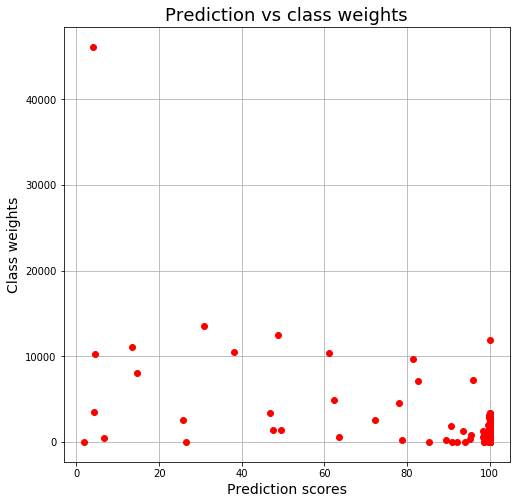

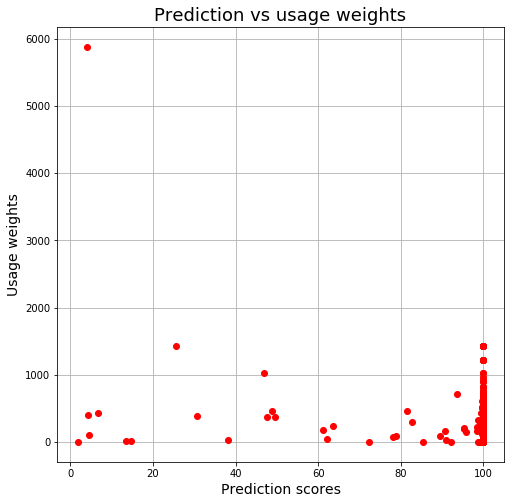

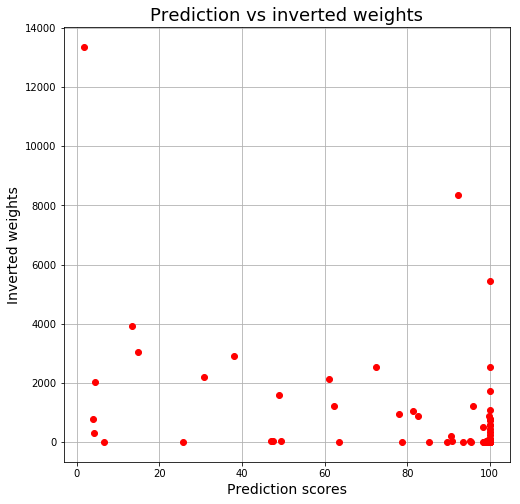

In [48]:
def plot_scatter(x_val, y_val, title, xlabel, ylabel):
    plt.figure(figsize=(8, 8))
    plt.plot(x_val, y_val, 'ro')
    plt.xlabel(xlabel, size=size_label)
    plt.ylabel(ylabel, size=size_label)
    plt.title(title, size=size_title)
    plt.grid(True)
    plt.show()

plot_scatter(ave_prediction_weights, ave_class_weights, "Prediction vs class weights", "Prediction scores", "Class weights")
plot_scatter(ave_prediction_weights, ave_usage_weights, "Prediction vs usage weights", "Prediction scores", "Usage weights")
plot_scatter(ave_prediction_weights, ave_inverted_weights, "Prediction vs inverted weights", "Prediction scores", "Inverted weights")

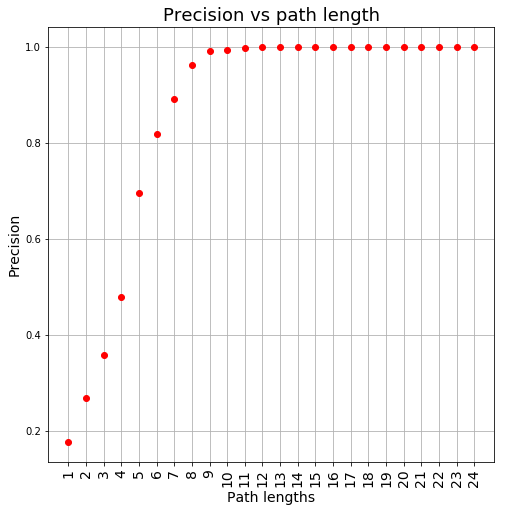

In [51]:
import collections


lengths = list()
mean_precision = list()

precision_path_length_ordered = dict(collections.OrderedDict(sorted(precision_path_length.items())))

for length in precision_path_length_ordered:
    lengths.append(length)
    mean_precision.append(np.mean(precision_path_length[length]))
    
def plot_hist(x_val, y_val, title, xlabel, ylabel):

    plt.figure(figsize=(8, 8))
    x_pos = np.arange(len(y_val))
    plt.plot(x_pos, y_val, 'ro')
    plt.xticks(range(len(x_val)), x_val, size=size_label, rotation='vertical')
    plt.xlabel(xlabel, size=size_label)
    plt.ylabel(ylabel, size=size_label)
    plt.title(title, size=size_title)
    plt.grid(True)
    plt.show()
    
plot_hist(lengths, mean_precision, "Precision vs path length", "Path lengths", "Precision")
